## <p style="text-align: center;"> MSAI339 - Data Science Project </p>

## <ins><p style="text-align: center;"> Bridging the Gap: Analyzing Pay Disparities Across Industries </p></ins>

## Team Members:

- **Sree Dhyuti Nimmagadda**
- **Ruchi Bommaraju**
- **Shruti Kalaskar**
- **Divyanka Thakur**


Pay parity is the concept that everyone within the same field should receive competitive compensation, regardless of factors such as **gender**, **ethnicity**, and other personal characteristics. 

As a cornerstone in the fight for **workplace equality**, pay parity is an essential focus and a topic of ongoing debate, as researchers and advocates continue to explore new ways of understanding why these compensation discrepancies still exist.


In [60]:
# Region columns
region_columns = ['northeast','northcentral', 'south', 'west']

# Industry columns
industry_columns = ['Agriculture', 'miningconstruction', 'durables', 'nondurables', 
                    'Transport', 'Utilities', 'Communications', 'retailtrade', 'wholesaletrade', 
                    'finance', 'SocArtOther', 'hotelsrestaurants', 'Medical','Education', 'professional', 'publicadmin']

# Occupation columns
occupation_columns = ['manager', 'business', 'financialop', 'computer', 
                      'architect', 'scientist', 'socialworker', 'postseceduc', 
                      'legaleduc', 'artist', 'lawyerphysician', 'healthcare', 'healthsupport', 
                      'protective', 'foodcare', 'building', 'sales', 'officeadmin', 
                      'farmer', 'production', 'transport', 'constructextractinstall']

# Race columns
# All rows wehre hispan is nan the other columns have values so just replace nan with zero
race_columns = ['white', 'black', 'othrace', 'hispan']


# Education columns
education_columns = ["sch", "o_educ", "ba", "adv", "potexp", "LEHS"]

## Exploratory Data Analysis

can start from here

In [61]:
# Import required libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import missingno as msno
from sklearn.preprocessing import LabelEncoder
from scipy import stats

# Set up Seaborn styling
sns.set(style="whitegrid")

processed = pd.read_csv('processed_dataset.csv', index_col=None)
processed

,year,hwtsupp,region,statefip,metro,pernum,relate,age,sex,race,...,qinclong,hisp,annhrs,incwageman,hrwage,perconexp,hdwfcoh,industry,occupation,education
0,1990,1052.650024,0,36,2.0,1,101,58,1,3,...,0.0,1,1820,14200.0,7.802198,64.639999,1,10,17,5
1,2009,971.200012,2,5,2.0,4,1260,28,1,0,...,0.0,0,2080,17680.0,8.500000,100.063004,0,11,17,5
2,1990,1622.280029,0,36,3.0,1,101,37,1,0,...,0.0,0,2080,28000.0,13.461538,64.639999,1,2,4,5
3,1990,2689.909912,3,6,3.0,1,101,34,1,0,...,0.0,0,2115,27500.0,13.002364,64.639999,1,14,3,3
4,1981,1911.900024,2,51,3.0,1,101,38,1,2,...,NaN,0,2080,17000.0,8.173077,43.977001,1,14,0,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
344282,1981,970.179993,1,39,3.0,2,1260,28,2,0,...,NaN,0,2340,17000.0,7.264957,43.977001,0,13,6,3
344283,1999,1753.010010,3,6,3.0,4,301,27,2,0,...,0.0,0,360,3200.0,8.888889,79.933998,0,0,0,5
344284,1981,1971.020020,2,48,3.0,2,201,36,2,0,...,NaN,0,2080,13000.0,6.250000,43.977001,1,7,16,5
344285,2007,715.510010,1,19,4.0,2,201,49,2,2,...,0.0,0,250,8800.0,35.200001,94.727997,1,14,9,3


In [62]:
# Assuming processed is your DataFrame
for column in processed.columns:
    mode_value = processed[column].mode()
    
    if not mode_value.empty:  # Check if mode is not empty
        processed[column] = processed[column].fillna(mode_value[0])  # Replace NaNs with the mode
    else:
        # print(f"No mode found for column: {column}")
        processed[column] = processed[column].fillna(processed[column].iloc[0])  # Replace NaNs with the first value

# Check if any null values remain
print(processed.isnull().sum())


year          0
hwtsupp       0
region        0
statefip      0
metro         0
pernum        0
relate        0
age           0
sex           0
race          0
marst         0
nativity      0
educ99        0
classwkr      0
wkswork1      0
hrswork       0
uhrswork      0
union         0
incwage       0
inclongj      0
srcearn       0
qinclong      0
hisp          0
annhrs        0
incwageman    0
hrwage        0
perconexp     0
hdwfcoh       0
industry      0
occupation    0
education     0
dtype: int64


In [63]:
processed.columns

Index(['year', 'hwtsupp', 'region', 'statefip', 'metro', 'pernum', 'relate',
       'age', 'sex', 'race', 'marst', 'nativity', 'educ99', 'classwkr',
       'wkswork1', 'hrswork', 'uhrswork', 'union', 'incwage', 'inclongj',
       'srcearn', 'qinclong', 'hisp', 'annhrs', 'incwageman', 'hrwage',
       'perconexp', 'hdwfcoh', 'industry', 'occupation', 'education'],
      dtype='object')

In [64]:
imputed_data = processed.copy()
imputed_data.to_csv('imputed_data.csv', index=False)
imputed_data.head()

,year,hwtsupp,region,statefip,metro,pernum,relate,age,sex,race,...,qinclong,hisp,annhrs,incwageman,hrwage,perconexp,hdwfcoh,industry,occupation,education
0,1990,1052.650024,0,36,2.0,1,101,58,1,3,...,0.0,1,1820,14200.0,7.802198,64.639999,1,10,17,5
1,2009,971.200012,2,5,2.0,4,1260,28,1,0,...,0.0,0,2080,17680.0,8.500000,100.063004,0,11,17,5
2,1990,1622.280029,0,36,3.0,1,101,37,1,0,...,0.0,0,2080,28000.0,13.461538,64.639999,1,2,4,5
3,1990,2689.909912,3,6,3.0,1,101,34,1,0,...,0.0,0,2115,27500.0,13.002364,64.639999,1,14,3,3
4,1981,1911.900024,2,51,3.0,1,101,38,1,2,...,0.0,0,2080,17000.0,8.173077,43.977001,1,14,0,5


In [65]:
nan_count = imputed_data.isnull().sum()
nan_columns_with_count = nan_count[nan_count > 0]

print(f"No of columns with NaN values: {len(nan_columns_with_count)}\n\n")
print("\nColumns with NaN values and their counts")
print(nan_columns_with_count)

No of columns with NaN values: 0



Columns with NaN values and their counts
Series([], dtype: int64)


In [66]:
imputed_data['metro'].fillna(imputed_data['metro'].mode()[0], inplace=True)  # Mode for metro
imputed_data['nativity'].fillna(imputed_data['nativity'].mode()[0], inplace=True)  # Mode for nativity
imputed_data['educ99'].fillna(imputed_data['educ99'].mode()[0], inplace=True)  # Mode for educ99
imputed_data['hrswork'].fillna(imputed_data['hrswork'].median(), inplace=True)  # Median for hrswork
imputed_data['union'].fillna(imputed_data['union'].mode()[0], inplace=True)  # Mode for union
imputed_data['inclongj'].fillna(imputed_data['inclongj'].median(), inplace=True)  # Median for inclongj
imputed_data['srcearn'].fillna(imputed_data['srcearn'].mode()[0], inplace=True)  # Mode for srcearn
imputed_data = imputed_data.drop(columns=['qinclong'])

# Print the updated imputed_data
print("Imputed DataFrame:")
print(imputed_data)

# Optionally, save imputed_data to a CSV file
# imputed_data.to_csv('imputed_data.csv', index=False)

Imputed DataFrame:
        year      hwtsupp  region  statefip  metro  pernum  relate  age  sex  \
0       1990  1052.650024       0        36    2.0       1     101   58    1   
1       2009   971.200012       2         5    2.0       4    1260   28    1   
2       1990  1622.280029       0        36    3.0       1     101   37    1   
3       1990  2689.909912       3         6    3.0       1     101   34    1   
4       1981  1911.900024       2        51    3.0       1     101   38    1   
...      ...          ...     ...       ...    ...     ...     ...  ...  ...   
344282  1981   970.179993       1        39    3.0       2    1260   28    2   
344283  1999  1753.010010       3         6    3.0       4     301   27    2   
344284  1981  1971.020020       2        48    3.0       2     201   36    2   
344285  2007   715.510010       1        19    4.0       2     201   49    2   
344286  2013   820.739990       3        49    3.0       2     201   36    2   

        race  ...  s

/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/3939318358.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  imputed_data['metro'].fillna(imputed_data['metro'].mode()[0], inplace=True)  # Mode for metro
/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/3939318358.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate

In [67]:
nan_count = imputed_data.isnull().sum()
nan_columns_with_count = nan_count[nan_count > 0]

print(f"No of columns with NaN values: {len(nan_columns_with_count)}\n\n")
print("\nColumns with NaN values and their counts")
print(nan_columns_with_count)

No of columns with NaN values: 0



Columns with NaN values and their counts
Series([], dtype: int64)


### Column Explanations

- **year**: The year when the data was collected.
- **hwtsupp**: Household weight supplement, used for survey sampling adjustments.
- **region**: Geographic region in the U.S. where the respondent lives.
- **statefip**: FIPS (Federal Information Processing Standards) code for U.S. state.
- **metro**: Indicates whether the individual lives in a metropolitan area.
- **metarea**: Code for specific metropolitan area.
- **pernum**: Person number within the household, unique to each household member.
- **relate**: Relationship of the individual to the head of the household.
- **age**: Age of the individual.
- **sex**: Gender of the individual (e.g., Male, Female).
- **race**: Self-identified race of the individual.
- **marst**: Marital status of the individual.
- **nativity**: Nativity status, indicating whether the individual was born in the U.S.
- **educ99**: Education level of the individual based on 1990 census classification.
- **classwkr**: Class of worker (e.g., private sector, government, self-employed).
- **wkswork1**: Weeks worked in the past year.
- **hrswork**: Usual hours worked per week.
- **uhrswork**: Usual hours worked per week in main job.
- **union**: Union membership status.
- **incwage**: Wage income of the individual.
- **inclongj**: Longest job wage income.
- **srcearn**: Source of earnings (e.g., wages, business income).
- **qinclong**: Quality of reported longest job wage income.
- **hisp**: Hispanic ethnicity indicator.
- **annhrs**: Annual hours worked.
- **incwageman**: Wage income of the individual, manually adjusted.
- **hrwage**: Hourly wage.
- **perconexp**: Person's contribution to household expenses.
- **hdwfcoh**: Head of household welfare cohort.
- **industry**: General industry classification.
- **occupation**: General occupation classification.
- **education**: Education level of the individual.


In [68]:
processed.describe()

,year,hwtsupp,region,statefip,metro,pernum,relate,age,sex,race,...,qinclong,hisp,annhrs,incwageman,hrwage,perconexp,hdwfcoh,industry,occupation,education
count,344287.000000,344287.000000,344287.00000,344287.000000,344287.000000,344287.000000,344287.000000,344287.000000,344287.000000,344287.000000,...,344287.0,344287.000000,344287.000000,3.442870e+05,344287.000000,344287.000000,344287.000000,344287.000000,344287.00000,344287.000000
mean,2002.599122,1507.300236,1.61639,28.121004,2.514852,1.535274,208.062021,41.734364,1.489057,0.650655,...,0.0,0.143145,2013.196449,3.976170e+04,20.074408,86.657110,0.911931,8.589238,12.53555,4.140026
std,10.831555,907.232381,1.07440,15.818556,0.981684,0.795836,242.663494,10.415874,0.499881,1.100596,...,0.0,0.350221,599.050382,4.529758e+04,498.968110,20.637707,0.283396,4.578673,6.86394,1.272586
min,1981.000000,0.000000,0.00000,1.000000,1.000000,1.000000,101.000000,25.000000,1.000000,0.000000,...,0.0,0.000000,1.000000,1.500000e+01,0.865385,43.977001,0.000000,0.000000,0.00000,0.000000
25%,1990.000000,818.505005,1.00000,13.000000,2.000000,1.000000,101.000000,33.000000,1.000000,0.000000,...,0.0,0.000000,1924.000000,1.670000e+04,9.134615,64.639999,1.000000,4.000000,8.00000,3.000000
50%,2007.000000,1473.829956,2.00000,28.000000,3.000000,1.000000,101.000000,41.000000,1.000000,0.000000,...,0.0,0.000000,2080.000000,3.000000e+04,14.500000,94.727997,1.000000,9.000000,15.00000,5.000000
75%,2011.000000,1935.989990,3.00000,41.000000,3.000000,2.000000,201.000000,50.000000,2.000000,1.000000,...,0.0,0.000000,2080.000000,5.000000e+04,23.557692,101.653999,1.000000,13.000000,17.00000,5.000000
max,2013.000000,13310.929688,3.00000,56.000000,4.000000,15.000000,1260.000000,64.000000,2.000000,3.000000,...,0.0,1.000000,5148.000000,1.259999e+06,290000.000000,106.009003,1.000000,15.000000,21.00000,5.000000


In [69]:
for i, j in zip(processed.columns, processed.dtypes):
    print(i, j)

year int64
hwtsupp float64
region int64
statefip int64
metro float64
pernum int64
relate int64
age int64
sex int64
race int64
marst int64
nativity float64
educ99 float64
classwkr int64
wkswork1 int64
hrswork float64
uhrswork int64
union float64
incwage float64
inclongj float64
srcearn float64
qinclong float64
hisp int64
annhrs int64
incwageman float64
hrwage float64
perconexp float64
hdwfcoh int64
industry int64
occupation int64
education int64


## All possible combinations

Year vs HouseHOLD wTS

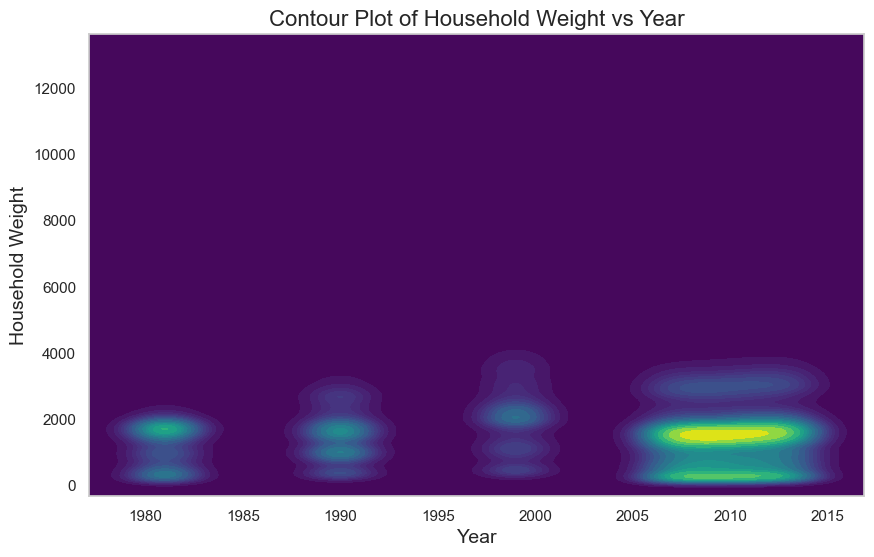

In [70]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [2020, 2021, 2022, 2020, 2021, 2022],
#     'household_weight': [1500, 1600, 1700, 1600, 1700, 1800]
# })

# Create a KDE for the contour plot
plt.figure(figsize=(10, 6))
sns.kdeplot(data=processed, x='year', y='hwtsupp', cmap='viridis', fill=True, thresh=0, levels=20)

# Adding titles and labels
plt.title('Contour Plot of Household Weight vs Year', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Household Weight', fontsize=14)

# Show the plot
plt.show()


More important accurate houses measured in 2010 time

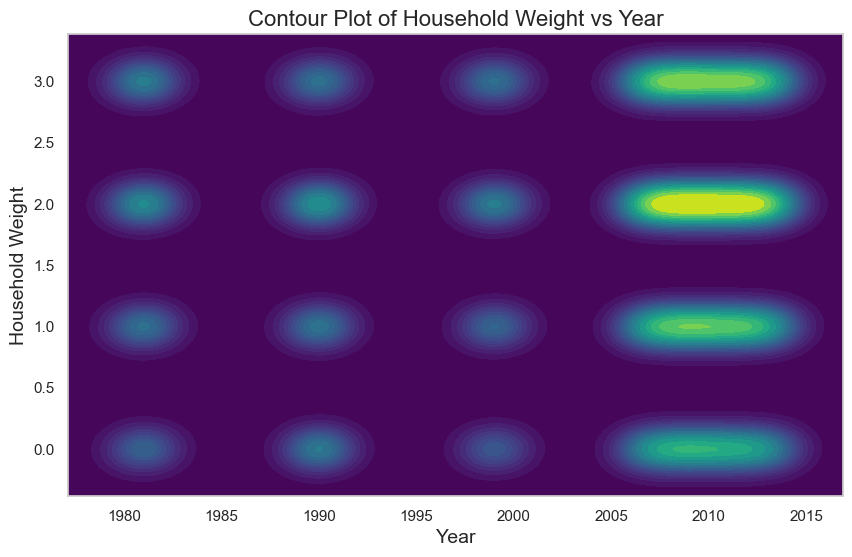

In [71]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# df = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# df = pd.DataFrame({
#     'year': [2020, 2021, 2022, 2020, 2021, 2022],
#     'household_weight': [1500, 1600, 1700, 1600, 1700, 1800]
# })

# Create a KDE for the contour plot
plt.figure(figsize=(10, 6))
sns.kdeplot(data=processed, x='year', y='region', cmap='viridis', fill=True, thresh=0, levels=20)

# Adding titles and labels
plt.title('Contour Plot of Household Weight vs Year', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Household Weight', fontsize=14)

# Show the plot
plt.show()


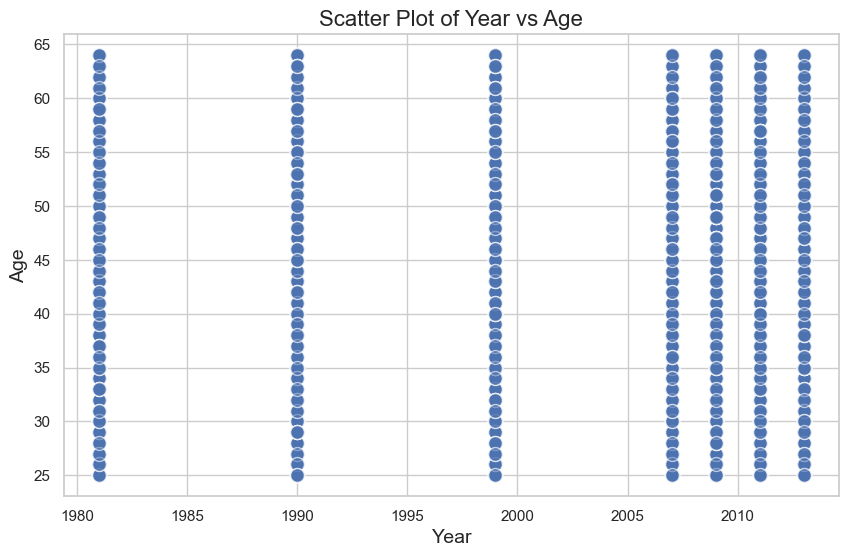

In [72]:
# Create a scatter plot
plt.figure(figsize=(10, 6))
plt.scatter(processed['year'], processed['age'], alpha=0.6, edgecolors='w', s=100)
plt.title('Scatter Plot of Year vs Age', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Age', fontsize=14)
plt.grid(True)
plt.show()

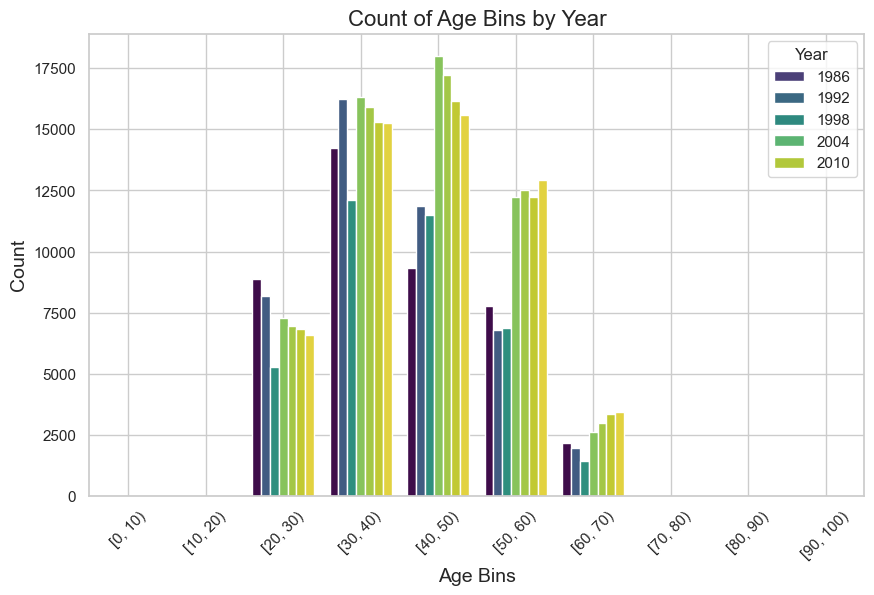

In [73]:
# Create age bins of size 5
bins = range(0, 101, 10)  # Adjust the range as needed
processed['age_bins'] = pd.cut(processed['age'], bins=bins, right=False)

# Create a count plot to visualize the number of occurrences of each age bin per year
plt.figure(figsize=(10, 6))
sns.countplot(x='age_bins', hue='year', data=processed, palette='viridis')

# Adding titles and labels
plt.title('Count of Age Bins by Year', fontsize=16)
plt.xlabel('Age Bins', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.legend(title='Year')
plt.grid(True)
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.show()

Scatter between every 2 numeric columns

In [74]:
# import pandas as pd
# import matplotlib.pyplot as plt
# from itertools import combinations
# import os

# # Load your dataset
# # Replace with your actual data loading code
# # df = pd.DataFrame()  # Update this to load your actual data

# # Filter for numeric columns only
# numeric_df = new_data.select_dtypes(include=['number'])

# # Create a directory to save the plots if it doesn’t already exist
# if not os.path.exists("plots"):
#     os.makedirs("plots")

# # Generate scatter plots for each pair of numeric columns
# column_names = numeric_df.columns
# for col1, col2 in combinations(column_names, 2):
#     plt.figure(figsize=(6, 4))
#     plt.scatter(numeric_df[col1], numeric_df[col2], alpha=0.5)
#     plt.xlabel(col1)
#     plt.ylabel(col2)
#     plt.title(f'Scatter plot between {col1} and {col2}')
#     print(f"plotted between {col1} and {col2}")
    
#     # Save the plot
#     plt.savefig(f'plots/{col1}_vs_{col2}.png')
#     plt.close()


In [75]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns
# from itertools import combinations
# import os

# # Load your dataset
# # Replace with your actual data loading code
# # df = pd.DataFrame()  # Update this to load your actual data

# # Filter for numeric columns only
# numeric_df = new_data.select_dtypes(include=['number'])

# # Create a directory to save the plots if it doesn’t already exist
# if not os.path.exists("plots"):
#     os.makedirs("plots")

# # Define the plot types you want to create
# plot_types = ["scatter", "line", "box", "histogram", "density", "hexbin", "violin", "bar"]

# # Generate plots for each pair of numeric columns
# column_names = numeric_df.columns
# for col1, col2 in combinations(column_names, 2):
#     for plot_type in plot_types:
#         plt.figure(figsize=(6, 4))
        
#         if plot_type == "scatter":
#             plt.scatter(numeric_df[col1], numeric_df[col2], alpha=0.5)
#             plt.title(f'Scatter plot between {col1} and {col2}')
#         elif plot_type == "line":
#             plt.plot(numeric_df[col1], numeric_df[col2], linestyle='-', marker='o')
#             plt.title(f'Line plot between {col1} and {col2}')
#         elif plot_type == "box":
#             plt.boxplot([numeric_df[col1].dropna(), numeric_df[col2].dropna()], labels=[col1, col2])
#             plt.title(f'Box plot for {col1} and {col2}')
#         elif plot_type == "histogram":
#             plt.hist(numeric_df[col1].dropna(), bins=20, alpha=0.7, label=col1)
#             plt.hist(numeric_df[col2].dropna(), bins=20, alpha=0.7, label=col2)
#             plt.legend()
#             plt.title(f'Histogram of {col1} and {col2}')
#         elif plot_type == "density":
#             sns.kdeplot(numeric_df[col1].dropna(), shade=True, label=col1)
#             sns.kdeplot(numeric_df[col2].dropna(), shade=True, label=col2)
#             plt.legend()
#             plt.title(f'Density plot of {col1} and {col2}')
#         elif plot_type == "hexbin":
#             plt.hexbin(numeric_df[col1], numeric_df[col2], gridsize=30, cmap='Blues')
#             plt.title(f'Hexbin plot between {col1} and {col2}')
#         elif plot_type == "violin":
#             sns.violinplot(data=numeric_df[[col1, col2]].melt(), x="variable", y="value")
#             plt.title(f'Violin plot for {col1} and {col2}')
#         elif plot_type == "bar":
#             plt.bar(numeric_df[col1].index, numeric_df[col1], alpha=0.7, label=col1)
#             plt.bar(numeric_df[col2].index, numeric_df[col2], alpha=0.7, label=col2)
#             plt.legend()
#             plt.title(f'Bar plot for {col1} and {col2}') 
        
#         plt.xlabel(col1)
#         plt.ylabel(col2)
        
#         # Save the plot with an informative filename
#         plt.savefig(f'plots/{col1}_vs_{col2}_{plot_type}.png')
#         plt.close()
        
#         print(f"Saved {plot_type} plot between {col1} and {col2}")


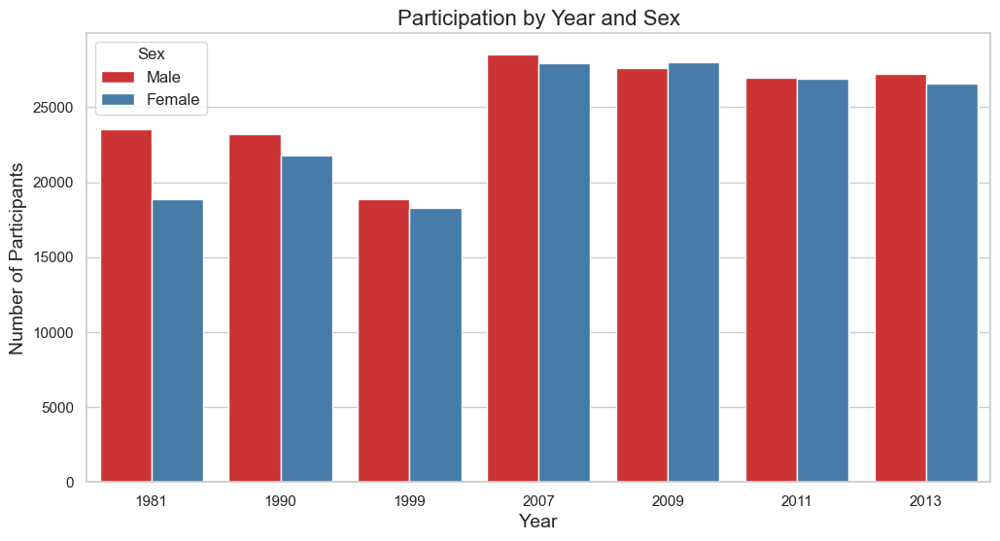

In [76]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [2020, 2020, 2021, 2021, 2022, 2022, 2020, 2021, 2022],
#     'sex': ['Male', 'Female', 'Female', 'Male', 'Male', 'Female', 'Female', 'Male', 'Male']
# })

# Create a count plot for participation based on year and sex
plt.figure(figsize=(12, 6))
sns.countplot(data=processed, x='year', hue='sex', palette='Set1')

# Adding titles and labels
plt.title('Participation by Year and Sex', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Participants', fontsize=14)
plt.legend(['Male', 'Female'], title='Sex', fontsize=12)

# Show the plot
plt.show()


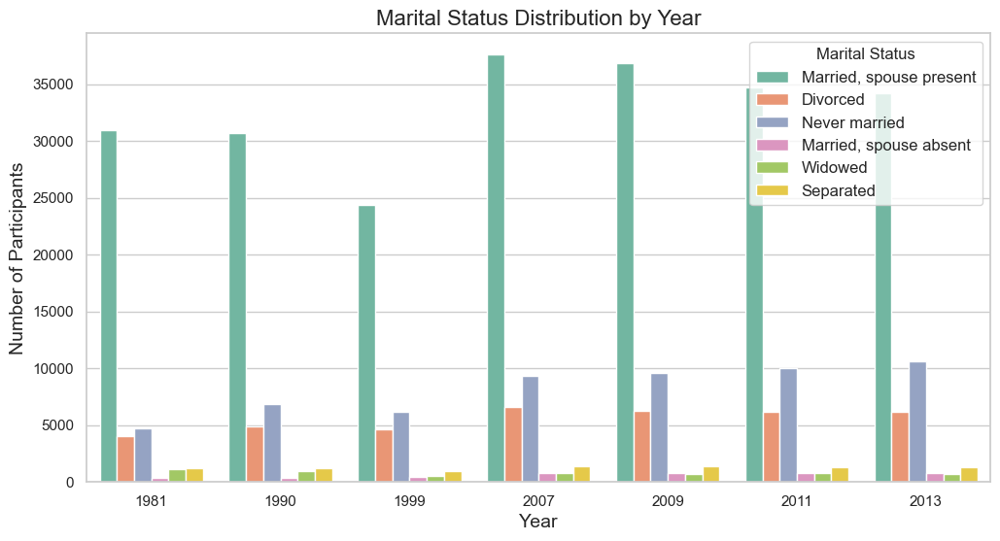

In [77]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [2020, 2020, 2021, 2021, 2022, 2022, 2020, 2021, 2022, 2020],
#     'sex': ['Male', 'Female', 'Female', 'Male', 'Male', 'Female', 'Female', 'Male', 'Male', 'Female'],
#     'marst': [1, 2, 1, 2, 1, 2, 2, 1, 1, 4]  # Numeric marital status
# })

# Mapping for marital status
marital_status_map = {
    1: 'Married, spouse present',
    2: 'Married, spouse absent',
    3: 'Separated',
    4: 'Divorced',
    5: 'Widowed',
    6: 'Never married'
}

# Replace numeric marital status with string labels
processed['marital_status'] = processed['marst'].map(marital_status_map)

# Create a count plot for marital status based on year
plt.figure(figsize=(12, 6))
sns.countplot(data=processed, x='year', hue='marital_status', palette='Set2')

# Adding titles and labels
plt.title('Marital Status Distribution by Year', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Participants', fontsize=14)
plt.legend(title='Marital Status', fontsize=12)

# Show the plot
plt.show()


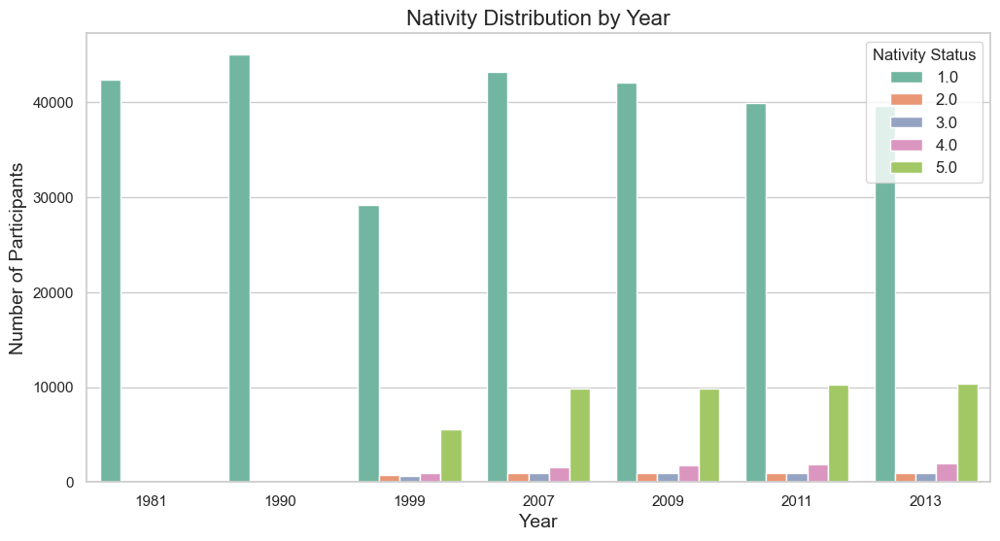

In [78]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [2020, 2020, 2021, 2021, 2022, 2022, 2020, 2021, 2022, 2020],
#     'nativity': ['Native', 'Foreign', 'Native', 'Native', 'Foreign', 'Native', 'Foreign', 'Native', 'Native', 'Foreign'],
# })

# Create a count plot for nativity based on year
plt.figure(figsize=(12, 6))
sns.countplot(data=processed, x='year', hue='nativity', palette='Set2')

# Adding titles and labels
plt.title('Nativity Distribution by Year', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Participants', fontsize=14)
plt.legend(title='Nativity Status', fontsize=12)

# Show the plot
plt.show()


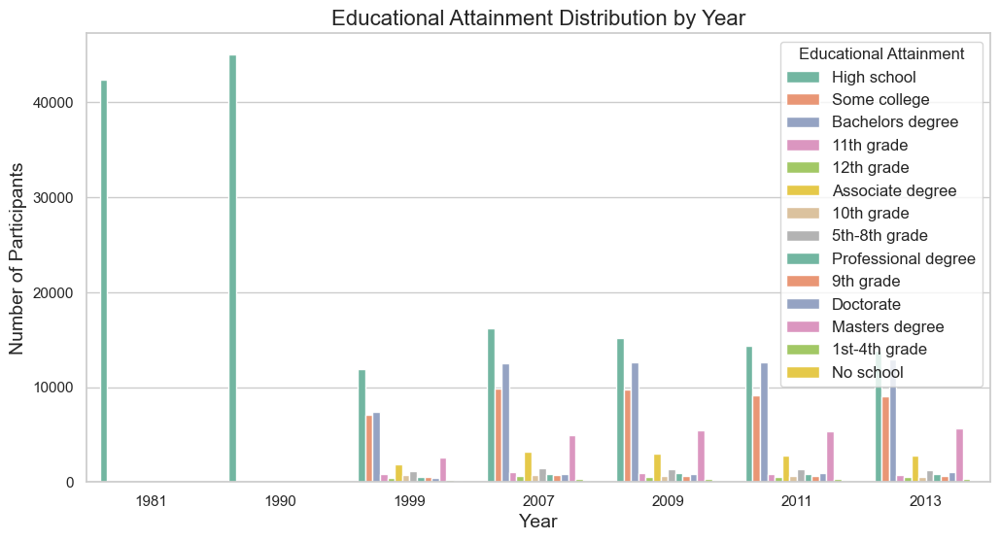

In [79]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [1999, 2000, 2001, 1999, 2000, 2001],
#     'educ99': [1, 10, 15, 4, 11, 18]  # Example education levels
# })

# Mapping for educational attainment
education_map = {
    1: 'No school',
    4: '1st-4th grade',
    5: '5th-8th grade',
    6: '9th grade',
    7: '10th grade',
    8: '11th grade',
    9: '12th grade',
    10: 'High school',
    11: 'Some college',
    13: 'Associate degree',
    15: 'Bachelors degree',
    16: 'Masters degree',
    17: 'Professional degree',
    18: 'Doctorate'
}

# Replace numeric education levels with string labels
processed['education'] = processed['educ99'].map(education_map)

# Create a count plot for educational attainment based on year
plt.figure(figsize=(12, 6))
sns.countplot(data=processed, x='year', hue='education', palette='Set2')

# Adding titles and labels
plt.title('Educational Attainment Distribution by Year', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Participants', fontsize=14)
plt.legend(title='Educational Attainment', fontsize=12)

# Show the plot
plt.show()


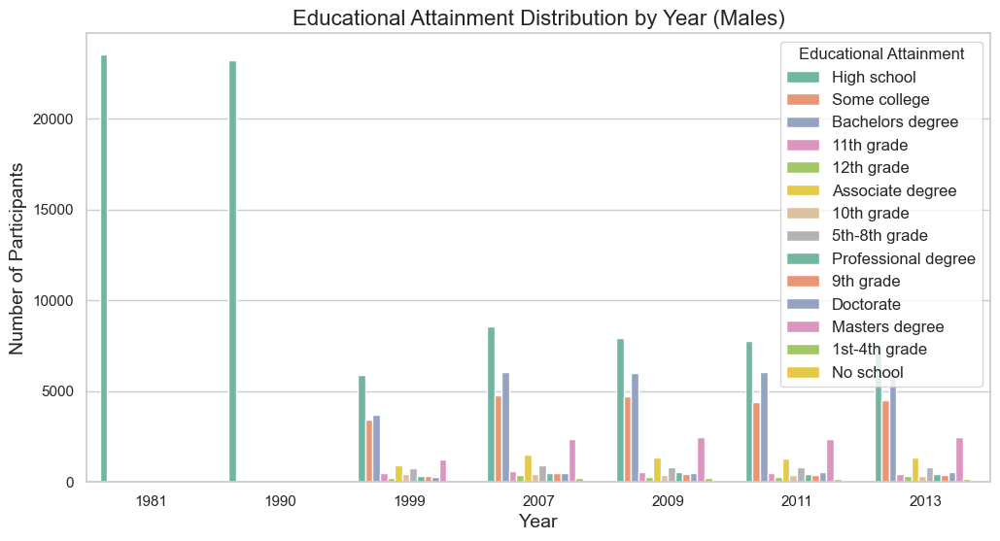

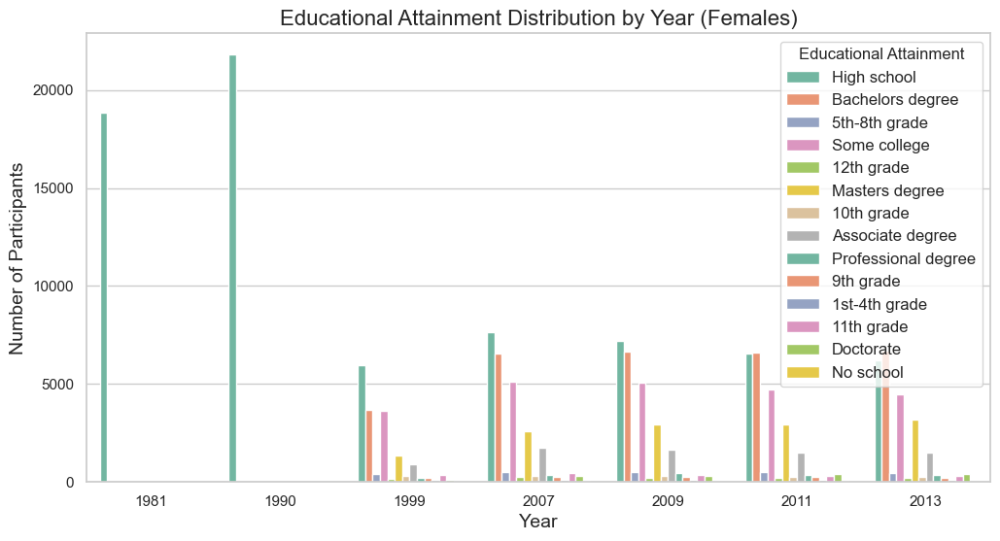

In [80]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [1999, 2000, 2001, 1999, 2000, 2001, 1999, 2000, 2001, 1999],
#     'educ99': [1, 10, 15, 4, 11, 18, 10, 15, 16, 6],
#     'sex': [1, 2, 2, 1, 1, 2, 2, 1, 1, 2]  # 1 for Male, 2 for Female
# })

# Mapping for educational attainment
education_map = {
    1: 'No school',
    4: '1st-4th grade',
    5: '5th-8th grade',
    6: '9th grade',
    7: '10th grade',
    8: '11th grade',
    9: '12th grade',
    10: 'High school',
    11: 'Some college',
    13: 'Associate degree',
    15: 'Bachelors degree',
    16: 'Masters degree',
    17: 'Professional degree',
    18: 'Doctorate'
}

# Replace numeric education levels with string labels
processed['education'] = processed['educ99'].map(education_map)

# Create a full plot for Males
plt.figure(figsize=(12, 6))
sns.countplot(data=processed[processed['sex'] == 1], x='year', hue='education', palette='Set2')
plt.title('Educational Attainment Distribution by Year (Males)', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Participants', fontsize=14)
plt.legend(title='Educational Attainment', fontsize=12)

# Show the Male plot
plt.show()

# Create a full plot for Females
plt.figure(figsize=(12, 6))
sns.countplot(data=processed[processed['sex'] == 2], x='year', hue='education', palette='Set2')
plt.title('Educational Attainment Distribution by Year (Females)', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Participants', fontsize=14)
plt.legend(title='Educational Attainment', fontsize=12)

# Show the Female plot
plt.show()


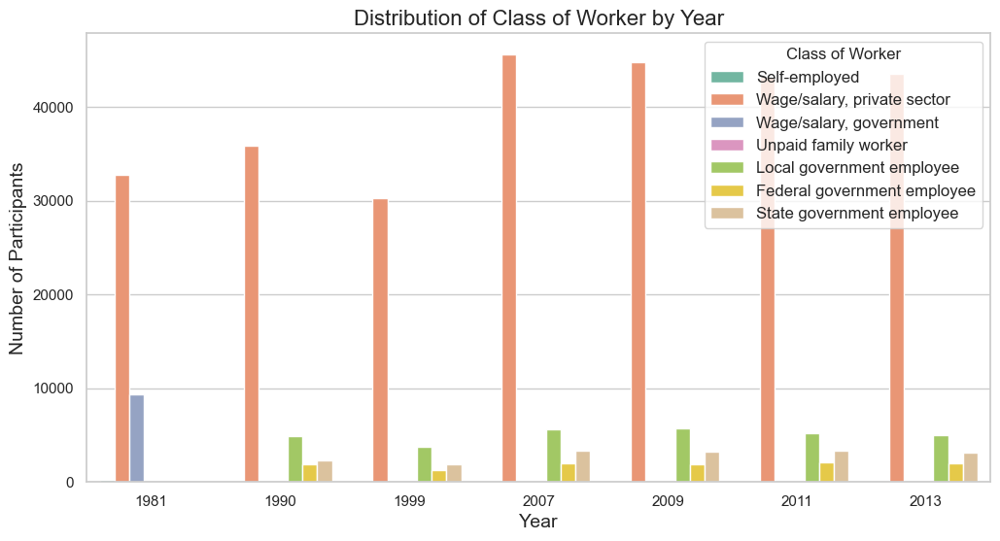

In [81]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [1999, 2000, 2001, 1999, 2000, 2001, 1999, 2000, 2001],
#     'classwkr': [10, 21, 24, 21, 10, 29, 25, 27, 28]
# })

# Mapping for class of worker
classwkr_map = {
    10: 'Self-employed',
    21: 'Wage/salary, private sector',
    24: 'Wage/salary, government',
    25: 'Federal government employee',
    27: 'State government employee',
    28: 'Local government employee',
    29: 'Unpaid family worker'
}

# Replace numeric class of worker with string labels
processed['classwkr_label'] = processed['classwkr'].map(classwkr_map)

# Create a count plot for class of worker based on year
plt.figure(figsize=(12, 6))
sns.countplot(data=processed, x='year', hue='classwkr_label', palette='Set2')

# Adding titles and labels
plt.title('Distribution of Class of Worker by Year', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Participants', fontsize=14)
plt.legend(title='Class of Worker', fontsize=12)

# Show the plot
plt.show()


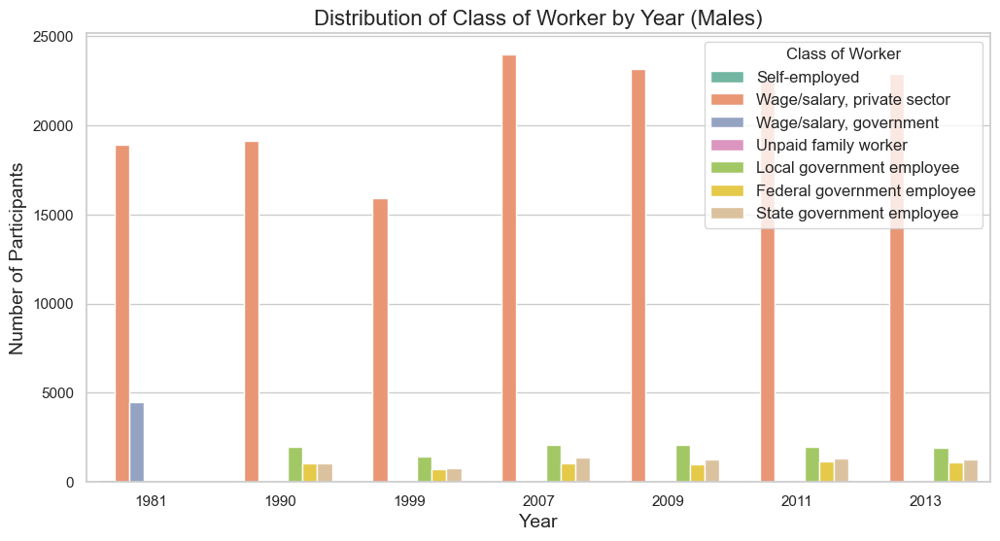

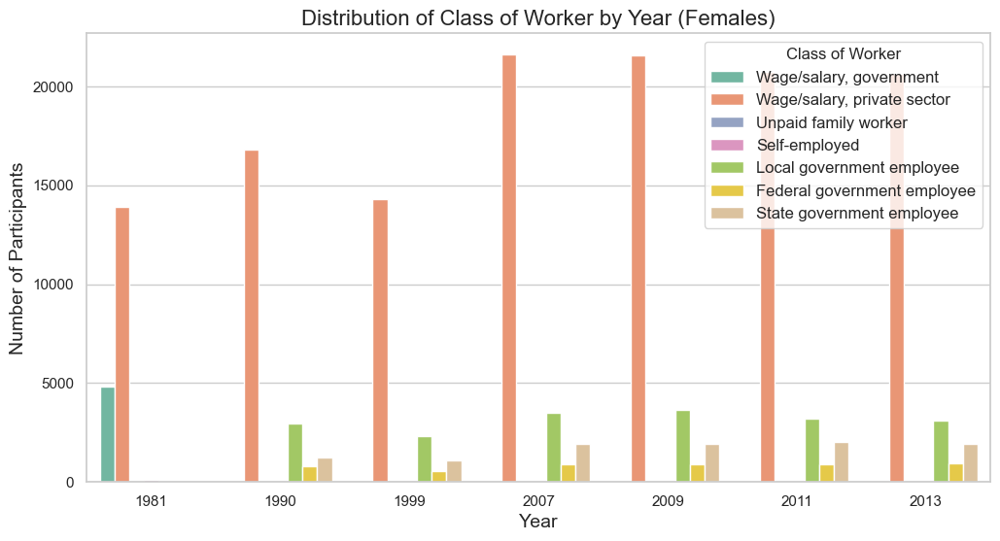

In [82]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [1999, 2000, 2001, 1999, 2000, 2001, 1999, 2000, 2001],
#     'classwkr': [10, 21, 24, 21, 10, 29, 25, 27, 28],
#     'sex': [1, 2, 1, 2, 1, 2, 1, 1, 2]  # 1 for Male, 2 for Female
# })

# Mapping for class of worker
classwkr_map = {
    10: 'Self-employed',
    21: 'Wage/salary, private sector',
    24: 'Wage/salary, government',
    25: 'Federal government employee',
    27: 'State government employee',
    28: 'Local government employee',
    29: 'Unpaid family worker'
}

# Replace numeric class of worker with string labels
processed['classwkr_label'] = processed['classwkr'].map(classwkr_map)

# Create a count plot for males
plt.figure(figsize=(12, 6))
sns.countplot(data=processed[processed['sex'] == 1], x='year', hue='classwkr_label', palette='Set2')
plt.title('Distribution of Class of Worker by Year (Males)', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Participants', fontsize=14)
plt.legend(title='Class of Worker', fontsize=12)

# Show the male plot
plt.show()

# Create a count plot for females
plt.figure(figsize=(12, 6))
sns.countplot(data=processed[processed['sex'] == 2], x='year', hue='classwkr_label', palette='Set2')
plt.title('Distribution of Class of Worker by Year (Females)', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Participants', fontsize=14)
plt.legend(title='Class of Worker', fontsize=12)

# Show the female plot
plt.show()


/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/3492471234.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=processed, x='year', y='hrswork', palette='Set2')


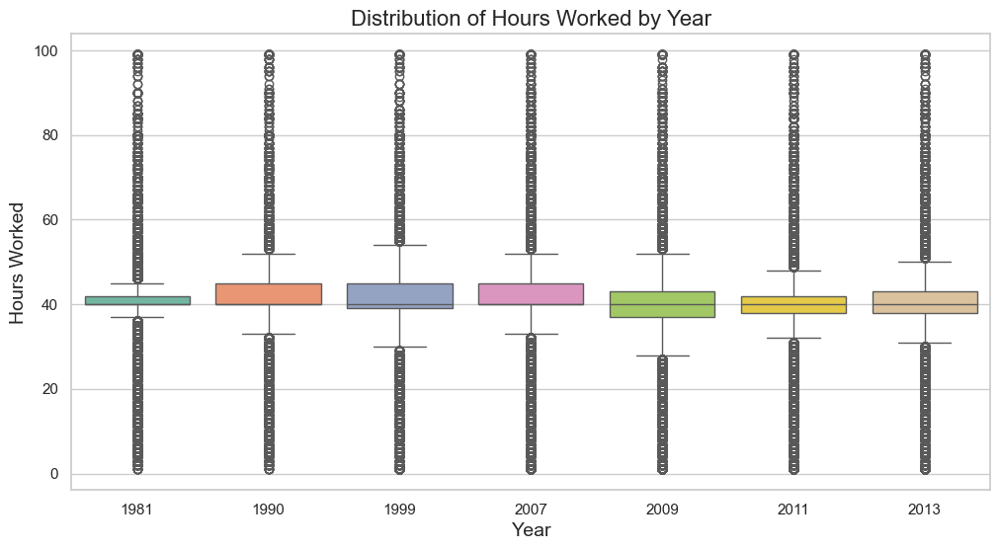

/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/3492471234.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=processed[processed['sex'] == 1], x='year', y='hrswork', palette='Set2')


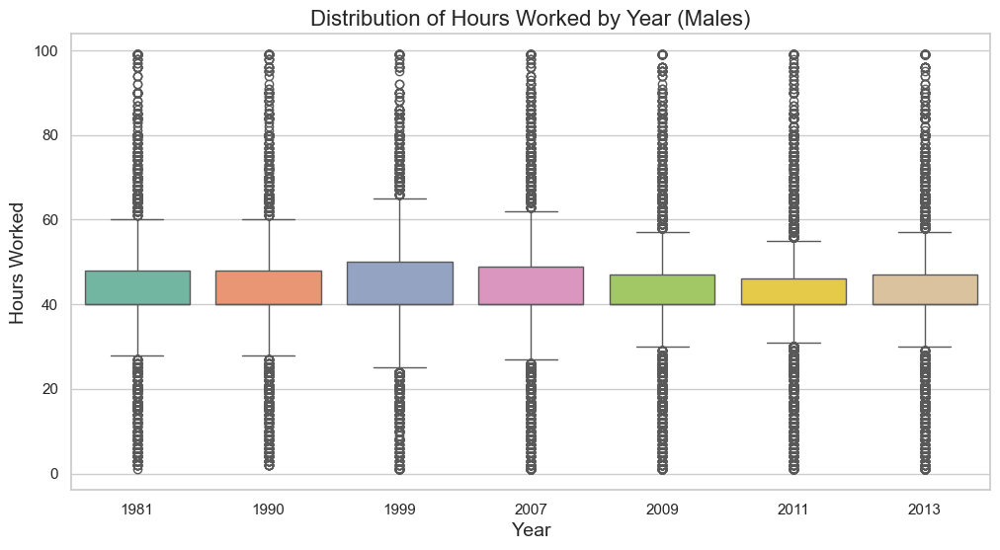

/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/3492471234.py:37: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=processed[processed['sex'] == 2], x='year', y='hrswork', palette='Set2')


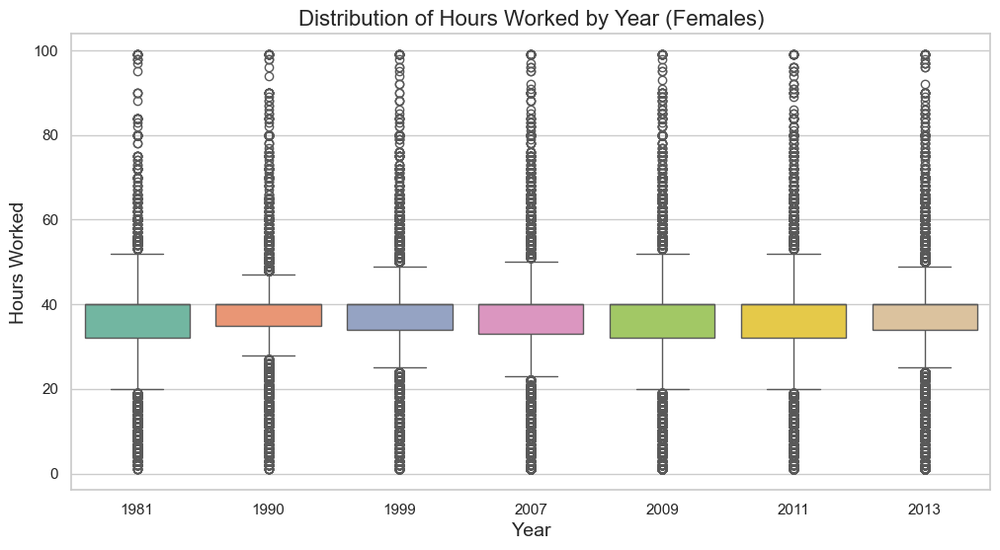

In [83]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [1999, 2000, 2001, 1999, 2000, 2001, 1999, 2000, 2001],
#     'hrswork': [40, 42, 38, 45, 50, 48, 40, 35, 39],
#     'sex': [1, 2, 1, 2, 1, 2, 1, 1, 2]  # 1 for Male, 2 for Female
# })

# Create a box plot for the entire dataset
plt.figure(figsize=(12, 6))
sns.boxplot(data=processed, x='year', y='hrswork', palette='Set2')
plt.title('Distribution of Hours Worked by Year', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Hours Worked', fontsize=14)

# Show the plot for the entire dataset
plt.show()

# Create a box plot for males
plt.figure(figsize=(12, 6))
sns.boxplot(data=processed[processed['sex'] == 1], x='year', y='hrswork', palette='Set2')
plt.title('Distribution of Hours Worked by Year (Males)', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Hours Worked', fontsize=14)

# Show the male plot
plt.show()

# Create a box plot for females
plt.figure(figsize=(12, 6))
sns.boxplot(data=processed[processed['sex'] == 2], x='year', y='hrswork', palette='Set2')
plt.title('Distribution of Hours Worked by Year (Females)', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Hours Worked', fontsize=14)

# Show the female plot
plt.show()


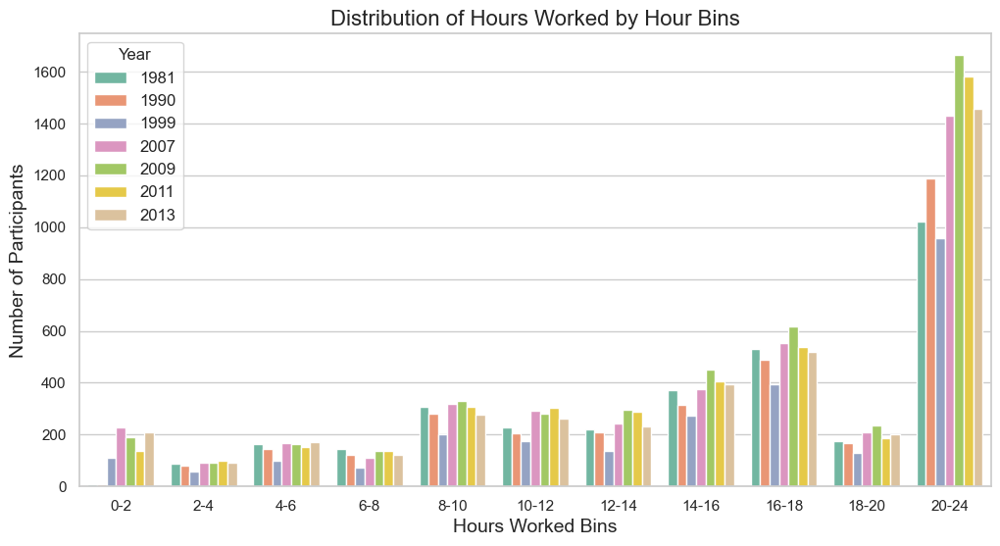

/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/1291483387.py:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=processed[processed['sex'] == 1], x='hrswork_bin', palette='Set2')


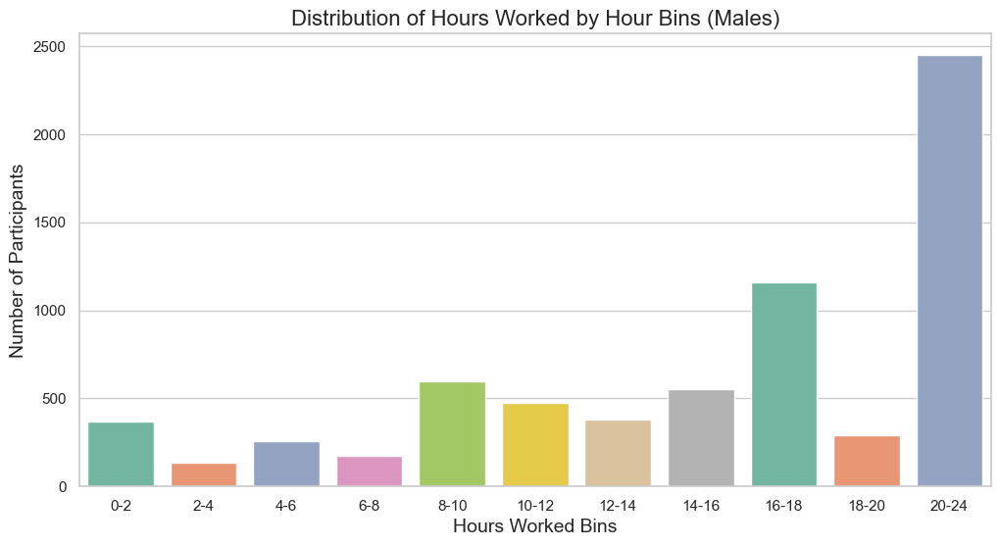

/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/1291483387.py:45: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=processed[processed['sex'] == 2], x='hrswork_bin', palette='Set2')


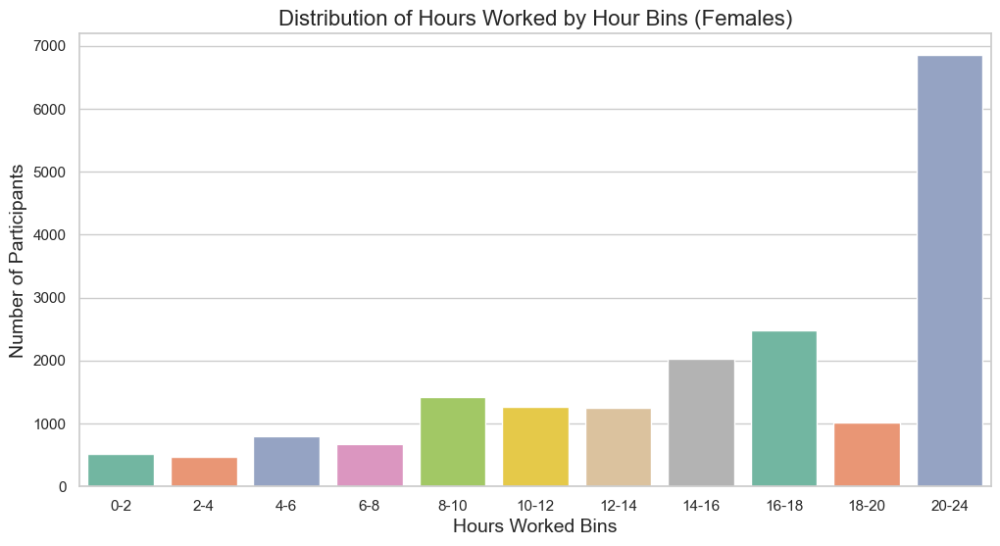

In [84]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [1999, 2000, 2001, 1999, 2000, 2001, 1999, 2000, 2001],
#     'hrswork': [40, 42, 38, 45, 50, 48, 40, 35, 39],
#     'sex': [1, 2, 1, 2, 1, 2, 1, 1, 2]  # 1 for Male, 2 for Female
# })

# Define bins for hours worked
bins = [0, 2, 4, 6, 8, 10, 12, 14, 16, 18, 20, 24]  # Adjust according to your data
labels = [f"{bins[i]}-{bins[i+1]}" for i in range(len(bins)-1)]

# Create a new column for binned hours worked
processed['hrswork_bin'] = pd.cut(processed['hrswork'], bins=bins, labels=labels, right=False)

# Create a bar plot for the entire dataset
plt.figure(figsize=(12, 6))
sns.countplot(data=processed, x='hrswork_bin', hue='year', palette='Set2')
plt.title('Distribution of Hours Worked by Hour Bins', fontsize=16)
plt.xlabel('Hours Worked Bins', fontsize=14)
plt.ylabel('Number of Participants', fontsize=14)
plt.legend(title='Year', fontsize=12)

# Show the plot for the entire dataset
plt.show()

# Create a bar plot for males
plt.figure(figsize=(12, 6))
sns.countplot(data=processed[processed['sex'] == 1], x='hrswork_bin', palette='Set2')
plt.title('Distribution of Hours Worked by Hour Bins (Males)', fontsize=16)
plt.xlabel('Hours Worked Bins', fontsize=14)
plt.ylabel('Number of Participants', fontsize=14)

# Show the male plot
plt.show()

# Create a bar plot for females
plt.figure(figsize=(12, 6))
sns.countplot(data=processed[processed['sex'] == 2], x='hrswork_bin', palette='Set2')
plt.title('Distribution of Hours Worked by Hour Bins (Females)', fontsize=16)
plt.xlabel('Hours Worked Bins', fontsize=14)
plt.ylabel('Number of Participants', fontsize=14)

# Show the female plot
plt.show()


/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/2230662454.py:33: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=year_data, x='hrswork_bin', palette='Set2')


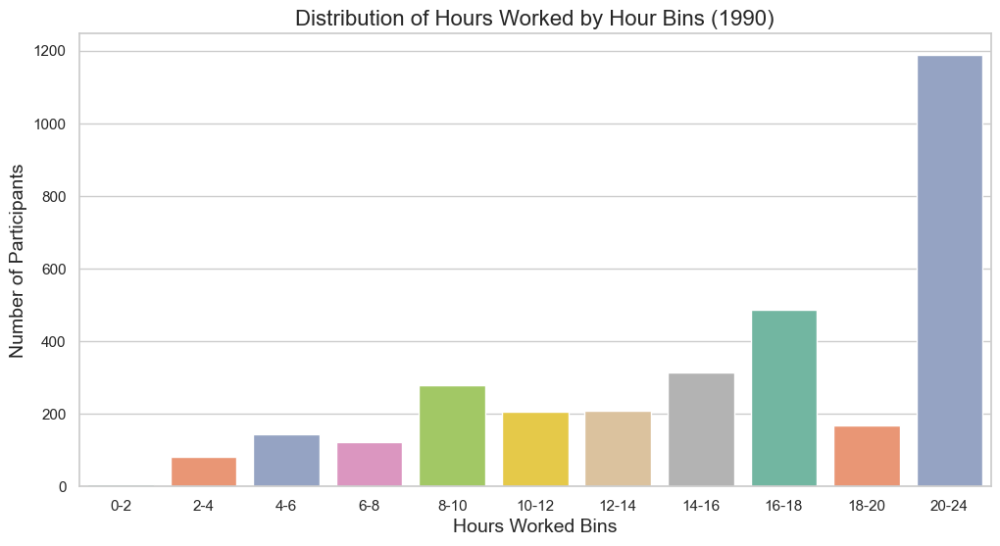

/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/2230662454.py:33: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=year_data, x='hrswork_bin', palette='Set2')


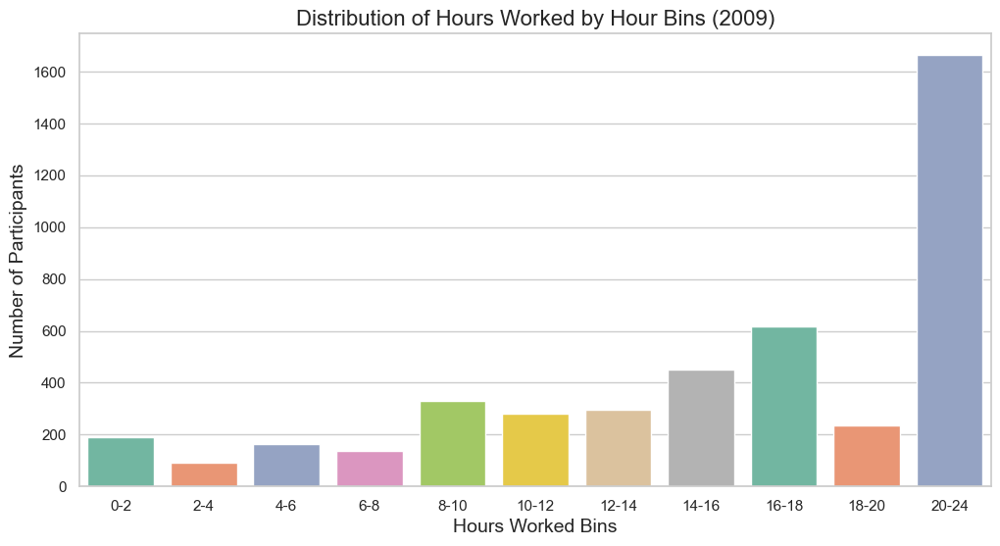

/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/2230662454.py:33: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=year_data, x='hrswork_bin', palette='Set2')


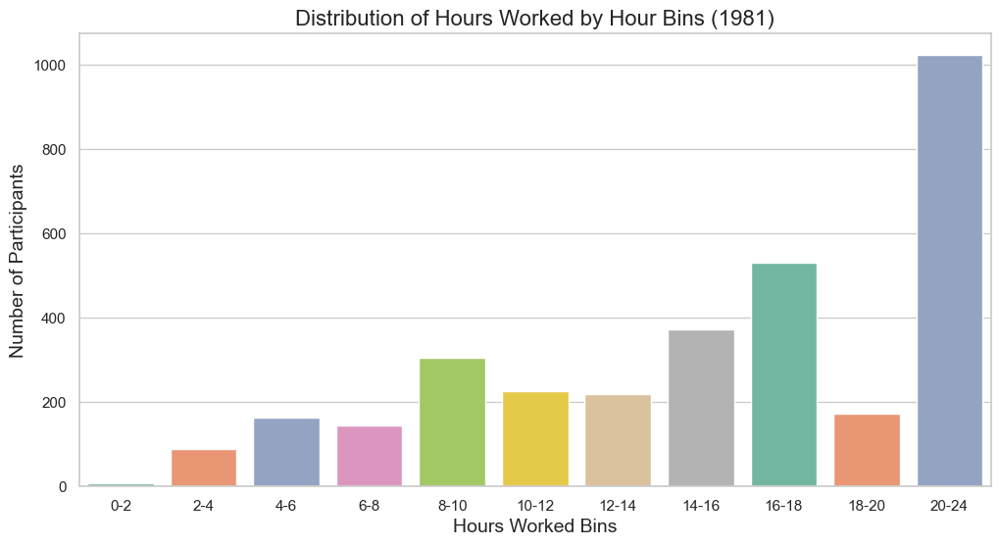

/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/2230662454.py:33: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=year_data, x='hrswork_bin', palette='Set2')


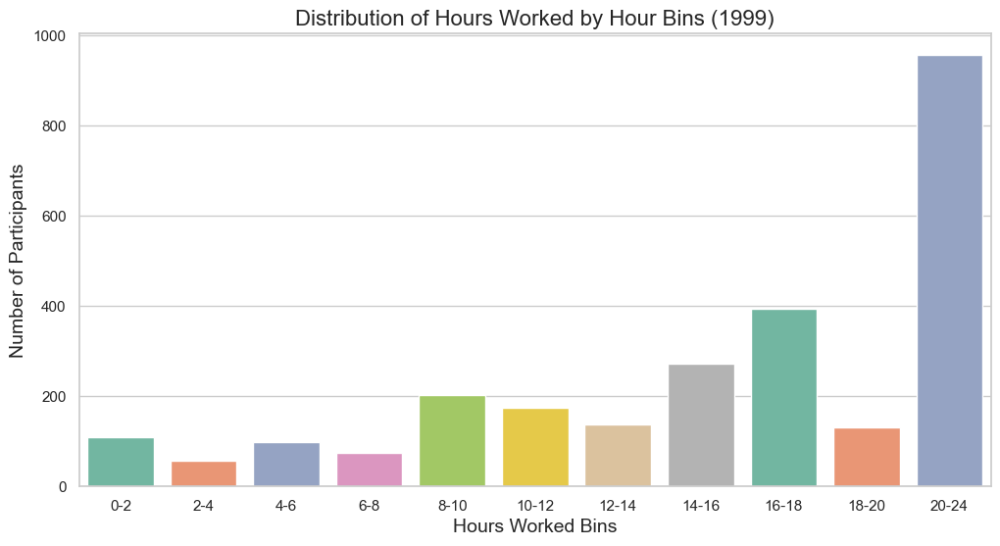

/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/2230662454.py:33: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=year_data, x='hrswork_bin', palette='Set2')


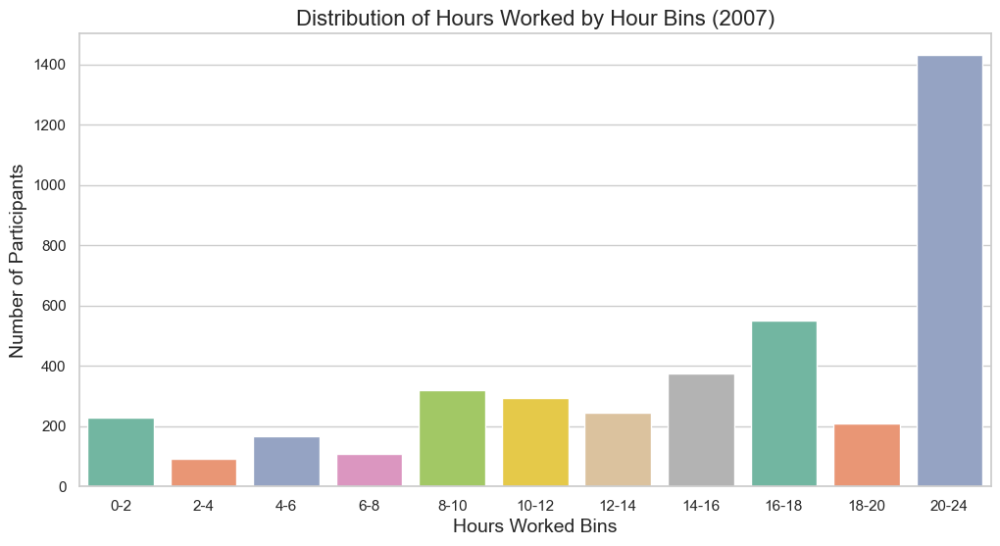

/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/2230662454.py:33: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=year_data, x='hrswork_bin', palette='Set2')


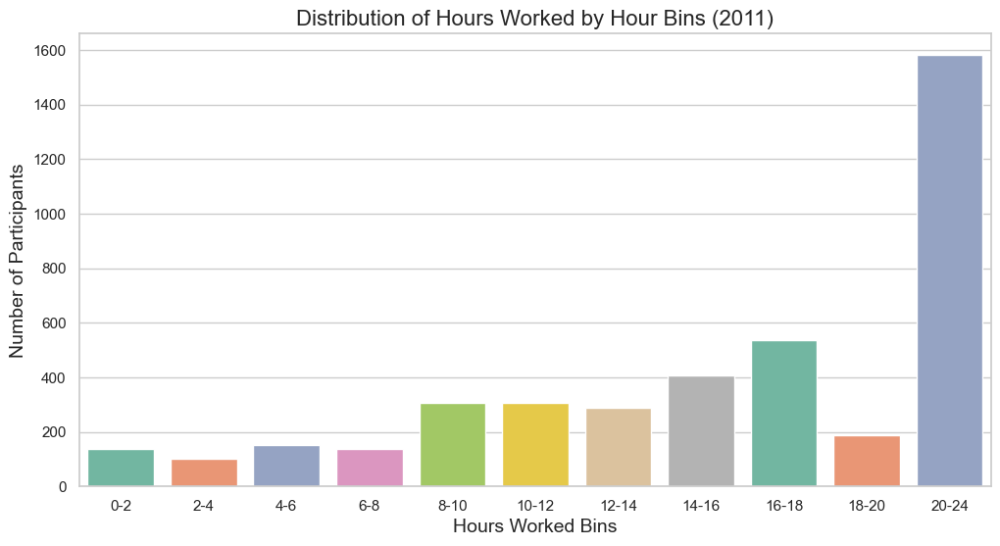

/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/2230662454.py:33: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=year_data, x='hrswork_bin', palette='Set2')


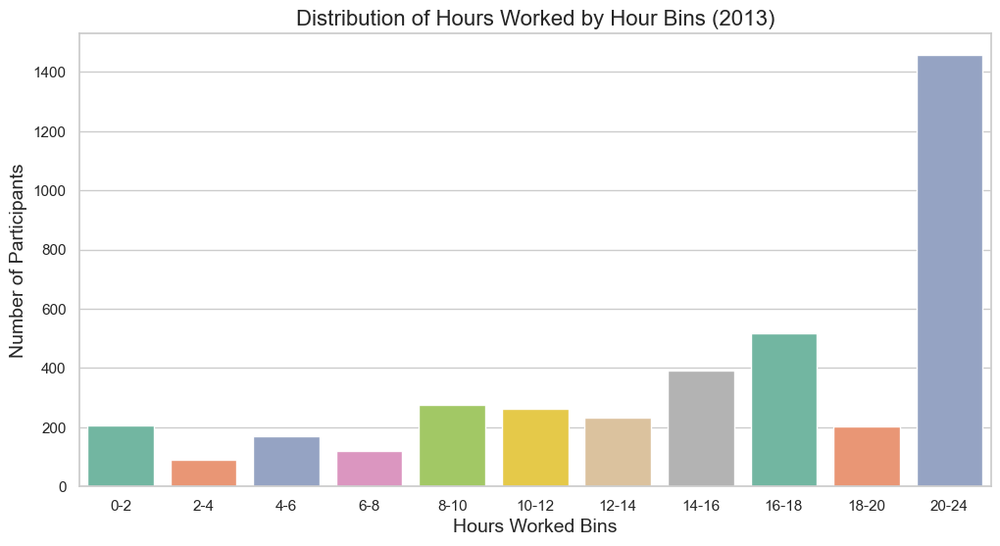

In [85]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [1999, 2000, 2001, 1999, 2000, 2001, 1999, 2000, 2001],
#     'hrswork': [40, 42, 38, 45, 50, 48, 40, 35, 39],
#     'sex': [1, 2, 1, 2, 1, 2, 1, 1, 2]  # 1 for Male, 2 for Female
# })

# Define bins for hours worked
bins = [0, 2, 4, 6, 8, 10, 12, 14, 16, 18, 20, 24]  # Adjust according to your data
labels = [f"{bins[i]}-{bins[i+1]}" for i in range(len(bins)-1)]

# Create a new column for binned hours worked
processed['hrswork_bin'] = pd.cut(processed['hrswork'], bins=bins, labels=labels, right=False)

# Get the unique years from the dataset
unique_years = processed['year'].unique()

# Loop through each year and create a bar plot
for year in unique_years:
    plt.figure(figsize=(12, 6))
    
    # Filter data for the current year
    year_data = processed[processed['year'] == year]
    
    # Create a bar plot for the current year
    sns.countplot(data=year_data, x='hrswork_bin', palette='Set2')
    plt.title(f'Distribution of Hours Worked by Hour Bins ({year})', fontsize=16)
    plt.xlabel('Hours Worked Bins', fontsize=14)
    plt.ylabel('Number of Participants', fontsize=14)

    # Show the plot for the current year
    plt.show()


/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/3071124407.py:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=year_data[year_data['sex'] == 1], x='hrswork_bin', palette='Set2', ax=axes[i, 0])
/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/3071124407.py:41: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=year_data[year_data['sex'] == 2], x='hrswork_bin', palette='Set2', ax=axes[i, 1])
/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/3071124407.py:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


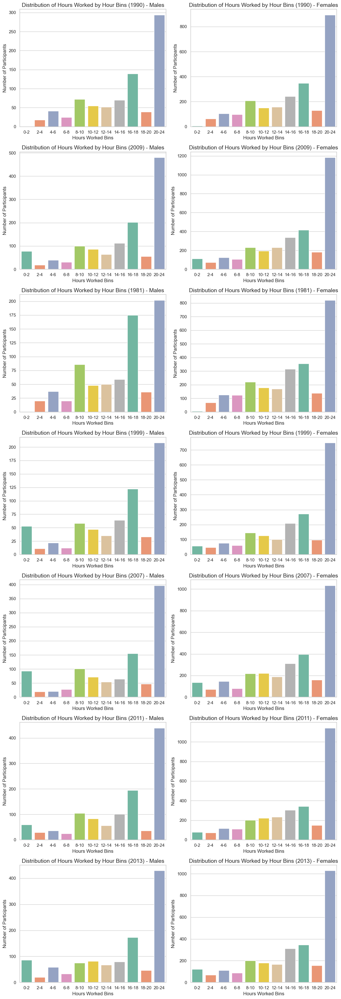

In [86]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [1999, 2000, 2001, 1999, 2000, 2001, 1999, 2000, 2001],
#     'hrswork': [40, 42, 38, 45, 50, 48, 40, 35, 39],
#     'sex': [1, 2, 1, 2, 1, 2, 1, 1, 2]  # 1 for Male, 2 for Female
# })

# Define bins for hours worked
bins = [0, 2, 4, 6, 8, 10, 12, 14, 16, 18, 20, 24]  # Adjust according to your data
labels = [f"{bins[i]}-{bins[i+1]}" for i in range(len(bins)-1)]

# Create a new column for binned hours worked
processed['hrswork_bin'] = pd.cut(processed['hrswork'], bins=bins, labels=labels, right=False)

# Get the unique years from the dataset
unique_years = processed['year'].unique()

# Create subplots
n_years = len(unique_years)
fig, axes = plt.subplots(n_years, 2, figsize=(12, n_years * 5))  # 2 columns: one for Male and one for Female

# Loop through each year and create bar plots
for i, year in enumerate(unique_years):
    # Filter data for the current year
    year_data = processed[processed['year'] == year]

    # Males
    sns.countplot(data=year_data[year_data['sex'] == 1], x='hrswork_bin', palette='Set2', ax=axes[i, 0])
    axes[i, 0].set_title(f'Distribution of Hours Worked by Hour Bins ({year}) - Males', fontsize=14)
    axes[i, 0].set_xlabel('Hours Worked Bins', fontsize=12)
    axes[i, 0].set_ylabel('Number of Participants', fontsize=12)

    # Females
    sns.countplot(data=year_data[year_data['sex'] == 2], x='hrswork_bin', palette='Set2', ax=axes[i, 1])
    axes[i, 1].set_title(f'Distribution of Hours Worked by Hour Bins ({year}) - Females', fontsize=14)
    axes[i, 1].set_xlabel('Hours Worked Bins', fontsize=12)
    axes[i, 1].set_ylabel('Number of Participants', fontsize=12)

# Adjust layout
plt.tight_layout()

# Show the plots
plt.show()


/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/4159862690.py:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=year_data[year_data['sex'] == 1], x='uhrswork_bin', palette='Set2', ax=axes[i, 0])
/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/4159862690.py:41: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=year_data[year_data['sex'] == 2], x='uhrswork_bin', palette='Set2', ax=axes[i, 1])
/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/4159862690.py:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect

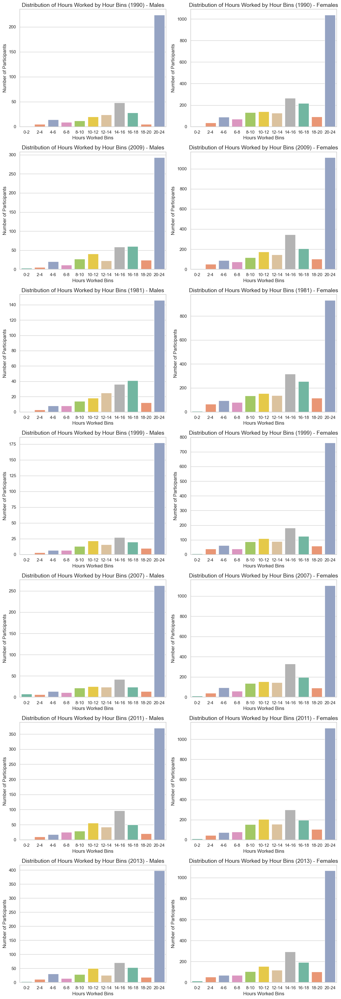

In [87]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [1999, 2000, 2001, 1999, 2000, 2001, 1999, 2000, 2001],
#     'uhrswork': [40, 42, 38, 45, 50, 48, 40, 35, 39],  # Use uhrswork here
#     'sex': [1, 2, 1, 2, 1, 2, 1, 1, 2]  # 1 for Male, 2 for Female
# })

# Define bins for hours worked
bins = [0, 2, 4, 6, 8, 10, 12, 14, 16, 18, 20, 24]  # Adjust according to your data
labels = [f"{bins[i]}-{bins[i+1]}" for i in range(len(bins)-1)]

# Create a new column for binned hours worked
processed['uhrswork_bin'] = pd.cut(processed['uhrswork'], bins=bins, labels=labels, right=False)

# Get the unique years from the dataset
unique_years = processed['year'].unique()

# Create subplots
n_years = len(unique_years)
fig, axes = plt.subplots(n_years, 2, figsize=(12, n_years * 5))  # 2 columns: one for Male and one for Female

# Loop through each year and create bar plots
for i, year in enumerate(unique_years):
    # Filter data for the current year
    year_data = processed[processed['year'] == year]

    # Males
    sns.countplot(data=year_data[year_data['sex'] == 1], x='uhrswork_bin', palette='Set2', ax=axes[i, 0])
    axes[i, 0].set_title(f'Distribution of Hours Worked by Hour Bins ({year}) - Males', fontsize=14)
    axes[i, 0].set_xlabel('Hours Worked Bins', fontsize=12)
    axes[i, 0].set_ylabel('Number of Participants', fontsize=12)

    # Females
    sns.countplot(data=year_data[year_data['sex'] == 2], x='uhrswork_bin', palette='Set2', ax=axes[i, 1])
    axes[i, 1].set_title(f'Distribution of Hours Worked by Hour Bins ({year}) - Females', fontsize=14)
    axes[i, 1].set_xlabel('Hours Worked Bins', fontsize=12)
    axes[i, 1].set_ylabel('Number of Participants', fontsize=12)

# Adjust layout
plt.tight_layout()

# Show the plots
plt.show()


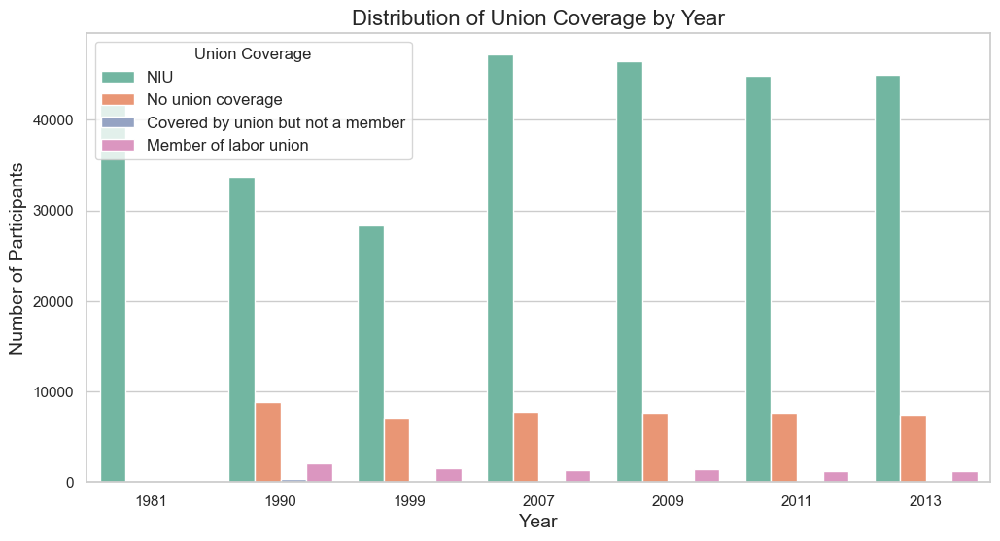

In [88]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [1999, 2000, 2001, 1999, 2000, 2001, 1999, 2000, 2001],
#     'union': [0, 1, 2, 3, 1, 2, 0, 2, 3]  # Union coverage categories
# })

# Mapping for union coverage
union_map = {
    0: 'NIU',
    1: 'No union coverage',
    2: 'Member of labor union',
    3: 'Covered by union but not a member'
}

# Replace numeric union levels with string labels
processed['union_coverage'] = processed['union'].map(union_map)

# Create a count plot for union coverage by year
plt.figure(figsize=(12, 6))
sns.countplot(data=processed, x='year', hue='union_coverage', palette='Set2')
plt.title('Distribution of Union Coverage by Year', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Participants', fontsize=14)
plt.legend(title='Union Coverage', fontsize=12)

# Show the plot
plt.show()


/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/2663232074.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=year_data[year_data['sex'] == 1], x='union_coverage', palette='Set2', ax=axes[i, 0])
/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/2663232074.py:56: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[i, 0].set_xticklabels(axes[i, 0].get_xticklabels(), rotation=45, ha='right')  # Tilt labels
/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/2663232074.py:60: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=year_data[year_data['sex'] == 2], 

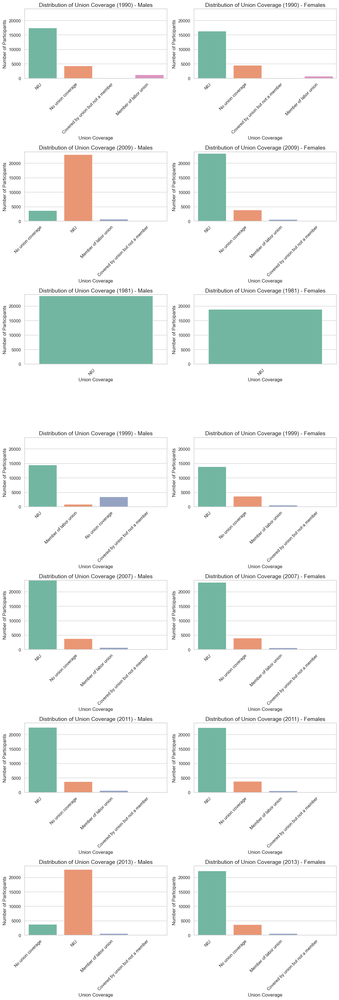

In [89]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [1999, 2000, 2001, 1999, 2000, 2001, 1999, 2000, 2001],
#     'union': [0, 1, 2, 3, 1, 2, 0, 2, 3],  # Union coverage categories
#     'sex': [1, 2, 1, 2, 1, 2, 1, 2, 1]  # 1 for Male, 2 for Female
# })

# Mapping for union coverage
union_map = {
    0: 'NIU',
    1: 'No union coverage',
    2: 'Member of labor union',
    3: 'Covered by union but not a member'
}

# Replace numeric union levels with string labels
processed['union_coverage'] = processed['union'].map(union_map)

# Get the unique years from the dataset
unique_years = processed['year'].unique()

# Create subplots
n_years = len(unique_years)
fig, axes = plt.subplots(n_years, 2, figsize=(12, n_years * 5))  # 2 columns: one for Male and one for Female

# Calculate the maximum counts for y-axis limits
max_counts = []

# Loop through each year to calculate max count
for year in unique_years:
    year_data = processed[processed['year'] == year]
    max_male_count = year_data[year_data['sex'] == 1]['union_coverage'].value_counts().max()
    max_female_count = year_data[year_data['sex'] == 2]['union_coverage'].value_counts().max()
    max_counts.append(max(max_male_count, max_female_count))

# Set a consistent y-axis limit for all plots
y_limit = max(max_counts) + 1  # Add a little padding for visibility

# Loop through each year and create bar plots
for i, year in enumerate(unique_years):
    # Filter data for the current year
    year_data = processed[processed['year'] == year]

    # Males
    sns.countplot(data=year_data[year_data['sex'] == 1], x='union_coverage', palette='Set2', ax=axes[i, 0])
    axes[i, 0].set_title(f'Distribution of Union Coverage ({year}) - Males', fontsize=14)
    axes[i, 0].set_xlabel('Union Coverage', fontsize=12)
    axes[i, 0].set_ylabel('Number of Participants', fontsize=12)
    axes[i, 0].set_xticklabels(axes[i, 0].get_xticklabels(), rotation=45, ha='right')  # Tilt labels
    axes[i, 0].set_ylim(0, y_limit)  # Set y-axis limits

    # Females
    sns.countplot(data=year_data[year_data['sex'] == 2], x='union_coverage', palette='Set2', ax=axes[i, 1])
    axes[i, 1].set_title(f'Distribution of Union Coverage ({year}) - Females', fontsize=14)
    axes[i, 1].set_xlabel('Union Coverage', fontsize=12)
    axes[i, 1].set_ylabel('Number of Participants', fontsize=12)
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=45, ha='right')  # Tilt labels
    axes[i, 1].set_ylim(0, y_limit)  # Set y-axis limits

# Adjust layout
plt.tight_layout()

# Show the plots
plt.show()


/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/1225793290.py:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=year_data[year_data['sex'] == 1], x='year', y='incwage', palette='Set2', ax=axes[i, 0])
/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/1225793290.py:39: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[i, 0].set_xticklabels(axes[i, 0].get_xticklabels(), rotation=45, ha='right')  # Tilt labels
/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/1225793290.py:43: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=year_data[year_data['sex'] == 2], x

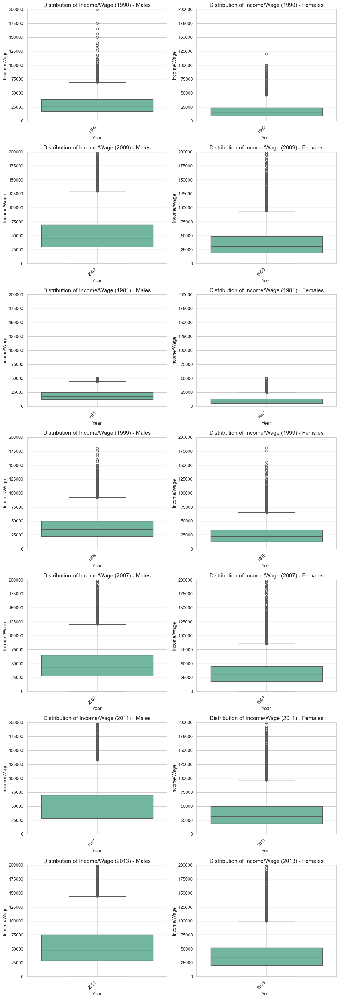

In [90]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [1999, 2000, 2001, 1999, 2000, 2001, 1999, 2000, 2001],
#     'incwage': [30000, 35000, 32000, 40000, 42000, 45000, 31000, 33000, 34000],
#     'sex': [1, 2, 1, 2, 1, 2, 1, 2, 1]  # 1 for Male, 2 for Female
# })

# Get the unique years from the dataset
unique_years = processed['year'].unique()

# Determine the overall min and max incwage for consistent y-axis limits
min_incwage = processed['incwage'].min()
max_incwage = processed['incwage'].max()

min_incwage = 0
max_incwage = 200000

# Create subplots
n_years = len(unique_years)
fig, axes = plt.subplots(n_years, 2, figsize=(12, n_years * 5))  # 2 columns: one for Male and one for Female

# Loop through each year and create box plots
for i, year in enumerate(unique_years):
    # Filter data for the current year
    year_data = processed[processed['year'] == year]

    # Males
    sns.boxplot(data=year_data[year_data['sex'] == 1], x='year', y='incwage', palette='Set2', ax=axes[i, 0])
    axes[i, 0].set_title(f'Distribution of Income/Wage ({year}) - Males', fontsize=14)
    axes[i, 0].set_xlabel('Year', fontsize=12)
    axes[i, 0].set_ylabel('Income/Wage', fontsize=12)
    axes[i, 0].set_xticklabels(axes[i, 0].get_xticklabels(), rotation=45, ha='right')  # Tilt labels
    axes[i, 0].set_ylim(min_incwage, max_incwage)  # Set y-axis limits

    # Females
    sns.boxplot(data=year_data[year_data['sex'] == 2], x='year', y='incwage', palette='Set2', ax=axes[i, 1])
    axes[i, 1].set_title(f'Distribution of Income/Wage ({year}) - Females', fontsize=14)
    axes[i, 1].set_xlabel('Year', fontsize=12)
    axes[i, 1].set_ylabel('Income/Wage', fontsize=12)
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=45, ha='right')  # Tilt labels
    axes[i, 1].set_ylim(min_incwage, max_incwage)  # Set y-axis limits

# Adjust layout
plt.tight_layout()

# Show the plots
plt.show()


/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/4077166061.py:32: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=year_data[year_data['sex'] == 1], x='year', y='inclongj', palette='Set2', ax=axes[i, 0])
/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/4077166061.py:36: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[i, 0].set_xticklabels(axes[i, 0].get_xticklabels(), rotation=45, ha='right')  # Tilt labels
/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/4077166061.py:40: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=year_data[year_data['sex'] == 2], 

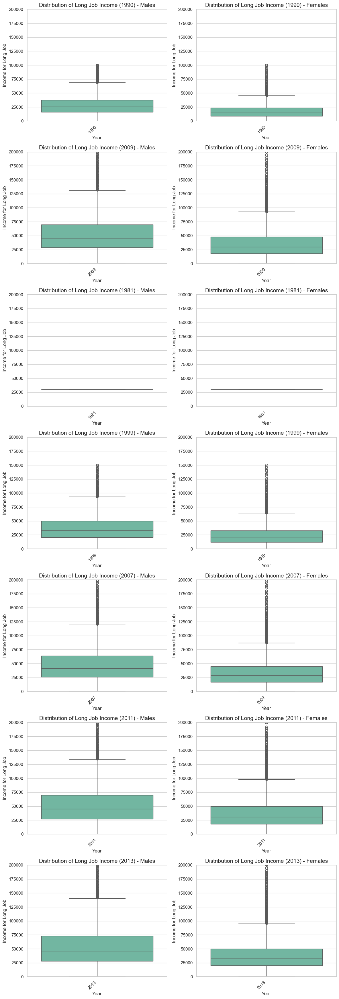

In [91]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [1999, 2000, 2001, 1999, 2000, 2001, 1999, 2000, 2001],
#     'inclongj': [30000, 35000, 32000, 40000, 42000, 45000, 31000, 33000, 34000],
#     'sex': [1, 2, 1, 2, 1, 2, 1, 2, 1]  # 1 for Male, 2 for Female
# })

# Get the unique years from the dataset
unique_years = processed['year'].unique()

# Determine the overall min and max inclongj for consistent y-axis limits
min_inclongj = 0
max_inclongj = 200000

# Create subplots
n_years = len(unique_years)
fig, axes = plt.subplots(n_years, 2, figsize=(12, n_years * 5))  # 2 columns: one for Male and one for Female

# Loop through each year and create box plots
for i, year in enumerate(unique_years):
    # Filter data for the current year
    year_data = processed[processed['year'] == year]

    # Males
    sns.boxplot(data=year_data[year_data['sex'] == 1], x='year', y='inclongj', palette='Set2', ax=axes[i, 0])
    axes[i, 0].set_title(f'Distribution of Long Job Income ({year}) - Males', fontsize=14)
    axes[i, 0].set_xlabel('Year', fontsize=12)
    axes[i, 0].set_ylabel('Income for Long Job', fontsize=12)
    axes[i, 0].set_xticklabels(axes[i, 0].get_xticklabels(), rotation=45, ha='right')  # Tilt labels
    axes[i, 0].set_ylim(min_inclongj, max_inclongj)  # Set y-axis limits

    # Females
    sns.boxplot(data=year_data[year_data['sex'] == 2], x='year', y='inclongj', palette='Set2', ax=axes[i, 1])
    axes[i, 1].set_title(f'Distribution of Long Job Income ({year}) - Females', fontsize=14)
    axes[i, 1].set_xlabel('Year', fontsize=12)
    axes[i, 1].set_ylabel('Income for Long Job', fontsize=12)
    axes[i, 1].set_xticklabels(axes[i, 1].get_xticklabels(), rotation=45, ha='right')  # Tilt labels
    axes[i, 1].set_ylim(min_inclongj, max_inclongj)  # Set y-axis limits

# Adjust layout
plt.tight_layout()

# Show the plots
plt.show()


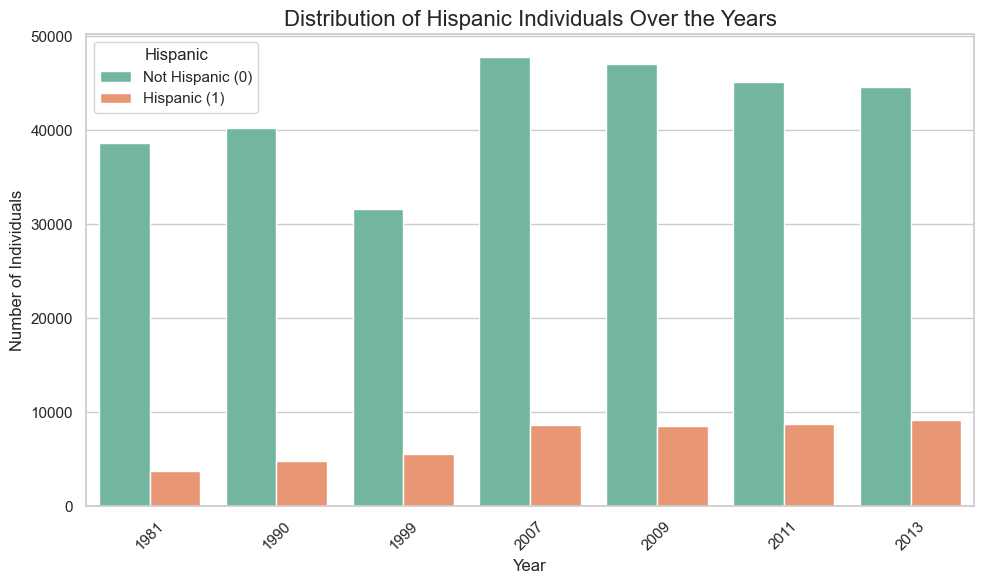

In [92]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [1999, 2000, 2001, 1999, 2000, 2001, 1999, 2000, 2001],
#     'hisp': [1, 0, 1, 0, 1, 1, 0, 0, 1]  # Example binary values
# })

# Create a count plot for Hispanic individuals over the years
plt.figure(figsize=(10, 6))
sns.countplot(data=processed, x='year', hue='hisp', palette='Set2')

# Set titles and labels
plt.title('Distribution of Hispanic Individuals Over the Years', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Number of Individuals', fontsize=12)
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.legend(title='Hispanic', labels=['Not Hispanic (0)', 'Hispanic (1)'])

# Show the plot
plt.tight_layout()
plt.show()


/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/2628603288.py:24: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45)
/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/2628603288.py:32: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45)


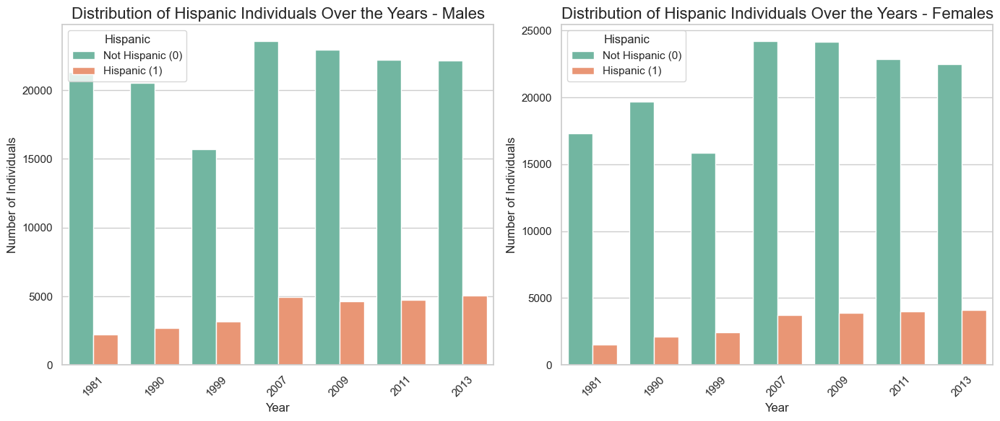

In [93]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [1999, 2000, 2001, 1999, 2000, 2001, 1999, 2000, 2001],
#     'hisp': [1, 0, 1, 0, 1, 1, 0, 0, 1],  # Example binary values
#     'sex': [1, 1, 1, 2, 2, 2, 1, 1, 2]  # 1 for Male, 2 for Female
# })

# Create a figure with subplots for males and females
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

# Count plot for Males
sns.countplot(data=processed[processed['sex'] == 1], x='year', hue='hisp', palette='Set2', ax=axes[0])
axes[0].set_title('Distribution of Hispanic Individuals Over the Years - Males', fontsize=16)
axes[0].set_xlabel('Year', fontsize=12)
axes[0].set_ylabel('Number of Individuals', fontsize=12)
axes[0].legend(title='Hispanic', labels=['Not Hispanic (0)', 'Hispanic (1)'])
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45)

# Count plot for Females
sns.countplot(data=processed[processed['sex'] == 2], x='year', hue='hisp', palette='Set2', ax=axes[1])
axes[1].set_title('Distribution of Hispanic Individuals Over the Years - Females', fontsize=16)
axes[1].set_xlabel('Year', fontsize=12)
axes[1].set_ylabel('Number of Individuals', fontsize=12)
axes[1].legend(title='Hispanic', labels=['Not Hispanic (0)', 'Hispanic (1)'])
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45)

# Adjust layout
plt.tight_layout()

# Show the plots
plt.show()


/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/2545869234.py:19: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.lineplot(data=avg_annhrs, x='year', y='annhrs', marker='o', palette='Set2')


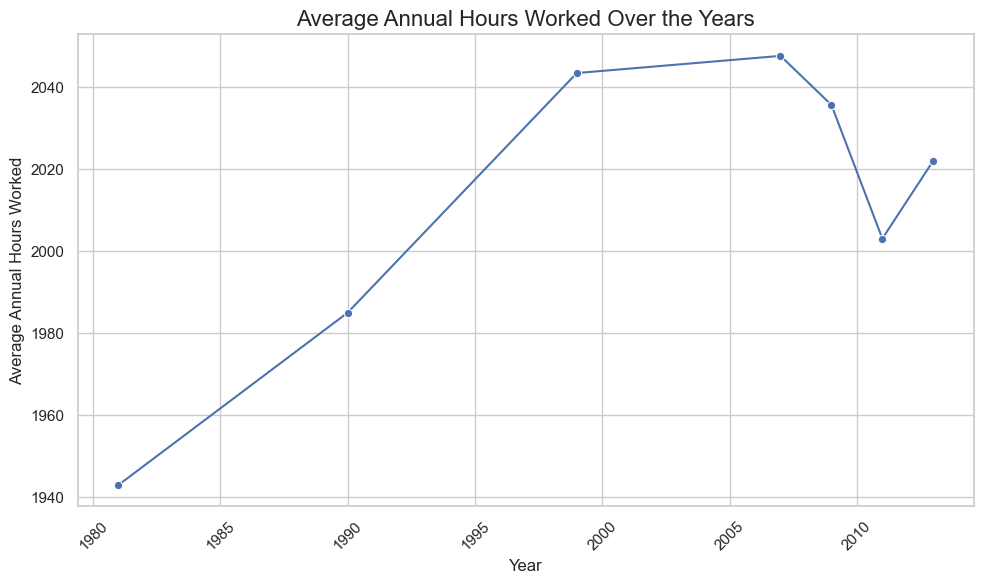

In [94]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [1999, 2000, 2001, 1999, 2000, 2001, 1999, 2000, 2001],
#     'annhrs': [2000, 2100, 2150, 1800, 1900, 2000, 2200, 2300, 2400]  # Example annual hours worked
# })

# Calculate average annual hours worked per year
avg_annhrs = processed.groupby('year')['annhrs'].mean().reset_index()

# Create a line plot
plt.figure(figsize=(10, 6))
sns.lineplot(data=avg_annhrs, x='year', y='annhrs', marker='o', palette='Set2')
plt.title('Average Annual Hours Worked Over the Years', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Average Annual Hours Worked', fontsize=12)
plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility

# Show the plot
plt.tight_layout()
plt.show()


/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/3814557309.py:19: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.lineplot(data=avg_incwageman, x='year', y='incwageman', marker='o', palette='Set2')


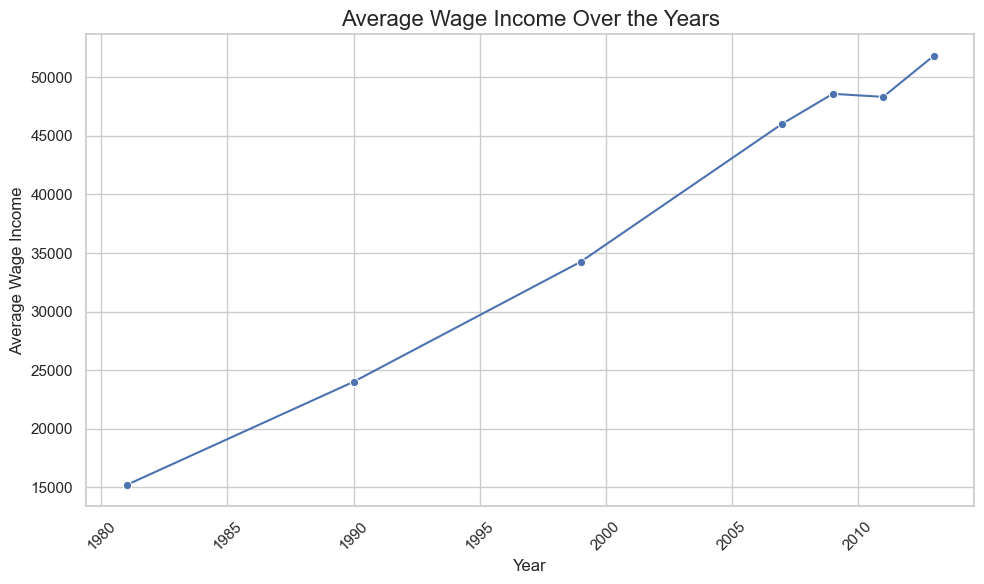

In [95]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [1999, 2000, 2001, 1999, 2000, 2001, 1999, 2000, 2001],
#     'incwageman': [30000, 35000, 32000, 40000, 42000, 45000, 31000, 33000, 34000]  # Example values
# })

# Calculate average wage income for males per year
avg_incwageman = processed.groupby('year')['incwageman'].mean().reset_index()

# Create a line plot
plt.figure(figsize=(10, 6))
sns.lineplot(data=avg_incwageman, x='year', y='incwageman', marker='o', palette='Set2')
plt.title('Average Wage Income Over the Years', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Average Wage Income', fontsize=12)
plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility

# Show the plotx
plt.tight_layout()
plt.show()


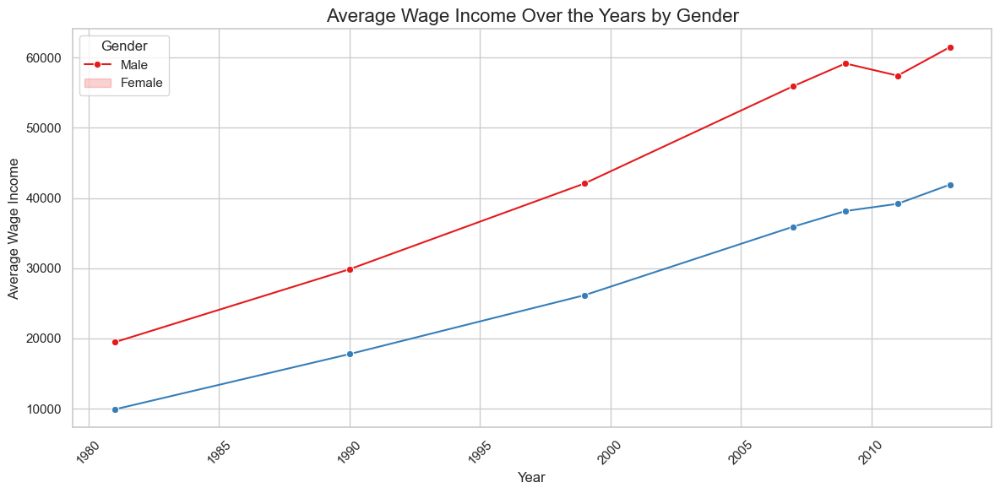

In [96]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [1999, 2000, 2001, 1999, 2000, 2001, 1999, 2000, 2001],
#     'incwage': [30000, 35000, 32000, 40000, 42000, 45000, 31000, 33000, 34000],  # Example incomes
#     'sex': [1, 1, 1, 2, 2, 2, 1, 2, 2]  # 1 for Male, 2 for Female
# })

# Rename income column for clarity
processed['incwage'] = processed['incwage']  # Assuming this is the wage income column

# Group by year and sex, then calculate the average income
avg_income = processed.groupby(['year', 'sex']).agg({'incwage': 'mean'}).reset_index()

# Create a line plot with separate lines for males and females
plt.figure(figsize=(12, 6))
sns.lineplot(data=avg_income, x='year', y='incwage', hue='sex', marker='o', palette='Set1')

# Customizing the legend
plt.title('Average Wage Income Over the Years by Gender', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Average Wage Income', fontsize=12)
plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility

# Clear and descriptive legend
plt.legend(title='Gender', labels=['Male', 'Female'])

# Show the plot
plt.tight_layout()
plt.show()


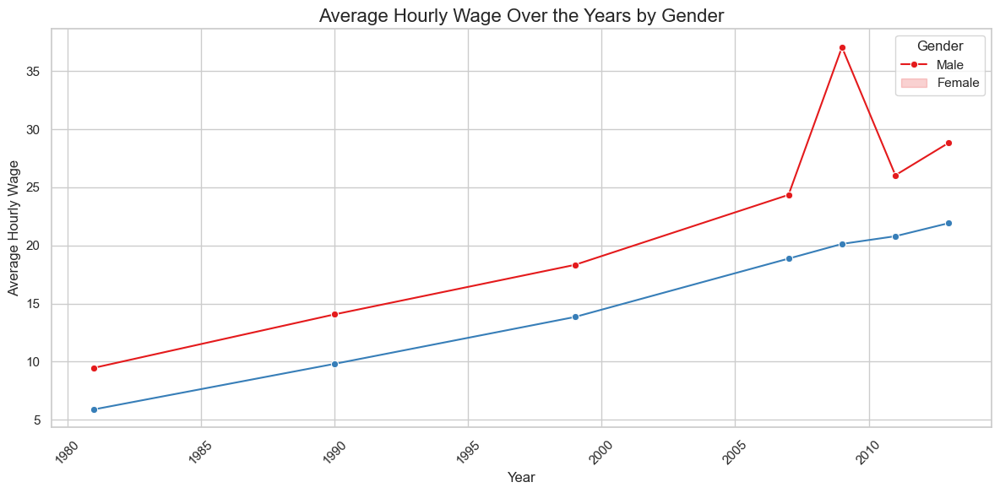

In [97]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [1999, 2000, 2001, 1999, 2000, 2001, 1999, 2000, 2001],
#     'hrwage': [15, 16, 17, 20, 21, 22, 18, 19, 20],  # Example hourly wages
#     'sex': [1, 1, 1, 2, 2, 2, 1, 2, 2]  # 1 for Male, 2 for Female
# })

# Rename hourly wage column for clarity
processed['hrwage'] = processed['hrwage']  # Assuming this is the hourly wage column

# Group by year and sex, then calculate the average hourly wage
avg_hourly_wage = processed.groupby(['year', 'sex']).agg({'hrwage': 'mean'}).reset_index()

# Create a line plot with separate lines for males and females
plt.figure(figsize=(12, 6))
sns.lineplot(data=avg_hourly_wage, x='year', y='hrwage', hue='sex', marker='o', palette='Set1')

# Customizing the legend
plt.title('Average Hourly Wage Over the Years by Gender', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Average Hourly Wage', fontsize=12)
plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility

# Clear and descriptive legend
plt.legend(title='Gender', labels=['Male', 'Female'])

# Show the plot
plt.tight_layout()
plt.show()


<Figure size 1200x600 with 0 Axes>

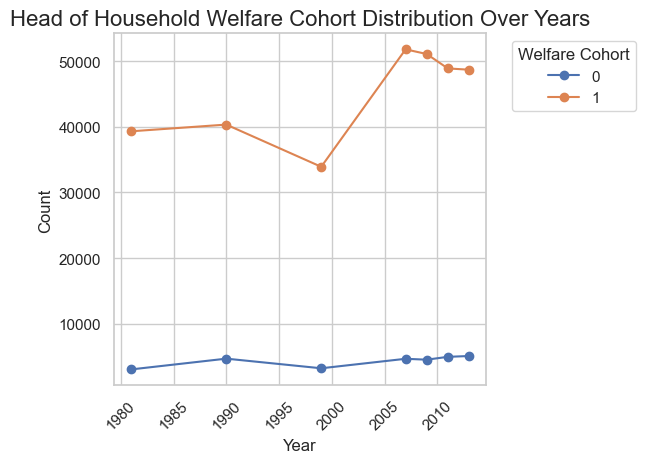

In [98]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [1999, 2000, 2001, 1999, 2000, 2001],
#     'hdwfcoh': [1, 2, 1, 2, 1, 3]  # Example values
# })

# Group by year and calculate the average or count of hdwfcoh
# You may need to adjust the aggregation method based on your data context
hdwfcoh_distribution = processed.groupby('year')['hdwfcoh'].value_counts().unstack(fill_value=0)

# Create a line plot
plt.figure(figsize=(12, 6))
hdwfcoh_distribution.plot(kind='line', marker='o')
plt.title('Head of Household Welfare Cohort Distribution Over Years', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Count', fontsize=12)
plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility
plt.legend(title='Welfare Cohort', bbox_to_anchor=(1.05, 1), loc='upper left')

# Show the plot
plt.tight_layout()
plt.show()


<Figure size 1200x600 with 0 Axes>

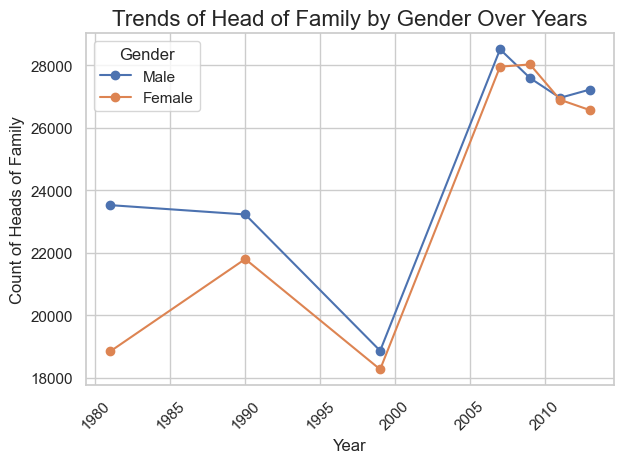

In [99]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Example DataFrame (assuming you already have this)
# processed = pd.DataFrame({
#     'year': [1999, 2000, 2001, 1999, 2000, 2001],
#     'hdwfcoh': [1, 2, 1, 1, 2, 1],  # Example values for head of family indicator
#     'sex': [1, 1, 1, 2, 2, 2]  # 1 for Male, 2 for Female
# })

# Group by year and sex, then count the number of heads of families
head_of_family_distribution = processed.groupby(['year', 'sex'])['hdwfcoh'].count().unstack(fill_value=0)

# Create a line plot
plt.figure(figsize=(12, 6))
head_of_family_distribution.plot(kind='line', marker='o')
plt.title('Trends of Head of Family by Gender Over Years', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Count of Heads of Family', fontsize=12)
plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility
plt.legend(title='Gender', labels=['Male', 'Female'])

# Show the plot
plt.tight_layout()
plt.show()


In [100]:
import pandas as pd

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Assuming 'processed' contains a column named 'industry' with encoded values (0, 1, ..., N)
industry_columns = [
    'Agriculture', 'miningconstruction', 'durables', 'nondurables', 
    'Transport', 'Utilities', 'Communications', 'retailtrade', 
    'wholesaletrade', 'finance', 'SocArtOther', 'hotelsrestaurants', 
    'Medical', 'Education', 'professional', 'publicadmin'
]

# Initialize a DataFrame to hold the counts of industries
industry_counts = processed['industry'].value_counts().reset_index()
industry_counts.columns = ['industry_code', 'count']

# Map industry codes to their names
industry_counts['industry_name'] = industry_counts['industry_code'].map(lambda x: industry_columns[x])

# Find the most and least occurring industries
most_occurring = industry_counts.loc[industry_counts['count'].idxmax()]
least_occurring = industry_counts.loc[industry_counts['count'].idxmin()]

# Print the results
print(f"Most Occurring Industry: {most_occurring['industry_name']} (Code: {most_occurring['industry_code']}), Count: {most_occurring['count']}")
print(f"Least Occurring Industry: {least_occurring['industry_name']} (Code: {least_occurring['industry_code']}), Count: {least_occurring['count']}")


Most Occurring Industry: Medical (Code: 12), Count: 39340
Least Occurring Industry: Agriculture (Code: 0), Count: 3220


In [101]:
import pandas as pd

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Assuming 'processed' contains a column named 'industry' with encoded values (0, 1, ..., N)
industry_columns = [
    'Agriculture', 'miningconstruction', 'durables', 'nondurables', 
    'Transport', 'Utilities', 'Communications', 'retailtrade', 
    'wholesaletrade', 'finance', 'SocArtOther', 'hotelsrestaurants', 
    'Medical', 'Education', 'professional', 'publicadmin'
]

# Group by year and count occurrences of each industry
for year, group in processed.groupby('year'):
    industry_counts = group['industry'].value_counts().reset_index()
    industry_counts.columns = ['industry_code', 'count']

    # Map industry codes to their names
    industry_counts['industry_name'] = industry_counts['industry_code'].map(lambda x: industry_columns[x])

    # Find the most and least occurring industries
    if not industry_counts.empty:
        most_occurring = industry_counts.loc[industry_counts['count'].idxmax()]
        least_occurring = industry_counts.loc[industry_counts['count'].idxmin()]

        # Print the results for the year
        print(f"Year: {year}")
        print(f"  Most Occurring Industry: {most_occurring['industry_name']} (Code: {most_occurring['industry_code']}), Count: {most_occurring['count']}")
        print(f"  Least Occurring Industry: {least_occurring['industry_name']} (Code: {least_occurring['industry_code']}), Count: {least_occurring['count']}")
        print()


Year: 1981
  Most Occurring Industry: durables (Code: 2), Count: 6102
  Least Occurring Industry: Agriculture (Code: 0), Count: 544

Year: 1990
  Most Occurring Industry: durables (Code: 2), Count: 5519
  Least Occurring Industry: Agriculture (Code: 0), Count: 433

Year: 1999
  Most Occurring Industry: durables (Code: 2), Count: 3976
  Least Occurring Industry: Agriculture (Code: 0), Count: 339

Year: 2007
  Most Occurring Industry: Medical (Code: 12), Count: 6650
  Least Occurring Industry: Agriculture (Code: 0), Count: 496

Year: 2009
  Most Occurring Industry: Medical (Code: 12), Count: 6981
  Least Occurring Industry: Agriculture (Code: 0), Count: 443

Year: 2011
  Most Occurring Industry: Medical (Code: 12), Count: 6850
  Least Occurring Industry: Agriculture (Code: 0), Count: 489

Year: 2013
  Most Occurring Industry: Medical (Code: 12), Count: 7017
  Least Occurring Industry: Agriculture (Code: 0), Count: 476



In [102]:
import pandas as pd

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

sex_names = ["meh", "Male", "Female"]
# Assuming 'processed' contains a column named 'industry' with encoded values (0, 1, ..., N)
industry_columns = [
    'Agriculture', 'miningconstruction', 'durables', 'nondurables', 
    'Transport', 'Utilities', 'Communications', 'retailtrade', 
    'wholesaletrade', 'finance', 'SocArtOther', 'hotelsrestaurants', 
    'Medical', 'Education', 'professional', 'publicadmin'
]

# Group by sex and year, then count occurrences of each industry
for sex, sex_group in processed.groupby('sex'):
    for year, group in sex_group.groupby('year'):
        industry_counts = group['industry'].value_counts().reset_index()
        industry_counts.columns = ['industry_code', 'count']

        # Map industry codes to their names
        industry_counts['industry_name'] = industry_counts['industry_code'].map(lambda x: industry_columns[x])

        # Sort the counts in descending order
        industry_counts = industry_counts.sort_values(by='count', ascending=False)

        # Print the results for the year and gender
        print(f"Year: {year} | Sex: {sex_names[sex]}")
        for index, row in industry_counts.iterrows():
            print(f"  Industry: {row['industry_name']} (Code: {row['industry_code']}), Count: {row['count']}")
        print()


Year: 1981 | Sex: Male
  Industry: durables (Code: 2), Count: 4503
  Industry: miningconstruction (Code: 1), Count: 2579
  Industry: nondurables (Code: 3), Count: 2310
  Industry: retailtrade (Code: 7), Count: 1806
  Industry: publicadmin (Code: 15), Count: 1650
  Industry: Transport (Code: 4), Count: 1593
  Industry: Education (Code: 13), Count: 1472
  Industry: wholesaletrade (Code: 8), Count: 1383
  Industry: professional (Code: 14), Count: 1226
  Industry: SocArtOther (Code: 10), Count: 1012
  Industry: finance (Code: 9), Count: 998
  Industry: Medical (Code: 12), Count: 808
  Industry: Communications (Code: 6), Count: 642
  Industry: hotelsrestaurants (Code: 11), Count: 593
  Industry: Utilities (Code: 5), Count: 505
  Industry: Agriculture (Code: 0), Count: 447

Year: 1990 | Sex: Male
  Industry: durables (Code: 2), Count: 3980
  Industry: miningconstruction (Code: 1), Count: 2472
  Industry: nondurables (Code: 3), Count: 2120
  Industry: retailtrade (Code: 7), Count: 1954
  Indu

In [103]:
import pandas as pd

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

sex_names = ["meh", "Male", "Female"]


# Group by sex and year, then count occurrences of each occupation
for sex, sex_group in processed.groupby('sex'):
    for year, group in sex_group.groupby('year'):
        occupation_counts = group['occupation'].value_counts().reset_index()
        occupation_counts.columns = ['occupation_code', 'count']

        # Map occupation codes to their names
        occupation_counts['occupation_name'] = occupation_counts['occupation_code'].map(lambda x: occupation_columns[x])

        # Sort the counts in descending order
        occupation_counts = occupation_counts.sort_values(by='count', ascending=False)

        # Print the results for the year and gender
        print(f"Year: {year} | Sex: {sex_names[sex]}")
        for index, row in occupation_counts.iterrows():
            print(f"  Occupation: {row['occupation_name']} (Code: {row['occupation_code']}), Count: {row['count']}")
        print()


Year: 1981 | Sex: Male
  Occupation: production (Code: 19), Count: 4154
  Occupation: constructextractinstall (Code: 21), Count: 3930
  Occupation: manager (Code: 0), Count: 3494
  Occupation: transport (Code: 20), Count: 2390
  Occupation: officeadmin (Code: 17), Count: 1454
  Occupation: sales (Code: 16), Count: 1313
  Occupation: architect (Code: 4), Count: 1196
  Occupation: building (Code: 15), Count: 698
  Occupation: protective (Code: 13), Count: 638
  Occupation: legaleduc (Code: 8), Count: 593
  Occupation: foodcare (Code: 14), Count: 481
  Occupation: business (Code: 1), Count: 364
  Occupation: scientist (Code: 5), Count: 363
  Occupation: farmer (Code: 18), Count: 333
  Occupation: computer (Code: 3), Count: 329
  Occupation: lawyerphysician (Code: 10), Count: 327
  Occupation: financialop (Code: 2), Count: 302
  Occupation: socialworker (Code: 6), Count: 293
  Occupation: artist (Code: 9), Count: 286
  Occupation: healthcare (Code: 11), Count: 278
  Occupation: postseceduc

In [104]:
import pandas as pd

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

sex_names = ["meh", "Male", "Female"]
education_columns = [
    'No school', '1st-4th grade', '5th-8th grade', '9th grade', 
    '10th grade', '11th grade', '12th grade', 'High school', 
    'Some college', 'Associate degree', 'Bachelor\'s degree', 
    'Master\'s degree', 'Professional degree', 'Doctorate'
]

# Group by sex and year, then count occurrences of each education level
for sex, sex_group in processed.groupby('sex'):
    for year, group in sex_group.groupby('year'):
        education_counts = group['educ99'].value_counts().reset_index()
        education_counts.columns = ['education_code', 'count']

        # Check unique education codes
        unique_codes = education_counts['education_code'].unique()
        print(f"Unique education codes for Year: {year} | Sex: {sex_names[sex]}: {unique_codes}")

        # Convert education_code to integers
        education_counts['education_code'] = education_counts['education_code'].astype(int)

        # Map education codes to their names
        education_counts['education_name'] = education_counts['education_code'].map(
            lambda x: education_columns[x - 1] if 1 <= x <= len(education_columns) else 'Unknown'
        )

        # Sort the counts in descending order
        education_counts = education_counts.sort_values(by='count', ascending=False)

        # Print the results for the year and gender
        print(f"Year: {year} | Sex: {sex_names[sex]}")
        for index, row in education_counts.iterrows():
            print(f"  Education Level: {row['education_name']} (Code: {row['education_code']}), Count: {row['count']}")
        print()


Unique education codes for Year: 1981 | Sex: Male: [10.]
Year: 1981 | Sex: Male
  Education Level: Associate degree (Code: 10), Count: 23527

Unique education codes for Year: 1990 | Sex: Male: [10.]
Year: 1990 | Sex: Male
  Education Level: Associate degree (Code: 10), Count: 23229

Unique education codes for Year: 1999 | Sex: Male: [10. 15. 11. 16. 13.  5. 14.  8.  7. 17.  6. 18.  9.  4.  1.]
Year: 1999 | Sex: Male
  Education Level: Associate degree (Code: 10), Count: 5920
  Education Level: Unknown (Code: 15), Count: 3682
  Education Level: Bachelor's degree (Code: 11), Count: 3432
  Education Level: Unknown (Code: 16), Count: 1218
  Education Level: Professional degree (Code: 13), Count: 902
  Education Level: 10th grade (Code: 5), Count: 738
  Education Level: Doctorate (Code: 14), Count: 724
  Education Level: High school (Code: 8), Count: 468
  Education Level: 12th grade (Code: 7), Count: 423
  Education Level: Unknown (Code: 17), Count: 312
  Education Level: 11th grade (Code:

/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/170541279.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=region_hwtsupp, x='region_label', y='hwtsupp', palette="viridis")


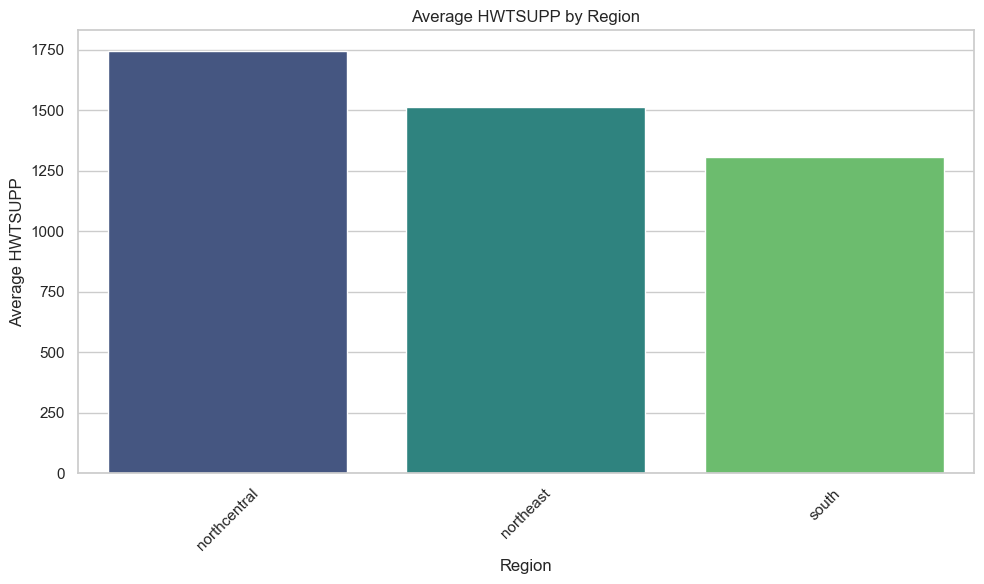

In [105]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Define the region mapping
# region_columns = ['northeast', 'northcentral', 'south', 'west']
region_mapping = {1: 'northeast', 2: 'northcentral', 3: 'south', 4: 'west', 5:  'None'}

# Map the region codes in the dataset
processed['region_label'] = processed['region'].map(region_mapping)

# Calculate the mean of `hwtsupp` for each region
region_hwtsupp = processed.groupby('region_label')['hwtsupp'].mean().reset_index()

# Plotting
plt.figure(figsize=(10, 6))
sns.barplot(data=region_hwtsupp, x='region_label', y='hwtsupp', palette="viridis")

# Customize the plot
plt.title("Average HWTSUPP by Region")
plt.xlabel("Region")
plt.ylabel("Average HWTSUPP")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/3861432038.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='pernum', y='hwtsupp', data=processed, palette="viridis")


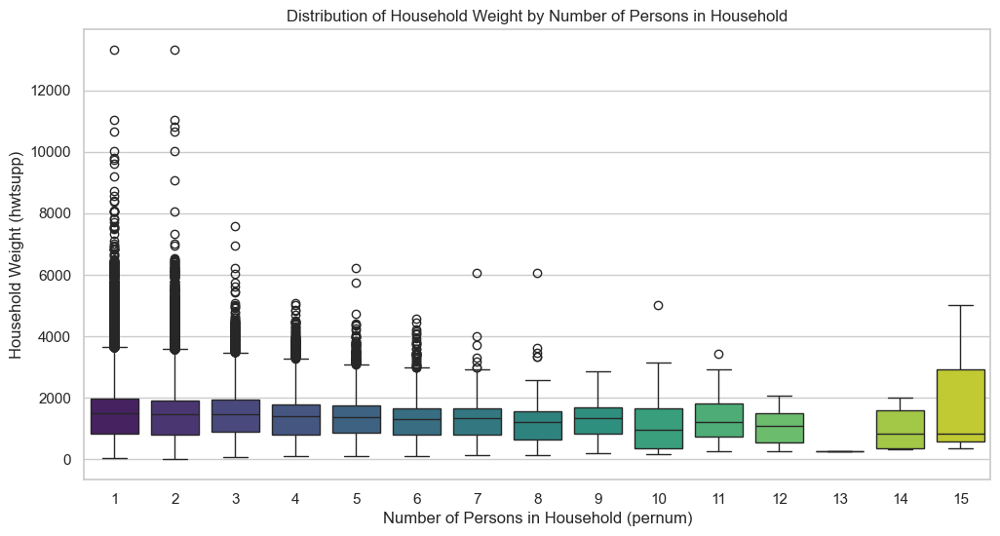

In [106]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create a box plot for hwtsupp distribution by the number of persons in household (pernum)
plt.figure(figsize=(12, 6))
sns.boxplot(x='pernum', y='hwtsupp', data=processed, palette="viridis")
plt.xlabel('Number of Persons in Household (pernum)')
plt.ylabel('Household Weight (hwtsupp)')
plt.title('Distribution of Household Weight by Number of Persons in Household')
plt.show()



/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/1640858556.py:20: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x='relate_label', y='hwtsupp', data=sorted_data, ci=None)


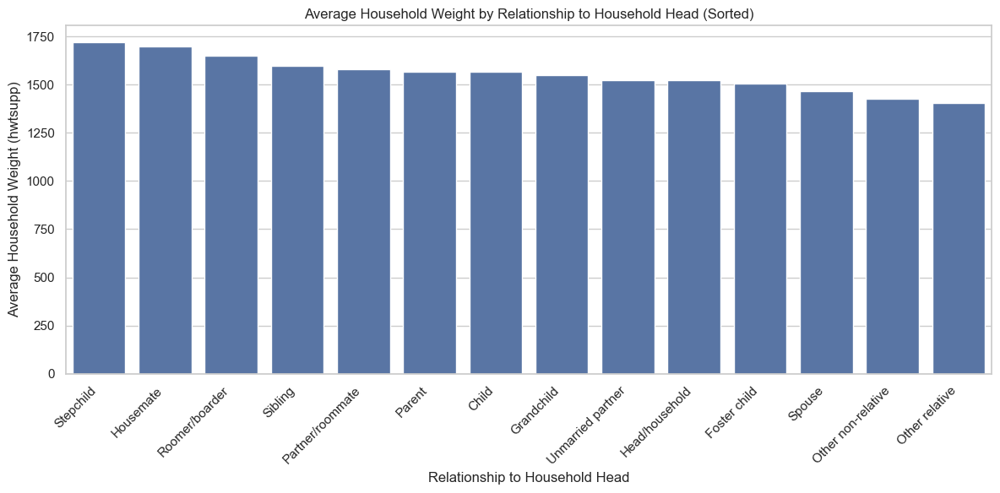

In [107]:
import matplotlib.pyplot as plt
import seaborn as sns

# Mapping the relationship codes to descriptive labels
relate_labels = {
    101: 'Head/household', 201: 'Spouse', 301: 'Child', 303: 'Stepchild', 501: 'Parent', 
    701: 'Sibling', 901: 'Grandchild', 1001: 'Other relative', 1113: 'Partner/roommate', 
    1114: 'Unmarried partner', 1115: 'Housemate', 1241: 'Roomer/boarder', 
    1242: 'Foster child', 1260: 'Other non-relative'
}

# Map the `relate` column to human-readable labels
processed['relate_label'] = processed['relate'].map(relate_labels)

# Calculate the mean household weight for each relationship type and sort it
sorted_data = processed.groupby('relate_label')['hwtsupp'].mean().sort_values(ascending=False).reset_index()

# Plotting the sorted bar plot
plt.figure(figsize=(12, 6))
sns.barplot(x='relate_label', y='hwtsupp', data=sorted_data, ci=None)
plt.xticks(rotation=45, ha='right')
plt.xlabel('Relationship to Household Head')
plt.ylabel('Average Household Weight (hwtsupp)')
plt.title('Average Household Weight by Relationship to Household Head (Sorted)')
plt.tight_layout()
plt.show()


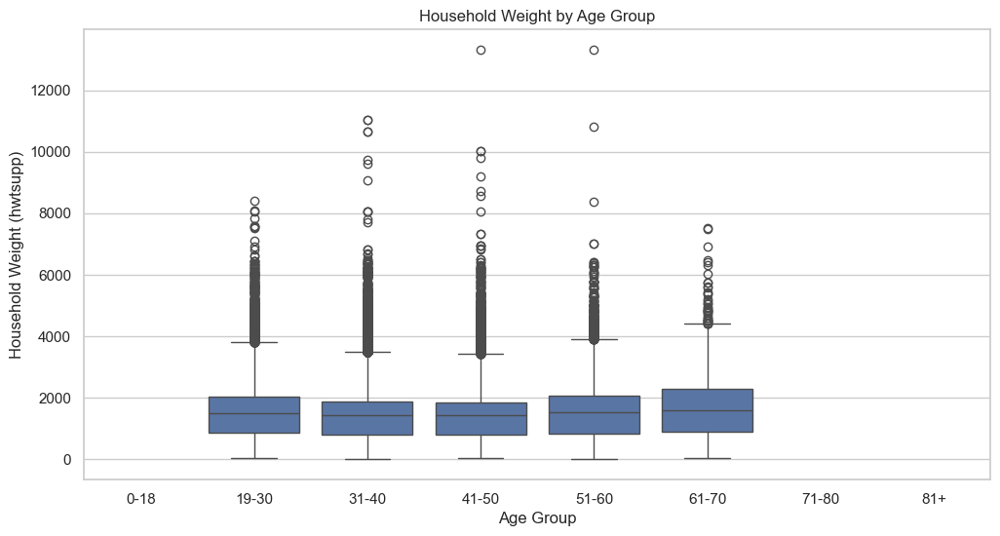

In [108]:
# Define age bins
age_bins = [0, 18, 30, 40, 50, 60, 70, 80, 100]
age_labels = ['0-18', '19-30', '31-40', '41-50', '51-60', '61-70', '71-80', '81+']
processed['age_group'] = pd.cut(processed['age'], bins=age_bins, labels=age_labels, right=False)

# Plot
plt.figure(figsize=(12, 6))
sns.boxplot(data=processed, x='age_group', y='hwtsupp')
plt.xlabel('Age Group')
plt.ylabel('Household Weight (hwtsupp)')
plt.title('Household Weight by Age Group')
plt.show()


/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/2882424231.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='marital_status_name', y='hwtsupp', data=avg_hwtsupp_by_marital_status, palette='viridis')


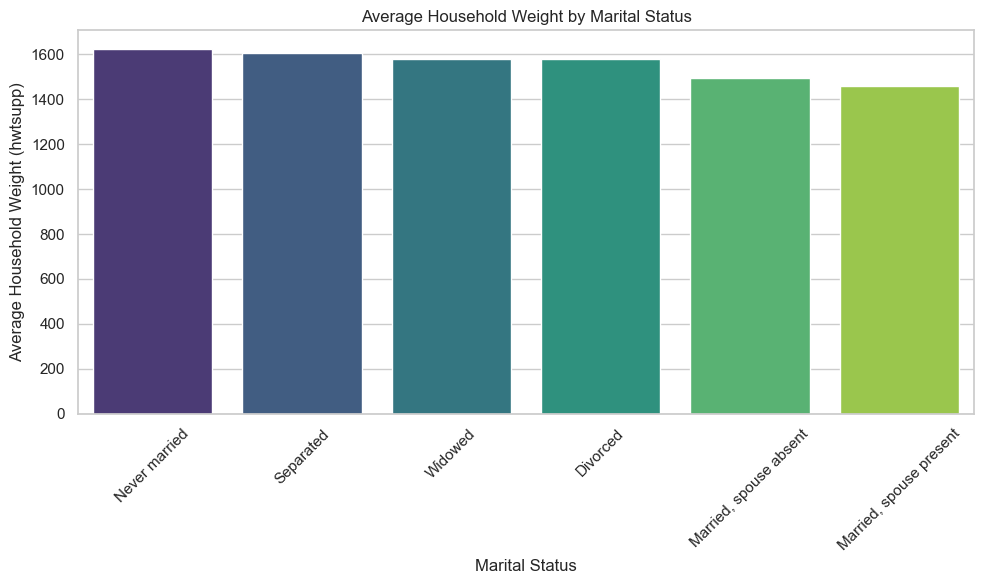

In [109]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Assuming 'marital_status' column exists in 'processed'
# Updated mapping of marital status codes to names
marital_status_mapping = {
    1: 'Married, spouse present',
    2: 'Married, spouse absent',
    3: 'Separated',
    4: 'Divorced',
    5: 'Widowed',
    6: 'Never married'
}

# Add a new column for marital status names
processed['marital_status_name'] = processed['marst'].map(marital_status_mapping)

# Group by marital status and calculate the average household weight
avg_hwtsupp_by_marital_status = processed.groupby('marital_status_name')['hwtsupp'].mean().reset_index()

# Sort values for better visualization
avg_hwtsupp_by_marital_status = avg_hwtsupp_by_marital_status.sort_values(by='hwtsupp', ascending=False)

# Plotting the relationship
plt.figure(figsize=(10, 6))
sns.barplot(x='marital_status_name', y='hwtsupp', data=avg_hwtsupp_by_marital_status, palette='viridis')
plt.title('Average Household Weight by Marital Status')
plt.xlabel('Marital Status')
plt.ylabel('Average Household Weight (hwtsupp)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/1453914153.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='nativity_name', y='hwtsupp', data=avg_hwtsupp_by_nativity, palette='coolwarm')


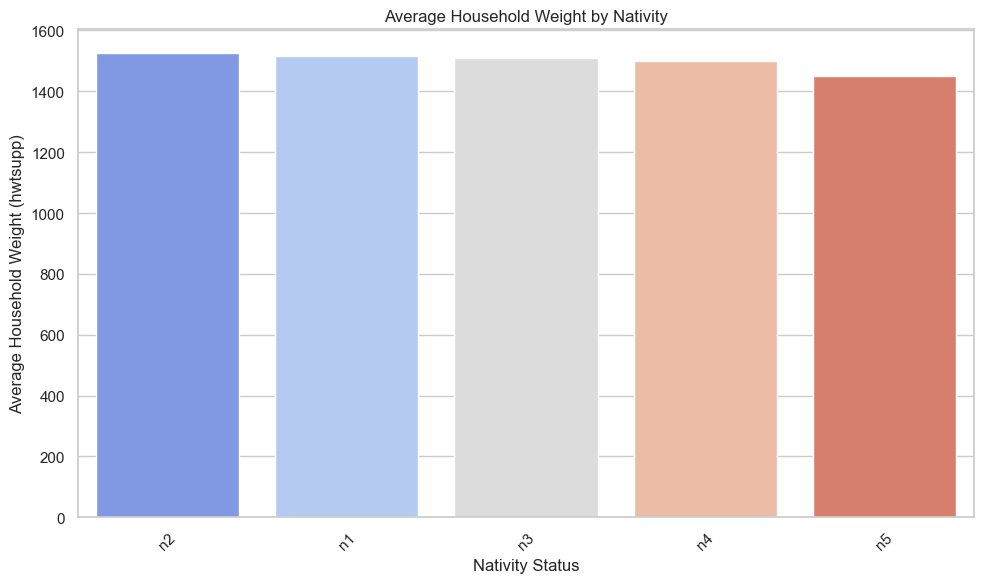

In [110]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Sample data loading (replace with your actual dataset)
# processed = pd.read_csv('your_dataset.csv')

# Assuming 'nativity' column exists in 'processed'
# Example mapping for nativity (modify as per your dataset)
nativity_mapping = {
    1: 'n1',
    2: 'n2',
    3: 'n3',
    4: 'n4',
    5: 'n5',
    6: 'n6'
}

# Add a new column for nativity names
processed['nativity_name'] = processed['nativity'].map(nativity_mapping)

# Group by nativity and calculate the average household weight
avg_hwtsupp_by_nativity = processed.groupby('nativity_name')['hwtsupp'].mean().reset_index()

# Sort values for better visualization
avg_hwtsupp_by_nativity = avg_hwtsupp_by_nativity.sort_values(by='hwtsupp', ascending=False)

# Plotting the relationship
plt.figure(figsize=(10, 6))
sns.barplot(x='nativity_name', y='hwtsupp', data=avg_hwtsupp_by_nativity, palette='coolwarm')
plt.title('Average Household Weight by Nativity')
plt.xlabel('Nativity Status')
plt.ylabel('Average Household Weight (hwtsupp)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


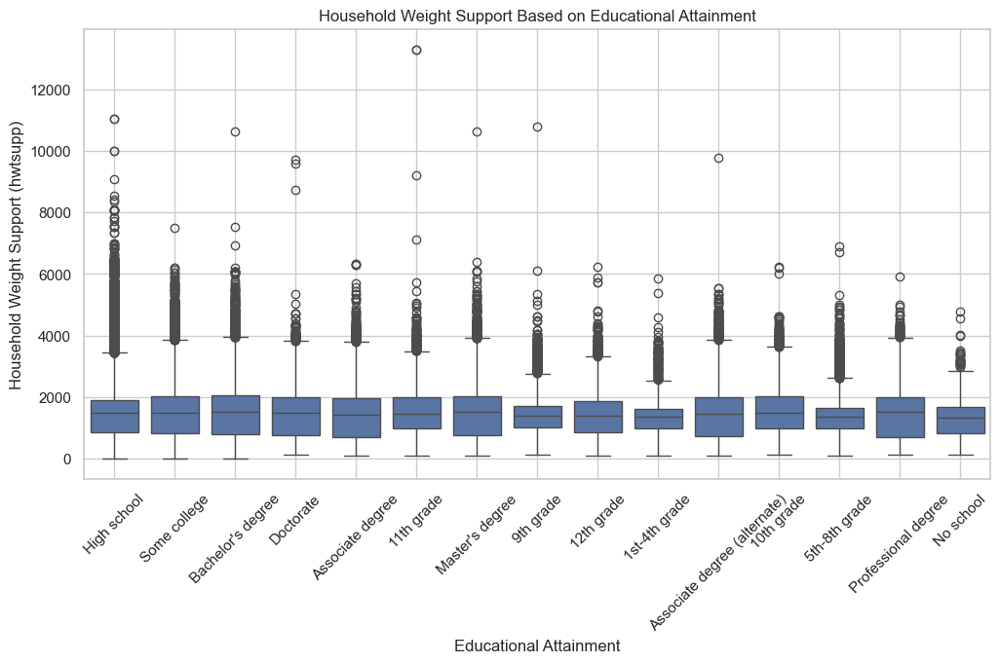

In [111]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


# Create a list of corresponding education labels for the x-axis
education_labels = {
    1: 'No school',
    4: '1st-4th grade',
    5: '5th-8th grade',
    6: '9th grade',
    7: '10th grade',
    8: '11th grade',
    9: '12th grade',
    10: 'High school',
    11: 'Some college',
    13: 'Associate degree',
    14: 'Associate degree (alternate)',
    15: 'Bachelor\'s degree',
    16: 'Master\'s degree',
    17: 'Professional degree',
    18: 'Doctorate'
}

# Create a new column in processed that maps the codes to labels
# However, we will not alter processed, just prepare labels for the plot
processed['educ_labels'] = processed['educ99'].map(education_labels)

# Create a box plot
plt.figure(figsize=(12, 6))
sns.boxplot(x='educ_labels', y='hwtsupp', data=processed)
plt.title('Household Weight Support Based on Educational Attainment')
plt.xlabel('Educational Attainment')
plt.ylabel('Household Weight Support (hwtsupp)')
plt.xticks(rotation=45)
plt.grid(True)
plt.show()


/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/3840411821.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='hrswork_bins', data=processed, palette='viridis')


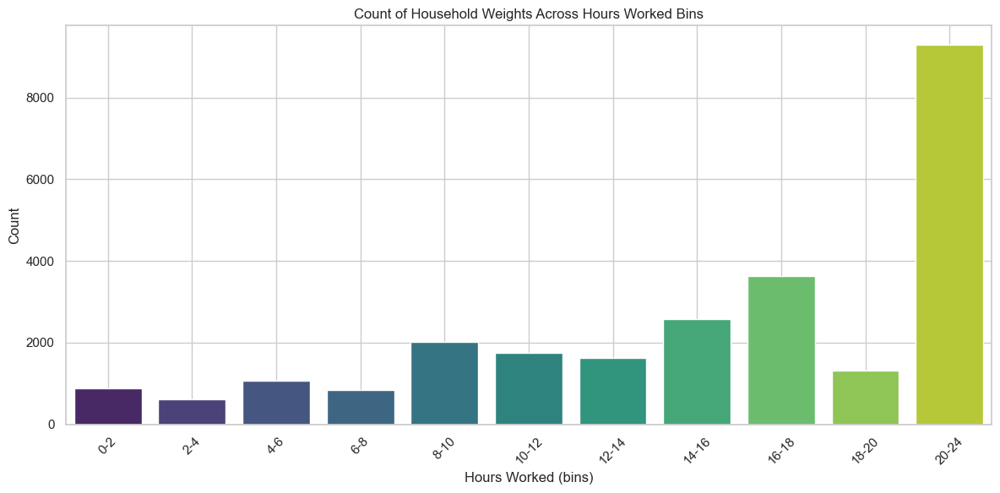

In [112]:
# Create a new column for the binned hours worked
processed['hrswork_bins'] = pd.cut(processed['hrswork'], bins=bins, labels=labels, right=False)

# Create the count plot
plt.figure(figsize=(12, 6))
sns.countplot(x='hrswork_bins', data=processed, palette='viridis')
plt.title('Count of Household Weights Across Hours Worked Bins')
plt.xlabel('Hours Worked (bins)')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/2920035573.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  avg_hwtsupp = processed.groupby('hrswork_bins')['hwtsupp'].mean().reset_index()
/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/2920035573.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='hrswork_bins', y='hwtsupp', data=avg_hwtsupp, palette='viridis')


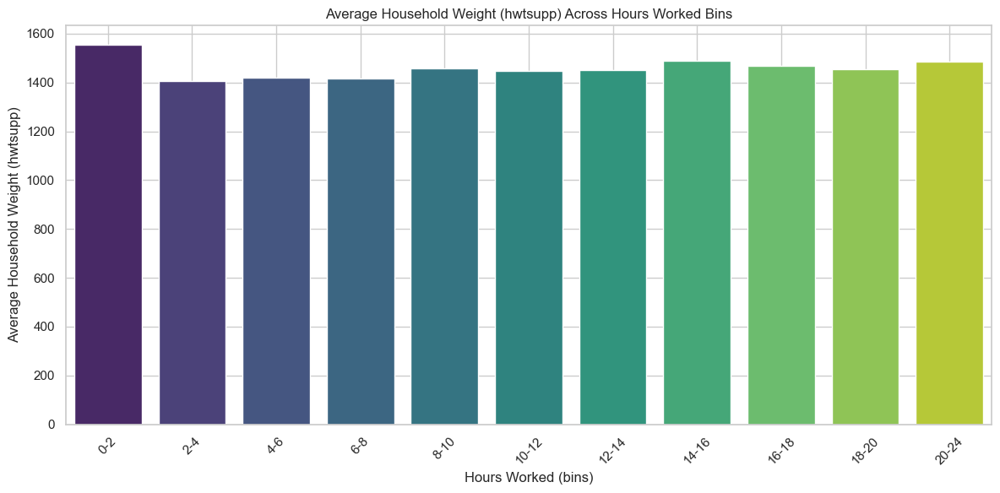

In [113]:
# Create a new column for the binned hours worked
processed['hrswork_bins'] = pd.cut(processed['hrswork'], bins=bins, labels=labels, right=False)

# Calculate the average hwtsupp for each bin
avg_hwtsupp = processed.groupby('hrswork_bins')['hwtsupp'].mean().reset_index()

# Sort the bins in the specified order
avg_hwtsupp['hrswork_bins'] = pd.Categorical(avg_hwtsupp['hrswork_bins'], categories=labels, ordered=True)
avg_hwtsupp = avg_hwtsupp.sort_values('hrswork_bins')

# Create the bar plot for average hwtsupp
plt.figure(figsize=(12, 6))
sns.barplot(x='hrswork_bins', y='hwtsupp', data=avg_hwtsupp, palette='viridis')
plt.title('Average Household Weight (hwtsupp) Across Hours Worked Bins')
plt.xlabel('Hours Worked (bins)')
plt.ylabel('Average Household Weight (hwtsupp)')
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

In [114]:
# Calculate average hwtsupp for Hispanic and Non-Hispanic individuals
avg_hwtsupp_hispanic = processed[processed['hisp'] == 1]['hwtsupp'].mean()
avg_hwtsupp_non_hispanic = processed[processed['hisp'] == 0]['hwtsupp'].mean()

# Print the results
print(f"Average Household Weight (hwtsupp) for Hispanic individuals: {avg_hwtsupp_hispanic:.2f}")
print(f"Average Household Weight (hwtsupp) for Non-Hispanic individuals: {avg_hwtsupp_non_hispanic:.2f}")

Average Household Weight (hwtsupp) for Hispanic individuals: 1245.15
Average Household Weight (hwtsupp) for Non-Hispanic individuals: 1551.09


In [115]:
avg_hwtsupp_male = processed[processed['sex'] == 1]['hwtsupp'].mean()
avg_hwtsupp_female = processed[processed['sex'] == 2]['hwtsupp'].mean()

# Print the results
print(f"Average Household Weight (hwtsupp) for Males: {avg_hwtsupp_male:.2f}")
print(f"Average Household Weight (hwtsupp) for Females: {avg_hwtsupp_female:.2f}")

Average Household Weight (hwtsupp) for Males: 1507.32
Average Household Weight (hwtsupp) for Females: 1507.28


/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/3156079199.py:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  avg_hwtsupp = processed.groupby('hrwage_bins')['hwtsupp'].mean().reset_index()


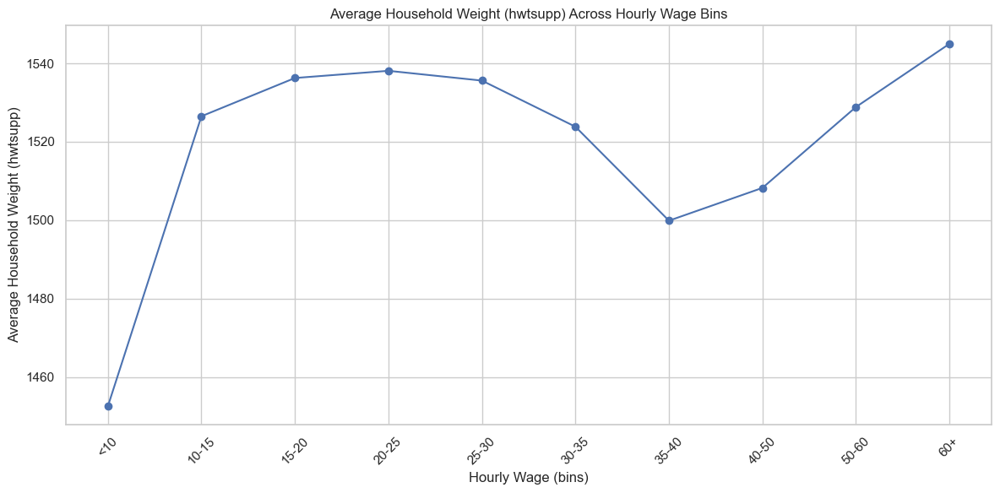

In [116]:
# Define the bins and labels for hourly wage
bins = [0, 10, 15, 20, 25, 30, 35, 40, 50, 60, float('inf')]
labels = ['<10', '10-15', '15-20', '20-25', '25-30', '30-35', '35-40', '40-50', '50-60', '60+']

# Create a new column for the binned hourly wage
processed['hrwage_bins'] = pd.cut(processed['hrwage'], bins=bins, labels=labels, right=False)

# Calculate the average hwtsupp for each bin
avg_hwtsupp = processed.groupby('hrwage_bins')['hwtsupp'].mean().reset_index()

# Create the line plot for average hwtsupp
plt.figure(figsize=(12, 6))
plt.plot(avg_hwtsupp['hrwage_bins'], avg_hwtsupp['hwtsupp'], marker='o', linestyle='-')
plt.title('Average Household Weight (hwtsupp) Across Hourly Wage Bins')
plt.xlabel('Hourly Wage (bins)')
plt.ylabel('Average Household Weight (hwtsupp)')
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

In [117]:
import pandas as pd

# Sample DataFrame (replace with actual DataFrame)
# processed = pd.DataFrame({
#     'hwtsupp': [10, 20, 15, 30, 25, 35, 40]  # Example household weight support values
# })

# Calculate the average of hwtsupp
avg_hwtsupp = processed['hwtsupp'].mean()
avg_hwtsupp


np.float64(1507.3002362766626)

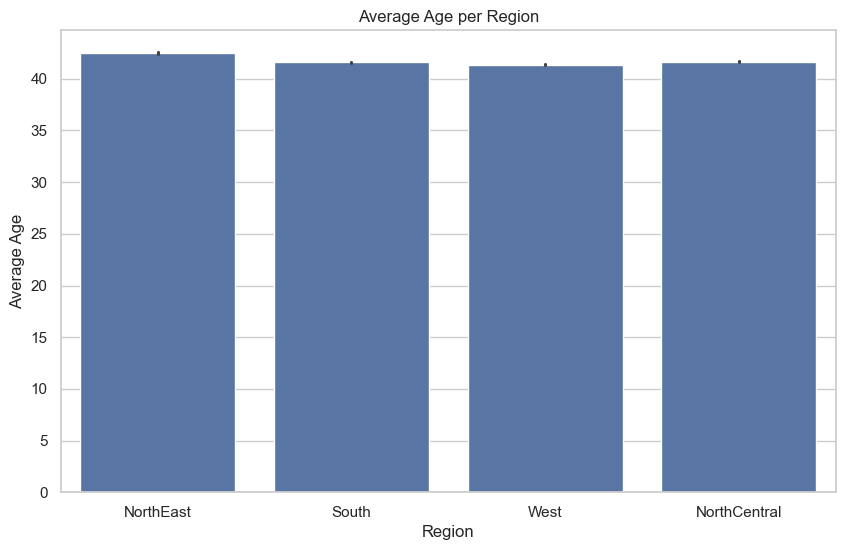

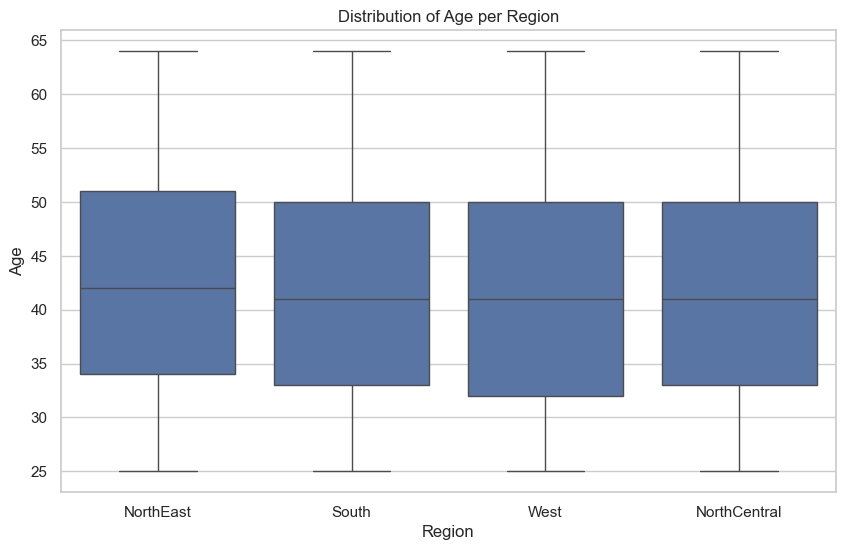

In [122]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define the region encodes
region_encodes = {0: 'NorthEast', 1: 'NorthCentral', 2: 'South', 3: 'West'}

# Map the numeric codes in the 'region' column to their labels
processed['region_label'] = processed['region'].map(region_encodes)

# Bar Plot: Mean age per region with labels
plt.figure(figsize=(10, 6))
sns.barplot(x='region_label', y='age', data=processed, estimator='mean')
plt.xlabel("Region")
plt.ylabel("Average Age")
plt.title("Average Age per Region")
plt.show()

# Box Plot: Distribution of age by region with labels
plt.figure(figsize=(10, 6))
sns.boxplot(x='region_label', y='age', data=processed)
plt.xlabel("Region")
plt.ylabel("Age")
plt.title("Distribution of Age per Region")
plt.show()


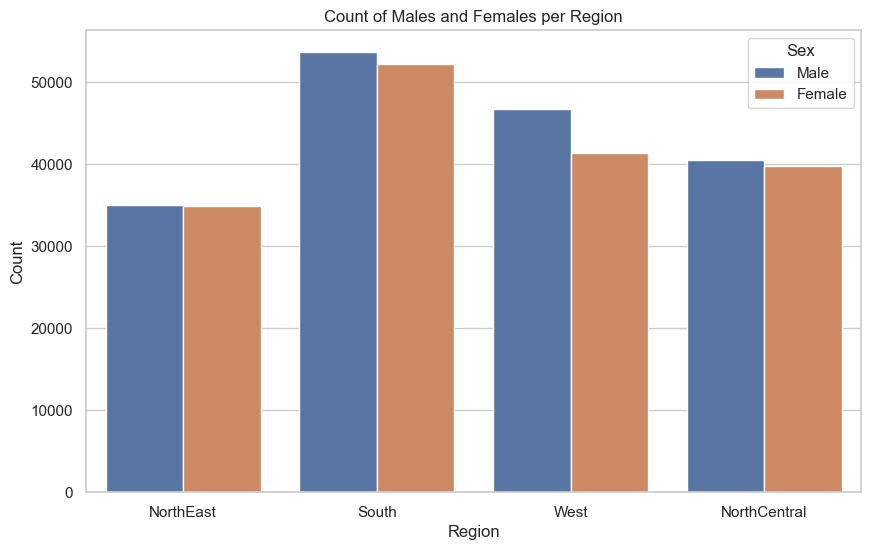

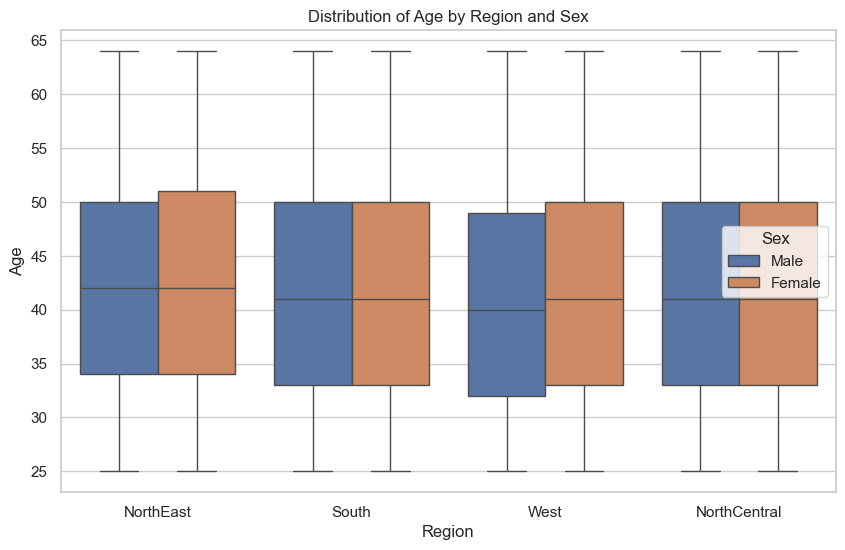

In [123]:
import matplotlib.pyplot as plt
import seaborn as sns


sex_encodes = {1: 'Male', 2: 'Female'}

# Map the numeric codes in the 'region' and 'sex' columns to their labels
processed['sex_label'] = processed['sex'].map(sex_encodes)

# Count Plot: Number of entries per sex in each region
plt.figure(figsize=(10, 6))
sns.countplot(x='region_label', hue='sex_label', data=processed)
plt.xlabel("Region")
plt.ylabel("Count")
plt.title("Count of Males and Females per Region")
plt.legend(title="Sex")
plt.show()

# Box Plot: Distribution of age by region and sex
plt.figure(figsize=(10, 6))
sns.boxplot(x='region_label', y='age', hue='sex_label', data=processed)
plt.xlabel("Region")
plt.ylabel("Age")
plt.title("Distribution of Age by Region and Sex")
plt.legend(title="Sex")
plt.show()


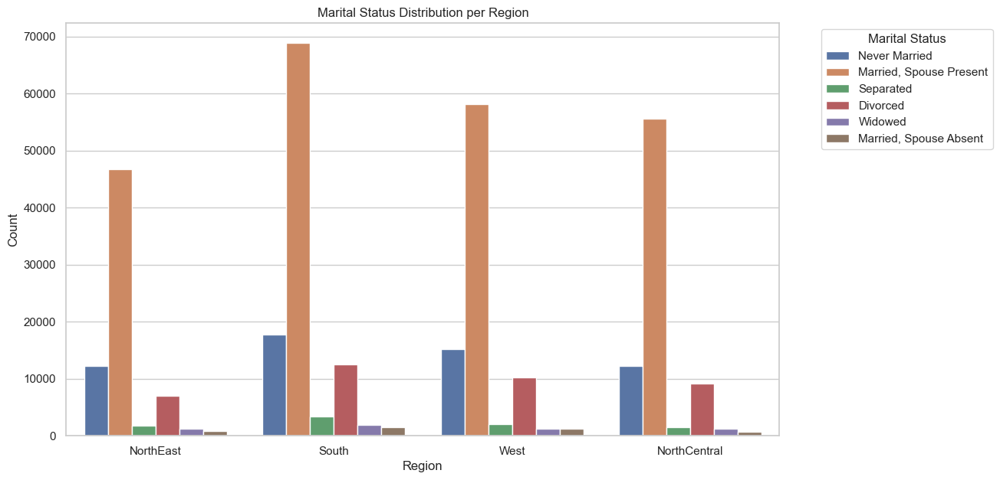

In [124]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define mappings for region and marital status
region_encodes = {0: 'NorthEast', 1: 'NorthCentral', 2: 'South', 3: 'West'}
marst_encodes = {
    1: 'Married, Spouse Present',
    2: 'Married, Spouse Absent',
    3: 'Separated',
    4: 'Divorced',
    5: 'Widowed',
    6: 'Never Married'
}

# Map the numeric codes to their labels
processed['region_label'] = processed['region'].map(region_encodes)
processed['marst_label'] = processed['marst'].map(marst_encodes)

# Count Plot: Marital status by region
plt.figure(figsize=(12, 7))
sns.countplot(x='region_label', hue='marst_label', data=processed)
plt.xlabel("Region")
plt.ylabel("Count")
plt.title("Marital Status Distribution per Region")
plt.legend(title="Marital Status", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


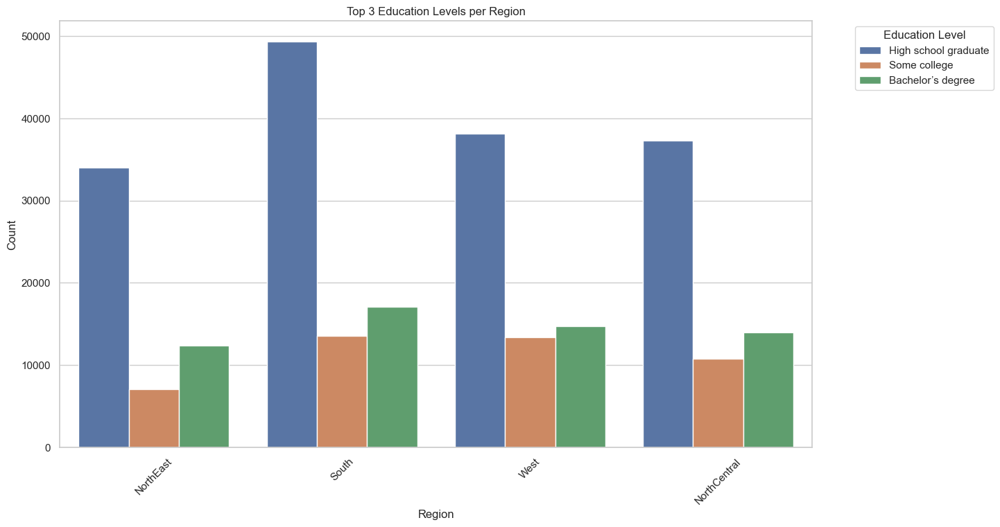

In [128]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define mappings for region and education levels
region_encodes = {0: 'NorthEast', 1: 'NorthCentral', 2: 'South', 3: 'West'}
educ99_encodes = {
    1: 'No school', 4: '1st-4th grade', 5: '5th-8th grade', 6: '9th grade',
    7: '10th grade', 8: '11th grade', 9: '12th grade', 10: 'High school graduate',
    11: 'Some college', 13: 'Associate degree', 14: 'Associate degree (type 2)',
    15: 'Bachelor’s degree', 16: 'Master’s degree', 17: 'Professional degree', 18: 'Doctorate'
}

# Map numeric codes to readable labels
processed['region_label'] = processed['region'].map(region_encodes)
processed['educ99_label'] = processed['educ99'].map(educ99_encodes)

# Get the top 3 education levels per region based on counts
top_education_levels = (
    processed.groupby(['region_label', 'educ99_label'])
    .size()
    .reset_index(name='count')
    .sort_values(['region_label', 'count'], ascending=[True, False])
    .groupby('region_label')
    .head(3)
)

# Filter the original dataset to include only the top 3 education levels per region
filtered_data = processed.merge(top_education_levels[['region_label', 'educ99_label']], on=['region_label', 'educ99_label'])

# Count Plot: Top 3 Education levels by region
plt.figure(figsize=(14, 8))
sns.countplot(x='region_label', hue='educ99_label', data=filtered_data)
plt.xlabel("Region")
plt.ylabel("Count")
plt.title("Top 3 Education Levels per Region")
plt.legend(title="Education Level", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.show()


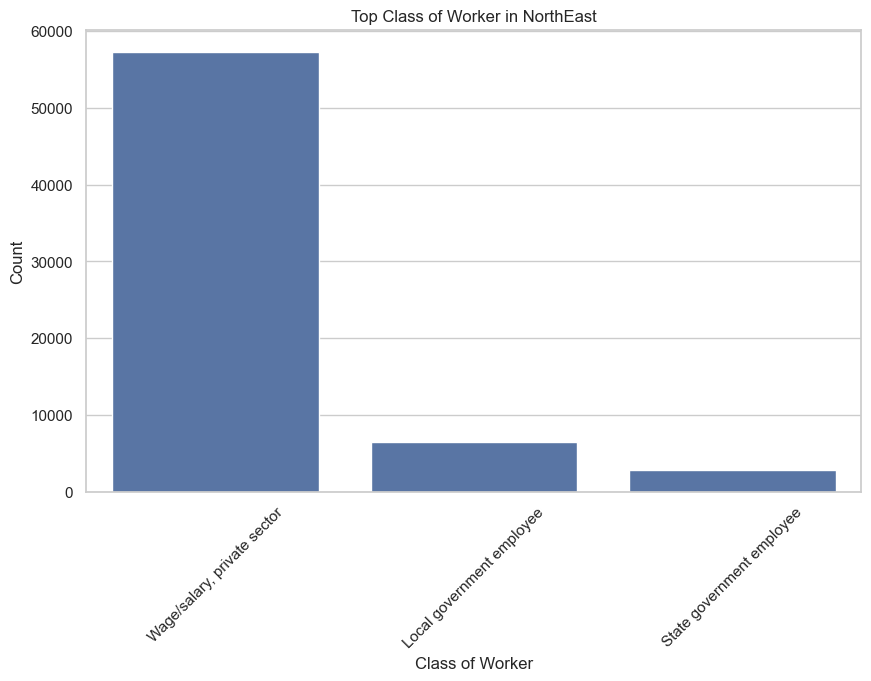

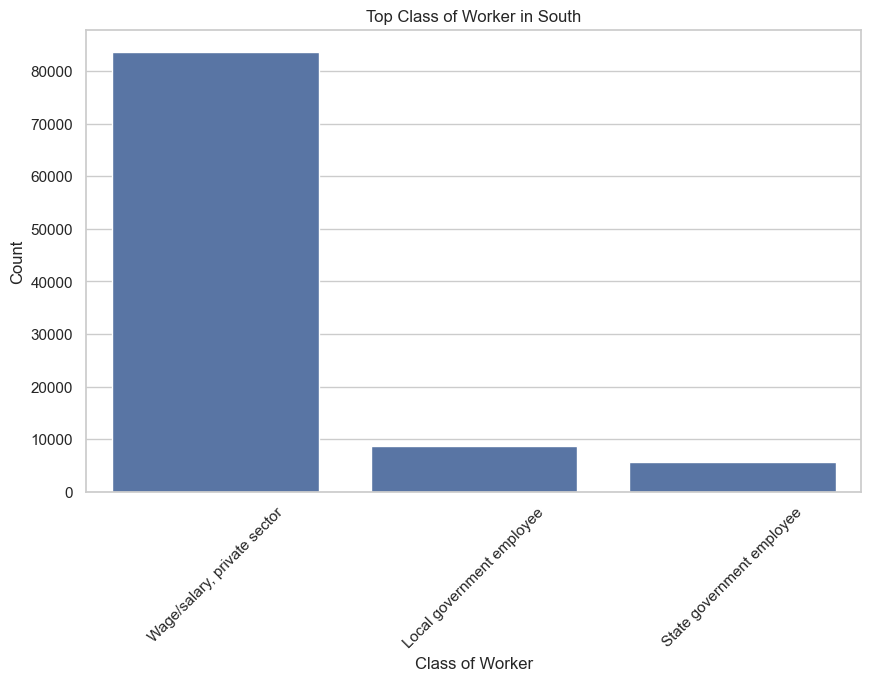

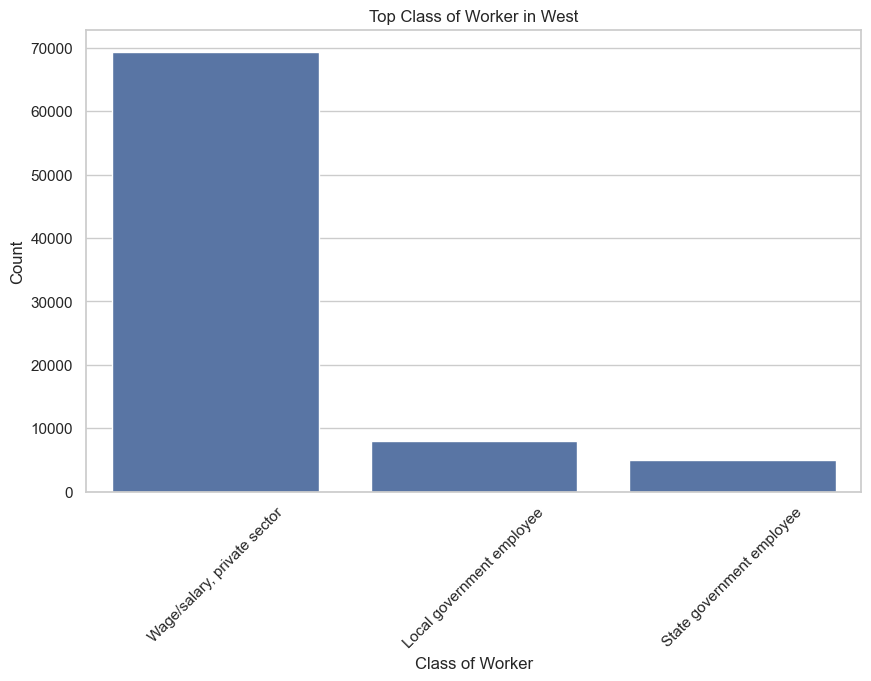

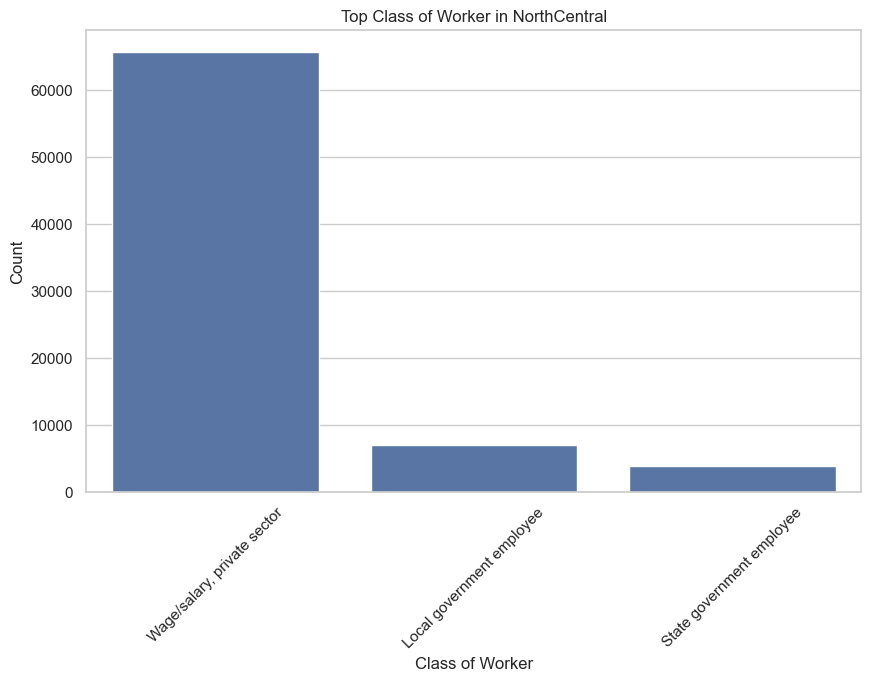

In [129]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define mappings for region and classwkr
region_encodes = {0: 'NorthEast', 1: 'NorthCentral', 2: 'South', 3: 'West'}
classwkr_encodes = {
    10: "Self-employed", 
    21: "Wage/salary, private sector", 
    24: "Wage/salary, government", 
    25: "Federal government employee", 
    27: "State government employee", 
    28: "Local government employee", 
    29: "Unpaid family worker"
}

# Map numeric codes to readable labels
processed['region_label'] = processed['region'].map(region_encodes)
processed['classwkr_label'] = processed['classwkr'].map(classwkr_encodes)

# Get the top 3 classwkr categories per region based on counts
top_classwkr_levels = (
    processed.groupby(['region_label', 'classwkr_label'])
    .size()
    .reset_index(name='count')
    .sort_values(['region_label', 'count'], ascending=[True, False])
    .groupby('region_label')
    .head(3)
)

# Filter the original dataset to include only the top classwkr categories per region
filtered_data = processed.merge(top_classwkr_levels[['region_label', 'classwkr_label']], on=['region_label', 'classwkr_label'])

# Plot separately for each region
for region in filtered_data['region_label'].unique():
    plt.figure(figsize=(10, 6))
    region_data = filtered_data[filtered_data['region_label'] == region]
    sns.countplot(x='classwkr_label', data=region_data, order=region_data['classwkr_label'].value_counts().index)
    plt.xlabel("Class of Worker")
    plt.ylabel("Count")
    plt.title(f"Top Class of Worker in {region}")
    plt.xticks(rotation=45)
    plt.show()


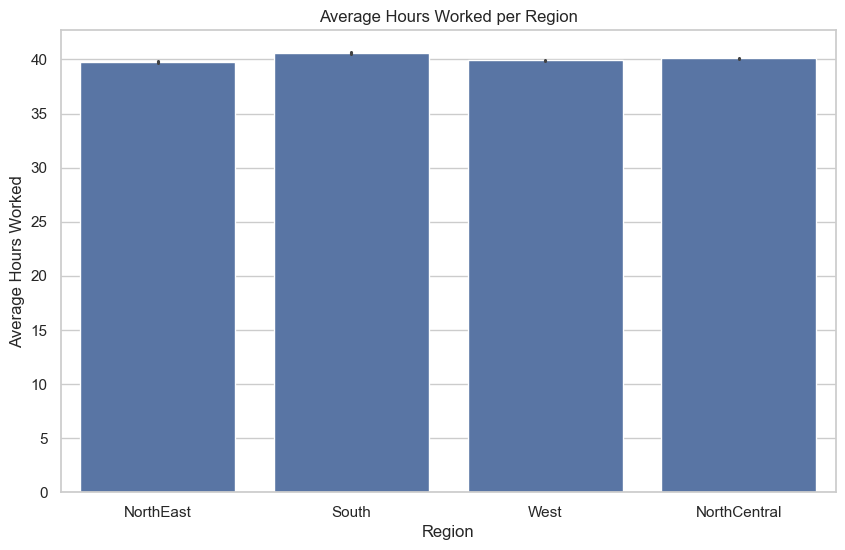

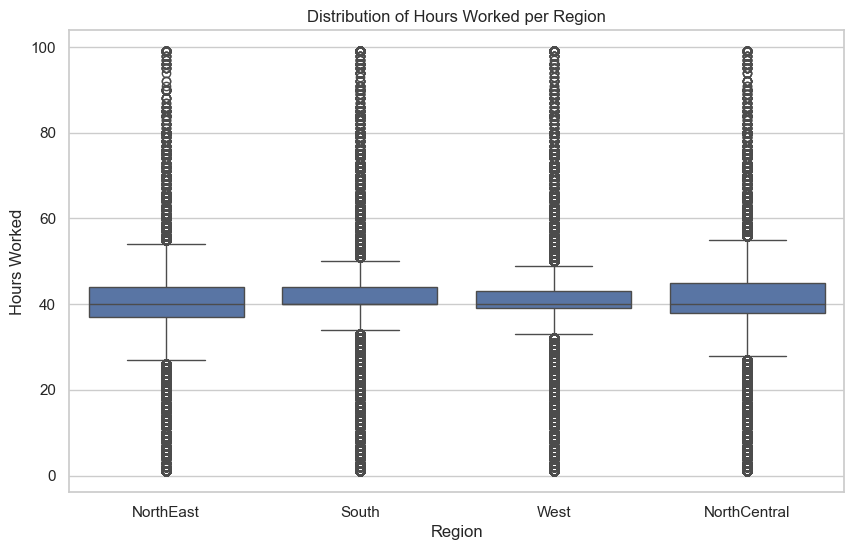

In [130]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define mappings for region labels
region_encodes = {0: 'NorthEast', 1: 'NorthCentral', 2: 'South', 3: 'West'}

# Map numeric codes to readable region labels
processed['region_label'] = processed['region'].map(region_encodes)

# Bar Plot: Mean hours worked per region
plt.figure(figsize=(10, 6))
sns.barplot(x='region_label', y='hrswork', data=processed, estimator='mean')
plt.xlabel("Region")
plt.ylabel("Average Hours Worked")
plt.title("Average Hours Worked per Region")
plt.show()

# Box Plot: Distribution of hours worked by region
plt.figure(figsize=(10, 6))
sns.boxplot(x='region_label', y='hrswork', data=processed)
plt.xlabel("Region")
plt.ylabel("Hours Worked")
plt.title("Distribution of Hours Worked per Region")
plt.show()


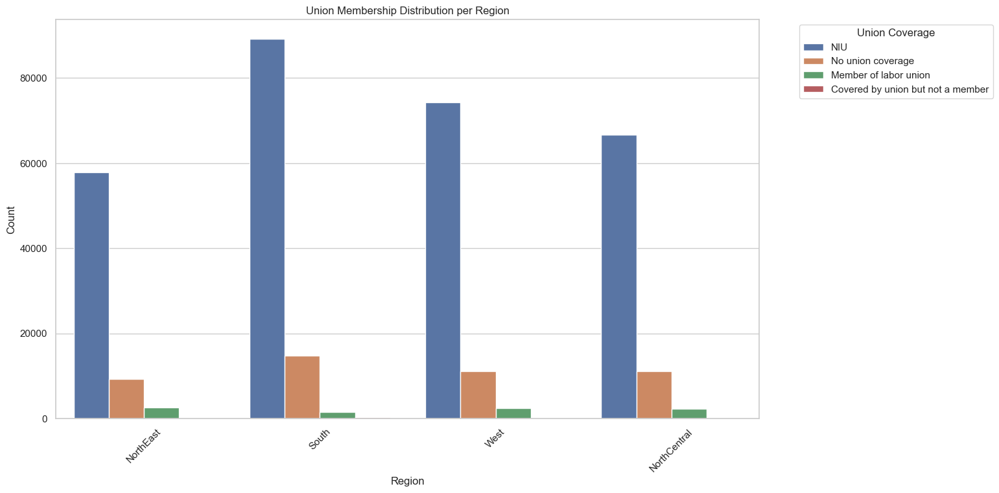

In [131]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define mappings for region and union labels
region_encodes = {0: 'NorthEast', 1: 'NorthCentral', 2: 'South', 3: 'West'}
union_encodes = {
    0: 'NIU',
    1: 'No union coverage',
    2: 'Member of labor union',
    3: 'Covered by union but not a member'
}

# Map numeric codes to readable labels
processed['region_label'] = processed['region'].map(region_encodes)
processed['union_label'] = processed['union'].map(union_encodes)

# Count Plot: Union membership by region
plt.figure(figsize=(14, 8))
sns.countplot(x='region_label', hue='union_label', data=processed)
plt.xlabel("Region")
plt.ylabel("Count")
plt.title("Union Membership Distribution per Region")
plt.legend(title="Union Coverage", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.show()


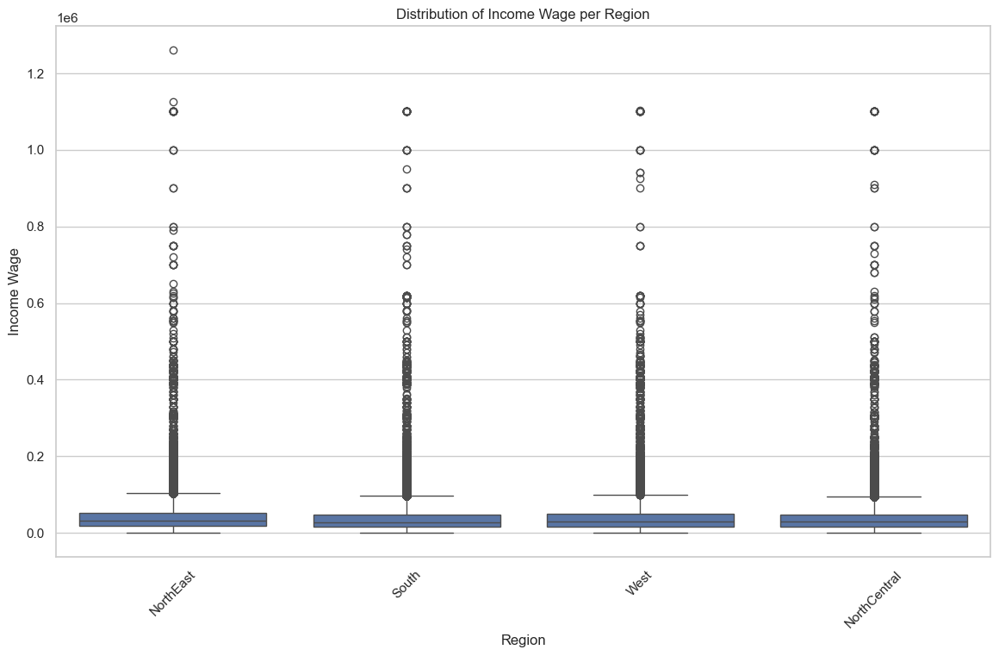

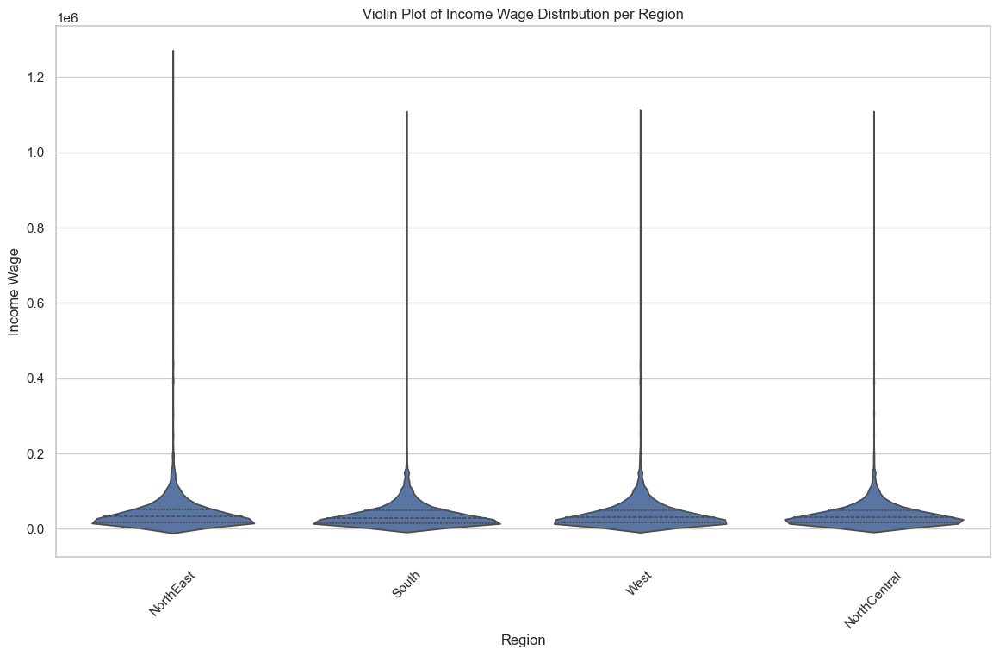

In [132]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define mappings for region
region_encodes = {0: 'NorthEast', 1: 'NorthCentral', 2: 'South', 3: 'West'}

# Map numeric codes to readable labels
processed['region_label'] = processed['region'].map(region_encodes)

# Box Plot: Distribution of income wages by region
plt.figure(figsize=(14, 8))
sns.boxplot(x='region_label', y='incwage', data=processed)
plt.xlabel("Region")
plt.ylabel("Income Wage")
plt.title("Distribution of Income Wage per Region")
plt.xticks(rotation=45)
plt.show()

# Optional: Violin Plot to show distribution shape
plt.figure(figsize=(14, 8))
sns.violinplot(x='region_label', y='incwage', data=processed, inner='quartile')
plt.xlabel("Region")
plt.ylabel("Income Wage")
plt.title("Violin Plot of Income Wage Distribution per Region")
plt.xticks(rotation=45)
plt.show()


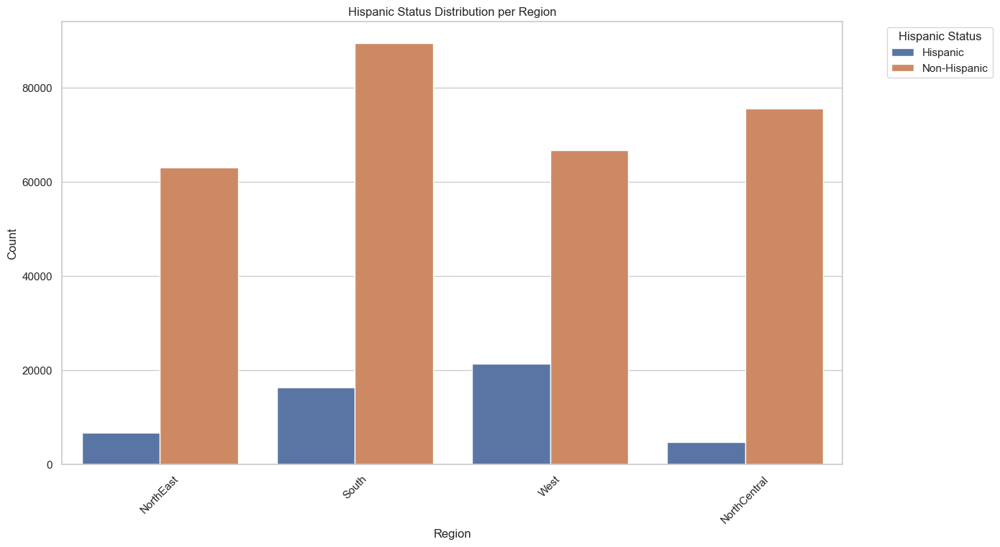

In [137]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define mappings for region and Hispanic status
region_encodes = {0: 'NorthEast', 1: 'NorthCentral', 2: 'South', 3: 'West'}
hisp_encodes = {0: 'Non-Hispanic', 1: 'Hispanic'}

# Map numeric codes to readable labels
processed['region_label'] = processed['region'].map(region_encodes)
processed['hisp_label'] = processed['hisp'].map(hisp_encodes)

# Count Plot: Hispanic Status by Region
plt.figure(figsize=(14, 8))
sns.countplot(x='region_label', hue='hisp_label', data=processed)
plt.xlabel("Region")
plt.ylabel("Count")
plt.title("Hispanic Status Distribution per Region")
plt.legend(title="Hispanic Status", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.show()


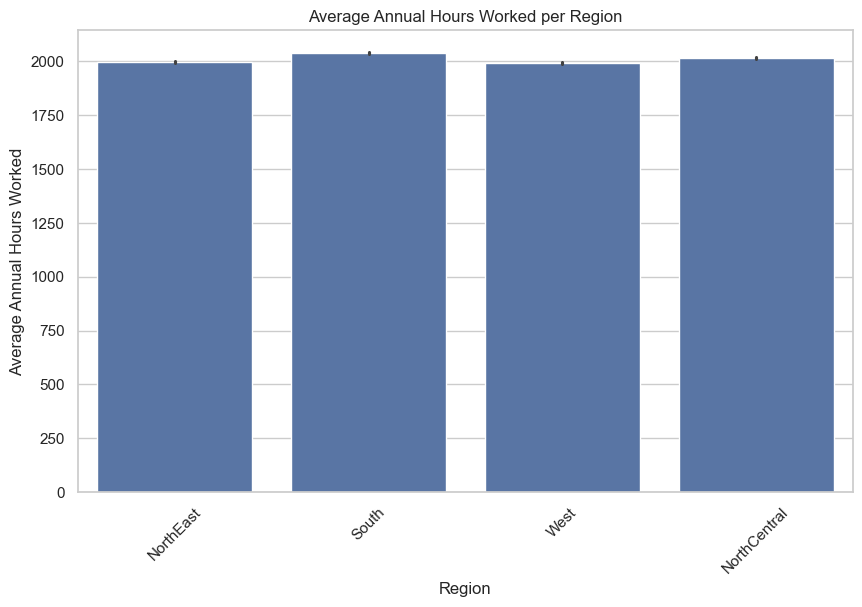

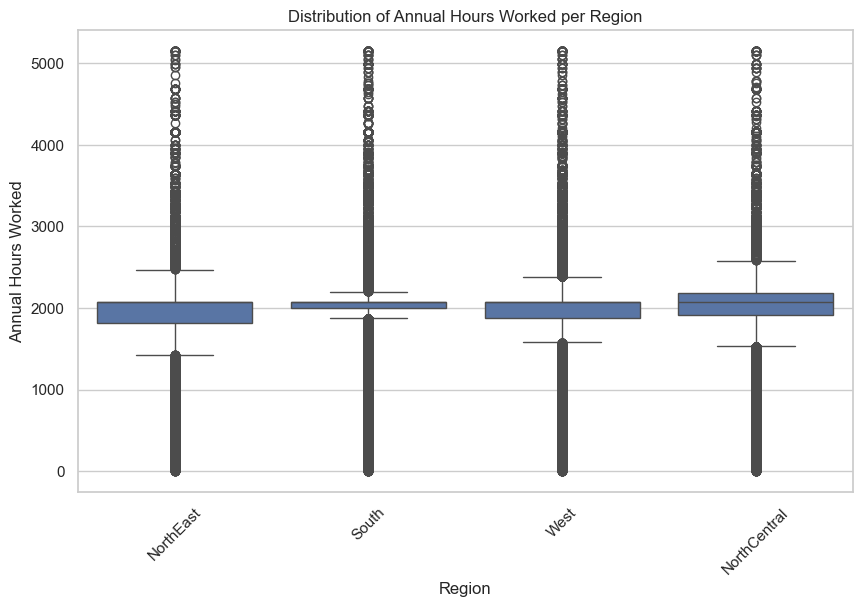

In [138]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define mappings for region
region_encodes = {0: 'NorthEast', 1: 'NorthCentral', 2: 'South', 3: 'West'}

# Map numeric codes to readable labels
processed['region_label'] = processed['region'].map(region_encodes)

# Bar Plot: Mean annual hours per region
plt.figure(figsize=(10, 6))
sns.barplot(x='region_label', y='annhrs', data=processed, estimator='mean')
plt.xlabel("Region")
plt.ylabel("Average Annual Hours Worked")
plt.title("Average Annual Hours Worked per Region")
plt.xticks(rotation=45)
plt.show()

# Box Plot: Distribution of annual hours by region
plt.figure(figsize=(10, 6))
sns.boxplot(x='region_label', y='annhrs', data=processed)
plt.xlabel("Region")
plt.ylabel("Annual Hours Worked")
plt.title("Distribution of Annual Hours Worked per Region")
plt.xticks(rotation=45)
plt.show()


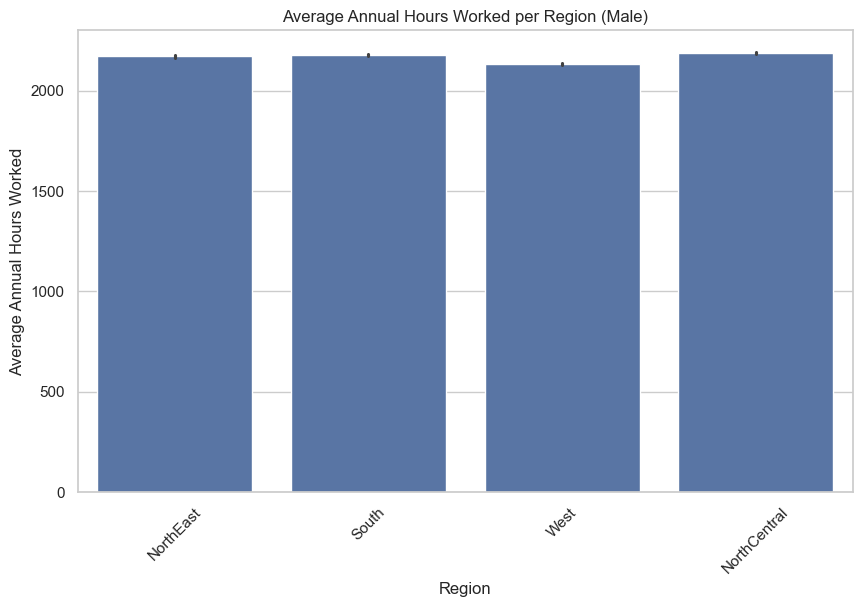

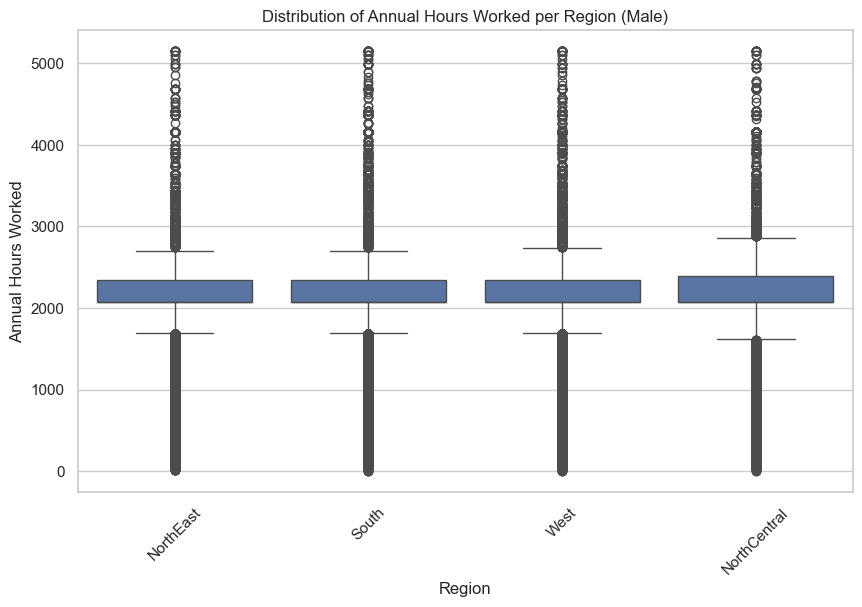

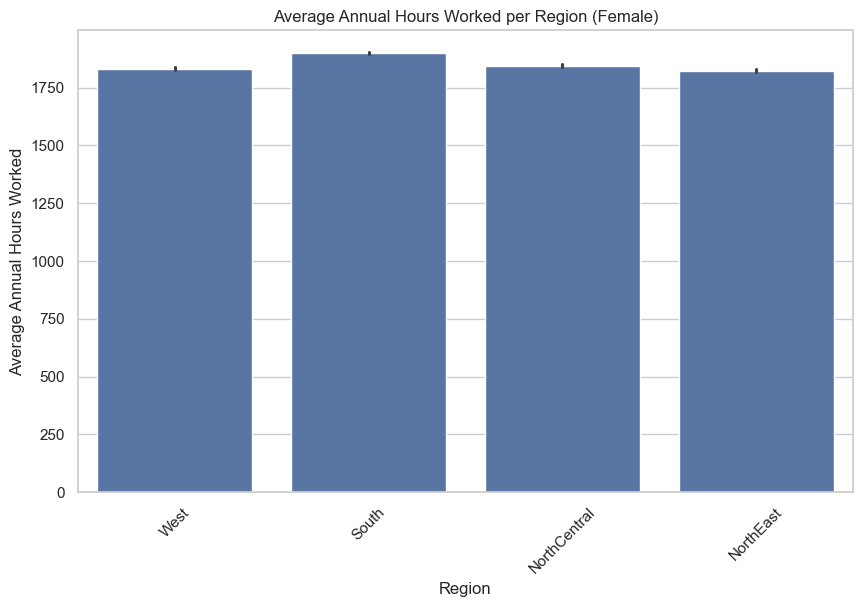

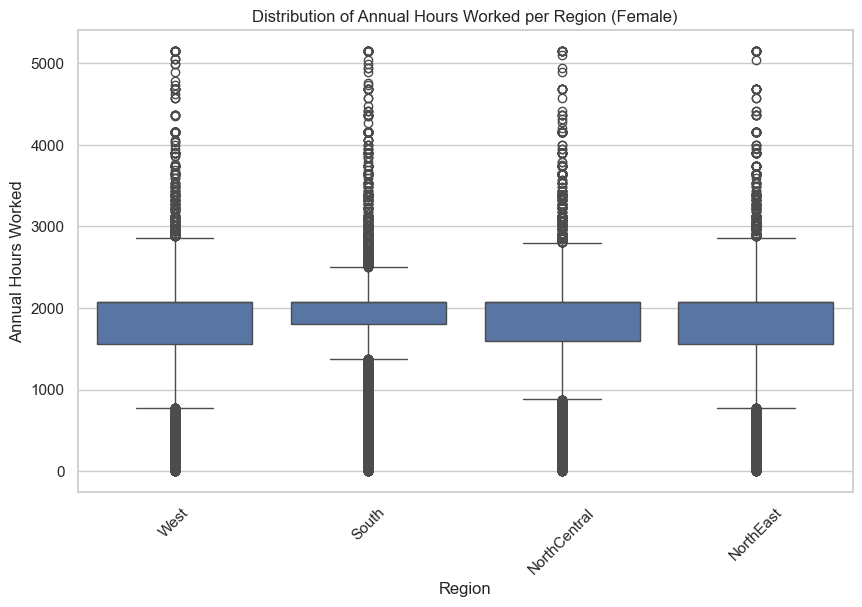

In [140]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define mappings for region
region_encodes = {0: 'NorthEast', 1: 'NorthCentral', 2: 'South', 3: 'West'}

# Map numeric codes to readable labels
processed['region_label'] = processed['region'].map(region_encodes)

# Map sex codes to readable labels
sex_encodes = {1: 'Male', 2: 'Female'}
processed['sex_label'] = processed['sex'].map(sex_encodes)

# Function to plot for a specific gender
def plot_annhrs_by_gender(gender):
    gender_data = processed[processed['sex_label'] == gender]

    # Bar Plot: Mean annual hours worked per region for the specified gender
    plt.figure(figsize=(10, 6))
    sns.barplot(x='region_label', y='annhrs', data=gender_data, estimator='mean')
    plt.xlabel("Region")
    plt.ylabel("Average Annual Hours Worked")
    plt.title(f"Average Annual Hours Worked per Region ({gender})")
    plt.xticks(rotation=45)
    plt.show()

    # Box Plot: Distribution of annual hours worked by region for the specified gender
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='region_label', y='annhrs', data=gender_data)
    plt.xlabel("Region")
    plt.ylabel("Annual Hours Worked")
    plt.title(f"Distribution of Annual Hours Worked per Region ({gender})")
    plt.xticks(rotation=45)
    plt.show()

# Plot for Men
plot_annhrs_by_gender('Male')

# Plot for Women
plot_annhrs_by_gender('Female')


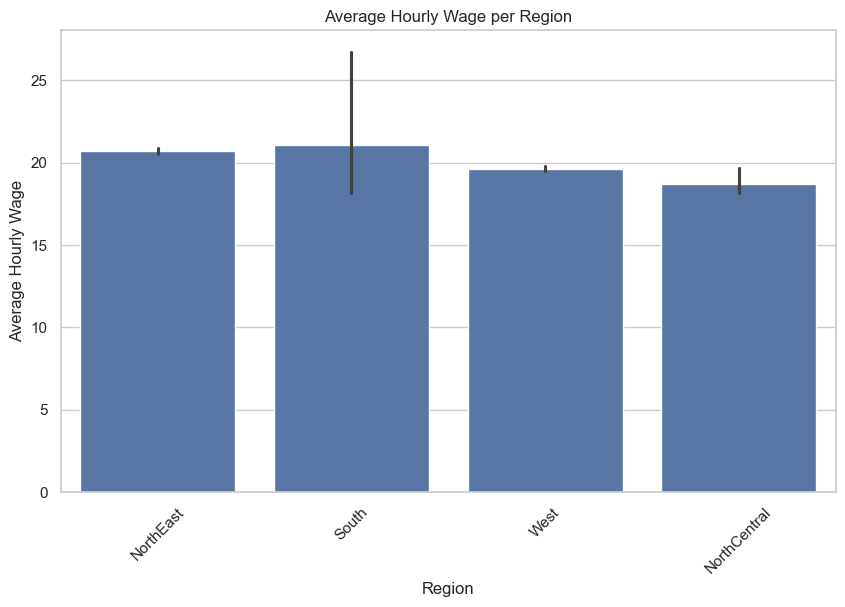

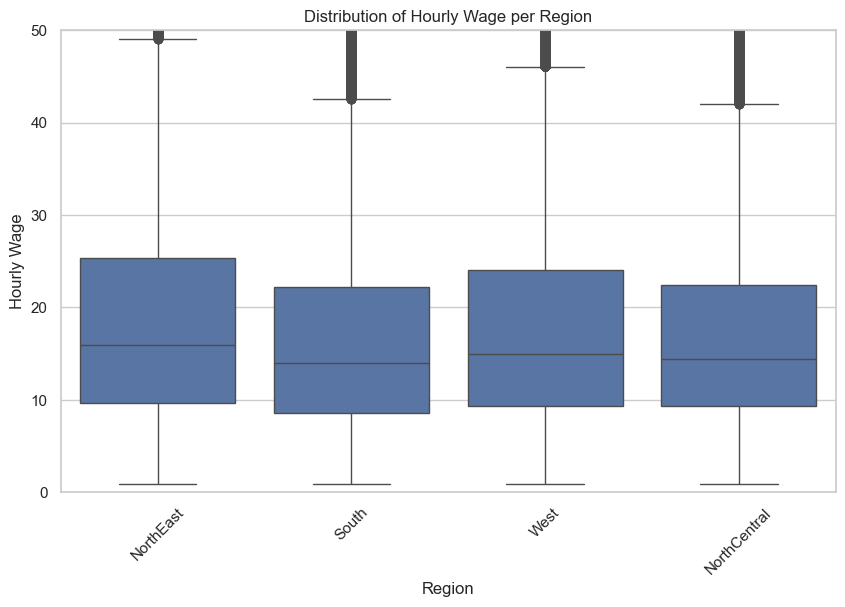

In [142]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define mappings for region
region_encodes = {0: 'NorthEast', 1: 'NorthCentral', 2: 'South', 3: 'West'}

# Map numeric codes to readable labels
processed['region_label'] = processed['region'].map(region_encodes)

# Bar Plot: Mean hourly wage per region
plt.figure(figsize=(10, 6))
sns.barplot(x='region_label', y='hrwage', data=processed, estimator='mean')
plt.xlabel("Region")
plt.ylabel("Average Hourly Wage")
plt.title("Average Hourly Wage per Region")
plt.xticks(rotation=45)
plt.show()

# Box Plot: Distribution of hourly wage by region
plt.figure(figsize=(10, 6))
sns.boxplot(x='region_label', y='hrwage', data=processed)
plt.xlabel("Region")
plt.ylabel("Hourly Wage")
plt.title("Distribution of Hourly Wage per Region")
plt.xticks(rotation=45)
plt.ylim(0, 50)
plt.show()


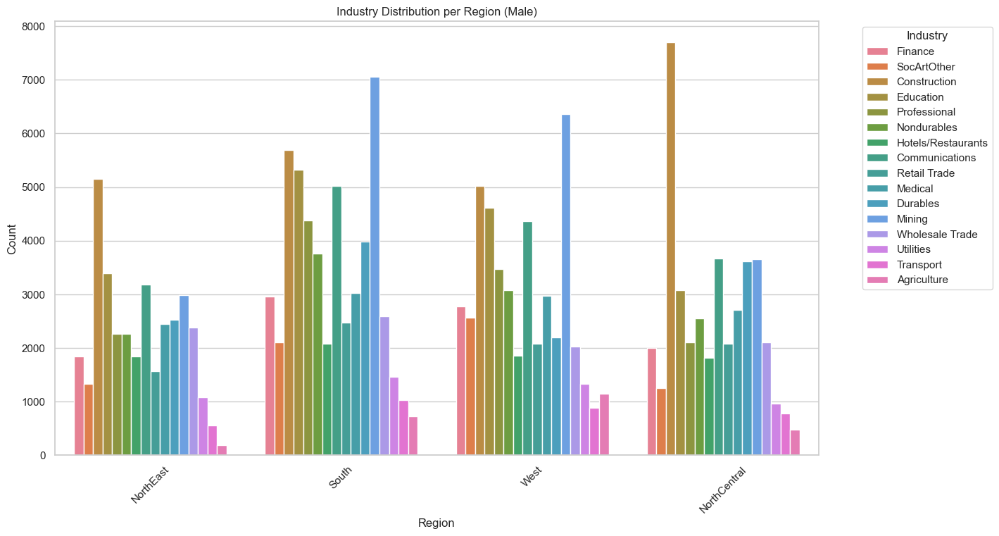

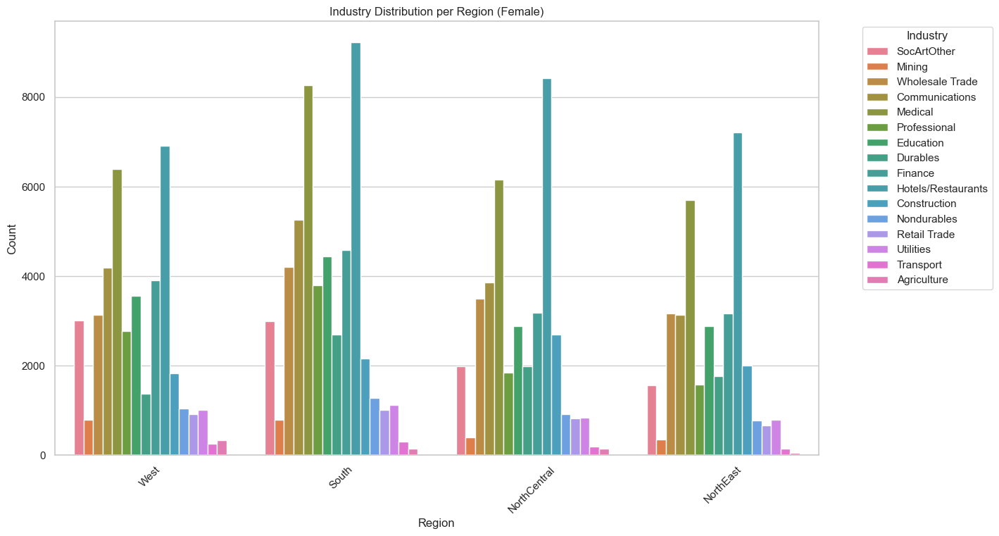

In [143]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define mappings for region and industry
region_encodes = {0: 'NorthEast', 1: 'NorthCentral', 2: 'South', 3: 'West'}
industry_encodes = {
    0: 'Agriculture', 1: 'Mining', 2: 'Construction', 3: 'Durables', 4: 'Nondurables',
    5: 'Transport', 6: 'Utilities', 7: 'Communications', 8: 'Retail Trade',
    9: 'Wholesale Trade', 10: 'Finance', 11: 'SocArtOther', 12: 'Hotels/Restaurants',
    13: 'Medical', 14: 'Education', 15: 'Professional', 16: 'Public Admin'
}

# Map numeric codes to readable labels
processed['region_label'] = processed['region'].map(region_encodes)
processed['industry_label'] = processed['industry'].map(industry_encodes)

# Map sex codes to readable labels
sex_encodes = {1: 'Male', 2: 'Female'}
processed['sex_label'] = processed['sex'].map(sex_encodes)

# Function to plot industry distribution by region and gender
def plot_industry_distribution(gender):
    gender_data = processed[processed['sex_label'] == gender]

    # Count Plot: Industry distribution by region for the specified gender
    plt.figure(figsize=(14, 8))
    sns.countplot(x='region_label', hue='industry_label', data=gender_data)
    plt.xlabel("Region")
    plt.ylabel("Count")
    plt.title(f"Industry Distribution per Region ({gender})")
    plt.legend(title="Industry", bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.xticks(rotation=45)
    plt.show()

# Plot for Males
plot_industry_distribution('Male')

# Plot for Females
plot_industry_distribution('Female')


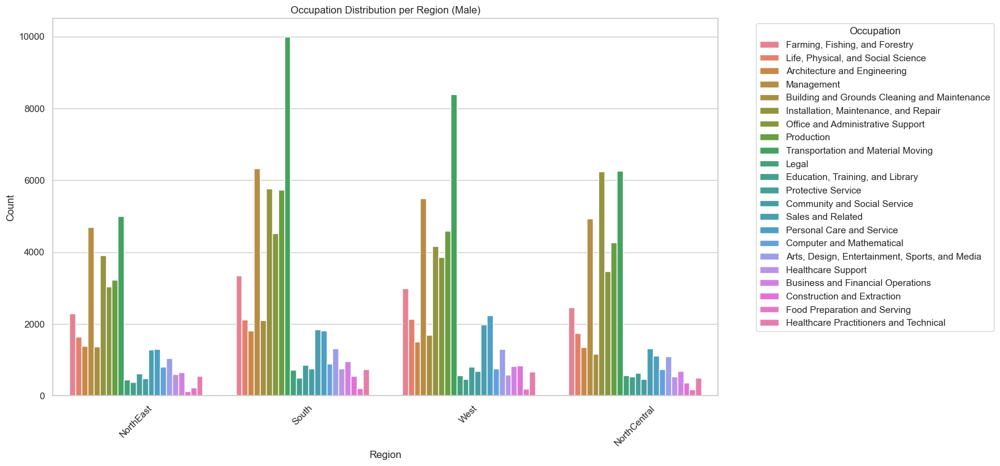

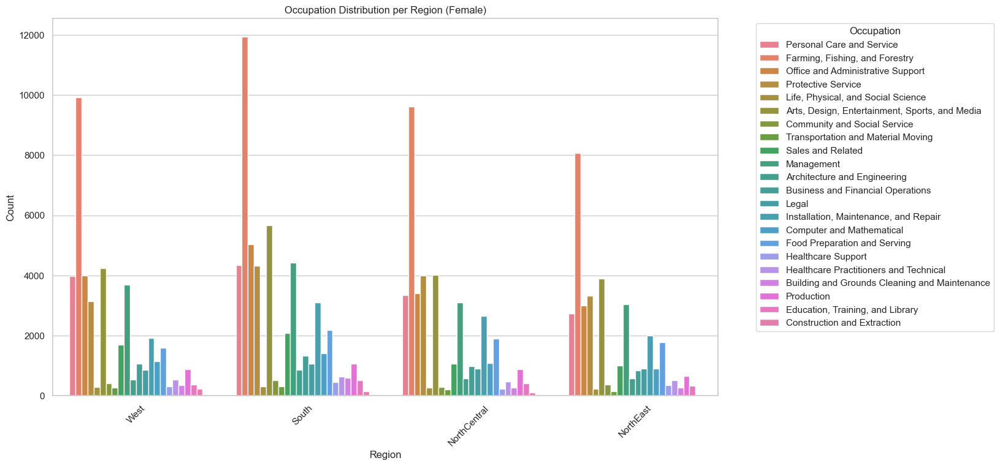

In [144]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define mappings for region and occupation
region_encodes = {0: 'NorthEast', 1: 'NorthCentral', 2: 'South', 3: 'West'}
occupation_encodes = {
    0: 'Management', 1: 'Business and Financial Operations', 2: 'Computer and Mathematical',
    3: 'Architecture and Engineering', 4: 'Life, Physical, and Social Science',
    5: 'Community and Social Service', 6: 'Legal', 7: 'Education, Training, and Library',
    8: 'Arts, Design, Entertainment, Sports, and Media', 9: 'Healthcare Practitioners and Technical',
    10: 'Healthcare Support', 11: 'Protective Service', 12: 'Food Preparation and Serving',
    13: 'Building and Grounds Cleaning and Maintenance', 14: 'Personal Care and Service',
    15: 'Sales and Related', 16: 'Office and Administrative Support',
    17: 'Farming, Fishing, and Forestry', 18: 'Construction and Extraction',
    19: 'Installation, Maintenance, and Repair', 20: 'Production', 21: 'Transportation and Material Moving',
    22: 'Military', 23: 'Other'
}

# Map numeric codes to readable labels
processed['region_label'] = processed['region'].map(region_encodes)
processed['occupation_label'] = processed['occupation'].map(occupation_encodes)

# Map sex codes to readable labels
sex_encodes = {1: 'Male', 2: 'Female'}
processed['sex_label'] = processed['sex'].map(sex_encodes)

# Function to plot occupation distribution by region and gender
def plot_occupation_distribution(gender):
    gender_data = processed[processed['sex_label'] == gender]

    # Count Plot: Occupation distribution by region for the specified gender
    plt.figure(figsize=(14, 8))
    sns.countplot(x='region_label', hue='occupation_label', data=gender_data)
    plt.xlabel("Region")
    plt.ylabel("Count")
    plt.title(f"Occupation Distribution per Region ({gender})")
    plt.legend(title="Occupation", bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.xticks(rotation=45)
    plt.show()

# Plot for Males
plot_occupation_distribution('Male')

# Plot for Females
plot_occupation_distribution('Female')


/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/1315575398.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='pernum', y='hrwage', data=processed, estimator='mean', palette="Blues")


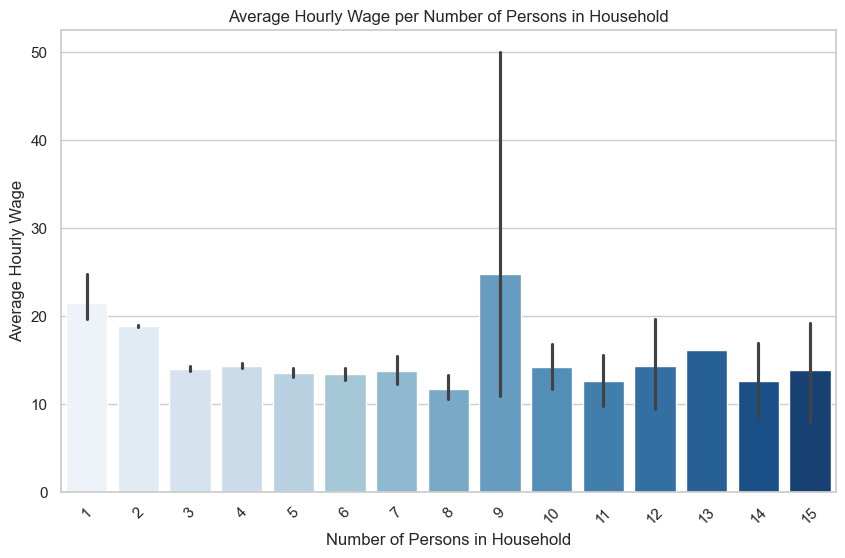

/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/1315575398.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='pernum', y='hrwage', data=processed, palette="Blues")


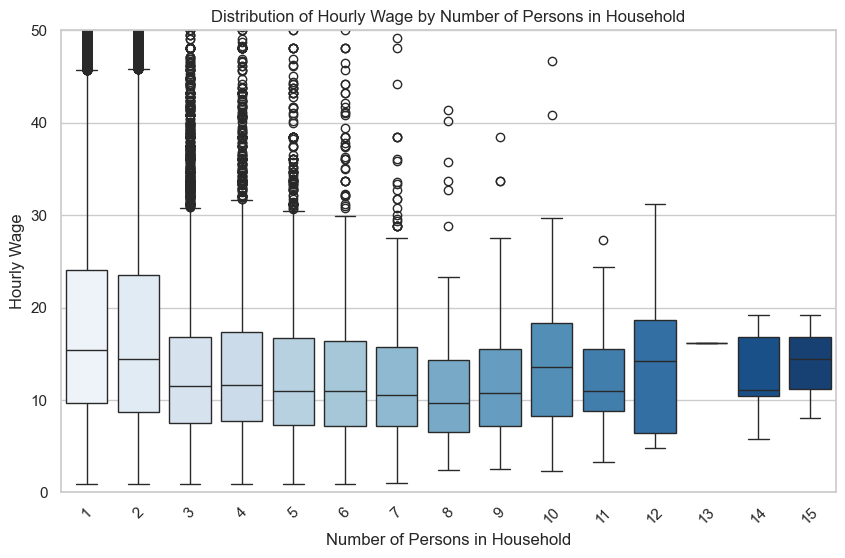

In [147]:
import matplotlib.pyplot as plt
import seaborn as sns

# Bar Plot: Mean Hourly Wage per Number of Persons in Household
plt.figure(figsize=(10, 6))
sns.barplot(x='pernum', y='hrwage', data=processed, estimator='mean', palette="Blues")
plt.xlabel("Number of Persons in Household")
plt.ylabel("Average Hourly Wage")
plt.title("Average Hourly Wage per Number of Persons in Household")
plt.xticks(rotation=45)
plt.show()

# Box Plot: Distribution of Hourly Wage by Number of Persons in Household
plt.figure(figsize=(10, 6))
sns.boxplot(x='pernum', y='hrwage', data=processed, palette="Blues")
plt.xlabel("Number of Persons in Household")
plt.ylabel("Hourly Wage")
plt.title("Distribution of Hourly Wage by Number of Persons in Household")
plt.xticks(rotation=45)
plt.ylim(0, 50)
plt.show()


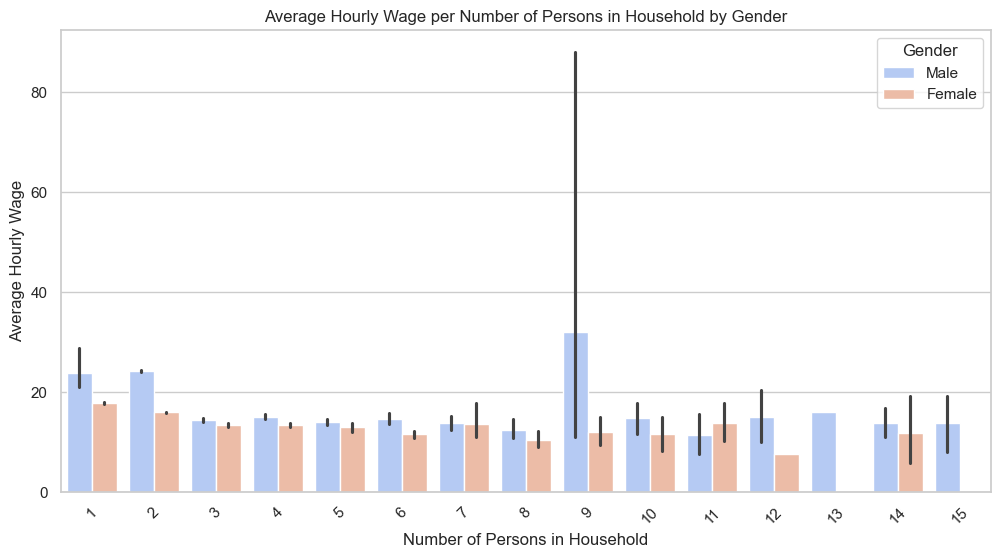

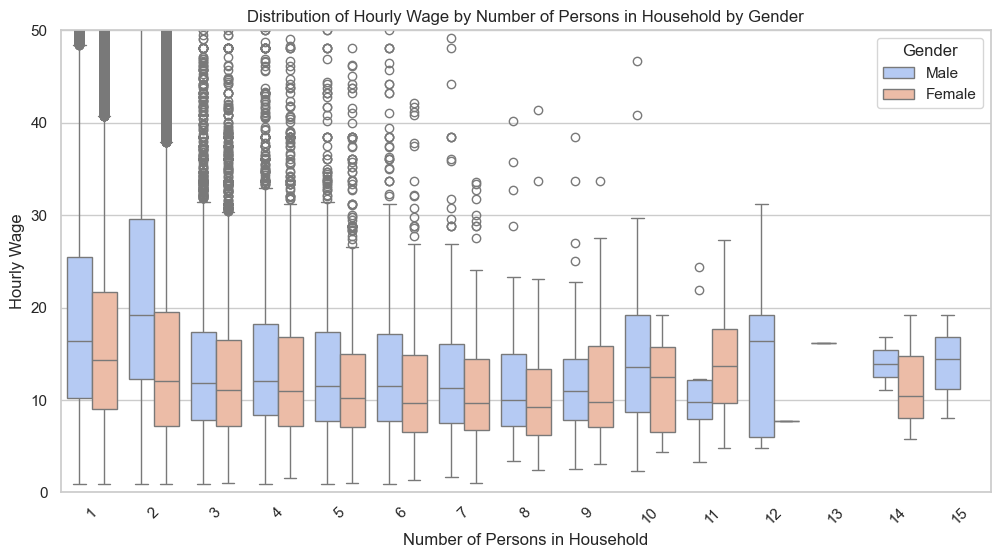

In [149]:
import matplotlib.pyplot as plt
import seaborn as sns

# Add a gender column if not already present in the dataset
# Assuming that the `sex` variable indicates gender where 1 = Male and 2 = Female
# Ensure that you have a column `sex` with appropriate values
processed['gender'] = processed['sex'].map({1: 'Male', 2: 'Female'})

# Bar Plot: Mean Hourly Wage per Number of Persons in Household for Males and Females
plt.figure(figsize=(12, 6))
sns.barplot(x='pernum', y='hrwage', hue='gender', data=processed, estimator='mean', palette="coolwarm")
plt.xlabel("Number of Persons in Household")
plt.ylabel("Average Hourly Wage")
plt.title("Average Hourly Wage per Number of Persons in Household by Gender")
plt.xticks(rotation=45)
plt.legend(title='Gender')
plt.show()

# Box Plot: Distribution of Hourly Wage by Number of Persons in Household for Males and Females
plt.figure(figsize=(12, 6))
sns.boxplot(x='pernum', y='hrwage', hue='gender', data=processed, palette="coolwarm")
plt.xlabel("Number of Persons in Household")
plt.ylabel("Hourly Wage")
plt.title("Distribution of Hourly Wage by Number of Persons in Household by Gender")
plt.xticks(rotation=45)
plt.legend(title='Gender')
plt.ylim(0, 50)
plt.show()


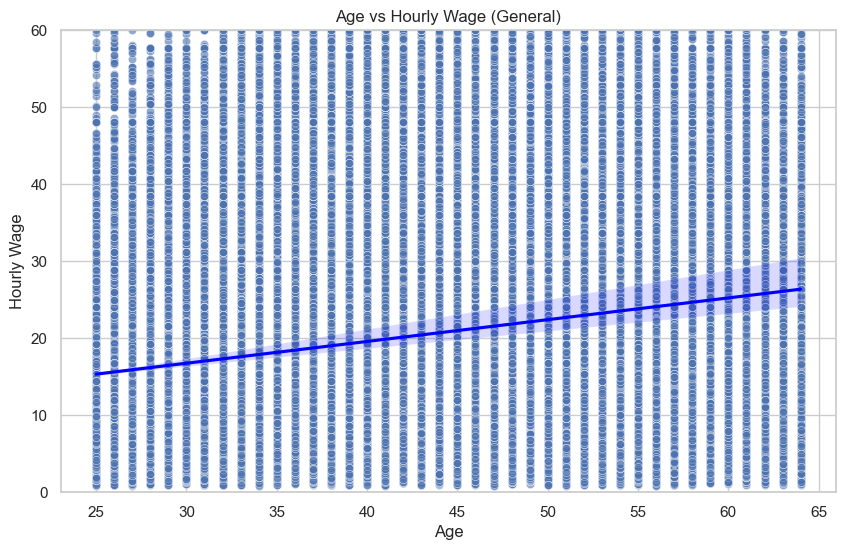

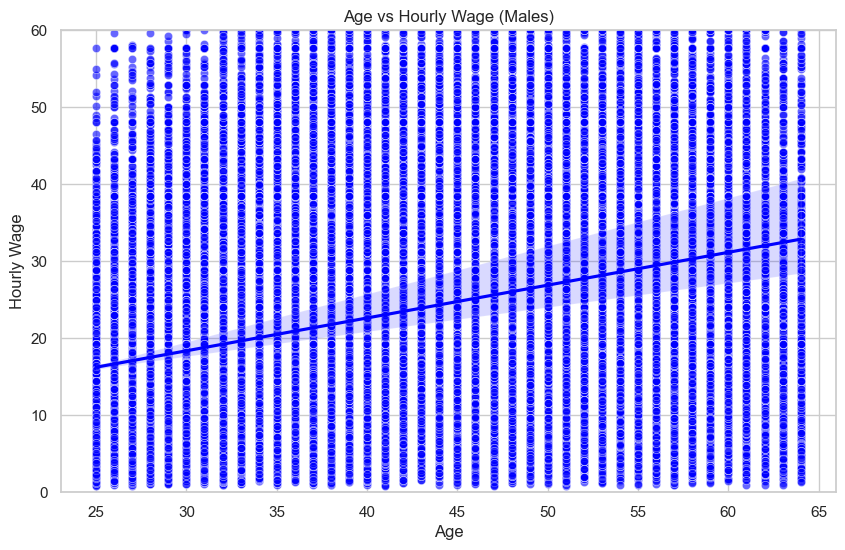

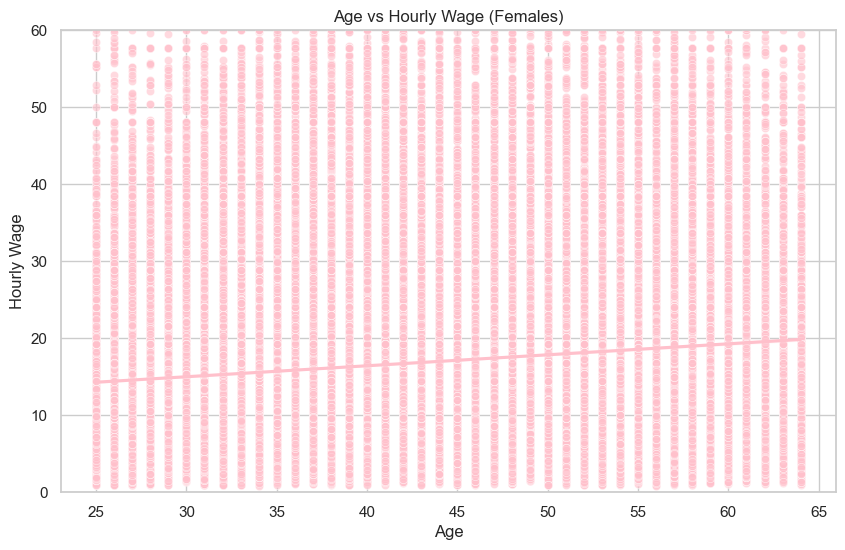

In [151]:
import matplotlib.pyplot as plt
import seaborn as sns

# General Scatter Plot: Age vs Hourly Wage
plt.figure(figsize=(10, 6))
sns.scatterplot(x='age', y='hrwage', data=processed, alpha=0.6)
sns.regplot(x='age', y='hrwage', data=processed, scatter=False, color='blue')
plt.xlabel("Age")
plt.ylabel("Hourly Wage")
plt.ylim(0, 60)
plt.title("Age vs Hourly Wage (General)")
plt.show()

# Add a gender column if not already present in the dataset
# Assuming that the `sex` variable indicates gender where 1 = Male and 2 = Female
processed['gender'] = processed['sex'].map({1: 'Male', 2: 'Female'})

# Scatter Plot: Age vs Hourly Wage for Males
plt.figure(figsize=(10, 6))
sns.scatterplot(x='age', y='hrwage', data=processed[processed['gender'] == 'Male'], alpha=0.6, color='blue')
sns.regplot(x='age', y='hrwage', data=processed[processed['gender'] == 'Male'], scatter=False, color='blue')
plt.xlabel("Age")
plt.ylabel("Hourly Wage")
plt.title("Age vs Hourly Wage (Males)")
plt.ylim(0, 60)
plt.show()

# Scatter Plot: Age vs Hourly Wage for Females
plt.figure(figsize=(10, 6))
sns.scatterplot(x='age', y='hrwage', data=processed[processed['gender'] == 'Female'], alpha=0.6, color='pink')
sns.regplot(x='age', y='hrwage', data=processed[processed['gender'] == 'Female'], scatter=False, color='pink')
plt.xlabel("Age")
plt.ylabel("Hourly Wage")
plt.title("Age vs Hourly Wage (Females)")
plt.ylim(0, 60)
plt.show()


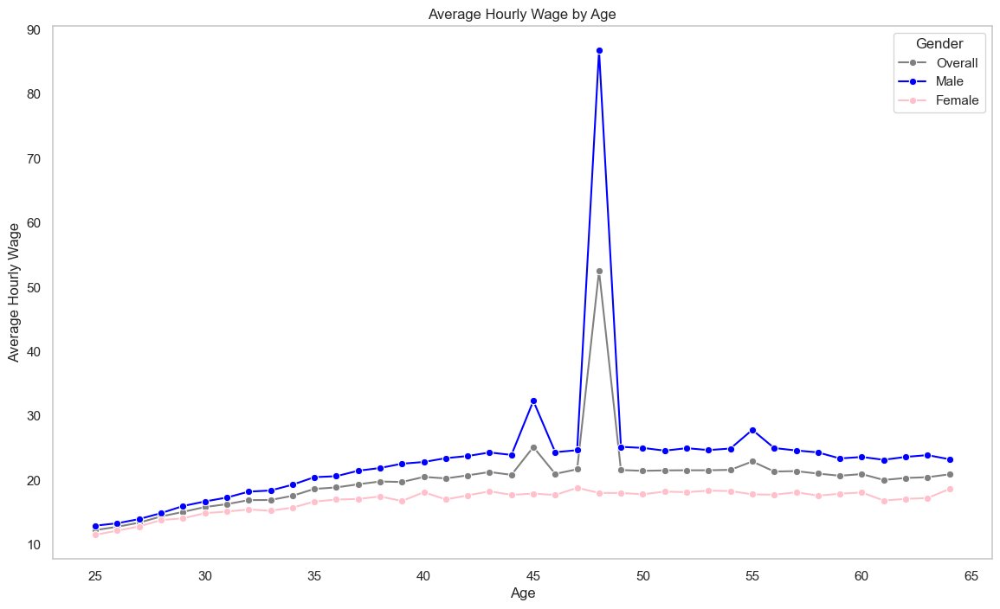

In [152]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Assuming 'processed' DataFrame already contains 'age', 'hrwage', and 'gender' columns

# Add a gender column if not already present in the dataset
processed['gender'] = processed['sex'].map({1: 'Male', 2: 'Female'})

# Group by age and calculate average hourly wage
avg_wage_by_age = processed.groupby('age')['hrwage'].mean().reset_index()
avg_wage_by_age['gender'] = 'Overall'

# Group by age and gender, then calculate average hourly wage
avg_wage_by_age_gender = processed.groupby(['age', 'gender'])['hrwage'].mean().reset_index()

# Combine the overall average wage DataFrame with the gender-specific DataFrame
combined_avg_wage = pd.concat([avg_wage_by_age, avg_wage_by_age_gender], ignore_index=True)

# Create a color palette for the plots
palette = {'Overall': 'gray', 'Male': 'blue', 'Female': 'pink'}

# Plotting
plt.figure(figsize=(14, 8))

# General Plot: Average Hourly Wage by Age
sns.lineplot(data=avg_wage_by_age, x='age', y='hrwage', label='Overall', color='gray', marker='o')

# Plot for Men
sns.lineplot(data=avg_wage_by_age_gender[avg_wage_by_age_gender['gender'] == 'Male'], 
             x='age', y='hrwage', label='Male', color='blue', marker='o')

# Plot for Women
sns.lineplot(data=avg_wage_by_age_gender[avg_wage_by_age_gender['gender'] == 'Female'], 
             x='age', y='hrwage', label='Female', color='pink', marker='o')

plt.xlabel("Age")
plt.ylabel("Average Hourly Wage")
plt.title("Average Hourly Wage by Age")
plt.legend(title="Gender")
plt.grid()
plt.show()


/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/1482766314.py:16: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(title='Sex')


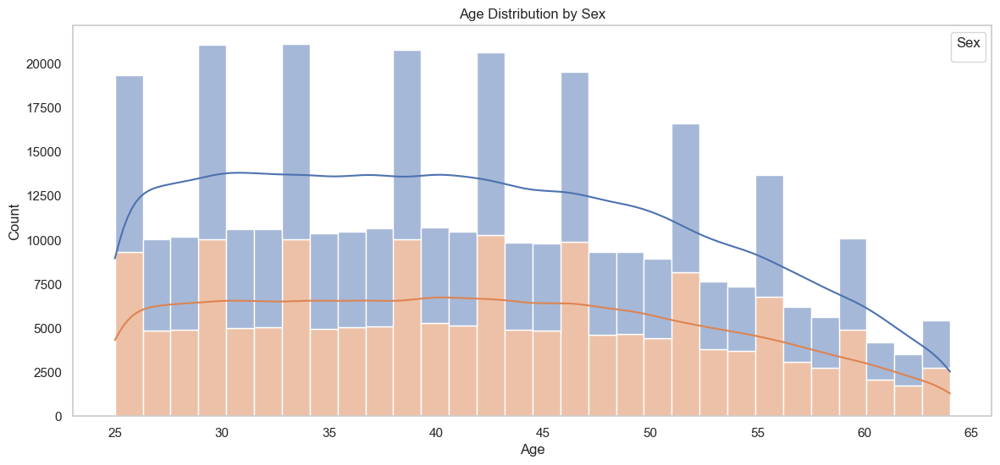

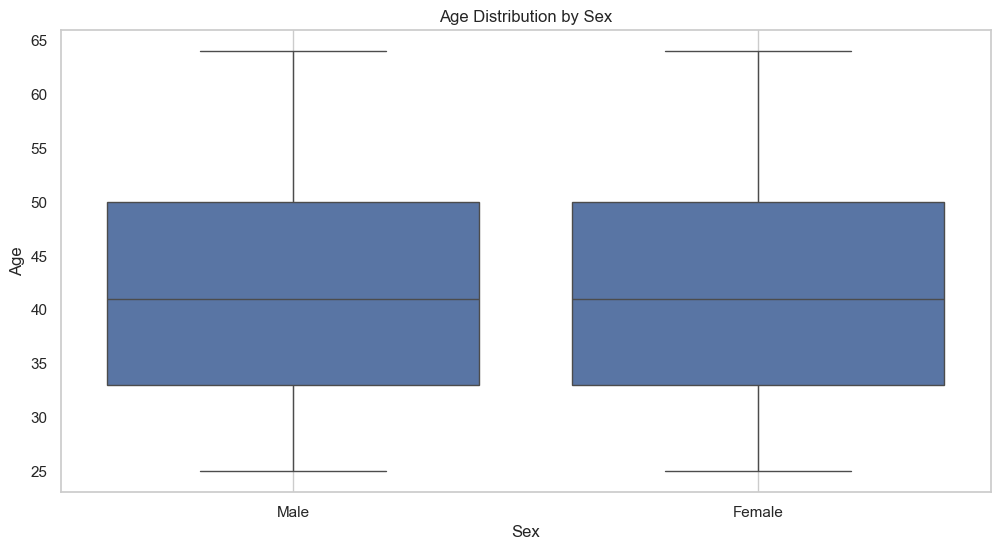

In [153]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'processed' DataFrame already contains 'age' and 'sex' columns

# Encode the sex column for better readability
sex_encodes = {1: 'Male', 2: 'Female'}
processed['sex_label'] = processed['sex'].map(sex_encodes)

# Histogram: Age distribution by sex
plt.figure(figsize=(14, 6))
sns.histplot(data=processed, x='age', hue='sex_label', multiple='stack', bins=30, kde=True)
plt.xlabel("Age")
plt.ylabel("Count")
plt.title("Age Distribution by Sex")
plt.legend(title='Sex')
plt.grid()
plt.show()

# Box Plot: Age distribution by sex
plt.figure(figsize=(12, 6))
sns.boxplot(x='sex_label', y='age', data=processed)
plt.xlabel("Sex")
plt.ylabel("Age")
plt.title("Age Distribution by Sex")
plt.grid()
plt.show()


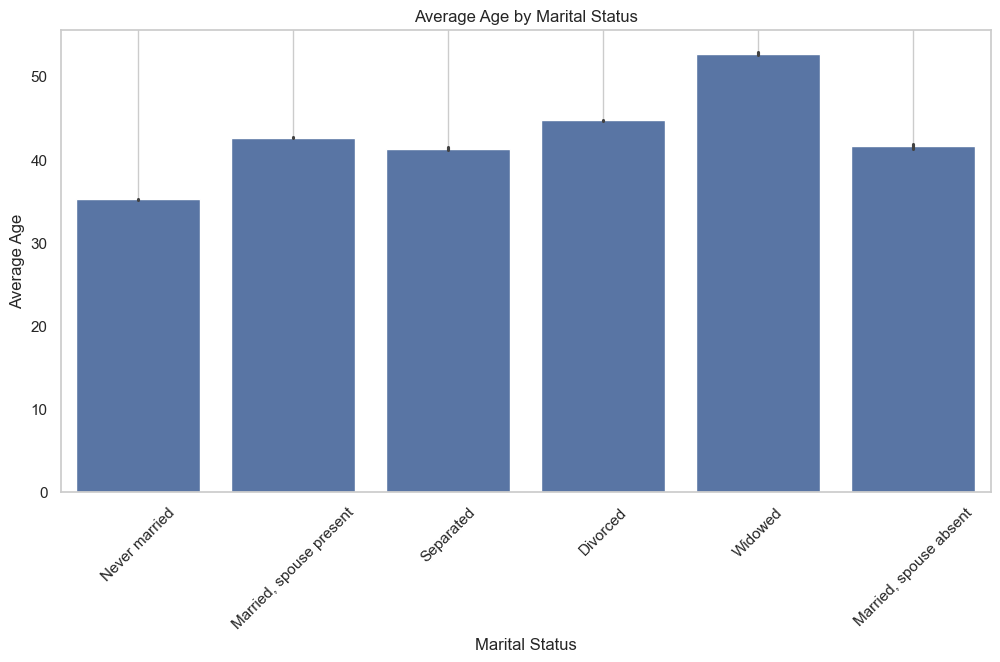

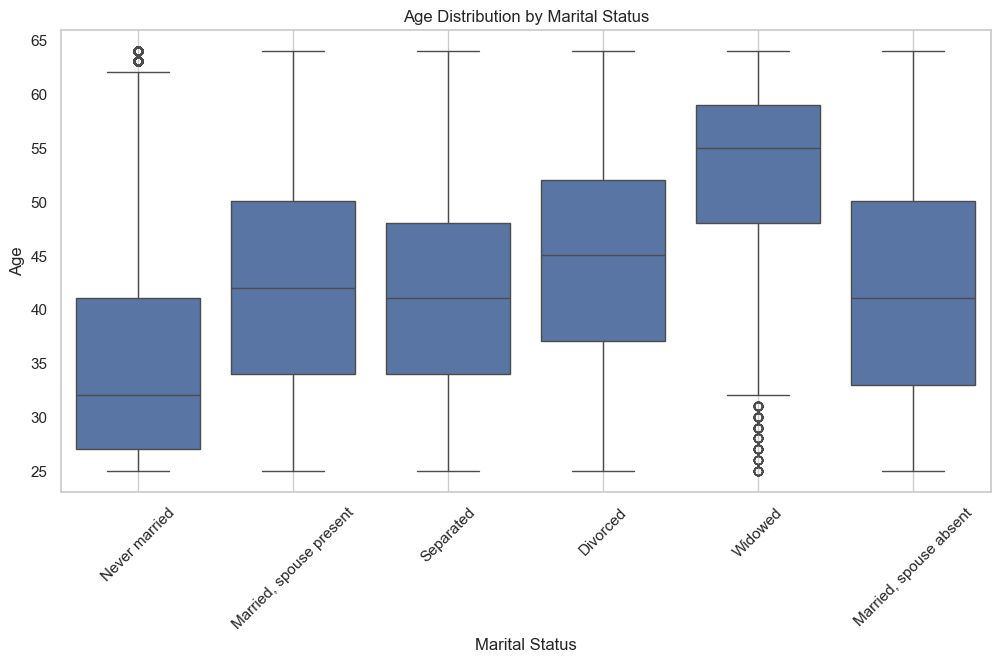

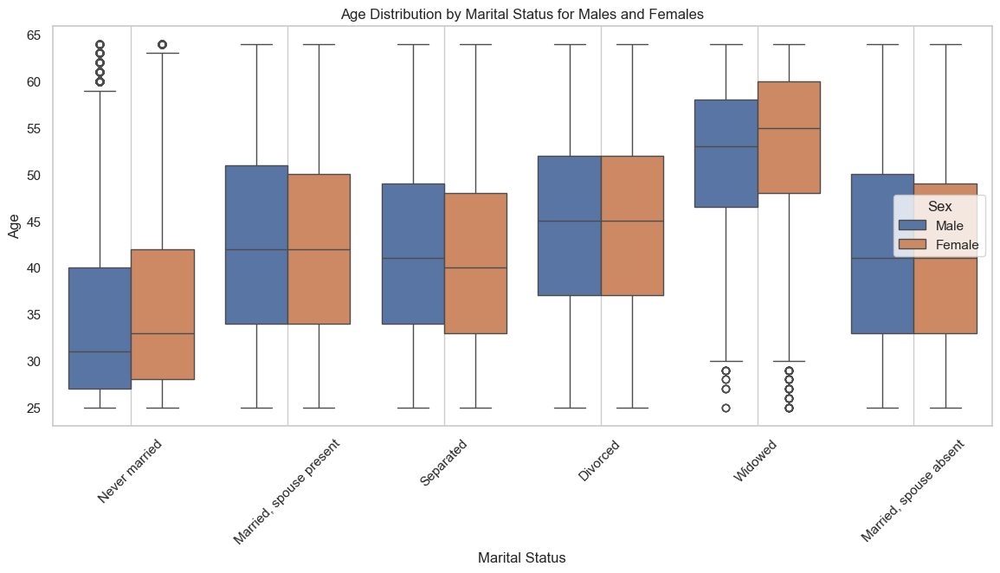

In [154]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'processed' DataFrame already contains 'age', 'marst', and 'sex' columns

# Define mappings for marital status
marital_encodes = {
    1: 'Married, spouse present', 
    2: 'Married, spouse absent', 
    3: 'Separated', 
    4: 'Divorced', 
    5: 'Widowed', 
    6: 'Never married'
}

# Map numeric codes to readable labels
processed['marst_label'] = processed['marst'].map(marital_encodes)

# Bar Plot: Average age by marital status
plt.figure(figsize=(12, 6))
sns.barplot(x='marst_label', y='age', data=processed, estimator='mean')
plt.xlabel("Marital Status")
plt.ylabel("Average Age")
plt.title("Average Age by Marital Status")
plt.xticks(rotation=45)
plt.grid()
plt.show()

# Box Plot: Age distribution by marital status
plt.figure(figsize=(12, 6))
sns.boxplot(x='marst_label', y='age', data=processed)
plt.xlabel("Marital Status")
plt.ylabel("Age")
plt.title("Age Distribution by Marital Status")
plt.xticks(rotation=45)
plt.grid()
plt.show()

# Now for males and females separately

# Encode the sex column for better readability
sex_encodes = {1: 'Male', 2: 'Female'}
processed['sex_label'] = processed['sex'].map(sex_encodes)

# Box Plot: Age distribution by marital status for males and females
plt.figure(figsize=(14, 6))
sns.boxplot(x='marst_label', y='age', hue='sex_label', data=processed)
plt.xlabel("Marital Status")
plt.ylabel("Age")
plt.title("Age Distribution by Marital Status for Males and Females")
plt.xticks(rotation=45)
plt.grid()
plt.legend(title='Sex')
plt.show()


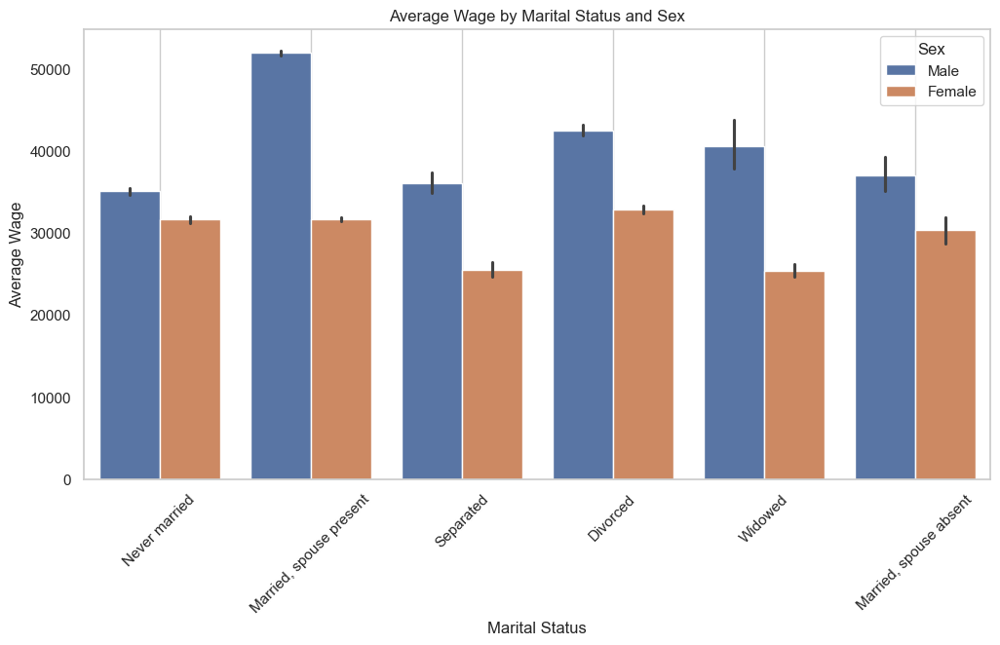

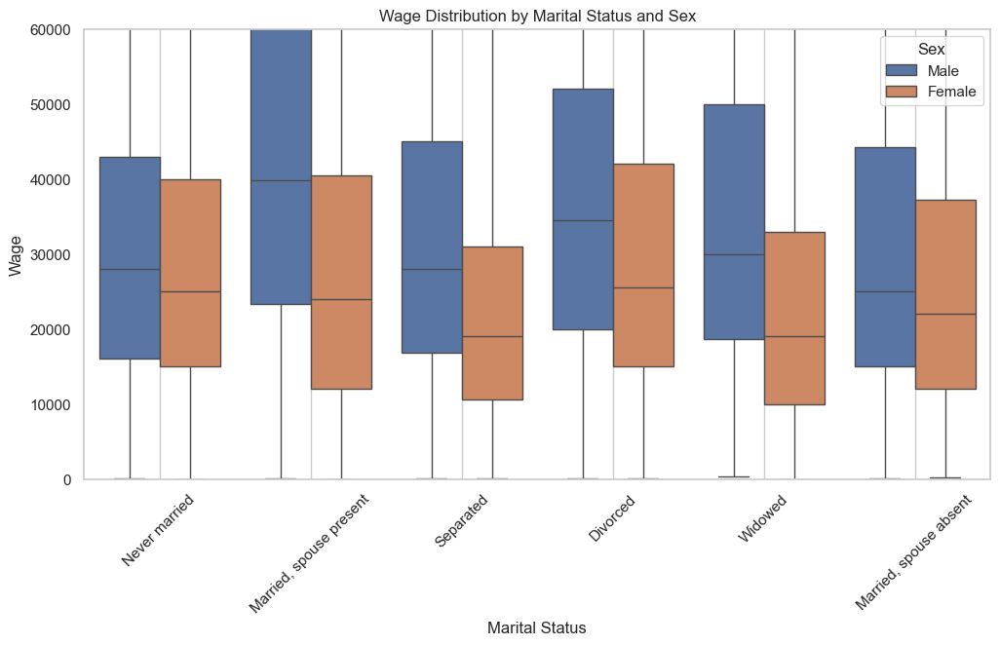

In [160]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'processed' DataFrame already contains 'marst', 'sex', and 'incwage' columns

# Define mappings for marital status
marital_encodes = {
    1: 'Married, spouse present', 
    2: 'Married, spouse absent', 
    3: 'Separated', 
    4: 'Divorced', 
    5: 'Widowed', 
    6: 'Never married'
}

# Map numeric codes to readable labels
processed['marst_label'] = processed['marst'].map(marital_encodes)

# Encode the sex column for better readability
sex_encodes = {1: 'Male', 2: 'Female'}
processed['sex_label'] = processed['sex'].map(sex_encodes)

# Bar Plot: Average wage by marital status and sex
plt.figure(figsize=(12, 6))
sns.barplot(x='marst_label', y='incwage', hue='sex_label', data=processed, estimator='mean')
plt.xlabel("Marital Status")
plt.ylabel("Average Wage")
plt.title("Average Wage by Marital Status and Sex")
plt.xticks(rotation=45)
plt.grid()
plt.legend(title='Sex')
plt.show()

# Box Plot: Wage distribution by marital status and sex
plt.figure(figsize=(12, 6))
sns.boxplot(x='marst_label', y='incwage', hue='sex_label', data=processed)
plt.xlabel("Marital Status")
plt.ylabel("Wage")
plt.title("Wage Distribution by Marital Status and Sex")
plt.xticks(rotation=45)
plt.grid()
plt.ylim(0, 60000)
plt.legend(title='Sex')
plt.show()


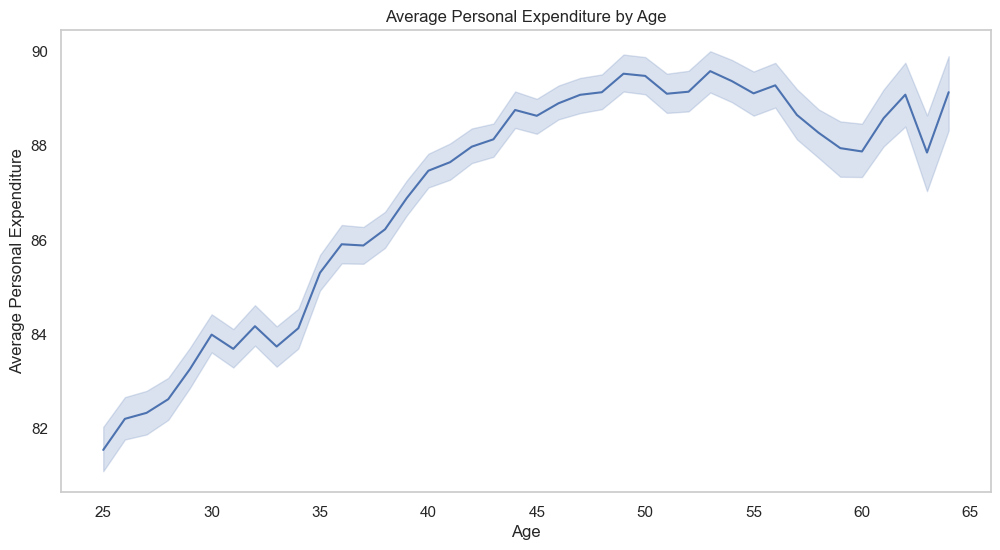

In [164]:
import matplotlib.pyplot as plt
import seaborn as sns



# Line Plot: Average Personal Expenditure by Age
plt.figure(figsize=(12, 6))
sns.lineplot(x='age', y='perconexp', estimator='mean', data=processed)
plt.xlabel("Age")
plt.ylabel("Average Personal Expenditure")
plt.title("Average Personal Expenditure by Age")
plt.grid()
plt.show()


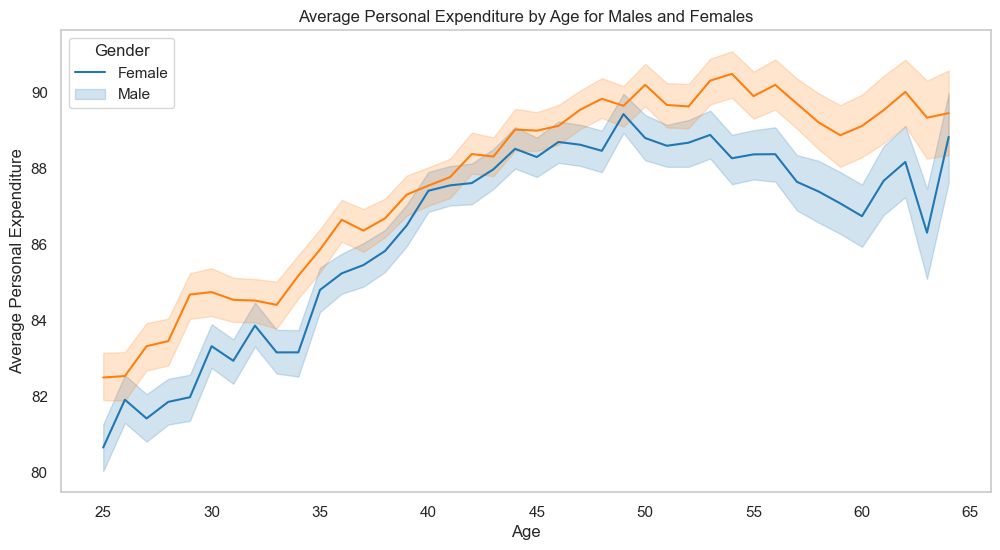

In [165]:
import matplotlib.pyplot as plt
import seaborn as sns

# Line Plot: Average Personal Expenditure by Age for Males and Females
plt.figure(figsize=(12, 6))
sns.lineplot(x='age', y='perconexp', hue='sex', estimator='mean', data=processed, palette='tab10')
plt.xlabel("Age")
plt.ylabel("Average Personal Expenditure")
plt.title("Average Personal Expenditure by Age for Males and Females")
plt.grid()
plt.legend(title='Gender', labels=['Female', 'Male'])  # Adjusting legend labels if needed
plt.show()


/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_3586/720548380.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='industry', y='age', data=processed, estimator='mean', palette='viridis')


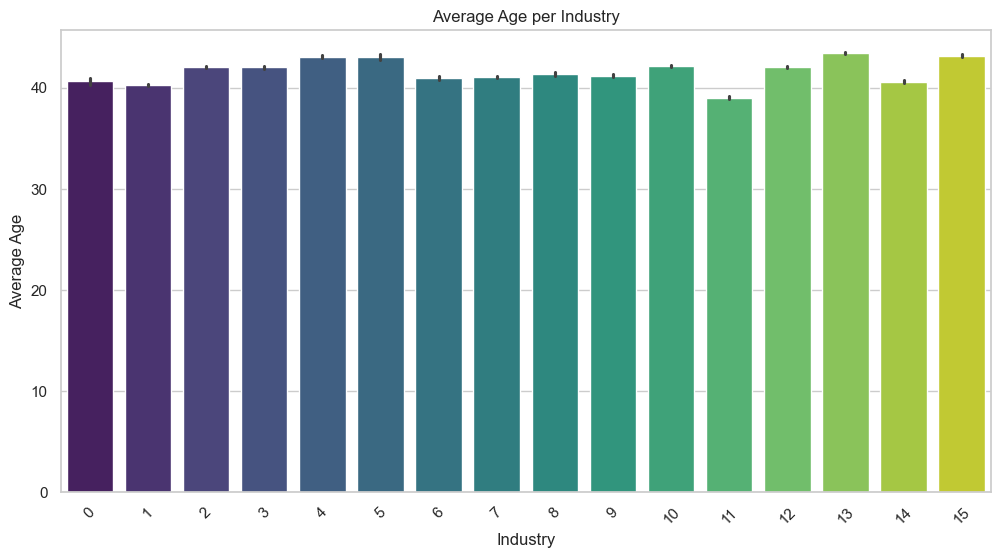

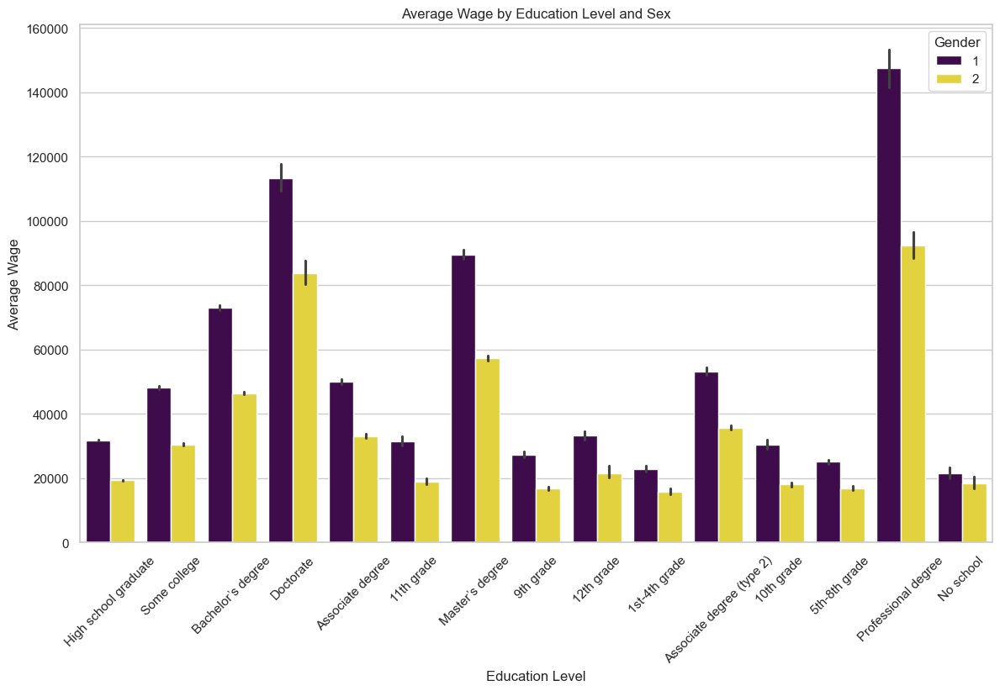

In [167]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define mappings for education levels
education_encodes = {
    1: 'No school', 4: '1st-4th grade', 5: '5th-8th grade', 6: '9th grade',
    7: '10th grade', 8: '11th grade', 9: '12th grade', 10: 'High school graduate',
    11: 'Some college', 13: 'Associate degree', 14: 'Associate degree (type 2)',
    15: 'Bachelor’s degree', 16: 'Master’s degree', 17: 'Professional degree', 18: 'Doctorate'
}

# Map numeric codes to readable labels
processed['educ_label'] = processed['educ99'].map(education_encodes)

# Bar Plot: Average wage by education and sex
plt.figure(figsize=(14, 8))
sns.barplot(x='educ_label', y='incwage', hue='sex', data=processed, estimator='mean', palette='viridis')
plt.xlabel("Education Level")
plt.ylabel("Average Wage")
plt.title("Average Wage by Education Level and Sex")
plt.xticks(rotation=45)
plt.legend(title='Gender')
plt.show()


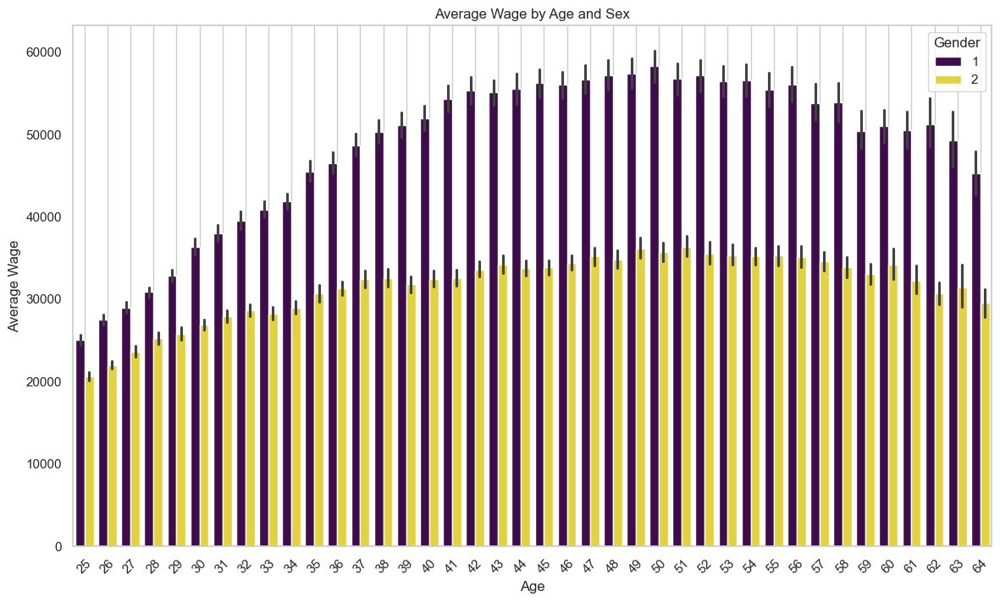

In [168]:
import matplotlib.pyplot as plt
import seaborn as sns

# Bar Plot: Average wage by age and sex
plt.figure(figsize=(14, 8))
sns.barplot(x='age', y='incwage', hue='sex', data=processed, estimator='mean', palette='viridis')
plt.xlabel("Age")
plt.ylabel("Average Wage")
plt.title("Average Wage by Age and Sex")
plt.xticks(rotation=45)
plt.legend(title='Gender')
plt.grid()
plt.show()


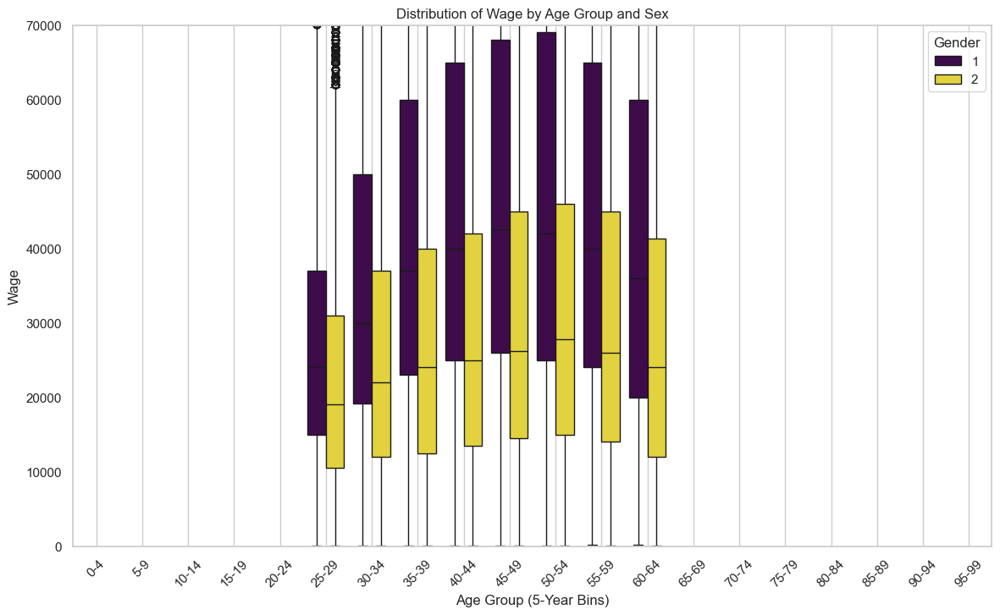

In [173]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'processed' is your DataFrame
# Create age bins of size 5
age_bins = range(0, 101, 5)  # Adjust the range as needed
age_labels = [f"{i}-{i+4}" for i in age_bins[:-1]]  # Create labels for the bins

# Create a new column for binned ages
processed['age_bin'] = pd.cut(processed['age'], bins=age_bins, labels=age_labels, right=False)

# Box Plot: Distribution of wage by age bins and sex
plt.figure(figsize=(14, 8))
sns.boxplot(x='age_bin', y='incwage', hue='sex', data=processed, palette='viridis')
plt.xlabel("Age Group (5-Year Bins)")
plt.ylabel("Wage")
plt.title("Distribution of Wage by Age Group and Sex")
plt.xticks(rotation=45)
plt.legend(title='Gender')
plt.grid()
plt.ylim(0, 70000)
plt.show()


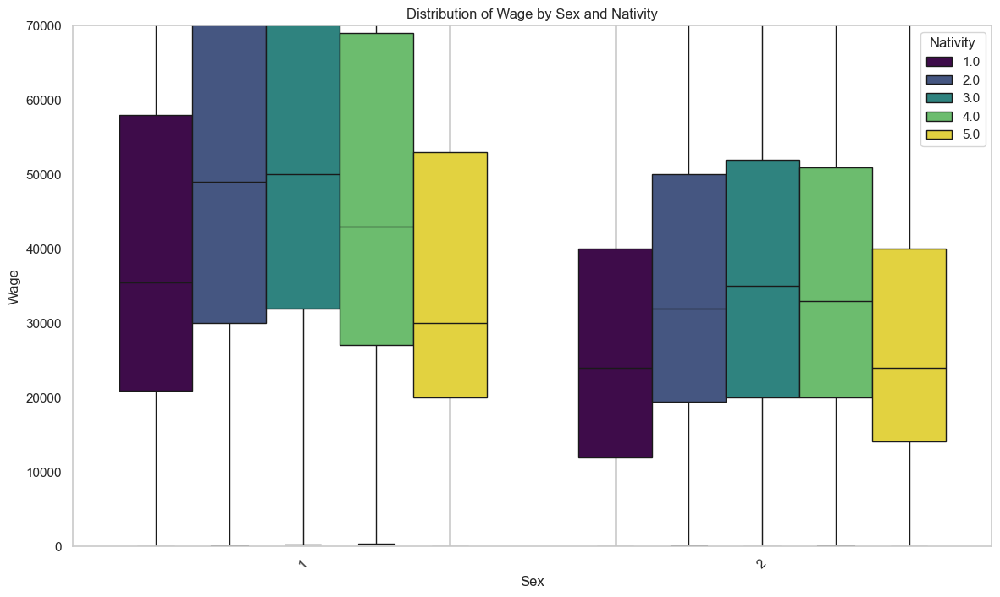

In [174]:
import matplotlib.pyplot as plt
import seaborn as sns

# Box Plot: Distribution of Wage by Sex and Nativity
plt.figure(figsize=(14, 8))
sns.boxplot(x='sex', y='incwage', hue='nativity', data=processed, palette='viridis')
plt.xlabel("Sex")
plt.ylabel("Wage")
plt.title("Distribution of Wage by Sex and Nativity")
plt.xticks(rotation=45)
plt.legend(title='Nativity')
plt.grid()
plt.ylim(0, 70000)  # Adjust the y-axis limit as needed
plt.show()


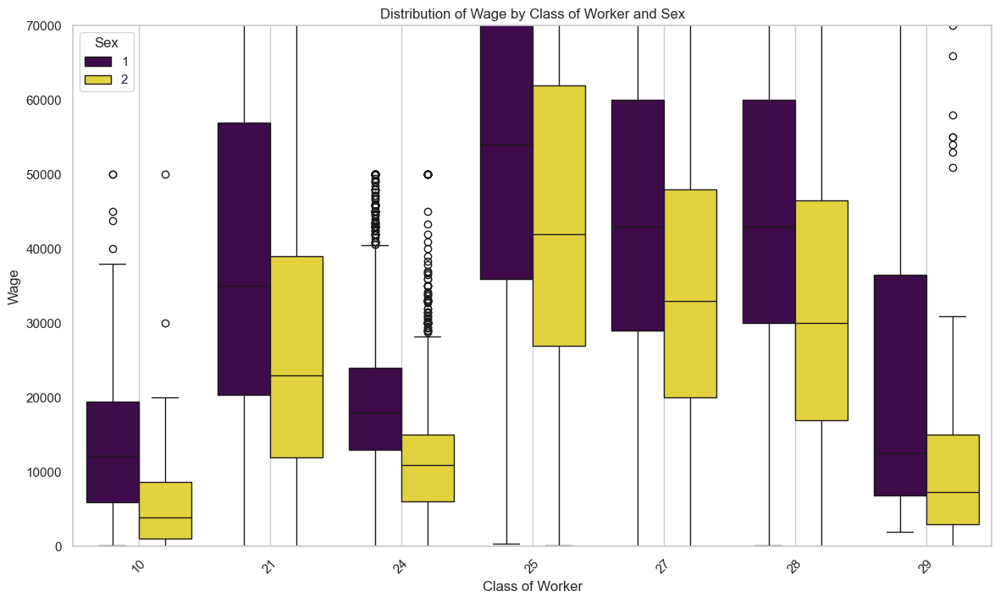

In [175]:
import matplotlib.pyplot as plt
import seaborn as sns

# Box Plot: Distribution of Wage by Sex and Class of Worker
plt.figure(figsize=(14, 8))
sns.boxplot(x='classwkr', y='incwage', hue='sex', data=processed, palette='viridis')
plt.xlabel("Class of Worker")
plt.ylabel("Wage")
plt.title("Distribution of Wage by Class of Worker and Sex")
plt.xticks(rotation=45)
plt.legend(title='Sex')
plt.grid()
plt.ylim(0, 70000)  # Adjust the y-axis limit as needed
plt.show()


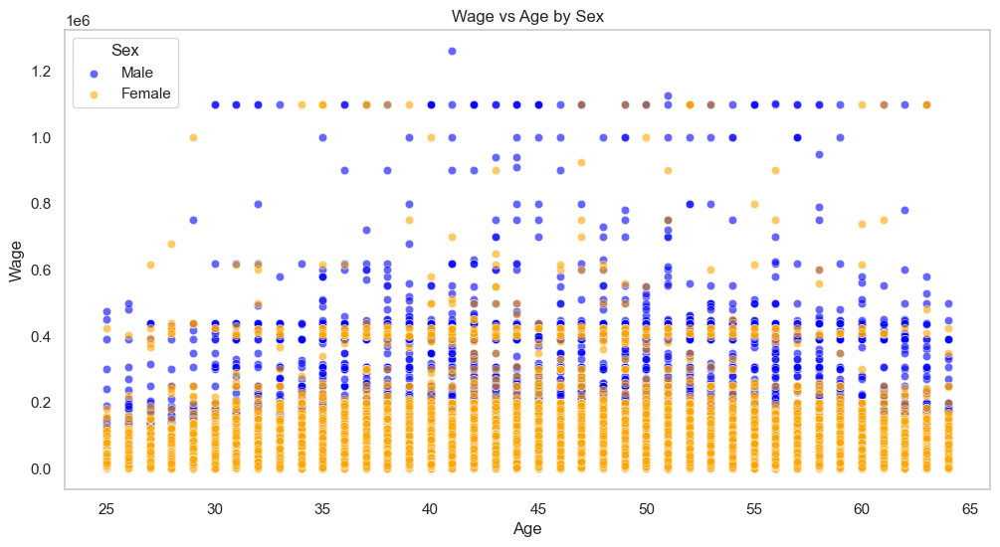

In [182]:
import matplotlib.pyplot as plt
import seaborn as sns

# Scatter Plot: Wage vs Age, differentiated by sex
plt.figure(figsize=(12, 6))

# Scatter plot for males
sns.scatterplot(x='age', y='incwage', data=processed[processed['sex'] == 1], color='blue', label='Male', alpha=0.6)

# Scatter plot for females
sns.scatterplot(x='age', y='incwage', data=processed[processed['sex'] == 2], color='orange', label='Female', alpha=0.6)

plt.xlabel("Age")
plt.ylabel("Wage")
plt.title("Wage vs Age by Sex")
plt.legend(title='Sex')
plt.grid()
plt.show()


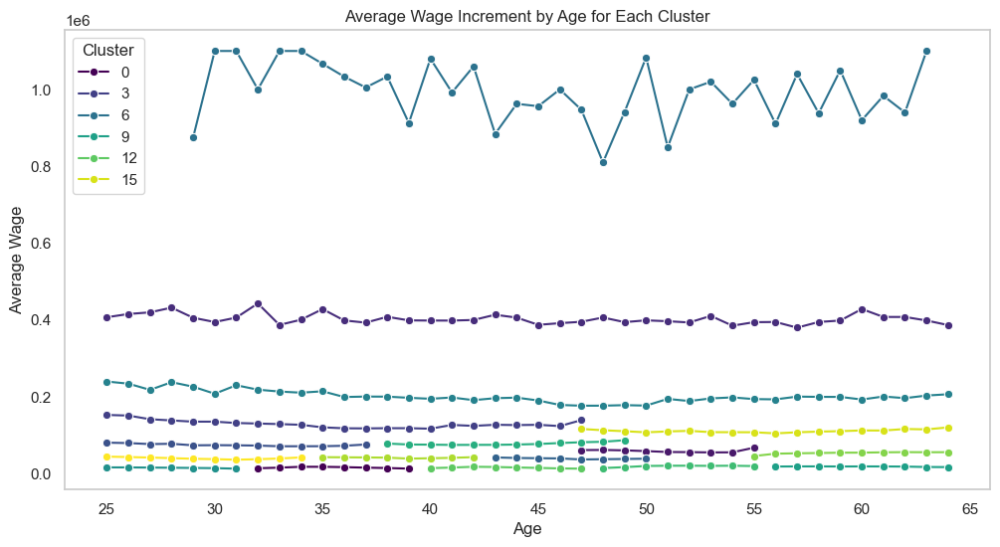

In [187]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# Step 1: Prepare the Data
data = processed[['age', 'incwage']].dropna()

# Step 2: Normalize the Data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(data)

# # Step 3: Determine optimal number of clusters using Elbow Method
# inertia = []
# k_values = range(1, 11)

# for k in k_values:
#     kmeans = KMeans(n_clusters=len(industry_columns)+1, random_state=42)
#     kmeans.fit(scaled_data)
#     inertia.append(kmeans.inertia_)

# # Plotting the Elbow Method
# plt.figure(figsize=(10, 6))
# plt.plot(k_values, inertia, marker='o')
# plt.xlabel('Number of Clusters')
# plt.ylabel('Inertia')
# plt.title('Elbow Method for Optimal k')
# plt.grid()
# plt.show()

# Step 4: Apply KMeans with the optimal number of clusters (e.g., 3)
optimal_k = len(industry_columns)+1  # Choose based on the elbow plot
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
data['cluster'] = kmeans.fit_predict(scaled_data)

# Step 5: Calculate Average Wage by Age for Each Cluster
age_wage_increment = data.groupby(['age', 'cluster'])['incwage'].mean().reset_index()

# Step 6: Plot the Results
plt.figure(figsize=(12, 6))
sns.lineplot(data=age_wage_increment, x='age', y='incwage', hue='cluster', palette='viridis', marker='o')
plt.xlabel("Age")
plt.ylabel("Average Wage")
plt.title("Average Wage Increment by Age for Each Cluster")
plt.legend(title='Cluster')
plt.grid()
plt.show()


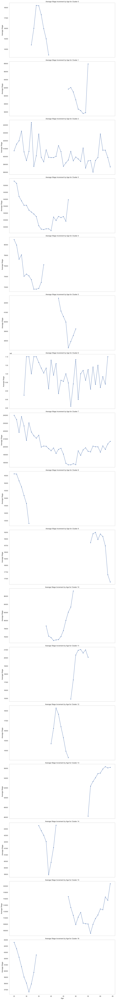

In [188]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# Step 1: Prepare the Data
data = processed[['age', 'incwage']].dropna()

# Step 2: Normalize the Data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(data)

# Step 4: Apply KMeans with the optimal number of clusters
optimal_k = len(industry_columns) + 1  # Choose based on the elbow plot
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
data['cluster'] = kmeans.fit_predict(scaled_data)

# Step 5: Calculate Average Wage by Age for Each Cluster
age_wage_increment = data.groupby(['age', 'cluster'])['incwage'].mean().reset_index()

# Step 6: Create Subplots for Each Cluster
unique_clusters = age_wage_increment['cluster'].unique()
num_clusters = len(unique_clusters)

# Set up the subplots
fig, axes = plt.subplots(num_clusters, 1, figsize=(12, 6 * num_clusters), sharex=True)

# Plot each cluster in a separate subplot
for cluster in unique_clusters:
    cluster_data = age_wage_increment[age_wage_increment['cluster'] == cluster]
    sns.lineplot(data=cluster_data, x='age', y='incwage', ax=axes[cluster], marker='o')
    axes[cluster].set_title(f"Average Wage Increment by Age for Cluster {cluster}")
    axes[cluster].set_ylabel("Average Wage")
    axes[cluster].grid()

# Set common x-axis label
plt.xlabel("Age")
plt.tight_layout()
plt.show()


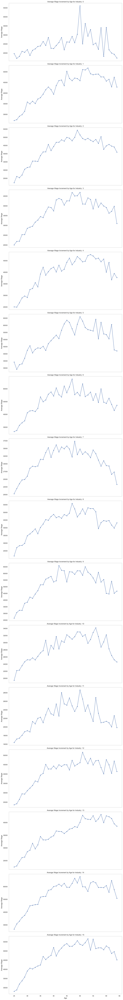

In [189]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Step 1: Prepare the Data
data = processed[['age', 'incwage', 'industry']].dropna()

# Step 2: Calculate Average Wage by Age for Each Industry
age_wage_increment = data.groupby(['age', 'industry'])['incwage'].mean().reset_index()

# Step 3: Create Subplots for Each Industry
unique_industries = age_wage_increment['industry'].unique()
num_industries = len(unique_industries)

# Set up the subplots
fig, axes = plt.subplots(num_industries, 1, figsize=(12, 6 * num_industries), sharex=True)

# Plot each industry in a separate subplot
for i, industry in enumerate(unique_industries):
    industry_data = age_wage_increment[age_wage_increment['industry'] == industry]
    sns.lineplot(data=industry_data, x='age', y='incwage', ax=axes[i], marker='o')
    axes[i].set_title(f"Average Wage Increment by Age for Industry: {industry}")
    axes[i].set_ylabel("Average Wage")
    axes[i].grid()

# Set common x-axis label
plt.xlabel("Age")
plt.tight_layout()
plt.show()


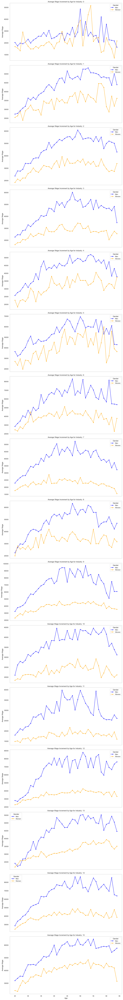

In [191]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Step 1: Prepare the Data
data = processed[['age', 'incwage', 'industry', 'sex']].dropna()

# Step 2: Calculate Average Wage by Age for Each Industry and Sex
age_wage_increment = data.groupby(['age', 'industry', 'sex'])['incwage'].mean().reset_index()

# Step 3: Create Subplots for Each Industry
unique_industries = age_wage_increment['industry'].unique()
num_industries = len(unique_industries)

# Set up the subplots
fig, axes = plt.subplots(num_industries, 1, figsize=(12, 6 * num_industries), sharex=True)

# Plot each industry in a separate subplot
for i, industry in enumerate(unique_industries):
    industry_data = age_wage_increment[age_wage_increment['industry'] == industry]
    
    # Separate the data for men and women
    male_data = industry_data[industry_data['sex'] == 1]
    female_data = industry_data[industry_data['sex'] == 2]
    
    # Plot for males
    sns.lineplot(data=male_data, x='age', y='incwage', ax=axes[i], marker='o', label='Men', color='blue')
    
    # Plot for females
    sns.lineplot(data=female_data, x='age', y='incwage', ax=axes[i], marker='o', label='Women', color='orange')
    
    axes[i].set_title(f"Average Wage Increment by Age for Industry: {industry}")
    axes[i].set_ylabel("Average Wage")
    axes[i].legend(title='Gender')
    axes[i].grid()

# Set common x-axis label
plt.xlabel("Age")
plt.tight_layout()
plt.show()


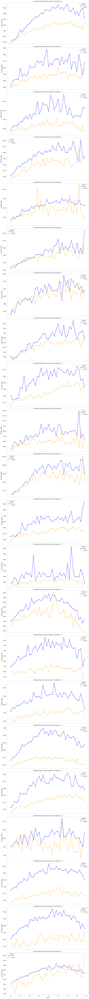

In [193]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Step 1: Prepare the Data
data = processed[['age', 'incwage', 'occupation', 'sex']].dropna()

# Step 2: Calculate Average Wage by Age for Each Occupation and Sex
age_wage_increment = data.groupby(['age', 'occupation', 'sex'])['incwage'].mean().reset_index()

# Step 3: Create Subplots for Each Occupation
unique_occupations = age_wage_increment['occupation'].unique()
num_occupations = len(unique_occupations)

# Set up the subplots
fig, axes = plt.subplots(num_occupations, 1, figsize=(12, 6 * num_occupations), sharex=True)

# Plot each occupation in a separate subplot
for i, occupation in enumerate(unique_occupations):
    occupation_data = age_wage_increment[age_wage_increment['occupation'] == occupation]
    
    # Separate the data for men and women
    male_data = occupation_data[occupation_data['sex'] == 'Male']
    female_data = occupation_data[occupation_data['sex'] == 'Female']
    
    # Plot for males
    sns.lineplot(data=male_data, x='age', y='incwage', ax=axes[i], marker='o', label='Men', color='blue')
    
    # Plot for females
    sns.lineplot(data=female_data, x='age', y='incwage', ax=axes[i], marker='o', label='Women', color='orange')
    
    axes[i].set_title(f"Average Wage Increment by Age for Occupation: {occupation}")
    axes[i].set_ylabel("Average Wage")
    axes[i].legend(title='Gender')
    axes[i].grid()

# Set common x-axis label
plt.xlabel("Age")
plt.tight_layout()
plt.show()


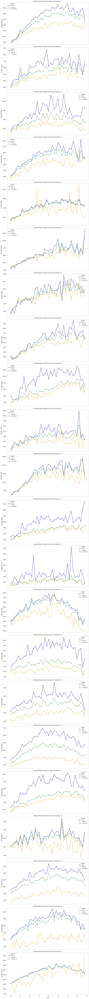

In [195]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Step 1: Prepare the Data
data = processed[['age', 'incwage', 'occupation', 'sex']].dropna()

# Step 2: Calculate Average Wage by Age for Each Occupation and Sex
age_wage_increment = data.groupby(['age', 'occupation', 'sex'])['incwage'].mean().reset_index()

# Calculate overall average wage regardless of sex
overall_wage_increment = data.groupby(['age', 'occupation'])['incwage'].mean().reset_index()
overall_wage_increment['sex'] = 'Combined'  # Add a new column for combined case

# Step 3: Create Subplots for Each Occupation
unique_occupations = age_wage_increment['occupation'].unique()
num_occupations = len(unique_occupations)

# Set up the subplots
fig, axes = plt.subplots(num_occupations, 1, figsize=(12, 6 * num_occupations), sharex=True)

# Plot each occupation in a separate subplot
for i, occupation in enumerate(unique_occupations):
    occupation_data = age_wage_increment[age_wage_increment['occupation'] == occupation]
    
    # Separate the data for men and women
    male_data = occupation_data[occupation_data['sex'] == 1]
    female_data = occupation_data[occupation_data['sex'] == 2]
    
    # Plot for males
    sns.lineplot(data=male_data, x='age', y='incwage', ax=axes[i], marker='o', label='Men', color='blue')
    
    # Plot for females
    sns.lineplot(data=female_data, x='age', y='incwage', ax=axes[i], marker='o', label='Women', color='orange')
    
    # Plot for combined average wage
    combined_data = overall_wage_increment[overall_wage_increment['occupation'] == occupation]
    sns.lineplot(data=combined_data, x='age', y='incwage', ax=axes[i], marker='o', label='Combined', color='green', linestyle='--')
    
    axes[i].set_title(f"Average Wage Increment by Age for Occupation: {occupation}")
    axes[i].set_ylabel("Average Wage")
    axes[i].legend(title='Gender')
    axes[i].grid()

# Set common x-axis label
plt.xlabel("Age")
plt.tight_layout()
plt.show()


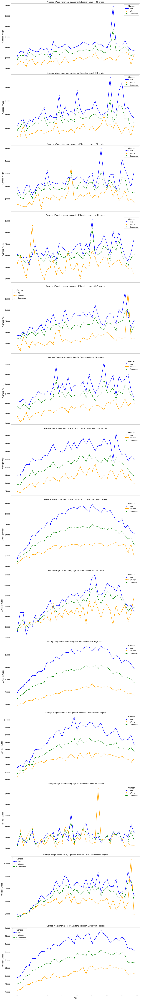

In [196]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Step 1: Prepare the Data
data = processed[['age', 'incwage', 'education', 'sex']].dropna()

# Step 2: Calculate Average Wage by Age for Each Education Level and Sex
age_wage_increment = data.groupby(['age', 'education', 'sex'])['incwage'].mean().reset_index()

# Calculate overall average wage regardless of sex
overall_wage_increment = data.groupby(['age', 'education'])['incwage'].mean().reset_index()
overall_wage_increment['sex'] = 'Combined'  # Add a new column for combined case

# Step 3: Create Subplots for Each Education Level
unique_education_levels = age_wage_increment['education'].unique()
num_education_levels = len(unique_education_levels)

# Set up the subplots
fig, axes = plt.subplots(num_education_levels, 1, figsize=(12, 6 * num_education_levels), sharex=True)

# Plot each education level in a separate subplot
for i, education in enumerate(unique_education_levels):
    education_data = age_wage_increment[age_wage_increment['education'] == education]
    
    # Separate the data for men and women
    male_data = education_data[education_data['sex'] == 1]
    female_data = education_data[education_data['sex'] == 2]
    
    # Plot for males
    sns.lineplot(data=male_data, x='age', y='incwage', ax=axes[i], marker='o', label='Men', color='blue')
    
    # Plot for females
    sns.lineplot(data=female_data, x='age', y='incwage', ax=axes[i], marker='o', label='Women', color='orange')
    
    # Plot for combined average wage
    combined_data = overall_wage_increment[overall_wage_increment['education'] == education]
    sns.lineplot(data=combined_data, x='age', y='incwage', ax=axes[i], marker='o', label='Combined', color='green', linestyle='--')
    
    axes[i].set_title(f"Average Wage Increment by Age for Education Level: {education}")
    axes[i].set_ylabel("Average Wage")
    axes[i].legend(title='Gender')
    axes[i].grid()

# Set common x-axis label
plt.xlabel("Age")
plt.tight_layout()
plt.show()


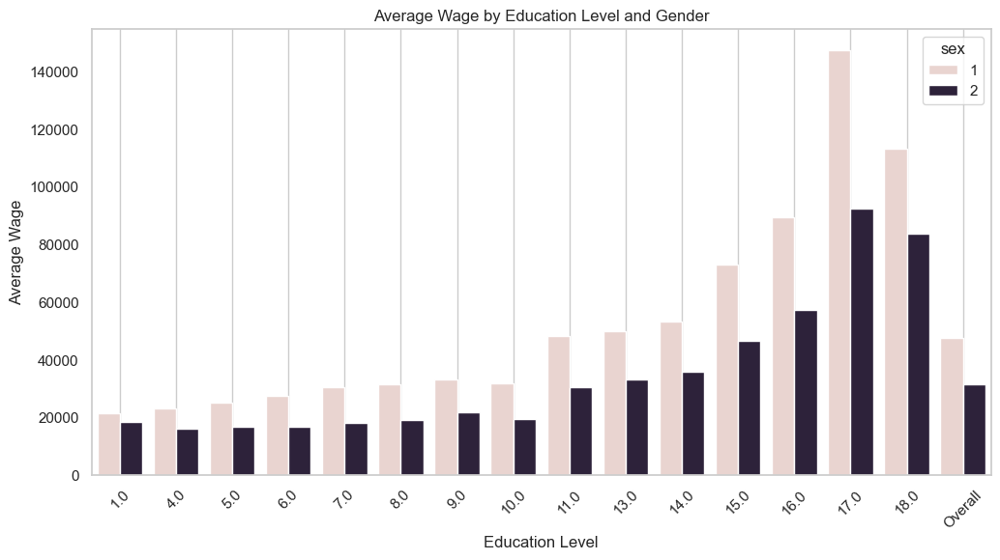

In [201]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assume 'data' is your DataFrame
# Step 1: Prepare the data
education_wage = processed.groupby(['educ99', 'sex'])['incwage'].mean().reset_index()
overall_wage = processed.groupby(['sex'])['incwage'].mean().reset_index()
overall_wage['educ99'] = 'Overall'

# Step 2: Combine data for visualization
combined_wage = pd.concat([education_wage, overall_wage], ignore_index=True)

# Step 3: Create the plot
plt.figure(figsize=(12, 6))
sns.barplot(data=combined_wage, x='educ99', y='incwage', hue='sex')
plt.title('Average Wage by Education Level and Gender')
plt.ylabel('Average Wage')
plt.xlabel('Education Level')
plt.xticks(rotation=45)
plt.grid()
plt.show()


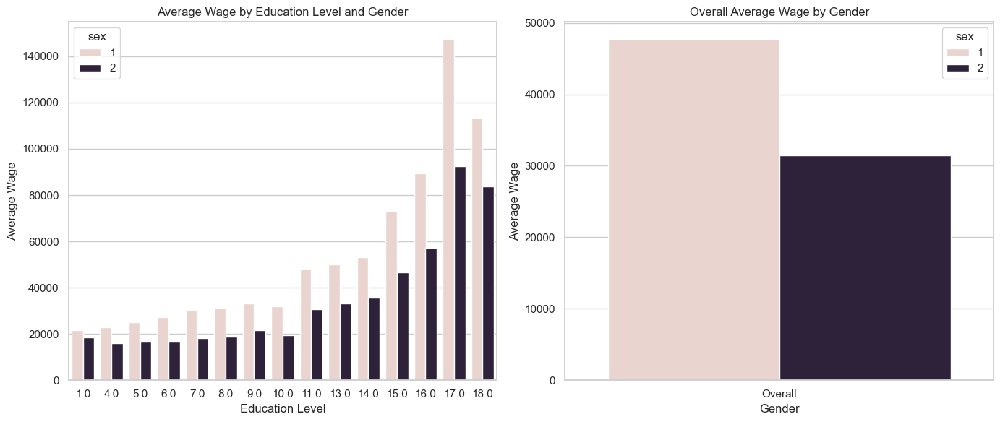

In [203]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Sample data setup (replace this with your actual data)


# Step 1: Calculate average wages
grouped_data = processed.groupby(['educ99', 'sex'])['incwage'].mean().reset_index()
overall_wage = processed.groupby('sex')['incwage'].mean().reset_index()
overall_wage['educ99'] = 'Overall'  # Label for overall averages

# Step 2: Combine data for visualization
combined_wage = pd.concat([grouped_data, overall_wage], ignore_index=True)

# Step 3: Create subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 6))

# Bar plot for segmented data
sns.barplot(data=grouped_data, x='educ99', y='incwage', hue='sex', ax=axes[0])
axes[0].set_title('Average Wage by Education Level and Gender')
axes[0].set_ylabel('Average Wage')
axes[0].set_xlabel('Education Level')

# Bar plot for aggregated data
sns.barplot(data=overall_wage, x='educ99', y='incwage', hue='sex', ax=axes[1])
axes[1].set_title('Overall Average Wage by Gender')
axes[1].set_ylabel('Average Wage')
axes[1].set_xlabel('Gender')

plt.tight_layout()
plt.show()


In [211]:
import pandas as pd

def check_simpsons_paradox(data, group_col, target_col):
    """
    Checks for Simpson's Paradox in the given dataset.
    
    Parameters:
    data (pd.DataFrame): The input data containing the group and target columns.
    group_col (str): The column name to group by (e.g., education, occupation).
    target_col (str): The target column for comparison (e.g., incwage).
    
    Returns:
    dict: A dictionary containing the results of the analysis.
    """
    
    # Calculate the mean for each group
    grouped_means = data.groupby(group_col)[target_col].mean().reset_index()
    
    # Calculate the overall mean
    overall_mean = data[target_col].mean()
    
    # Prepare the results
    results = {
        'grouped_means': grouped_means,
        'overall_mean': overall_mean,
        'is_simpsons_paradox': None
    }
    
    # Check for trends
    # We can check if the subgroup means follow a different trend than the overall mean
    if (grouped_means[target_col].iloc[0] > overall_mean and 
        all(grouped_means[target_col].diff().iloc[1:] < 0)) or \
       (grouped_means[target_col].iloc[0] < overall_mean and 
        all(grouped_means[target_col].diff().iloc[1:] > 0)):
        results['is_simpsons_paradox'] = True
    else:
        results['is_simpsons_paradox'] = False
    
    return results


In [218]:


import pandas as pd
import numpy as np
import statsmodels.api as sm
import matplotlib.pyplot as plt
import seaborn as sns

def check_simpsons_paradox(data, group_col, target_col):
    """
    Checks for Simpson's Paradox in the given dataset, including statistical analysis and visualization.
    
    Parameters:
    data (pd.DataFrame): The input data containing the group and target columns.
    group_col (str): The column name to group by (e.g., education, occupation).
    target_col (str): The target column for comparison (e.g., incwage).
    
    Returns:
    dict: A dictionary containing the results of the analysis.
    """
    
    # Calculate the mean for each group
    grouped_means = data.groupby(group_col)[target_col].mean().reset_index()
    
    # Calculate the overall mean
    overall_mean = data[target_col].mean()
    
    # Prepare the results
    results = {
        'grouped_means': grouped_means,
        'overall_mean': overall_mean,
        'is_simpsons_paradox': None
    }
    
    # Check for trends using regression analysis
    # Create a dummy variable for the group column
    data['group_dummy'] = pd.factorize(data[group_col])[0]
    
    # Fit a linear regression model
    X = sm.add_constant(data['group_dummy'])  # Add a constant term
    model = sm.OLS(data[target_col], X).fit()
    
    # Collect model statistics
    results['model_summary'] = model.summary()
    
    # Visualize the relationship
    plt.figure(figsize=(12, 6))
    sns.boxplot(x=group_col, y=target_col, data=data)
    plt.axhline(y=overall_mean, color='r', linestyle='--', label='Overall Mean')
    plt.title(f'Boxplot of {target_col} by {group_col}')
    plt.legend()
    plt.show()
    
    # Analyze trends in grouped means
    trends = grouped_means[target_col].diff().fillna(0)
    
    # Check for Simpson's Paradox
    if (grouped_means[target_col].iloc[0] > overall_mean and all(trends[1:] < 0)) or \
       (grouped_means[target_col].iloc[0] < overall_mean and all(trends[1:] > 0)):
        results['is_simpsons_paradox'] = True
    else:
        results['is_simpsons_paradox'] = False
    
    return results

Columns to check for Simpson's Paradox:
('sex', 'year')
('sex', 'hwtsupp')
('sex', 'region')
('sex', 'statefip')
('sex', 'metro')
('sex', 'pernum')
('sex', 'relate')
('sex', 'age')
('sex', 'race')
('sex', 'marst')
('sex', 'nativity')
('sex', 'educ99')
('sex', 'classwkr')
('sex', 'wkswork1')
('sex', 'hrswork')
('sex', 'uhrswork')
('sex', 'union')
('sex', 'incwage')
('sex', 'inclongj')
('sex', 'srcearn')
('sex', 'qinclong')
('sex', 'hisp')
('sex', 'annhrs')
('sex', 'incwageman')
('sex', 'hrwage')
('sex', 'perconexp')
('sex', 'hdwfcoh')
('sex', 'industry')
('sex', 'occupation')
('sex', 'group_dummy')


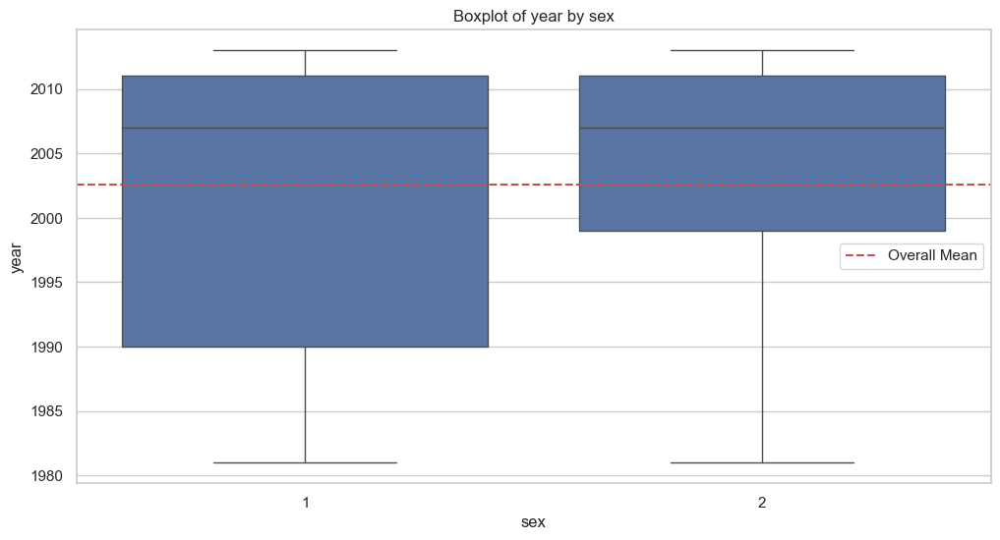


Checking Simpson's Paradox for 'sex' and 'year':
Grouped Means:
    sex         year
0    1  2002.274957
1    2  2002.937794
Overall Mean: 2002.5991222439418
Is Simpson's Paradox Present?: True


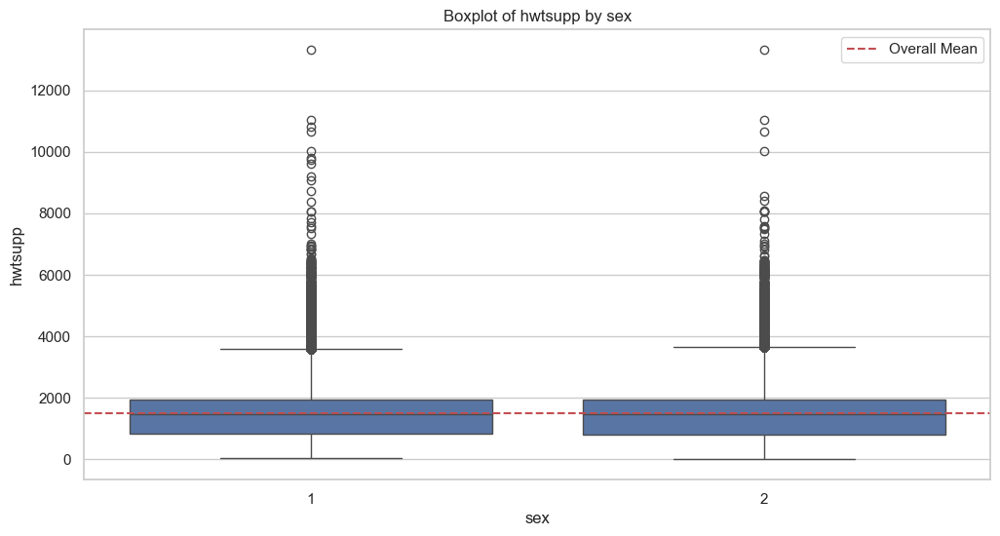


Checking Simpson's Paradox for 'sex' and 'hwtsupp':
Grouped Means:
    sex      hwtsupp
0    1  1507.321342
1    2  1507.278187
Overall Mean: 1507.3002362766626
Is Simpson's Paradox Present?: True


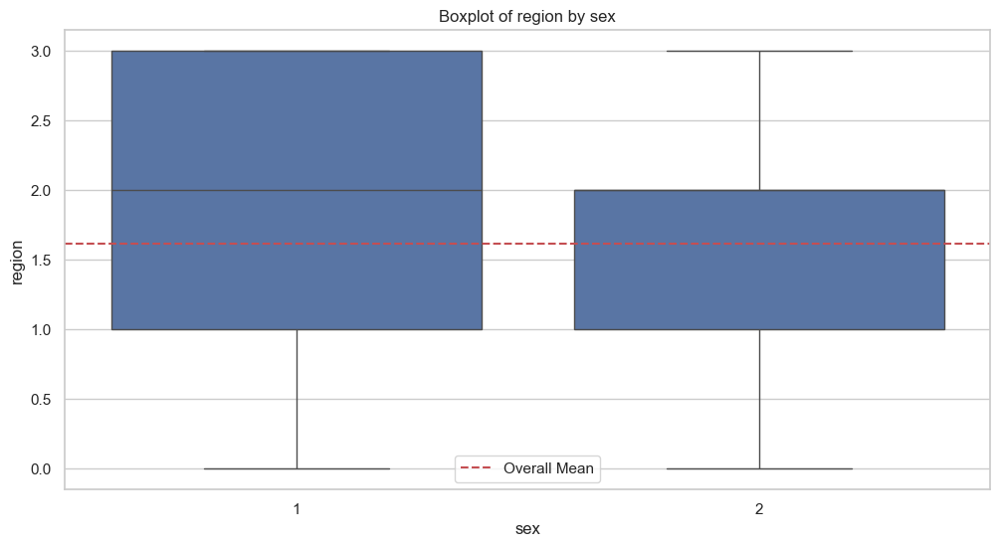


Checking Simpson's Paradox for 'sex' and 'region':
Grouped Means:
    sex    region
0    1  1.636936
1    2  1.594924
Overall Mean: 1.6163898143118967
Is Simpson's Paradox Present?: True


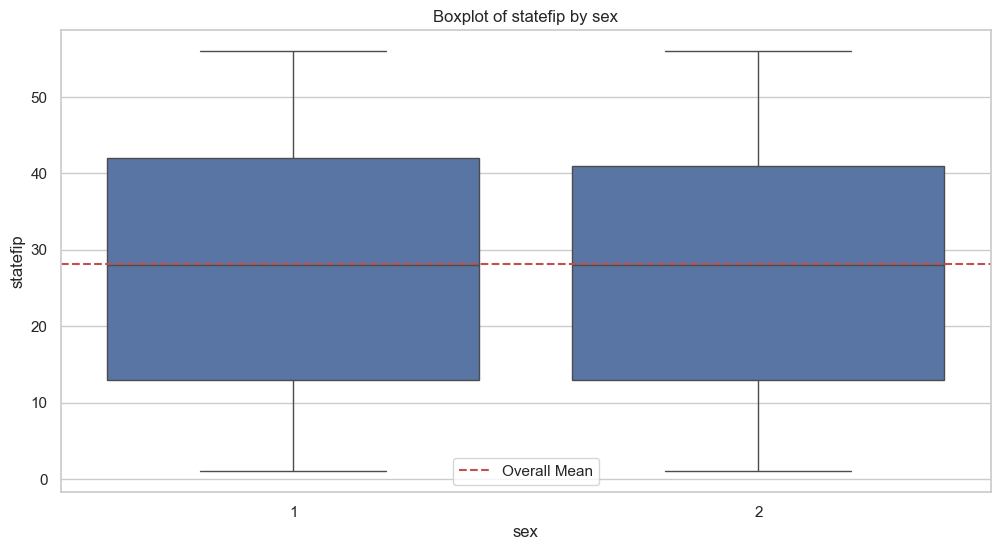


Checking Simpson's Paradox for 'sex' and 'statefip':
Grouped Means:
    sex   statefip
0    1  28.123909
1    2  28.117968
Overall Mean: 28.121003697496565
Is Simpson's Paradox Present?: True


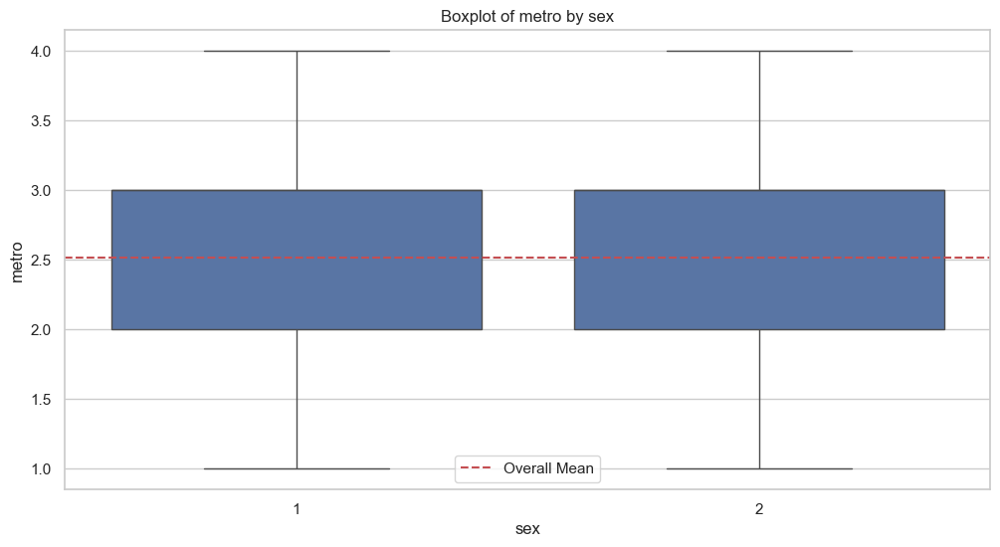


Checking Simpson's Paradox for 'sex' and 'metro':
Grouped Means:
    sex     metro
0    1  2.521025
1    2  2.508404
Overall Mean: 2.514852434161034
Is Simpson's Paradox Present?: True


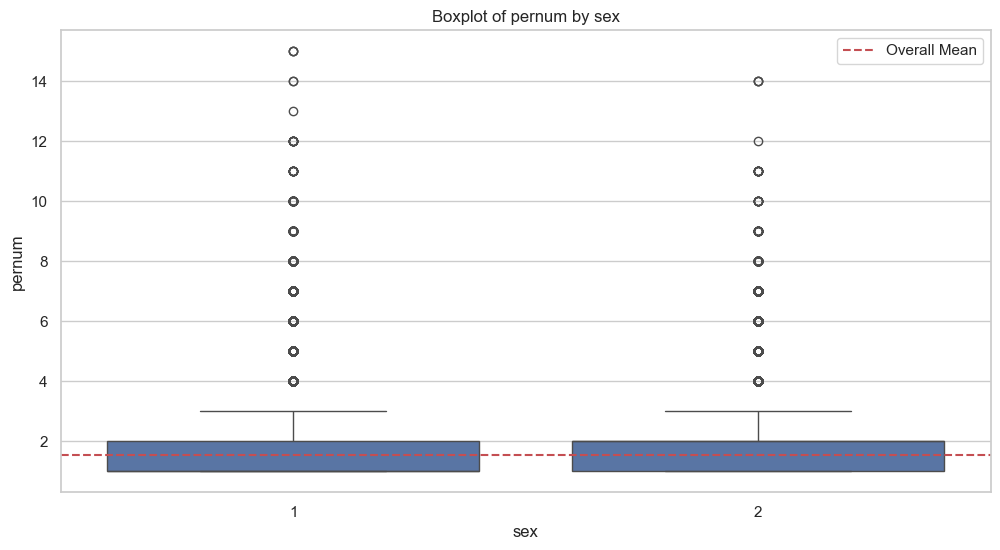


Checking Simpson's Paradox for 'sex' and 'pernum':
Grouped Means:
    sex    pernum
0    1  1.436954
1    2  1.637995
Overall Mean: 1.5352743495978645
Is Simpson's Paradox Present?: True


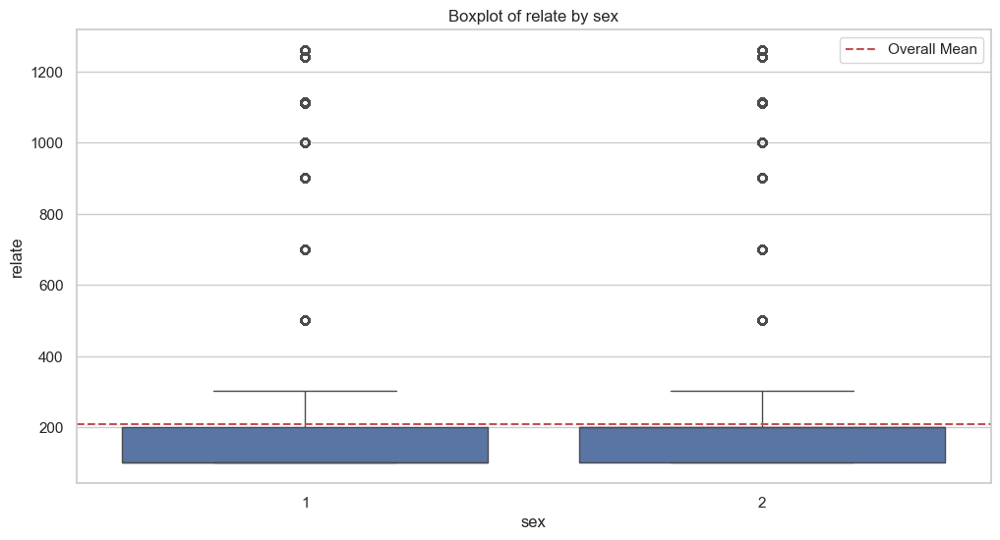


Checking Simpson's Paradox for 'sex' and 'relate':
Grouped Means:
    sex      relate
0    1  200.259421
1    2  216.213795
Overall Mean: 208.0620209302123
Is Simpson's Paradox Present?: True


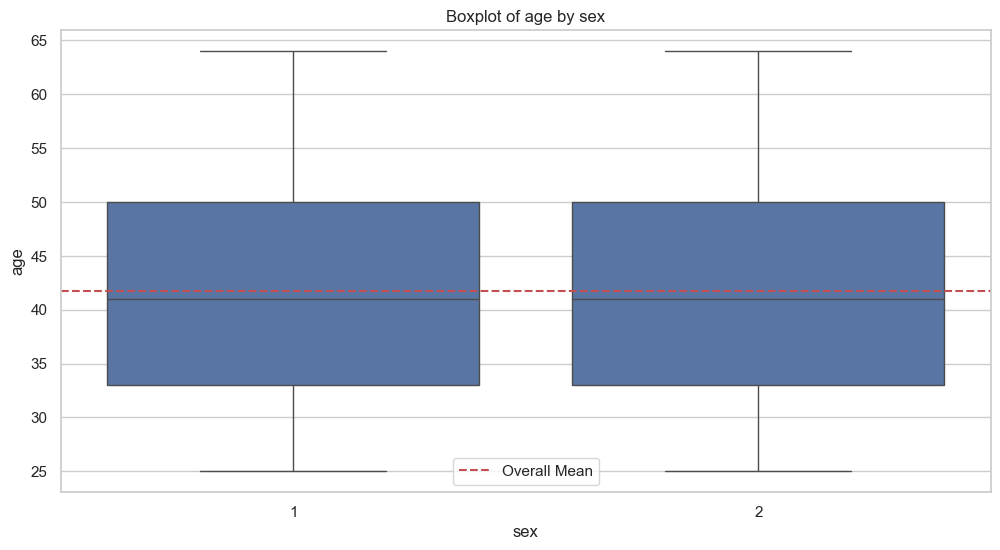


Checking Simpson's Paradox for 'sex' and 'age':
Grouped Means:
    sex        age
0    1  41.580430
1    2  41.895187
Overall Mean: 41.73436406254085
Is Simpson's Paradox Present?: True


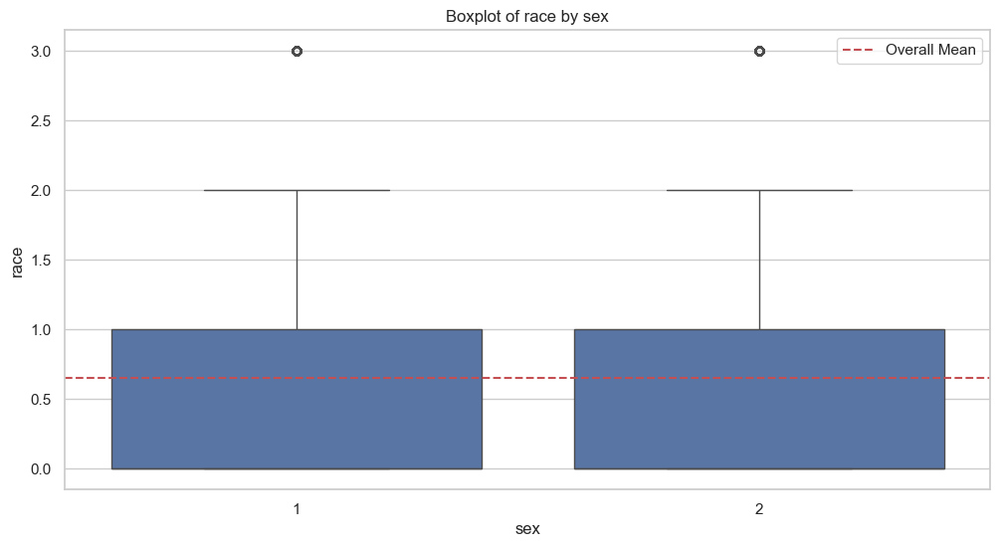


Checking Simpson's Paradox for 'sex' and 'race':
Grouped Means:
    sex      race
0    1  0.671783
1    2  0.628581
Overall Mean: 0.6506548315794671
Is Simpson's Paradox Present?: True


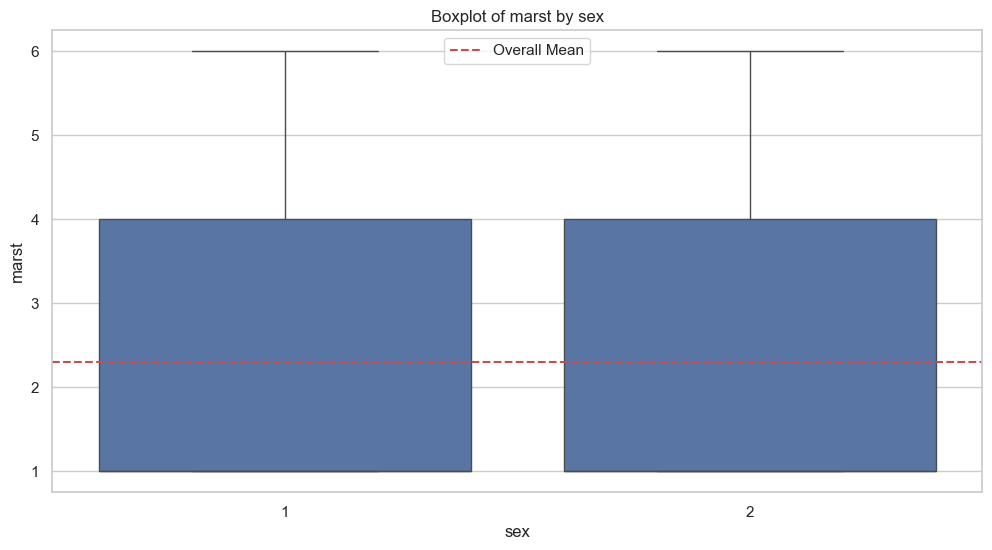


Checking Simpson's Paradox for 'sex' and 'marst':
Grouped Means:
    sex     marst
0    1  2.169074
1    2  2.436666
Overall Mean: 2.299941618475284
Is Simpson's Paradox Present?: True


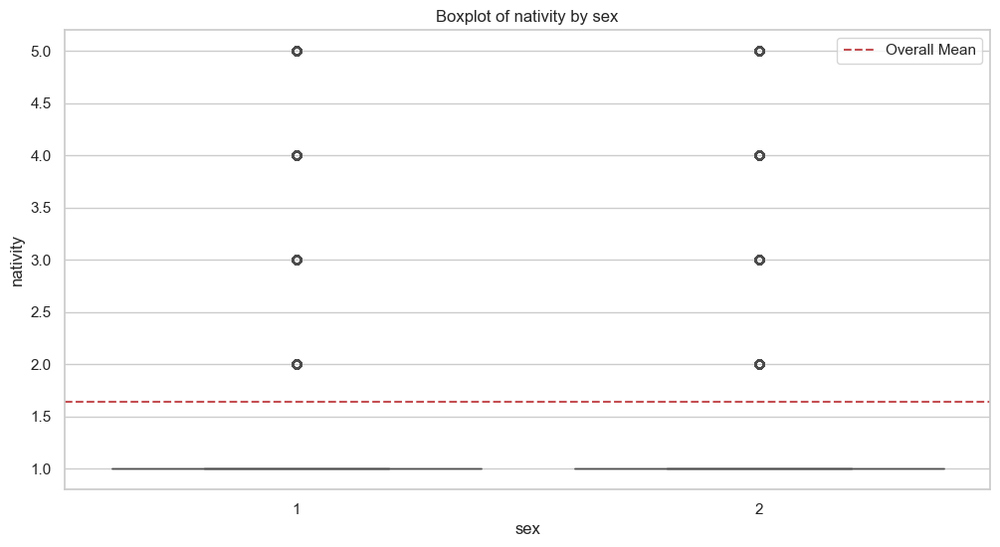


Checking Simpson's Paradox for 'sex' and 'nativity':
Grouped Means:
    sex  nativity
0    1  1.686421
1    2  1.597181
Overall Mean: 1.6427776825729696
Is Simpson's Paradox Present?: True


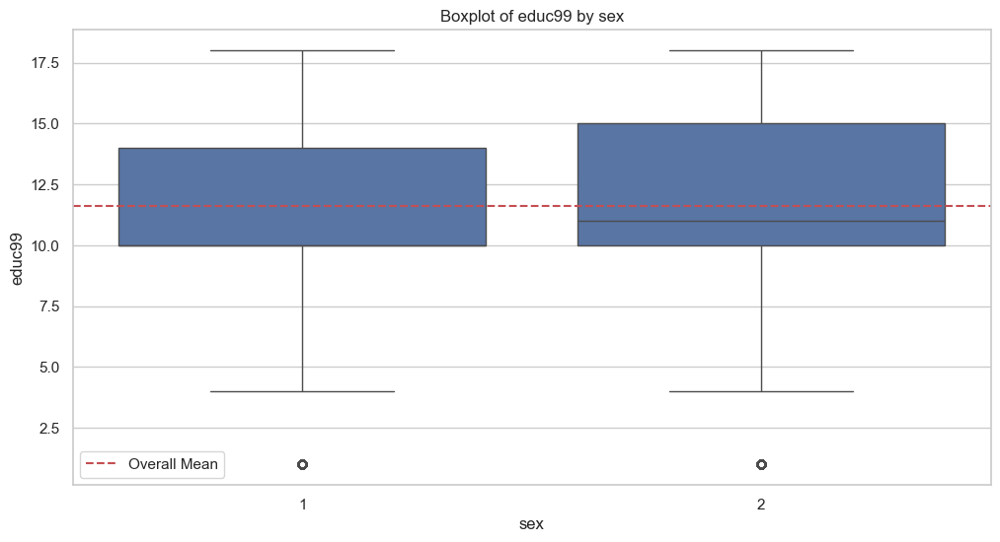


Checking Simpson's Paradox for 'sex' and 'educ99':
Grouped Means:
    sex     educ99
0    1  11.458067
1    2  11.795921
Overall Mean: 11.623296842459924
Is Simpson's Paradox Present?: True


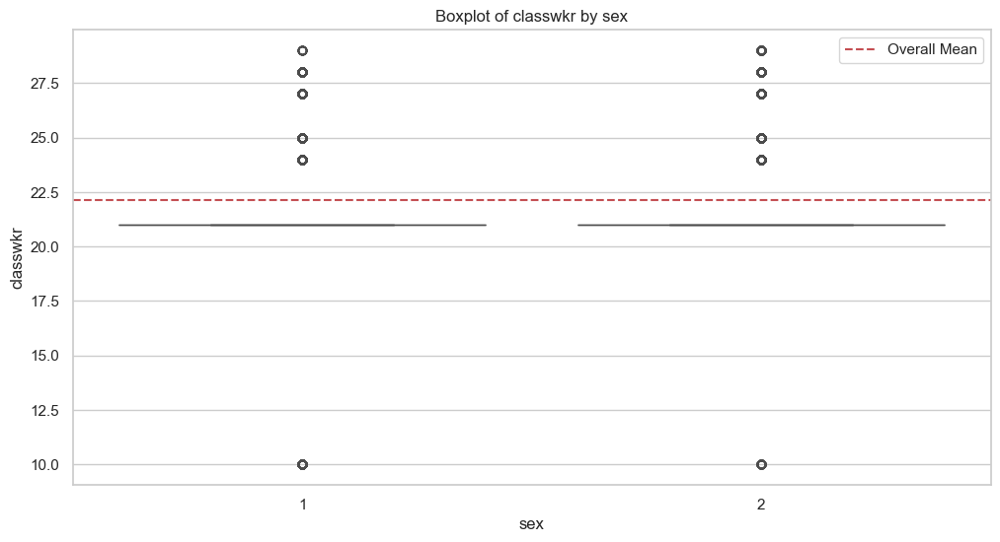


Checking Simpson's Paradox for 'sex' and 'classwkr':
Grouped Means:
    sex   classwkr
0    1  21.906663
1    2  22.342935
Overall Mean: 22.12002486297769
Is Simpson's Paradox Present?: True


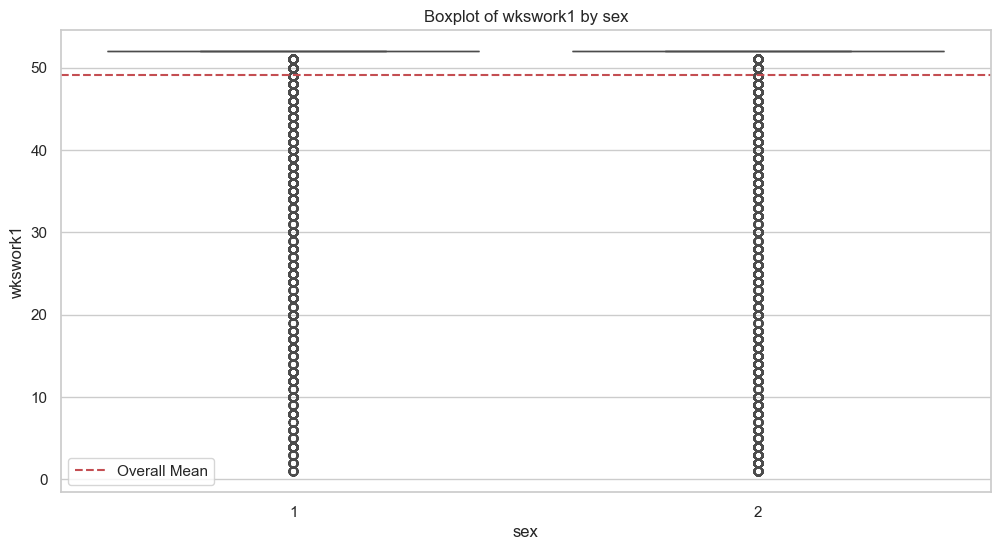


Checking Simpson's Paradox for 'sex' and 'wkswork1':
Grouped Means:
    sex   wkswork1
0    1  49.902337
1    2  48.401560
Overall Mean: 49.16837115546041
Is Simpson's Paradox Present?: True


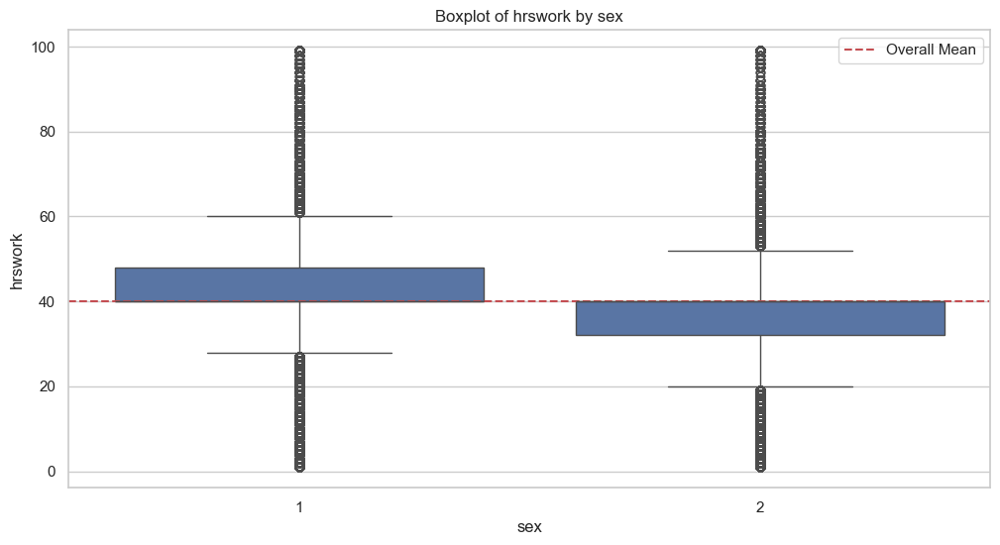


Checking Simpson's Paradox for 'sex' and 'hrswork':
Grouped Means:
    sex    hrswork
0    1  42.861072
1    2  37.281857
Overall Mean: 40.13251734744559
Is Simpson's Paradox Present?: True


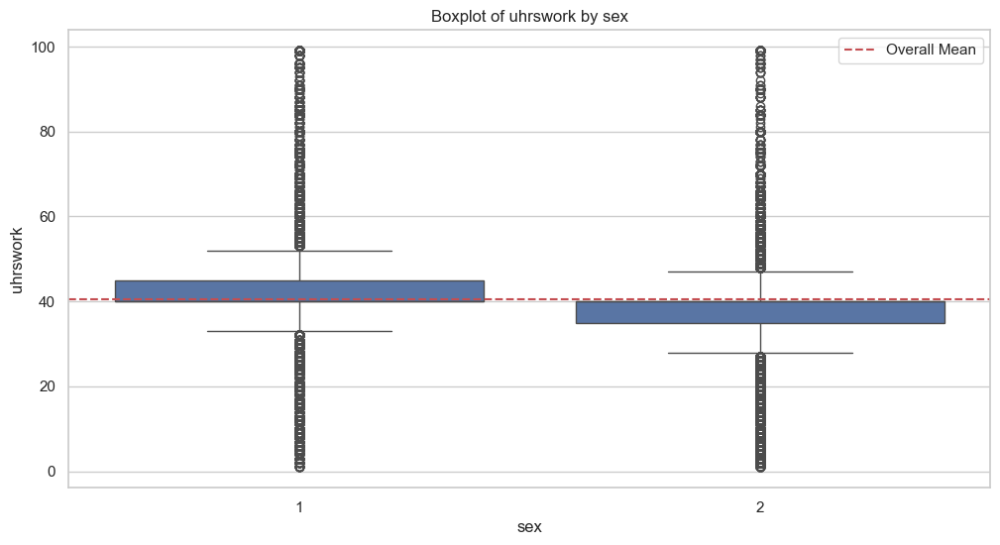


Checking Simpson's Paradox for 'sex' and 'uhrswork':
Grouped Means:
    sex   uhrswork
0    1  43.237006
1    2  37.796426
Overall Mean: 40.57625178993108
Is Simpson's Paradox Present?: True


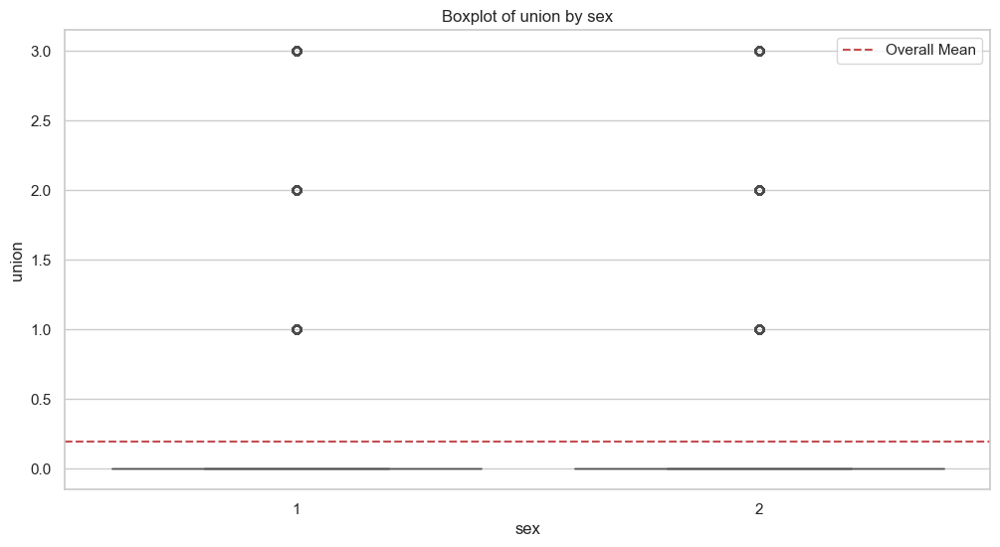


Checking Simpson's Paradox for 'sex' and 'union':
Grouped Means:
    sex     union
0    1  0.193922
1    2  0.194570
Overall Mean: 0.1942391086506316
Is Simpson's Paradox Present?: True


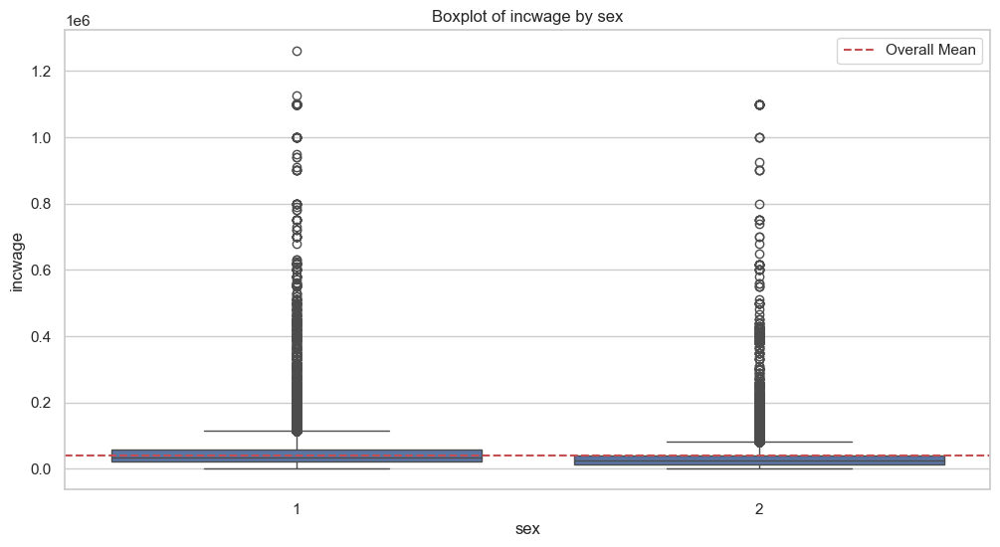


Checking Simpson's Paradox for 'sex' and 'incwage':
Grouped Means:
    sex       incwage
0    1  47729.860941
1    2  31436.945960
Overall Mean: 39761.695274581965
Is Simpson's Paradox Present?: True


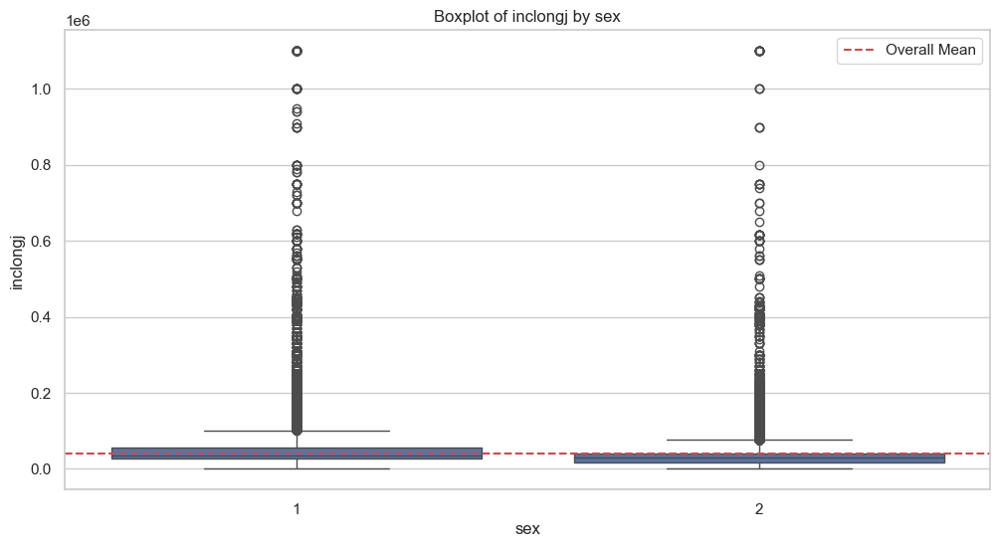


Checking Simpson's Paradox for 'sex' and 'inclongj':
Grouped Means:
    sex      inclongj
0    1  48090.811552
1    2  32971.053268
Overall Mean: 40696.38649150273
Is Simpson's Paradox Present?: True


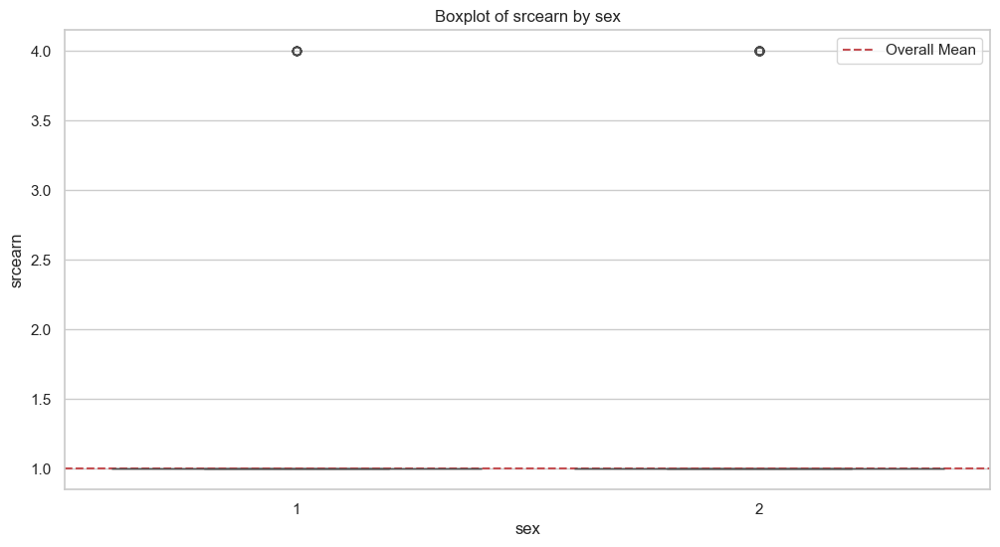


Checking Simpson's Paradox for 'sex' and 'srcearn':
Grouped Means:
    sex   srcearn
0    1  1.000171
1    2  1.000659
Overall Mean: 1.0004095420390546
Is Simpson's Paradox Present?: True


/Users/dhyutimac/.pyenv/versions/3.10.4/lib/python3.10/site-packages/statsmodels/regression/linear_model.py:1782: RuntimeWarning: invalid value encountered in scalar divide
  return 1 - self.ssr/self.centered_tss
/Users/dhyutimac/.pyenv/versions/3.10.4/lib/python3.10/site-packages/statsmodels/regression/linear_model.py:1871: RuntimeWarning: invalid value encountered in scalar divide
  return self.mse_model/self.mse_resid
/Users/dhyutimac/.pyenv/versions/3.10.4/lib/python3.10/site-packages/statsmodels/regression/linear_model.py:955: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
/Users/dhyutimac/.pyenv/versions/3.10.4/lib/python3.10/site-packages/statsmodels/stats/stattools.py:50: RuntimeWarning: invalid value encountered in scalar divide
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)


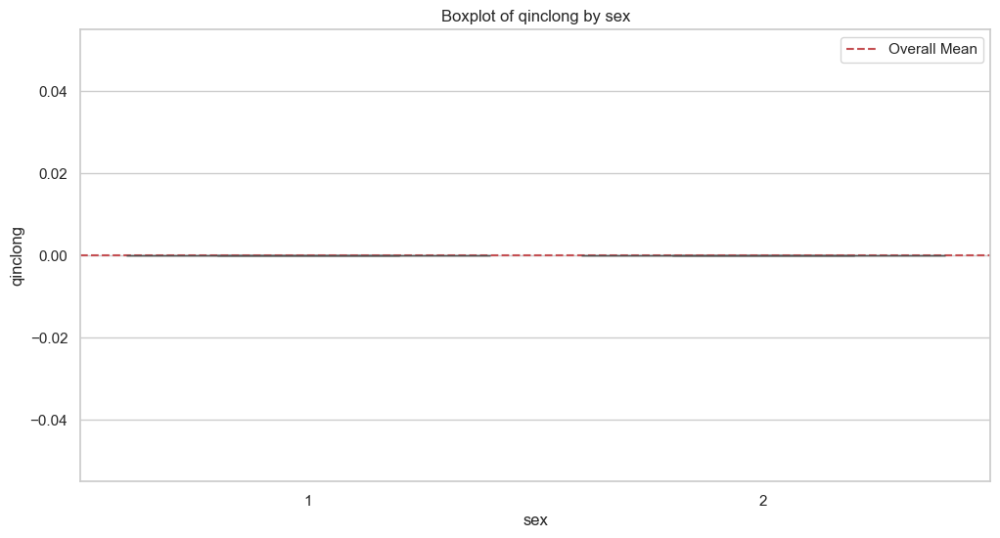


Checking Simpson's Paradox for 'sex' and 'qinclong':
Grouped Means:
    sex  qinclong
0    1       0.0
1    2       0.0
Overall Mean: 0.0
Is Simpson's Paradox Present?: False


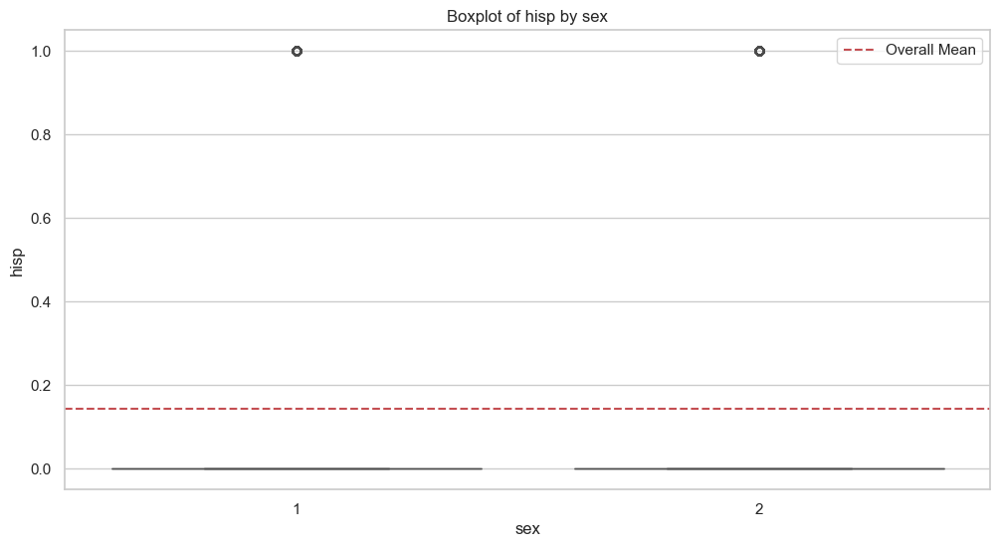


Checking Simpson's Paradox for 'sex' and 'hisp':
Grouped Means:
    sex      hisp
0    1  0.155925
1    2  0.129793
Overall Mean: 0.1431451085867314
Is Simpson's Paradox Present?: True


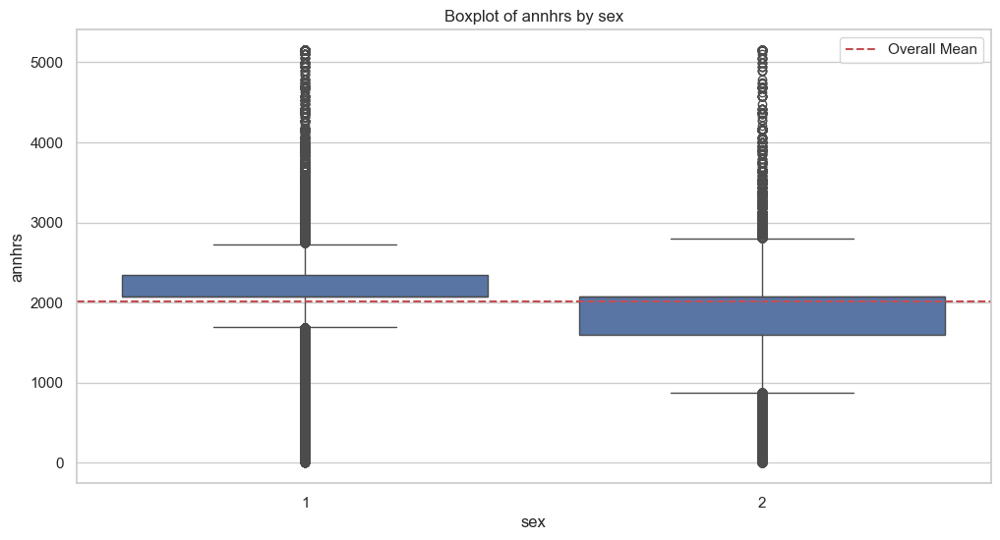


Checking Simpson's Paradox for 'sex' and 'annhrs':
Grouped Means:
    sex       annhrs
0    1  2166.295615
1    2  1853.245938
Overall Mean: 2013.1964494738402
Is Simpson's Paradox Present?: True


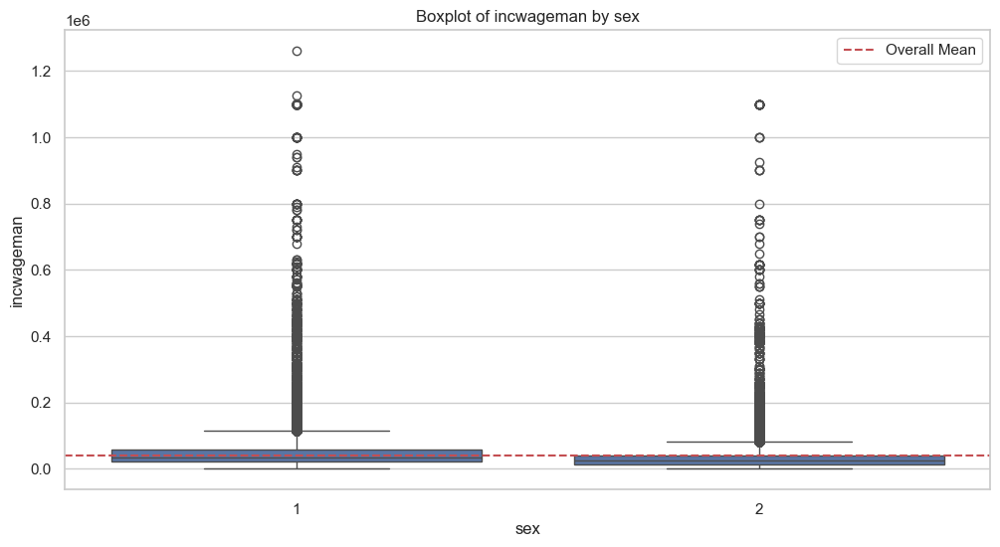


Checking Simpson's Paradox for 'sex' and 'incwageman':
Grouped Means:
    sex    incwageman
0    1  47729.860941
1    2  31436.945960
Overall Mean: 39761.695274581965
Is Simpson's Paradox Present?: True


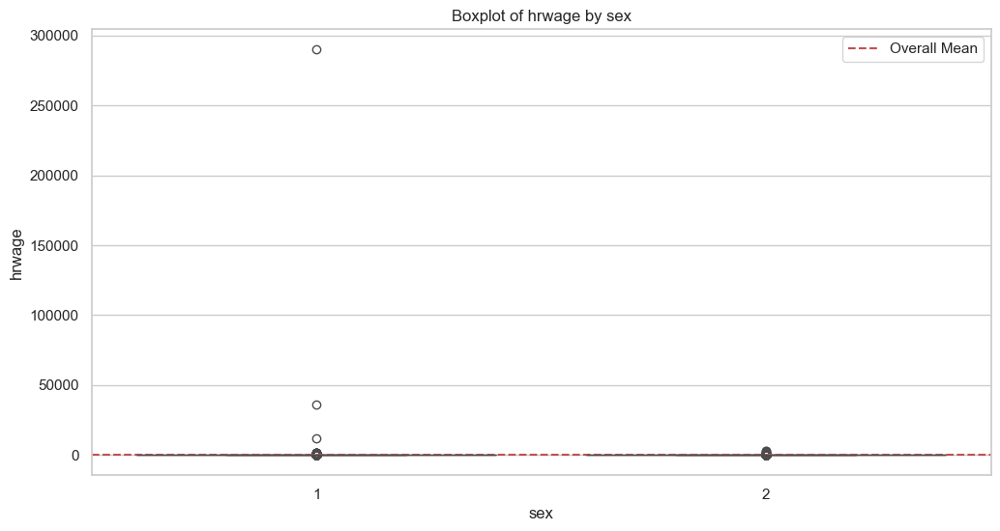


Checking Simpson's Paradox for 'sex' and 'hrwage':
Grouped Means:
    sex     hrwage
0    1  23.307539
1    2  16.696590
Overall Mean: 20.074407685883898
Is Simpson's Paradox Present?: True


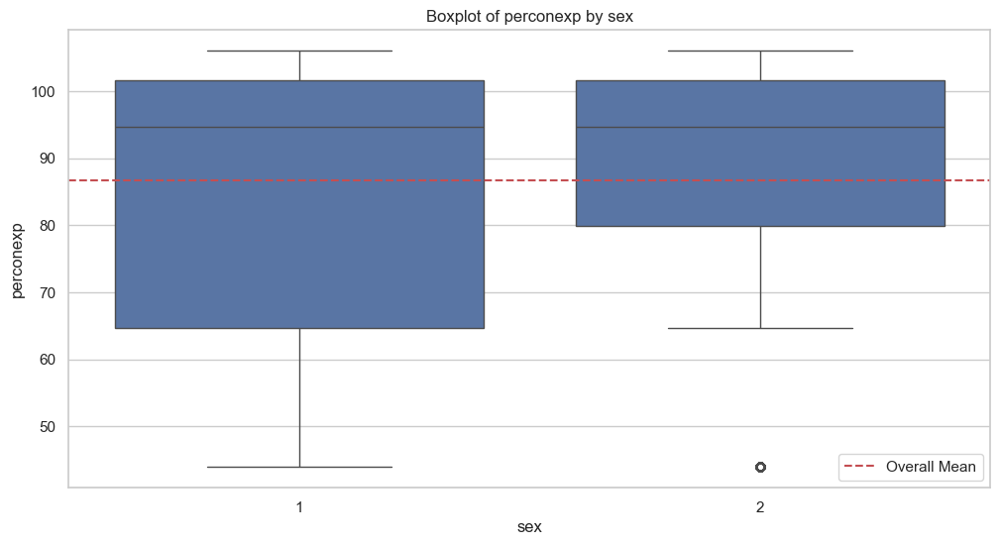


Checking Simpson's Paradox for 'sex' and 'perconexp':
Grouped Means:
    sex  perconexp
0    1  86.024426
1    2  87.318107
Overall Mean: 86.65710994792023
Is Simpson's Paradox Present?: True


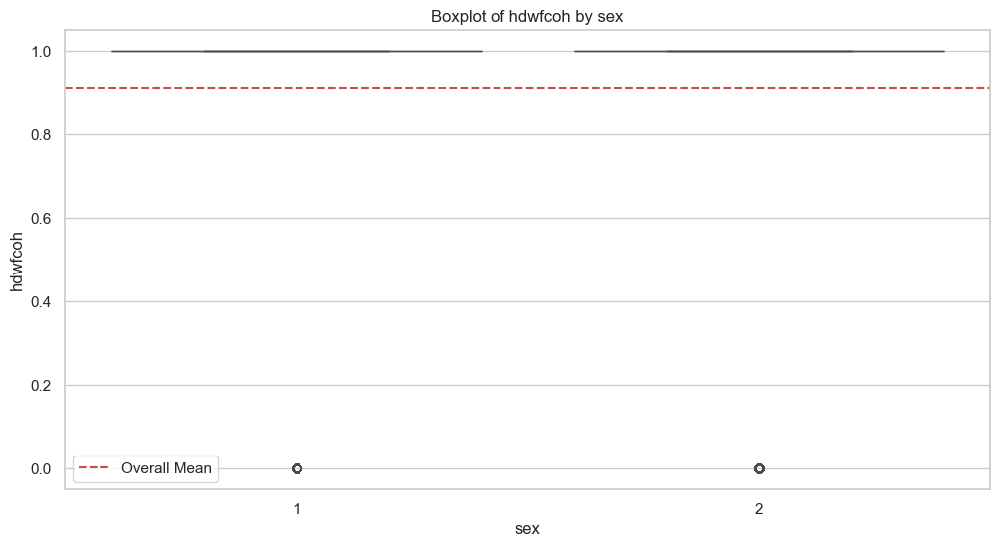


Checking Simpson's Paradox for 'sex' and 'hdwfcoh':
Grouped Means:
    sex   hdwfcoh
0    1  0.907811
1    2  0.916235
Overall Mean: 0.9119310342824446
Is Simpson's Paradox Present?: True


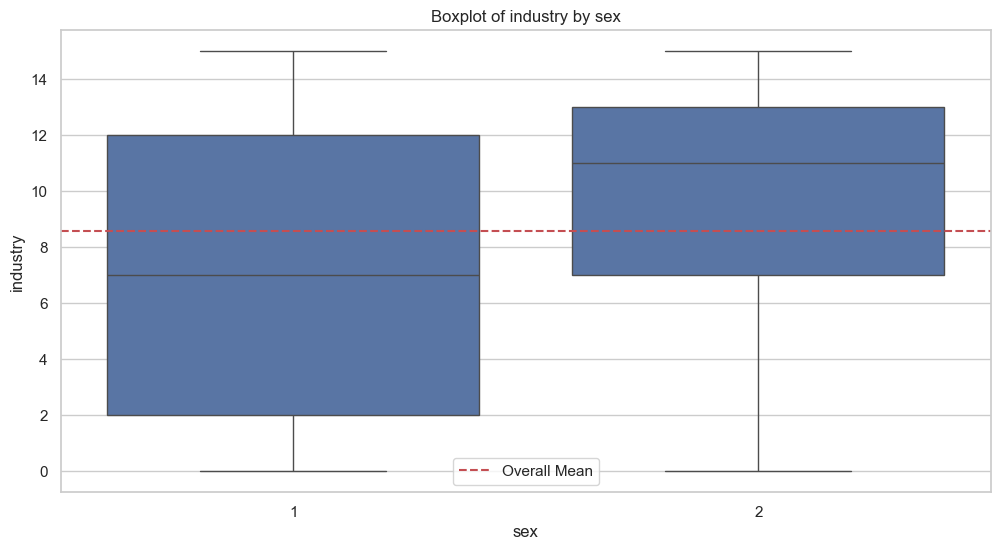


Checking Simpson's Paradox for 'sex' and 'industry':
Grouped Means:
    sex  industry
0    1  7.285144
1    2  9.951691
Overall Mean: 8.589238048488616
Is Simpson's Paradox Present?: True


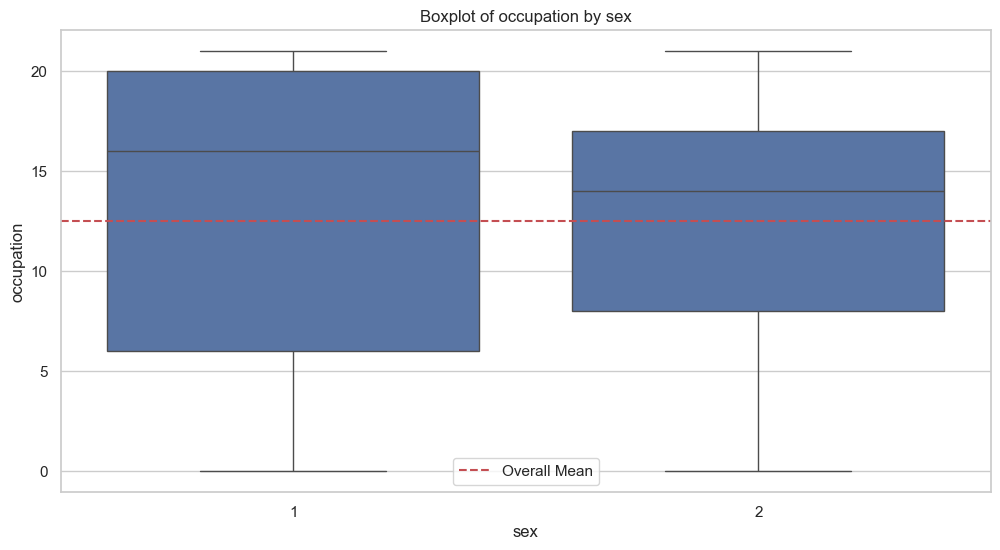


Checking Simpson's Paradox for 'sex' and 'occupation':
Grouped Means:
    sex  occupation
0    1   13.145346
1    2   11.898465
Overall Mean: 12.53555028217737
Is Simpson's Paradox Present?: True


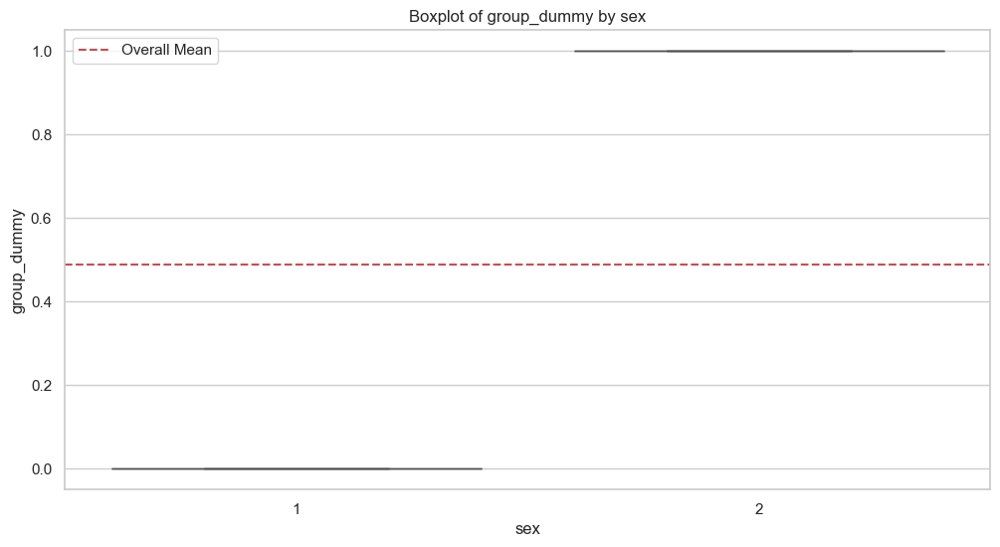


Checking Simpson's Paradox for 'sex' and 'group_dummy':
Grouped Means:
    sex  group_dummy
0    1          0.0
1    2          1.0
Overall Mean: 0.4890570948075298
Is Simpson's Paradox Present?: True


In [219]:
# Assuming processed is your DataFrame containing the relevant columns

# List of numeric columns you want to check against 'sex'
numeric_columns = processed.select_dtypes(include=['int64', 'float64']).columns.tolist()

# Create pairs with 'sex' and each numeric column
columns_to_check = [('sex', col) for col in numeric_columns if col != 'sex']

# Print the final list of columns to check
print("Columns to check for Simpson's Paradox:")
for pair in columns_to_check:
    print(pair)



# Iterate over the column pairs and check for Simpson's Paradox
for group_col, target_col in columns_to_check:
    results = check_simpsons_paradox(processed, group_col, target_col)
    
    print(f"\nChecking Simpson's Paradox for '{group_col}' and '{target_col}':")
    print("Grouped Means:\n", results['grouped_means'])
    print("Overall Mean:", results['overall_mean'])
    print("Is Simpson's Paradox Present?:", results['is_simpsons_paradox'])


In [220]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
import matplotlib.pyplot as plt
import seaborn as sns

def plot_simpsons_paradox(data, group_col, target_col):
    """
    Plots scatter plots showing Simpson's Paradox by displaying regression lines
    for both grouped and separated data.

    Parameters:
    data (pd.DataFrame): The input data containing the group and target columns.
    group_col (str): The column name to group by (e.g., education, occupation).
    target_col (str): The target column for comparison (e.g., incwage).
    """
    
    # Create a figure
    plt.figure(figsize=(14, 7))
    
    # Scatter plot for overall data
    plt.subplot(1, 2, 1)
    sns.scatterplot(x=data[group_col], y=data[target_col], alpha=0.5)
    plt.title(f'Scatter Plot of {target_col} vs {group_col} (Overall)')
    plt.xlabel(group_col)
    plt.ylabel(target_col)
    
    # Fit a regression line for overall data
    overall_model = sm.OLS(data[target_col], sm.add_constant(pd.factorize(data[group_col])[0])).fit()
    x_vals = np.unique(pd.factorize(data[group_col])[0])
    y_vals = overall_model.predict(sm.add_constant(x_vals))
    plt.plot(x_vals, y_vals, color='red', label='Overall Regression Line')
    plt.legend()
    
    # Scatter plot for grouped data
    plt.subplot(1, 2, 2)
    sns.scatterplot(x=data[group_col], y=data[target_col], hue=data[group_col], alpha=0.5)
    plt.title(f'Scatter Plot of {target_col} vs {group_col} (Grouped)')
    plt.xlabel(group_col)
    plt.ylabel(target_col)
    
    # Fit a regression line for each group
    unique_groups = data[group_col].unique()
    for group in unique_groups:
        group_data = data[data[group_col] == group]
        group_model = sm.OLS(group_data[target_col], sm.add_constant(pd.factorize(group_data[group_col])[0])).fit()
        group_x_vals = np.unique(pd.factorize(group_data[group_col])[0])
        group_y_vals = group_model.predict(sm.add_constant(group_x_vals))
        plt.plot(group_x_vals, group_y_vals, label=f'{group} Regression Line')
    
    plt.legend()
    
    # Show plots
    plt.tight_layout()
    plt.show()

# Example usage:
# Assuming `processed` is your DataFrame containing relevant columns
# plot_simpsons_paradox(processed, 'educ99', 'incwage')


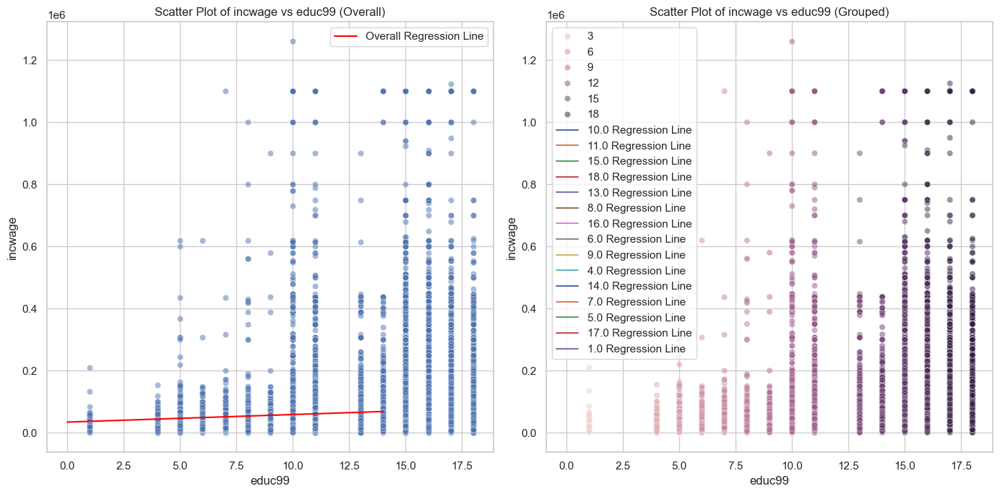

In [221]:
# Load your dataset
# Example: processed = pd.read_csv('your_dataset.csv')

# Call the function to analyze and visualize Simpson's Paradox
plot_simpsons_paradox(processed, 'educ99', 'incwage')


In [222]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
import matplotlib.pyplot as plt
import seaborn as sns

def plot_simpsons_paradox(data, group_col, target_col):
    """
    Plots scatter plots showing Simpson's Paradox by displaying regression lines
    for both grouped and separated data.

    Parameters:
    data (pd.DataFrame): The input data containing the group and target columns.
    group_col (str): The column name to group by (e.g., sex).
    target_col (str): The target column for comparison (e.g., incwage).
    """
    
    # Create a figure
    plt.figure(figsize=(14, 7))
    
    # Scatter plot for overall data
    plt.subplot(1, 2, 1)
    sns.scatterplot(data=data, x=group_col, y=target_col, alpha=0.5)
    plt.title(f'Scatter Plot of {target_col} vs {group_col} (Overall)')
    plt.xlabel(group_col)
    plt.ylabel(target_col)
    
    # Fit a regression line for overall data
    overall_model = sm.OLS(data[target_col], sm.add_constant(pd.factorize(data[group_col])[0])).fit()
    x_vals = np.unique(pd.factorize(data[group_col])[0])
    y_vals = overall_model.predict(sm.add_constant(x_vals))
    plt.plot(x_vals, y_vals, color='red', label='Overall Regression Line')
    plt.legend()
    
    # Scatter plot for grouped data (by sex)
    plt.subplot(1, 2, 2)
    sns.scatterplot(data=data, x=group_col, y=target_col, hue=group_col, alpha=0.5)
    plt.title(f'Scatter Plot of {target_col} vs {group_col} (Grouped by {group_col})')
    plt.xlabel(group_col)
    plt.ylabel(target_col)
    
    # Fit a regression line for each group
    unique_groups = data[group_col].unique()
    for group in unique_groups:
        group_data = data[data[group_col] == group]
        group_model = sm.OLS(group_data[target_col], sm.add_constant(pd.factorize(group_data[group_col])[0])).fit()
        group_x_vals = np.unique(pd.factorize(group_data[group_col])[0])
        group_y_vals = group_model.predict(sm.add_constant(group_x_vals))
        plt.plot(group_x_vals, group_y_vals, label=f'{group} Regression Line')

    plt.legend()
    
    # Show plots
    plt.tight_layout()
    plt.show()

# Example usage:
# Assuming `processed` is your DataFrame containing relevant columns
# plot_simpsons_paradox(processed, 'sex', 'incwage')  # Example for sex vs income


Simpson's Paradox detected for grouping by: sex


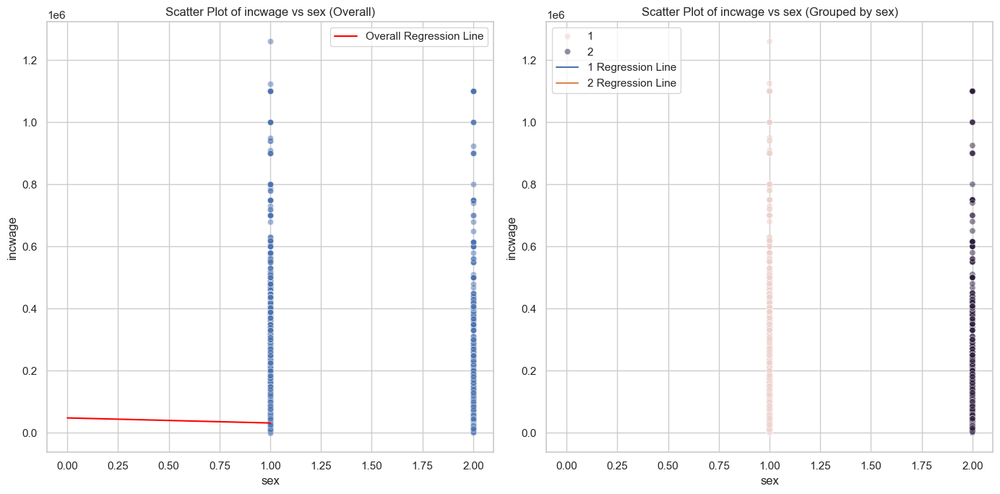

In [223]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
import matplotlib.pyplot as plt
import seaborn as sns

def check_simpsons_paradox(data, group_col, target_col):
    """
    Check for Simpson's Paradox for a specific grouping column.
    
    Parameters:
    data (pd.DataFrame): The input data containing the group and target columns.
    group_col (str): The column name to group by (e.g., education, occupation).
    target_col (str): The target column for comparison (e.g., incwage).
    
    Returns:
    bool: True if Simpson's Paradox is present, False otherwise.
    """
    # Calculate the mean for each group
    grouped_means = data.groupby(group_col)[target_col].mean()
    overall_mean = data[target_col].mean()
    
    # Check if the subgroup means diverge from the overall mean
    if (grouped_means.iloc[0] > overall_mean and all(grouped_means.diff().iloc[1:] < 0)) or \
       (grouped_means.iloc[0] < overall_mean and all(grouped_means.diff().iloc[1:] > 0)):
        return True
    return False

def plot_simpsons_paradox(data, group_col, target_col):
    """
    Plots scatter plots showing Simpson's Paradox by displaying regression lines
    for both grouped and separated data.

    Parameters:
    data (pd.DataFrame): The input data containing the group and target columns.
    group_col (str): The column name to group by (e.g., sex).
    target_col (str): The target column for comparison (e.g., incwage).
    """
    
    # Create a figure
    plt.figure(figsize=(14, 7))
    
    # Scatter plot for overall data
    plt.subplot(1, 2, 1)
    sns.scatterplot(data=data, x=group_col, y=target_col, alpha=0.5)
    plt.title(f'Scatter Plot of {target_col} vs {group_col} (Overall)')
    plt.xlabel(group_col)
    plt.ylabel(target_col)
    
    # Fit a regression line for overall data
    overall_model = sm.OLS(data[target_col], sm.add_constant(pd.factorize(data[group_col])[0])).fit()
    x_vals = np.unique(pd.factorize(data[group_col])[0])
    y_vals = overall_model.predict(sm.add_constant(x_vals))
    plt.plot(x_vals, y_vals, color='red', label='Overall Regression Line')
    plt.legend()
    
    # Scatter plot for grouped data (by sex)
    plt.subplot(1, 2, 2)
    sns.scatterplot(data=data, x=group_col, y=target_col, hue=group_col, alpha=0.5)
    plt.title(f'Scatter Plot of {target_col} vs {group_col} (Grouped by {group_col})')
    plt.xlabel(group_col)
    plt.ylabel(target_col)
    
    # Fit a regression line for each group
    unique_groups = data[group_col].unique()
    for group in unique_groups:
        group_data = data[data[group_col] == group]
        group_model = sm.OLS(group_data[target_col], sm.add_constant(pd.factorize(group_data[group_col])[0])).fit()
        group_x_vals = np.unique(pd.factorize(group_data[group_col])[0])
        group_y_vals = group_model.predict(sm.add_constant(group_x_vals))
        plt.plot(group_x_vals, group_y_vals, label=f'{group} Regression Line')

    plt.legend()
    
    # Show plots
    plt.tight_layout()
    plt.show()

def find_and_plot_simpsons_cases(data, group_cols, target_col):
    """
    Find and plot all cases of Simpson's Paradox in the dataset.

    Parameters:
    data (pd.DataFrame): The input data containing the group and target columns.
    group_cols (list): A list of column names to check for Simpson's Paradox.
    target_col (str): The target column for comparison.
    """
    for group_col in group_cols:
        if check_simpsons_paradox(data, group_col, target_col):
            print(f"Simpson's Paradox detected for grouping by: {group_col}")
            plot_simpsons_paradox(data, group_col, target_col)

# Example usage:
# Assuming `processed` is your DataFrame containing relevant columns
# You can adjust the `group_cols` list to include the columns you want to check for Simpson's Paradox.
group_cols = ['sex', 'educ99', 'marst']  # Add other categorical columns as needed
target_col = 'incwage'

find_and_plot_simpsons_cases(processed, group_cols, target_col)


In [118]:
import pandas as pd
import matplotlib.pyplot as plt

# Load your dataset
# df = pd.read_csv('path_to_your_dataset.csv')

# Example: Assuming 'age' is a column in your DataFrame
# Plotting age distribution
plt.hist(new_data['age'], bins=50, color='blue', alpha=0.7)
plt.title('Age Distribution')
plt.xlabel('Age')
plt.ylabel('Frequency')
plt.grid()
plt.show()


NameError: name 'new_data' is not defined

Unique values in 'sex' column: [1 2]
1 - Male, 2 - Female


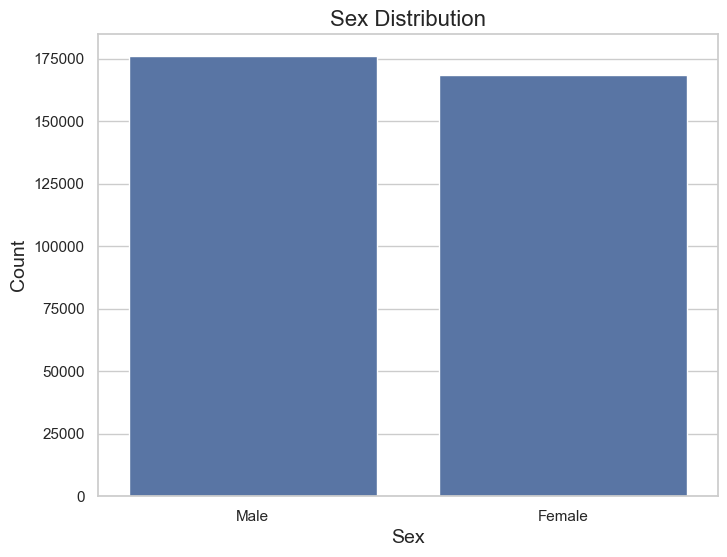

<Figure size 640x480 with 0 Axes>

In [60]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Step 2: Check the unique values in the 'sex' column
print("Unique values in 'sex' column:", new_data['sex'].unique())
print("1 - Male, 2 - Female")

# Step 3: Count the occurrences of each category in the 'sex' column
sex_distribution = new_data['sex'].value_counts()

# Step 4: Set the style for the plot
sns.set(style="whitegrid")

# Create a bar plot
plt.figure(figsize=(8, 6))
sns.countplot(data=new_data, x='sex', order=sex_distribution.index)

# Set custom x-axis labels
plt.xticks(ticks=[0, 1], labels=['Male', 'Female'])

# Add titles and labels
plt.title('Sex Distribution', fontsize=16)
plt.xlabel('Sex', fontsize=14)
plt.ylabel('Count', fontsize=14)

# Step 5: Show the plot
plt.show()

# Optional: Save the plot as an image file
plt.savefig('sex_distribution.png', bbox_inches='tight')


/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_42540/1114753855.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=new_data, x='sex', y='uhrswork', palette="pastel")


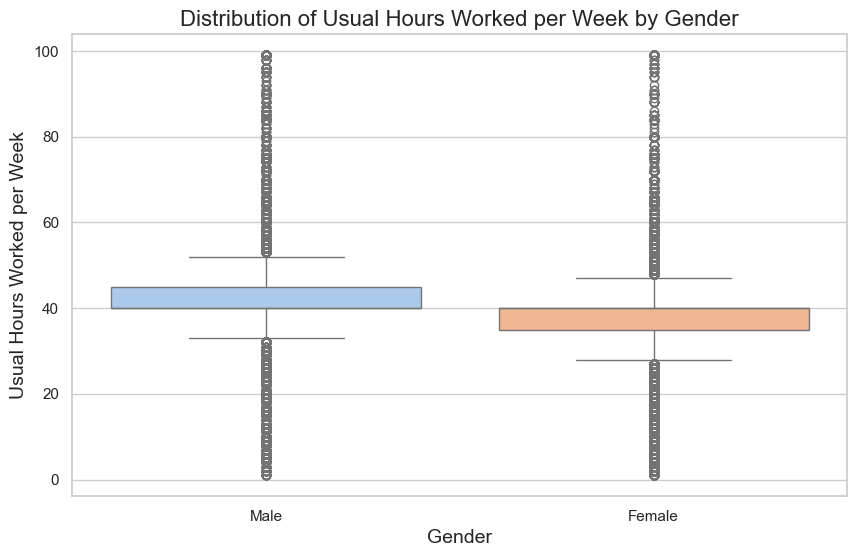

<Figure size 640x480 with 0 Axes>

In [61]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'sex' represents gender and 'uhrswork' represents usual hours worked per week
# 1 = Male, 2 = Female

# Map 'sex' column to 'Male' and 'Female' labels
new_data['sex'] = new_data['sex'].map({1: 'Male', 2: 'Female'})

# Set plot style
sns.set(style="whitegrid")

# Set the figure size
plt.figure(figsize=(10, 6))

# Create a box plot for usual hours worked per week by gender
sns.boxplot(data=new_data, x='sex', y='uhrswork', palette="pastel")

# Add title and labels
plt.title('Distribution of Usual Hours Worked per Week by Gender', fontsize=16)
plt.xlabel('Gender', fontsize=14)
plt.ylabel('Usual Hours Worked per Week', fontsize=14)

# Show the plot
plt.show()

# Optional: Save the plot as an image file
plt.savefig('hours_worked_by_gender.png', bbox_inches='tight')


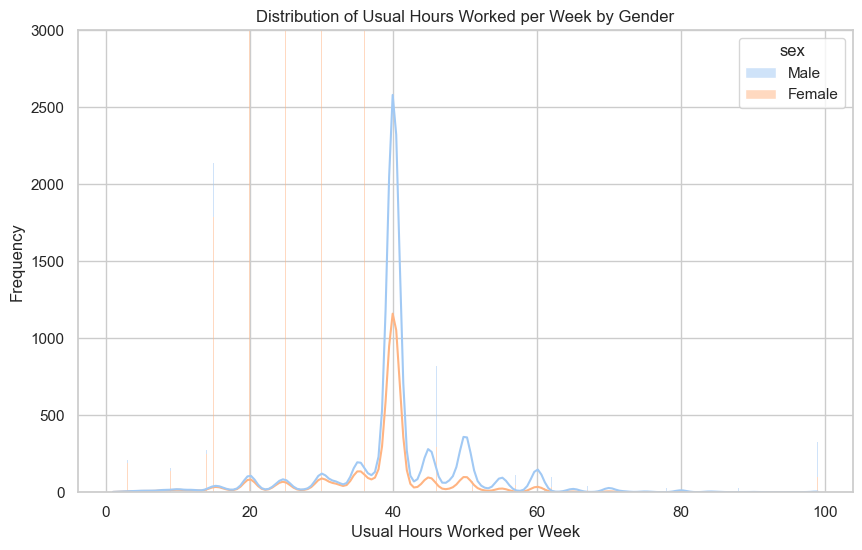

In [62]:
plt.figure(figsize=(10, 6))
sns.histplot(data=new_data, x='uhrswork', hue='sex', multiple='stack', kde=True, palette='pastel')
plt.title('Distribution of Usual Hours Worked per Week by Gender')
plt.xlabel('Usual Hours Worked per Week')
plt.ylabel('Frequency')
plt.ylim(0, 3000)
plt.show()



In [63]:
for i in new_data.dtypes:
    print(i)

int64
float64
int64
int64
float64
float64
int64
int64
int64
object
int64
int64
float64
float64
int64
int64
float64
int64
float64
float64
float64
float64
float64
int64
int64
float64
float64
float64
int64
int64
int64
int64


In [64]:
def remove_outliers_iqr(df):
    # Create a copy of the DataFrame to avoid modifying the original data
    df_cleaned = df.copy()

    for column in df_cleaned.select_dtypes(include=['float64', 'int64']).columns:
        # Calculate Q1 (25th percentile) and Q3 (75th percentile)
        Q1 = df_cleaned[column].quantile(0.25)
        Q3 = df_cleaned[column].quantile(0.75)
        IQR = Q3 - Q1  # Interquartile Range

        # Determine bounds for outliers
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        # Remove outliers
        df_cleaned = df_cleaned[(df_cleaned[column] >= lower_bound) & (df_cleaned[column] <= upper_bound)]

    return df_cleaned

In [65]:
# new_data=remove_outliers_iqr(new_data)

# removing outliers is leading to deletion of so much data

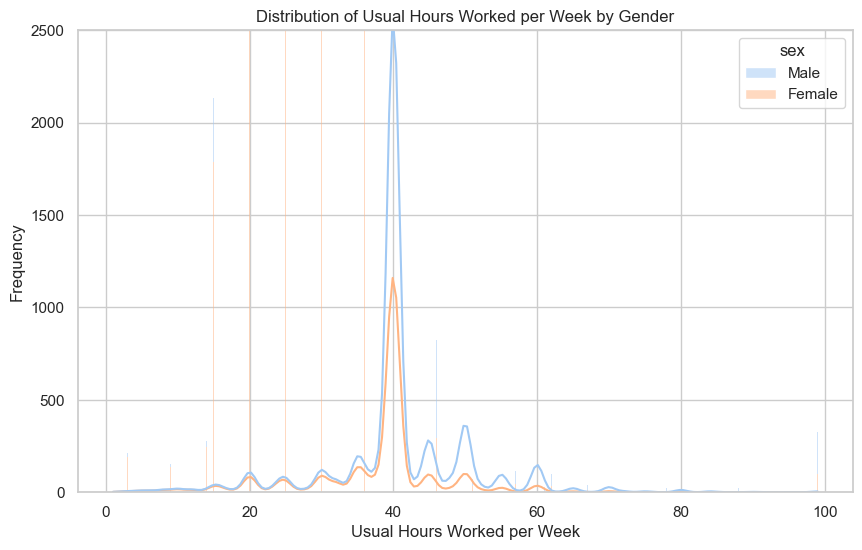

In [66]:
plt.figure(figsize=(10, 6))
sns.histplot(data=new_data, x='uhrswork', hue='sex', multiple='stack', kde=True, palette='pastel')
plt.title('Distribution of Usual Hours Worked per Week by Gender')
plt.xlabel('Usual Hours Worked per Week')
plt.ylabel('Frequency')
plt.ylim(0, 2500)
plt.show()



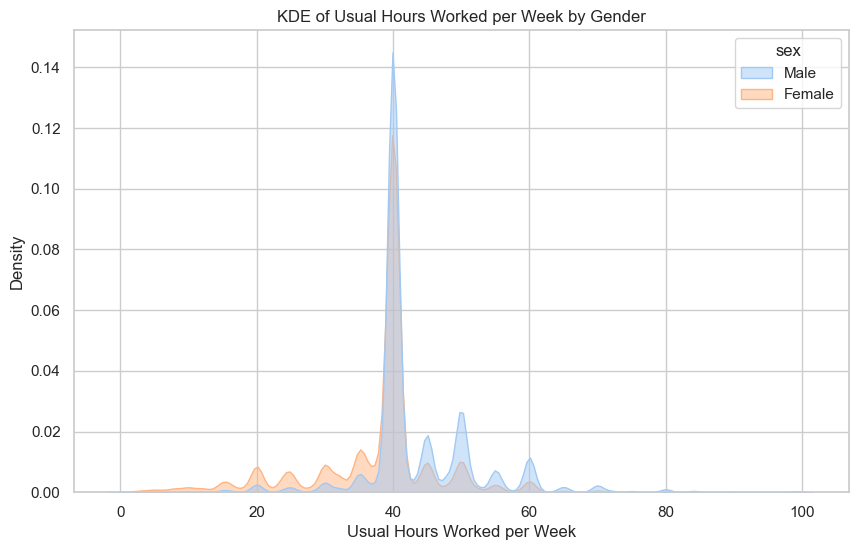

In [67]:
plt.figure(figsize=(10, 6))
sns.kdeplot(data=new_data, x='uhrswork', hue='sex', fill=True, palette='pastel', alpha=0.5)
plt.title('KDE of Usual Hours Worked per Week by Gender')
plt.xlabel('Usual Hours Worked per Week')
plt.ylabel('Density')
plt.show()


/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_42540/2478894960.py:2: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.barplot(data=new_data, x='sex', y='uhrswork', palette='pastel', ci="sd")
/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_42540/2478894960.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=new_data, x='sex', y='uhrswork', palette='pastel', ci="sd")


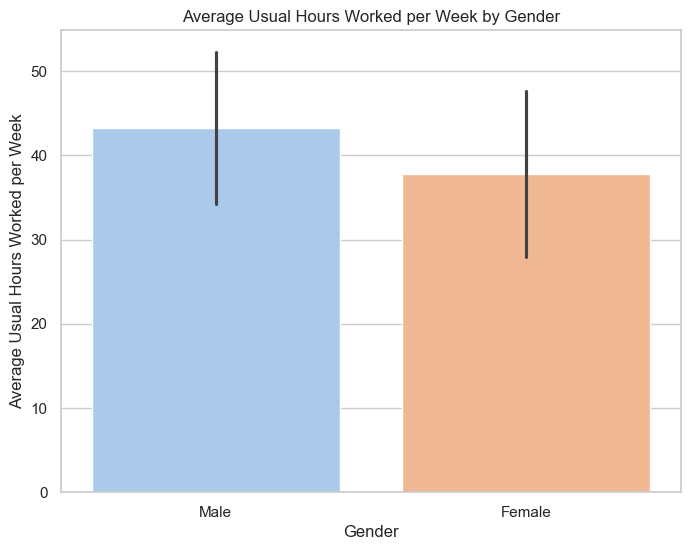

In [68]:
plt.figure(figsize=(8, 6))
sns.barplot(data=new_data, x='sex', y='uhrswork', palette='pastel', ci="sd")
plt.title('Average Usual Hours Worked per Week by Gender')
plt.xlabel('Gender')
plt.ylabel('Average Usual Hours Worked per Week')
plt.show()


Descriptive Statistics:
                 age       incwage      education
count  344287.000000  3.442870e+05  344287.000000
mean       41.734364  3.976170e+04       4.140026
std        10.415874  4.529758e+04       1.272586
min        25.000000  1.500000e+01       0.000000
25%        33.000000  1.670000e+04       3.000000
50%        41.000000  3.000000e+04       5.000000
75%        50.000000  5.000000e+04       5.000000
max        64.000000  1.259999e+06       5.000000


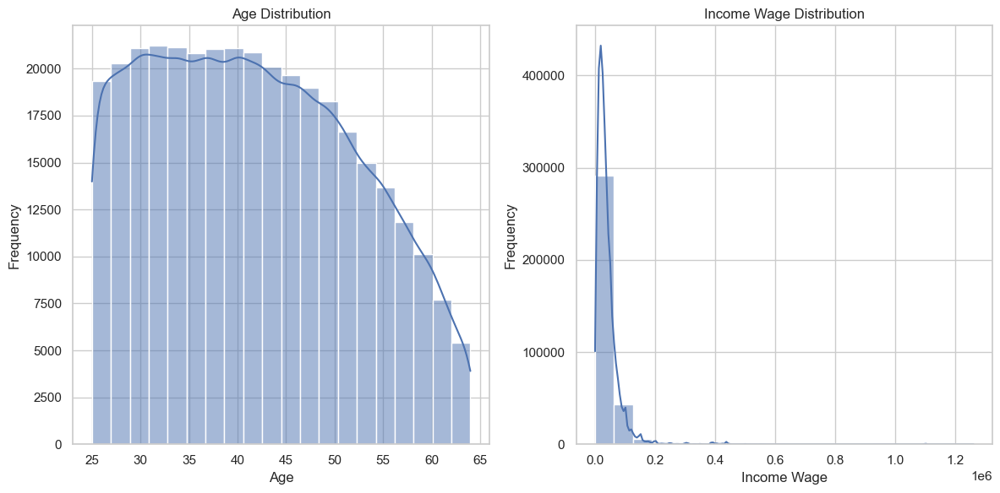

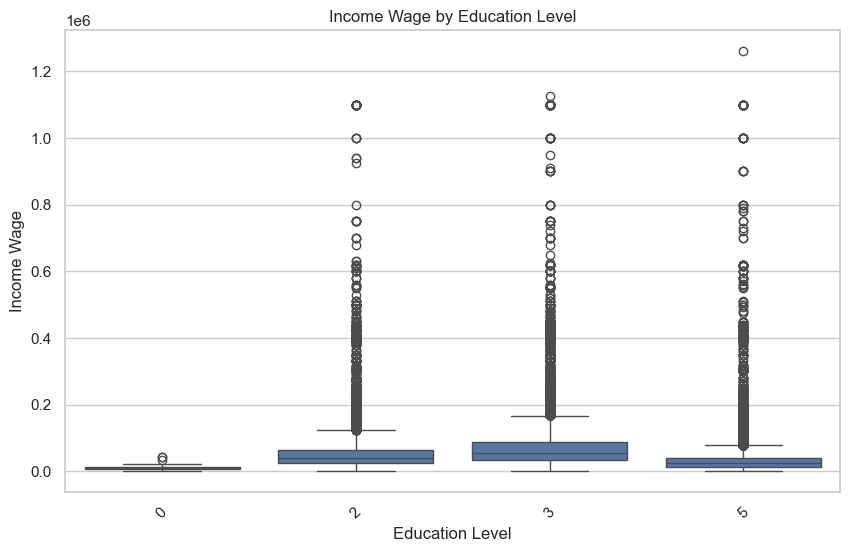

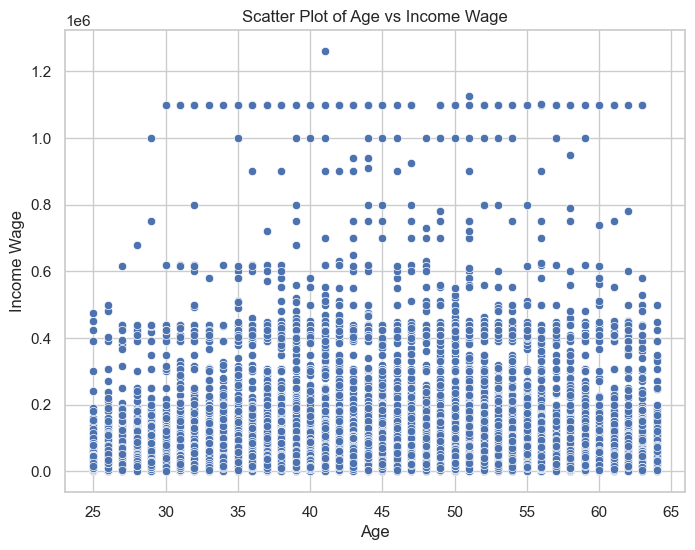

Correlation Matrix:
               age   incwage
age      1.000000  0.122137
incwage  0.122137  1.000000


In [69]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Step 1: Descriptive Statistics
print("Descriptive Statistics:")
print(new_data[['age', 'incwage', 'education']].describe())

# Step 2: Visualizations

# 2.1 Histogram for age
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sns.histplot(new_data['age'], bins=20, kde=True)
plt.title('Age Distribution')
plt.xlabel('Age')
plt.ylabel('Frequency')

# 2.2 Histogram for incwage
plt.subplot(1, 2, 2)
sns.histplot(new_data['incwage'], bins=20, kde=True)
plt.title('Income Wage Distribution')
plt.xlabel('Income Wage')
plt.ylabel('Frequency')
plt.tight_layout()
plt.show()

# 2.3 Box plot for incwage by education
plt.figure(figsize=(10, 6))
sns.boxplot(x='education', y='incwage', data=new_data)
plt.title('Income Wage by Education Level')
plt.xlabel('Education Level')
plt.ylabel('Income Wage')
plt.xticks(rotation=45)
plt.show()

# 2.4 Scatter plot for age vs. incwage
plt.figure(figsize=(8, 6))
sns.scatterplot(x='age', y='incwage', data=new_data)
plt.title('Scatter Plot of Age vs Income Wage')
plt.xlabel('Age')
plt.ylabel('Income Wage')
plt.show()

# Step 3: Correlation Analysis
correlation = new_data[['age', 'incwage']].corr()
print("Correlation Matrix:\n", correlation)



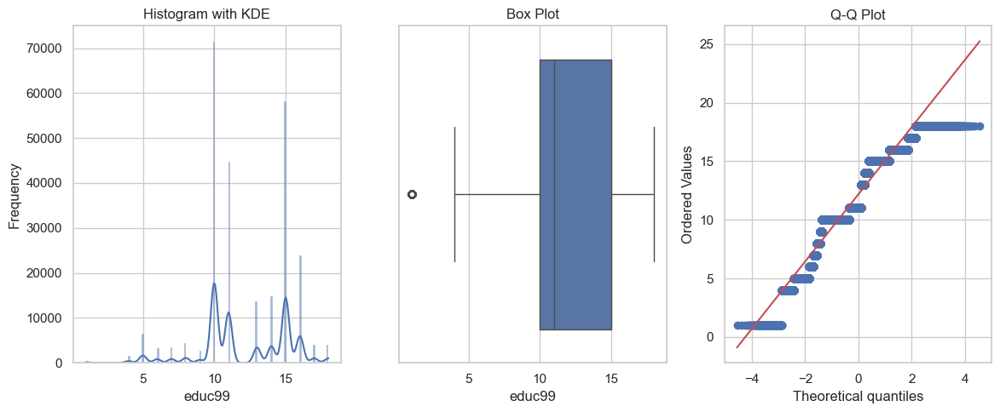

In [70]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats as stats

# Choose a numerical column to check for normality
column_to_check = 'incwage'  # Change this to your column of interest
column_to_check = 'uhrswork'
column_to_check = 'educ99'

# Step 1: Histogram
plt.figure(figsize=(12, 5))

plt.subplot(1, 3, 1)
sns.histplot(new_data[column_to_check], kde=True)
plt.title('Histogram with KDE')
plt.xlabel(column_to_check)
plt.ylabel('Frequency')

# Step 2: Box Plot
plt.subplot(1, 3, 2)
sns.boxplot(x=new_data[column_to_check])
plt.title('Box Plot')
plt.xlabel(column_to_check)

# Step 3: Q-Q Plot
plt.subplot(1, 3, 3)
stats.probplot(new_data[column_to_check].dropna(), dist="norm", plot=plt)
plt.title('Q-Q Plot')

plt.tight_layout()
plt.show()


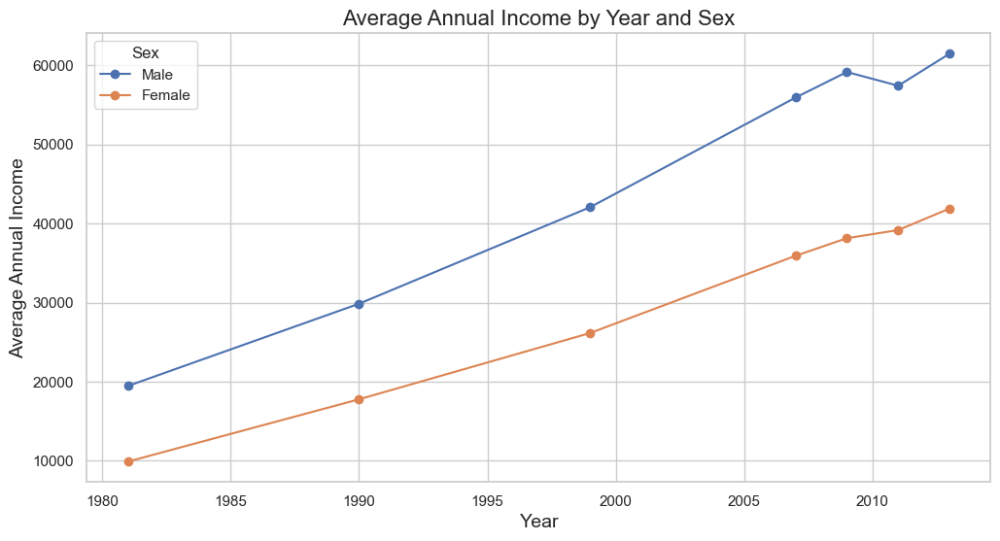

In [71]:
import matplotlib.pyplot as plt

# Group by 'year' and 'sex' to calculate the average income
average_income_by_year_sex = new_data.groupby(['year', 'sex'])['incwage'].mean().unstack()

# Plotting
plt.figure(figsize=(12, 6))

# Plotting 'Male' and 'Female' columns by their labels
plt.plot(average_income_by_year_sex.index, average_income_by_year_sex['Male'], marker='o', linestyle='-', label="Male")
plt.plot(average_income_by_year_sex.index, average_income_by_year_sex['Female'], marker='o', linestyle='-', label="Female")

# Add titles and labels
plt.title("Average Annual Income by Year and Sex", fontsize=16)
plt.xlabel("Year", fontsize=14)
plt.ylabel("Average Annual Income", fontsize=14)
plt.legend(title="Sex")

# Show plot
plt.show()


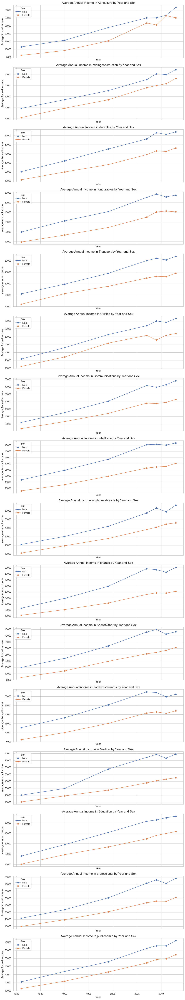

In [72]:
import matplotlib.pyplot as plt

# Group by 'year', 'industry', and 'sex' to calculate the average income
average_income_by_year_industry_sex = new_data.groupby(['year', 'industry', 'sex'])['incwage'].mean().unstack('sex')

# Get unique industries
industries = average_income_by_year_industry_sex.index.get_level_values('industry').unique()

# Set up the subplots: one for each industry
num_industries = len(industries)
fig, axes = plt.subplots(nrows=num_industries, figsize=(12, num_industries * 4), sharex=True)

# Loop over each industry to create individual plots
for i, industry in enumerate(industries):
    ax = axes[i]
    industry_data = average_income_by_year_industry_sex.xs(industry, level='industry')
    
    # Plot for both 'Male' and 'Female' in this industry
    ax.plot(industry_data.index, industry_data['Male'], marker='o', linestyle='-', label="Male")
    ax.plot(industry_data.index, industry_data['Female'], marker='o', linestyle='-', label="Female")
    
    # Add titles and labels
    ax.set_title(f"Average Annual Income in {industry_columns[i]} by Year and Sex", fontsize=14)
    ax.set_xlabel("Year", fontsize=12)
    ax.set_ylabel("Average Annual Income", fontsize=12)
    ax.legend(title="Sex")

# Adjust layout and show plot
plt.tight_layout()
plt.show()


In [73]:
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats

# Group by 'industry' and 'sex' to get income data
income_by_sex = new_data.groupby(['industry', 'sex'])['incwage'].apply(list).reset_index()

# # Set up the plot size
# plt.figure(figsize=(14, 10))

# Loop through each industry and sex to check for normality
for (industry, sex), group in income_by_sex.groupby(['industry', 'sex']):
    # Convert the group of incomes to a NumPy array
    incomes = group['incwage'].values
    
    # Check if the group has enough data points
    if len(incomes) < 5:  # Set your threshold (e.g., at least 5 points)
        print(f"Not enough data to perform normality checks for {industry} ({sex}). Skipping...")
        # continue
    
    # # Create subplots for histogram and Q-Q plot
    # fig, axes = plt.subplots(1, 2, figsize=(14, 6))
    
    # # Histogram
    # sns.histplot(incomes, bins=30, kde=True, ax=axes[0])
    # axes[0].set_title(f'Income Distribution in {industry} ({sex})')
    # axes[0].set_xlabel('Income')
    # axes[0].set_ylabel('Frequency')

    # # Q-Q Plot
    # stats.probplot(incomes, dist="norm", plot=axes[1])
    # axes[1].set_title(f'Q-Q Plot for Income in {industry} ({sex})')

    # plt.tight_layout()
    # plt.show()

    # Perform Shapiro-Wilk test for normality

    shapiro_stat, shapiro_p_value = stats.shapiro(incomes)
    print(f'Shapiro-Wilk test for {industry} ({sex}): Statistic={shapiro_stat}, p-value={shapiro_p_value}')
    print("Hi")
    if shapiro_p_value > 0.05:
        print(f'The income data in {industry} for {sex} is normally distributed (fail to reject H0).')
    else:
        print(f'The income data in {industry} for {sex} is not normally distributed (reject H0).')


Not enough data to perform normality checks for 0 (Female). Skipping...
Shapiro-Wilk test for 0 (Female): Statistic=nan, p-value=nan
Hi
The income data in 0 for Female is not normally distributed (reject H0).
Not enough data to perform normality checks for 0 (Male). Skipping...
Shapiro-Wilk test for 0 (Male): Statistic=nan, p-value=nan
Hi
The income data in 0 for Male is not normally distributed (reject H0).
Not enough data to perform normality checks for 1 (Female). Skipping...
Shapiro-Wilk test for 1 (Female): Statistic=nan, p-value=nan
Hi
The income data in 1 for Female is not normally distributed (reject H0).
Not enough data to perform normality checks for 1 (Male). Skipping...
Shapiro-Wilk test for 1 (Male): Statistic=nan, p-value=nan
Hi
The income data in 1 for Male is not normally distributed (reject H0).
Not enough data to perform normality checks for 2 (Female). Skipping...
Shapiro-Wilk test for 2 (Female): Statistic=nan, p-value=nan
Hi
The income data in 2 for Female is not n

/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_42540/1636273031.py:39: SmallSampleWarning: One or more sample arguments is too small; all returned values will be NaN. See documentation for sample size requirements.
  shapiro_stat, shapiro_p_value = stats.shapiro(incomes)


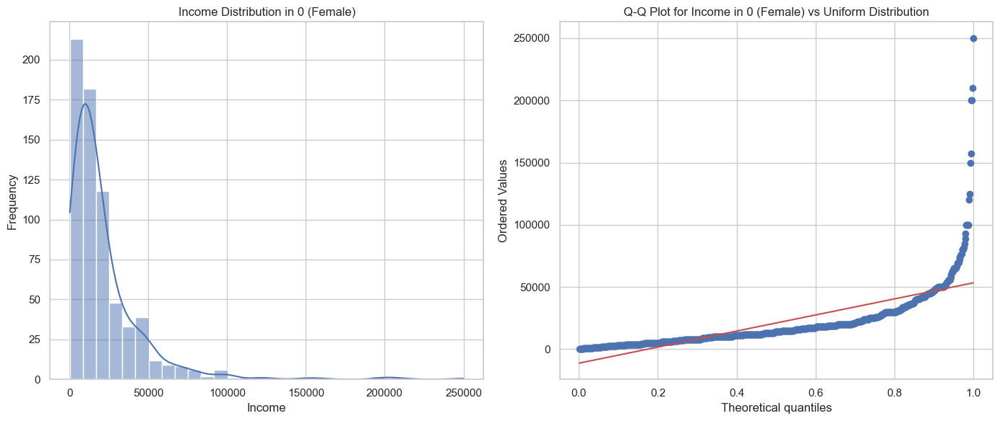

Kolmogorov-Smirnov test for 0 (Female): Statistic=0.726079108901156, p-value=0.0
The income data in 0 for Female is not uniformly distributed (reject H0).


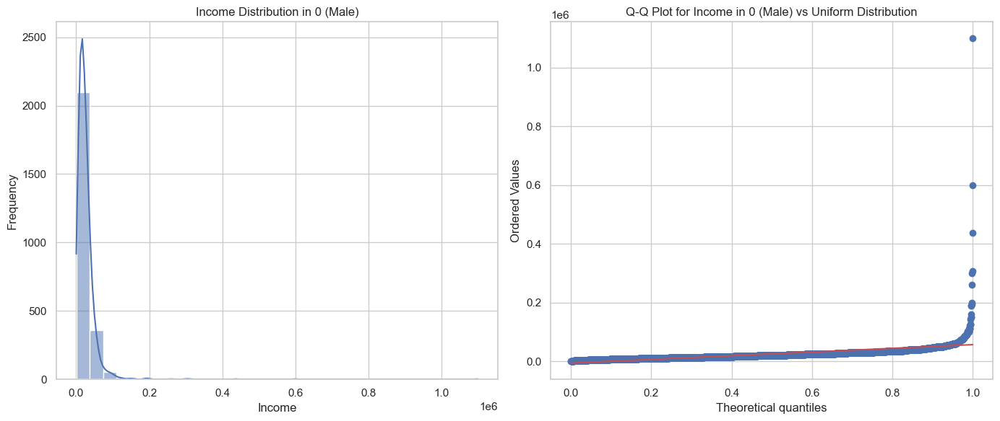

Kolmogorov-Smirnov test for 0 (Male): Statistic=0.9070775126101267, p-value=0.0
The income data in 0 for Male is not uniformly distributed (reject H0).


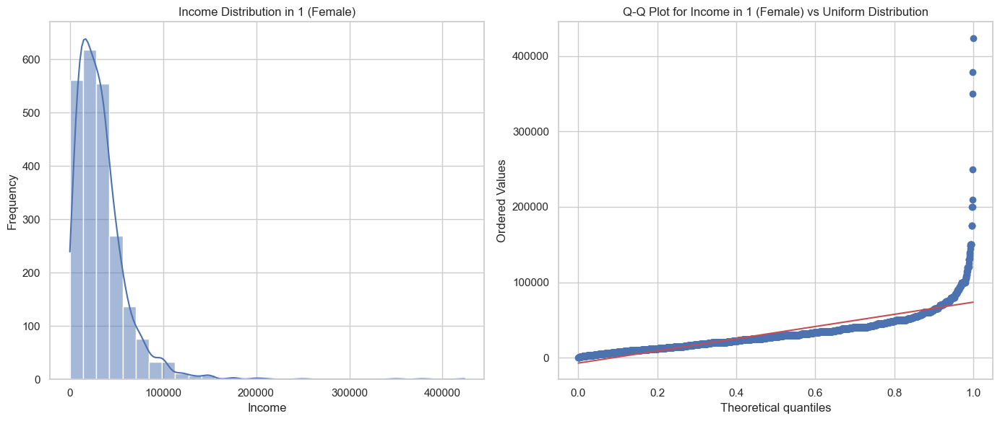

Kolmogorov-Smirnov test for 1 (Female): Statistic=0.7640984057182559, p-value=0.0
The income data in 1 for Female is not uniformly distributed (reject H0).


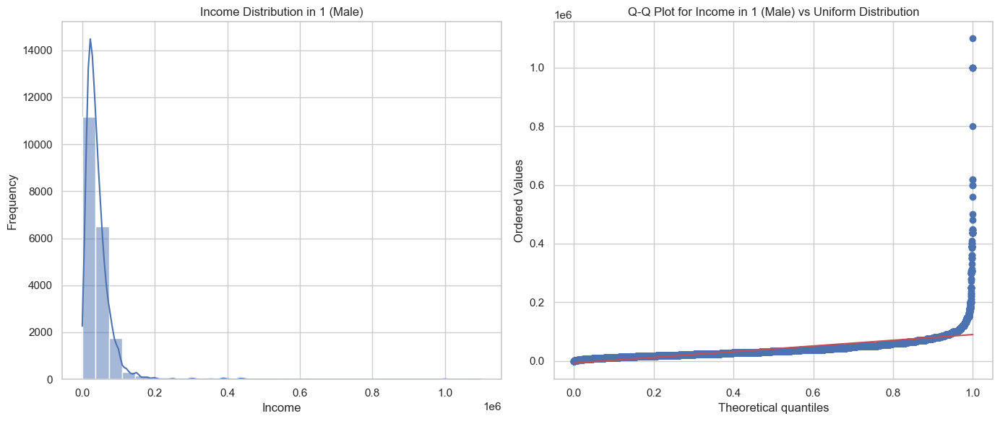

Kolmogorov-Smirnov test for 1 (Male): Statistic=0.8709500879801434, p-value=0.0
The income data in 1 for Male is not uniformly distributed (reject H0).


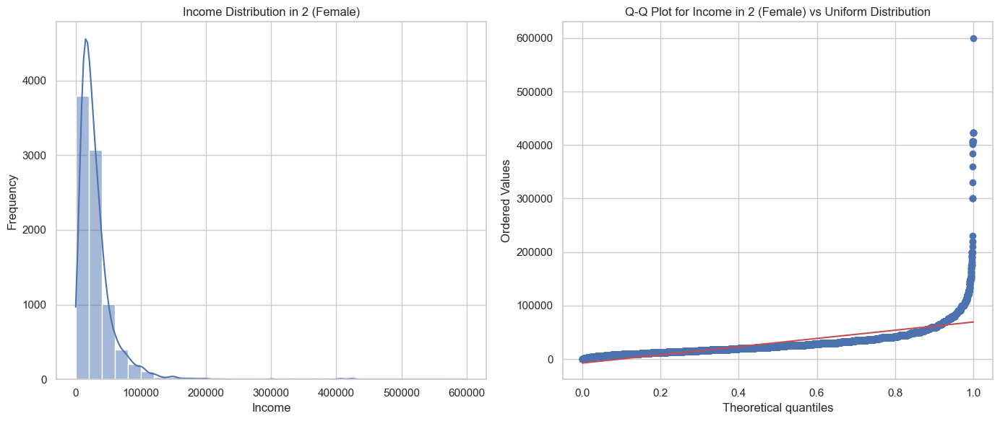

Kolmogorov-Smirnov test for 2 (Female): Statistic=0.8187918390491806, p-value=0.0
The income data in 2 for Female is not uniformly distributed (reject H0).


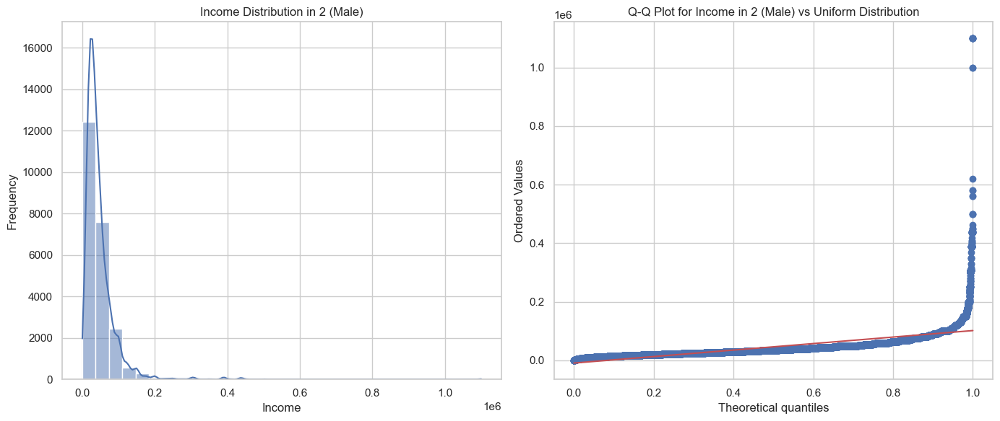

Kolmogorov-Smirnov test for 2 (Male): Statistic=0.8519471385750006, p-value=0.0
The income data in 2 for Male is not uniformly distributed (reject H0).


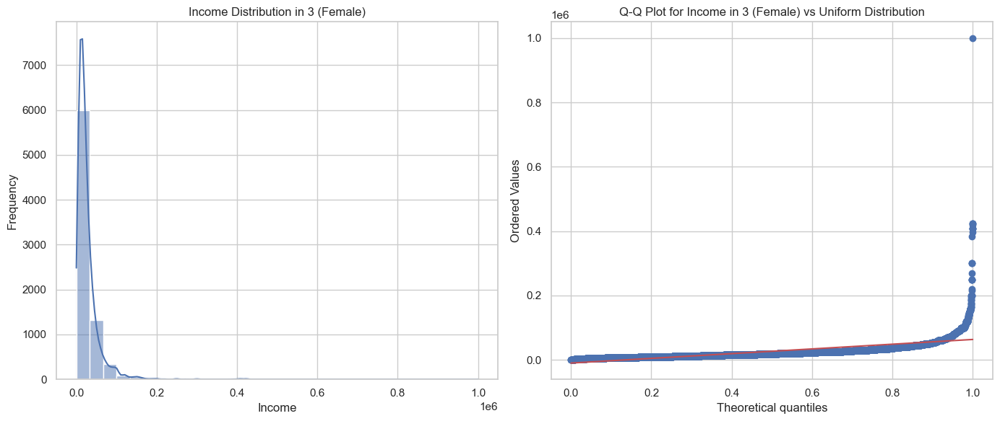

Kolmogorov-Smirnov test for 3 (Female): Statistic=0.8789027565580102, p-value=0.0
The income data in 3 for Female is not uniformly distributed (reject H0).


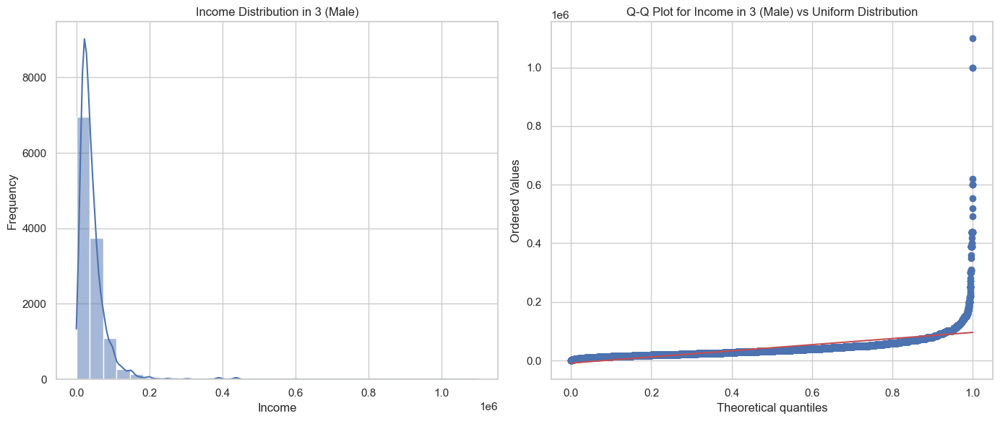

Kolmogorov-Smirnov test for 3 (Male): Statistic=0.8575988229027799, p-value=0.0
The income data in 3 for Male is not uniformly distributed (reject H0).


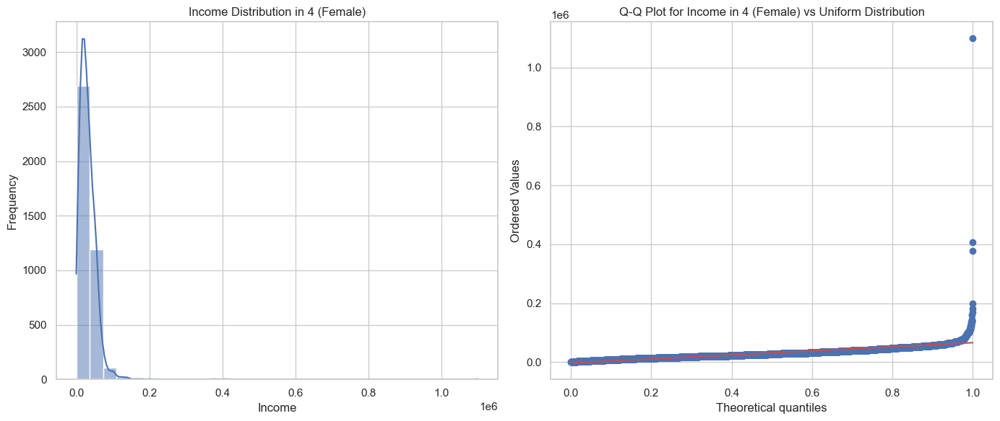

Kolmogorov-Smirnov test for 4 (Female): Statistic=0.9063609219263512, p-value=0.0
The income data in 4 for Female is not uniformly distributed (reject H0).


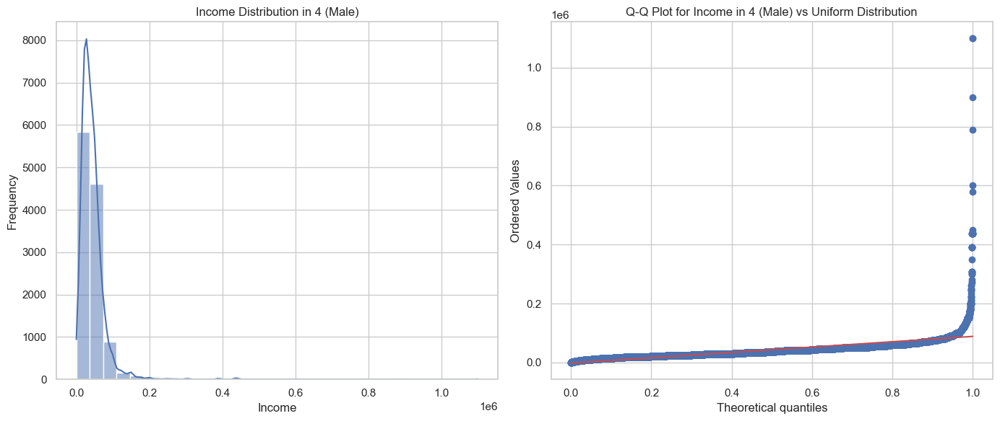

Kolmogorov-Smirnov test for 4 (Male): Statistic=0.8756758970902581, p-value=0.0
The income data in 4 for Male is not uniformly distributed (reject H0).


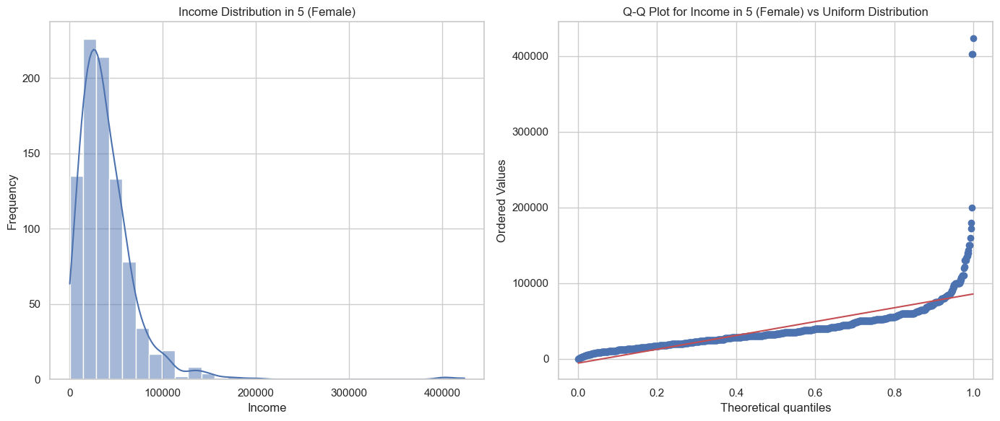

Kolmogorov-Smirnov test for 5 (Female): Statistic=0.7410497800693915, p-value=0.0
The income data in 5 for Female is not uniformly distributed (reject H0).


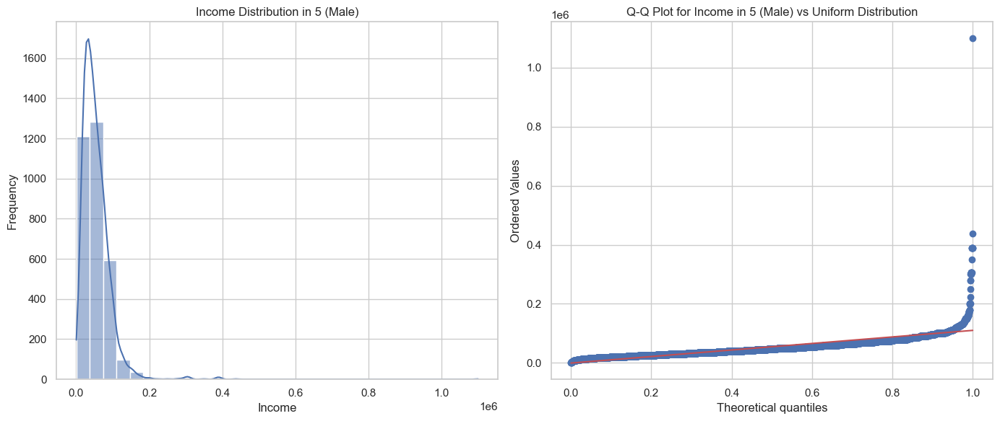

Kolmogorov-Smirnov test for 5 (Male): Statistic=0.8566491511946266, p-value=0.0
The income data in 5 for Male is not uniformly distributed (reject H0).


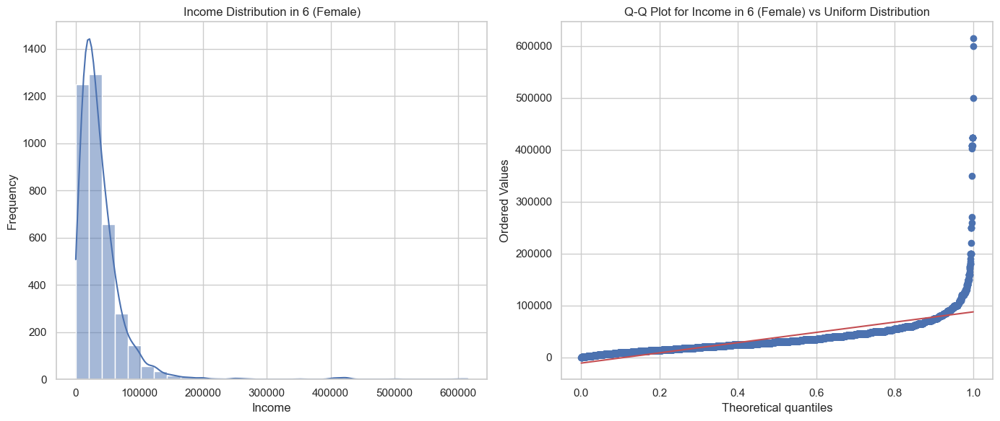

Kolmogorov-Smirnov test for 6 (Female): Statistic=0.7974532819255576, p-value=0.0
The income data in 6 for Female is not uniformly distributed (reject H0).


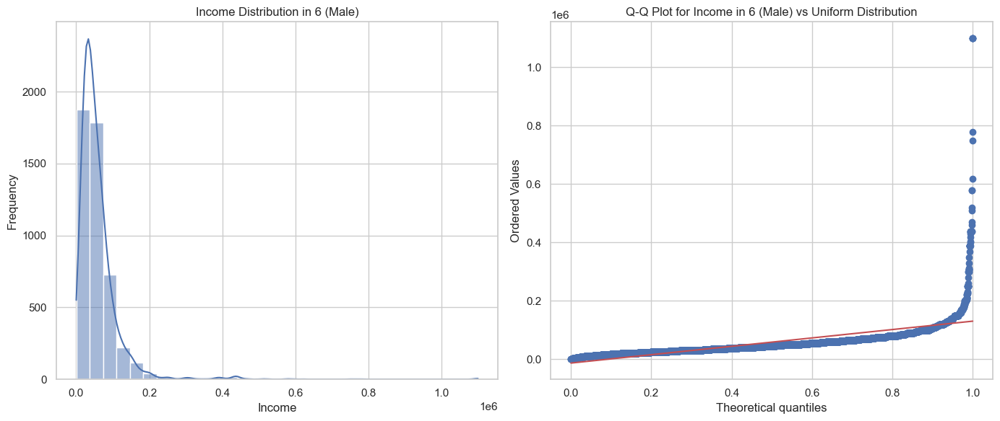

Kolmogorov-Smirnov test for 6 (Male): Statistic=0.8278357116664872, p-value=0.0
The income data in 6 for Male is not uniformly distributed (reject H0).


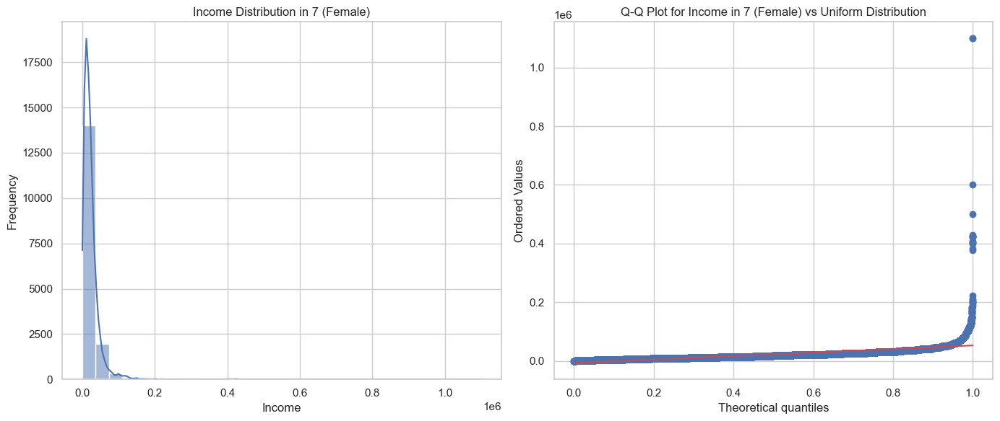

Kolmogorov-Smirnov test for 7 (Female): Statistic=0.9063510019287969, p-value=0.0
The income data in 7 for Female is not uniformly distributed (reject H0).


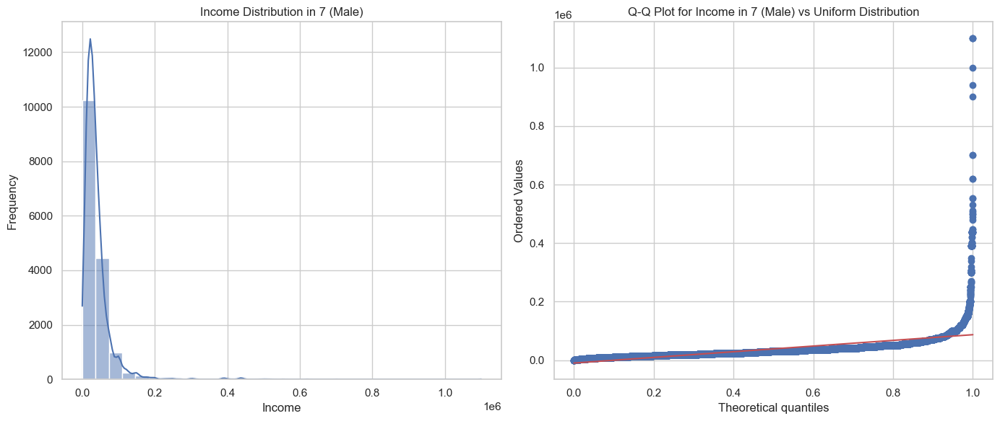

Kolmogorov-Smirnov test for 7 (Male): Statistic=0.8677129232176007, p-value=0.0
The income data in 7 for Male is not uniformly distributed (reject H0).


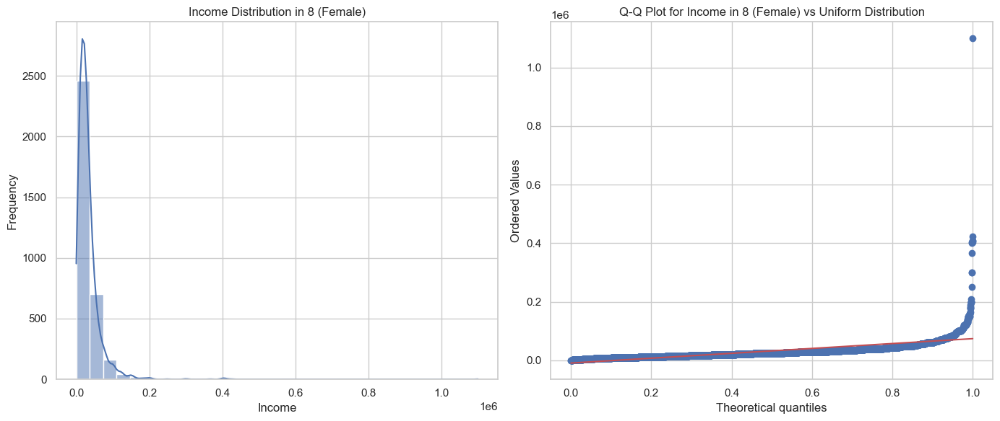

Kolmogorov-Smirnov test for 8 (Female): Statistic=0.8797830500020531, p-value=0.0
The income data in 8 for Female is not uniformly distributed (reject H0).


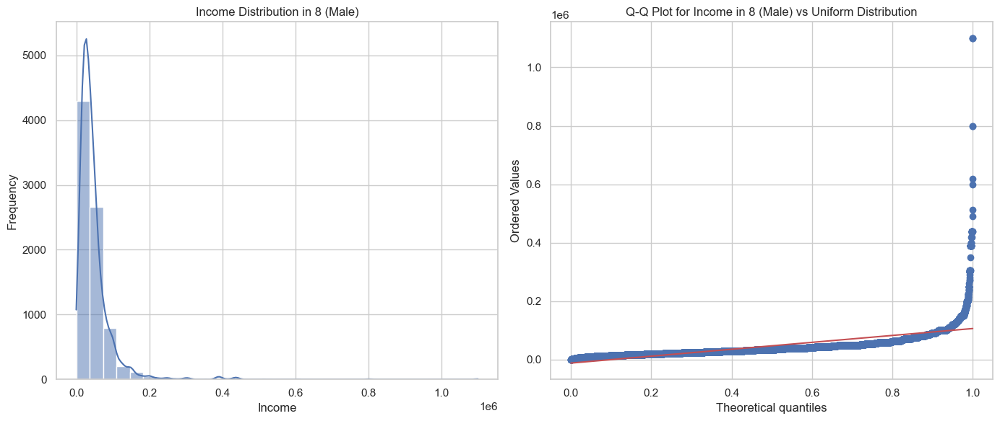

Kolmogorov-Smirnov test for 8 (Male): Statistic=0.8456473893444658, p-value=0.0
The income data in 8 for Male is not uniformly distributed (reject H0).


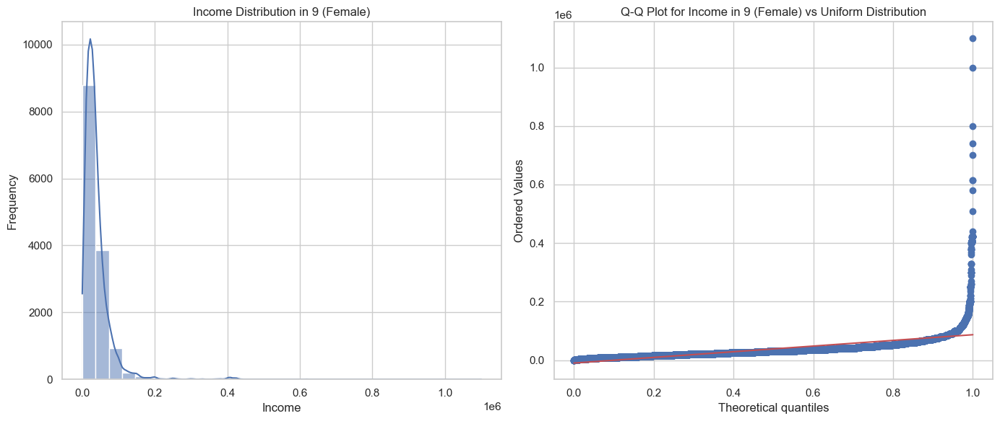

Kolmogorov-Smirnov test for 9 (Female): Statistic=0.8720628840657701, p-value=0.0
The income data in 9 for Female is not uniformly distributed (reject H0).


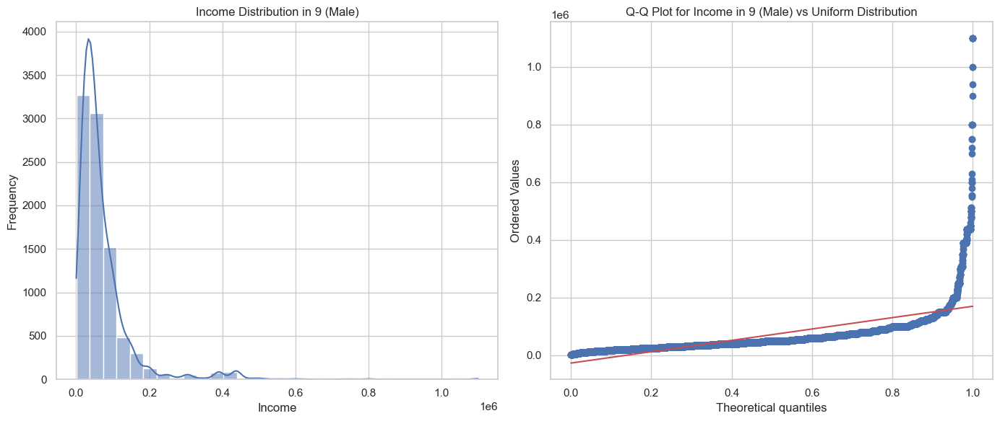

Kolmogorov-Smirnov test for 9 (Male): Statistic=0.7962996778500471, p-value=0.0
The income data in 9 for Male is not uniformly distributed (reject H0).


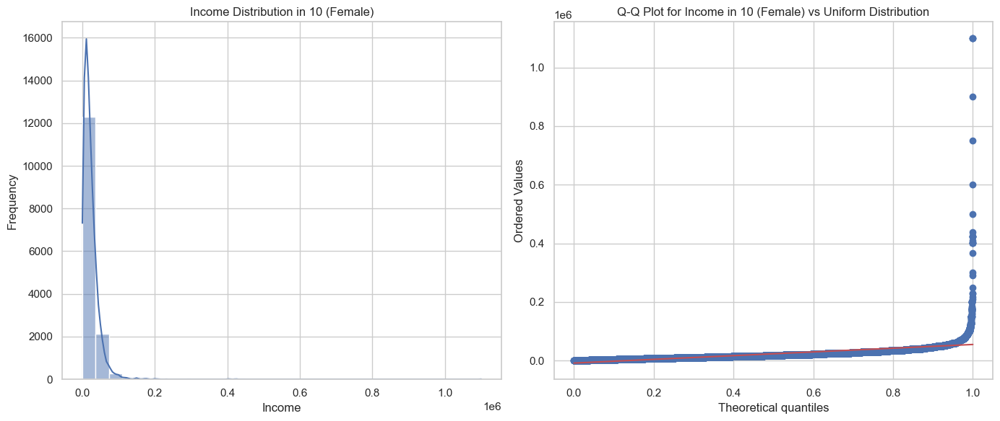

Kolmogorov-Smirnov test for 10 (Female): Statistic=0.9093346454522555, p-value=0.0
The income data in 10 for Female is not uniformly distributed (reject H0).


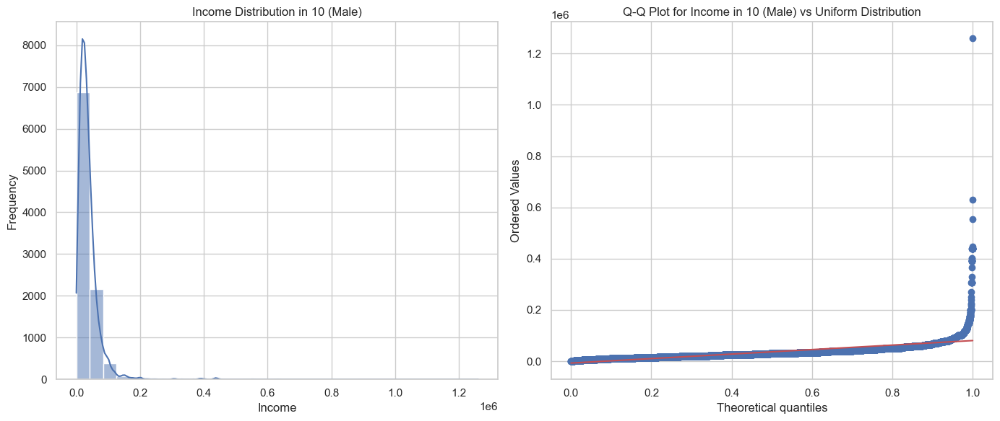

Kolmogorov-Smirnov test for 10 (Male): Statistic=0.8918760813715131, p-value=0.0
The income data in 10 for Male is not uniformly distributed (reject H0).


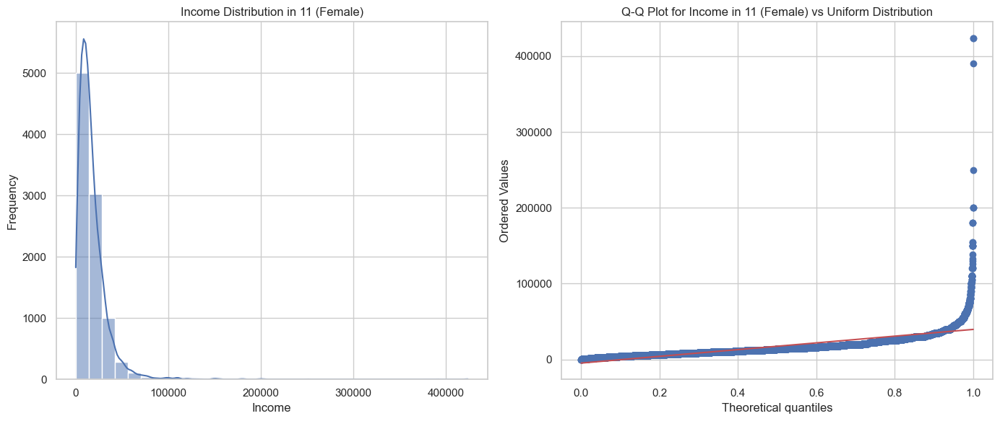

Kolmogorov-Smirnov test for 11 (Female): Statistic=0.8503786912651811, p-value=0.0
The income data in 11 for Female is not uniformly distributed (reject H0).


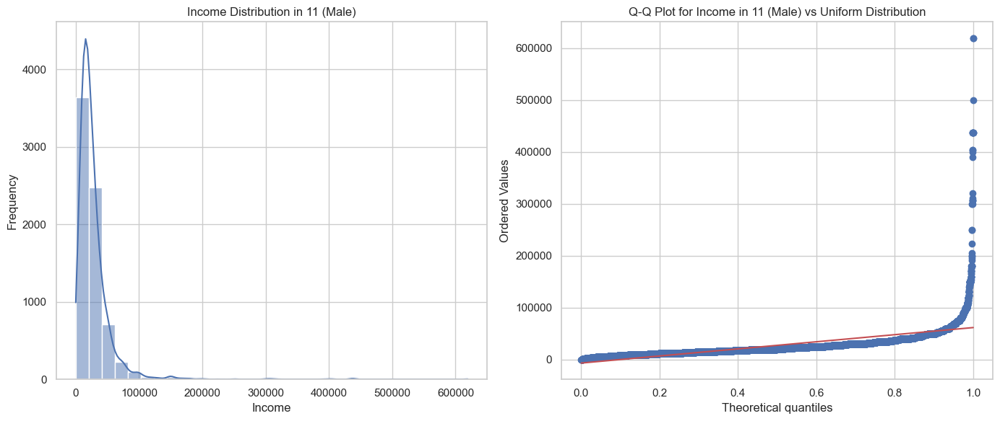

Kolmogorov-Smirnov test for 11 (Male): Statistic=0.8442766723582571, p-value=0.0
The income data in 11 for Male is not uniformly distributed (reject H0).


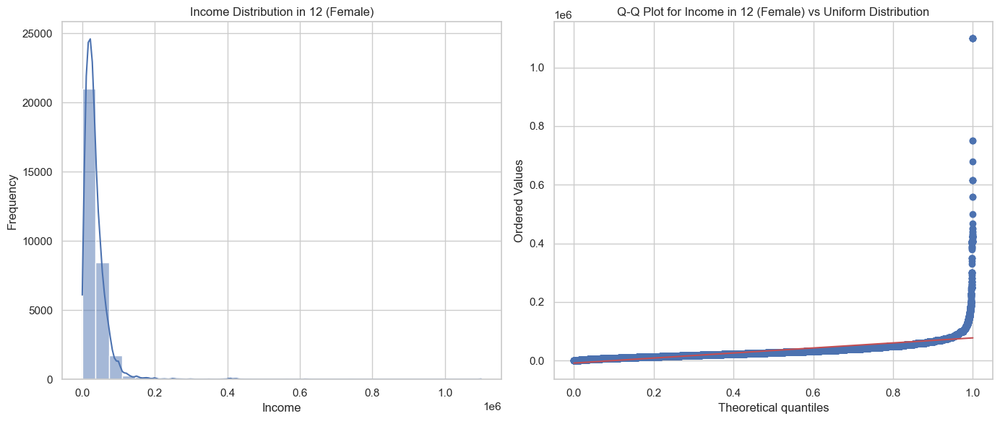

Kolmogorov-Smirnov test for 12 (Female): Statistic=0.88422855739291, p-value=0.0
The income data in 12 for Female is not uniformly distributed (reject H0).


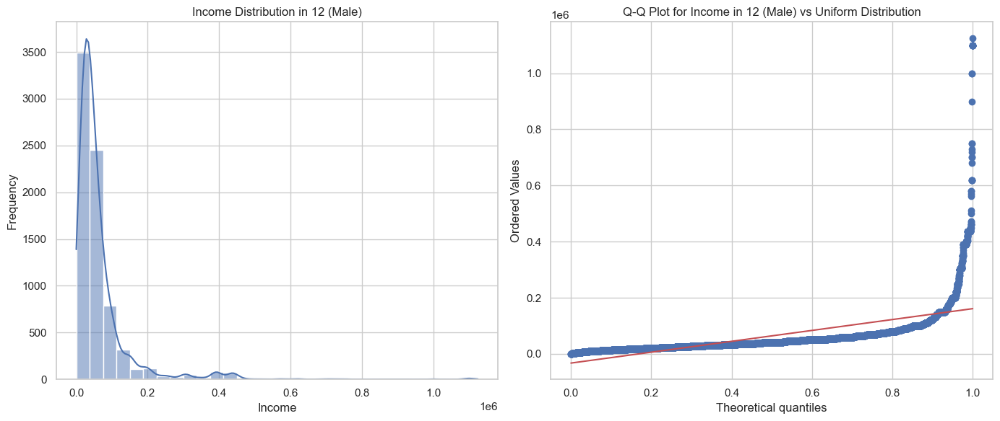

Kolmogorov-Smirnov test for 12 (Male): Statistic=0.7973443379588279, p-value=0.0
The income data in 12 for Male is not uniformly distributed (reject H0).


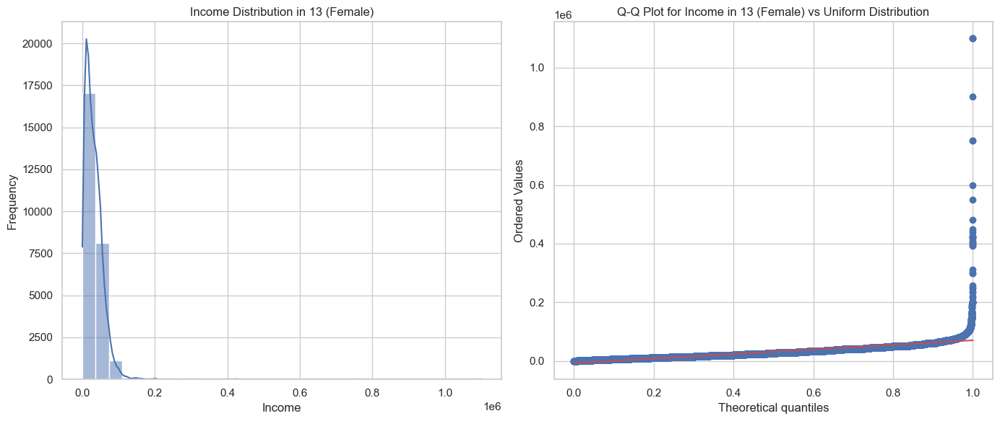

Kolmogorov-Smirnov test for 13 (Female): Statistic=0.899376089032519, p-value=0.0
The income data in 13 for Female is not uniformly distributed (reject H0).


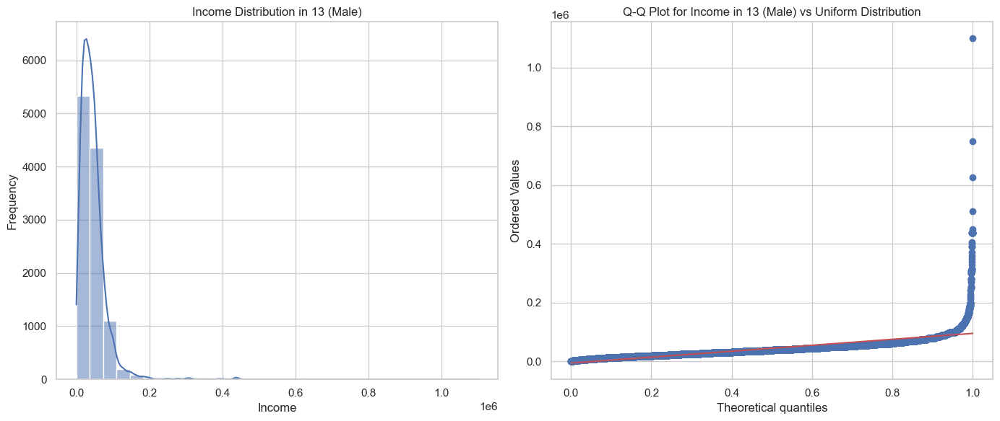

Kolmogorov-Smirnov test for 13 (Male): Statistic=0.8675376922444296, p-value=0.0
The income data in 13 for Male is not uniformly distributed (reject H0).


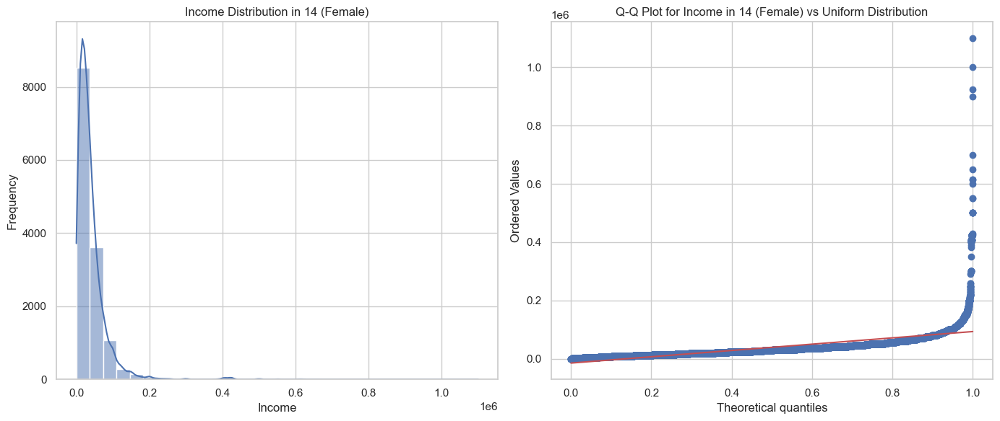

Kolmogorov-Smirnov test for 14 (Female): Statistic=0.8599609292414232, p-value=0.0
The income data in 14 for Female is not uniformly distributed (reject H0).


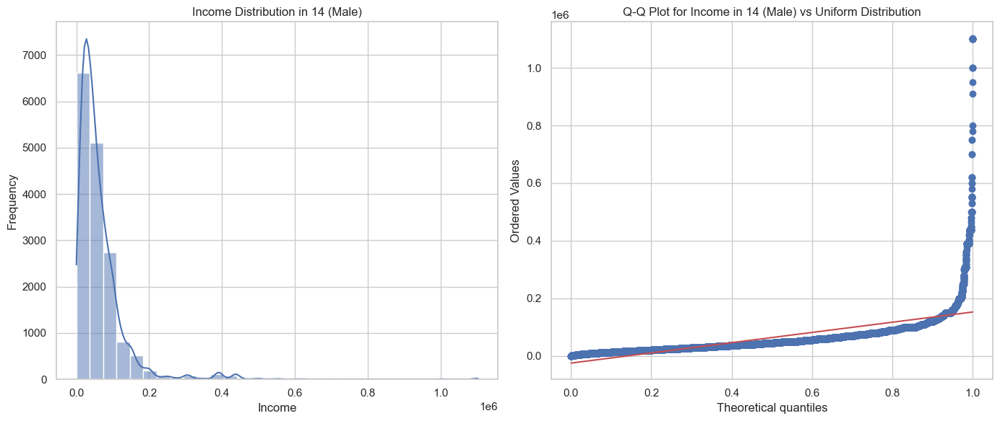

Kolmogorov-Smirnov test for 14 (Male): Statistic=0.8099113461188295, p-value=0.0
The income data in 14 for Male is not uniformly distributed (reject H0).


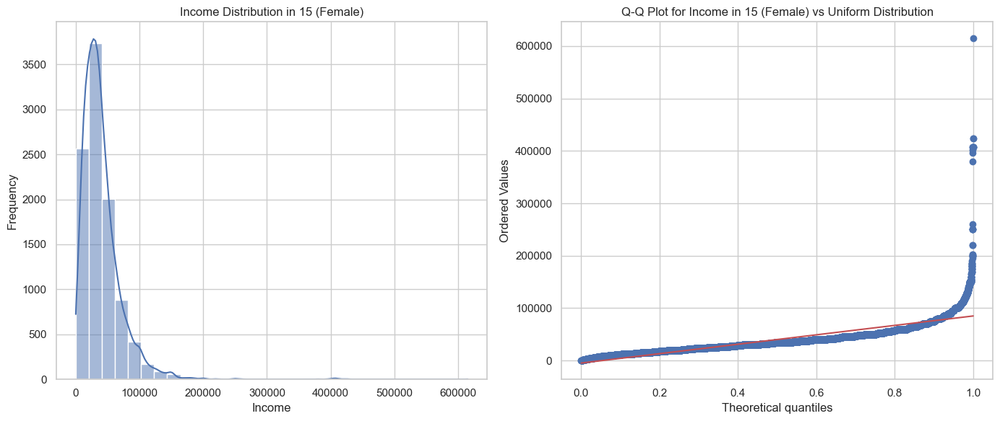

Kolmogorov-Smirnov test for 15 (Female): Statistic=0.7994671241224532, p-value=0.0
The income data in 15 for Female is not uniformly distributed (reject H0).


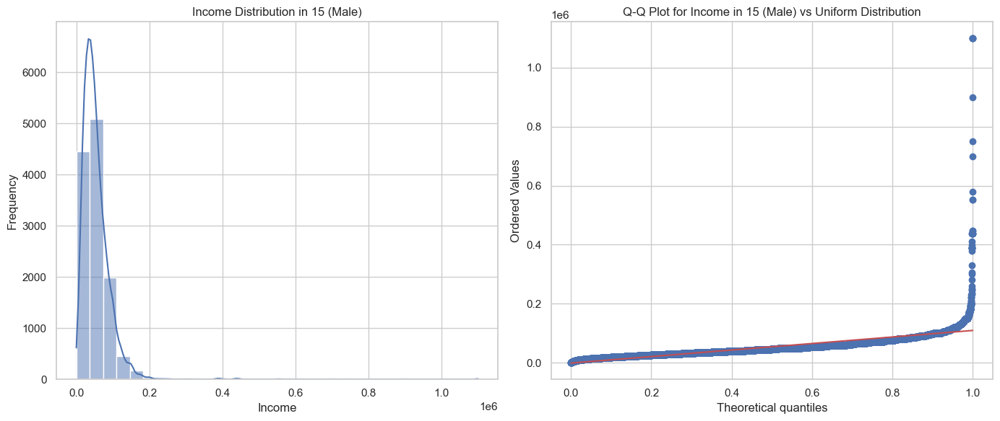

Kolmogorov-Smirnov test for 15 (Male): Statistic=0.8530996135384172, p-value=0.0
The income data in 15 for Male is not uniformly distributed (reject H0).


In [74]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from scipy import stats

# Group by 'industry' and 'sex' to get income data as flat lists
income_by_sex = new_data.groupby(['industry', 'sex'])['incwage'].apply(lambda x: np.array(x)).reset_index()

# Loop through each industry and sex to check for uniformity
for (industry, sex), group in income_by_sex.groupby(['industry', 'sex']):
    # Convert the group of incomes to a NumPy array
    incomes = group['incwage'].values[0]  # Take the first element of the series, which is the array

    # Check if the group has enough data points
    if len(incomes) < 5:  # Set your threshold (e.g., at least 5 points)
        print(f"Not enough data to perform uniformity checks for {industry} ({sex}). Skipping...")
        continue  # Ensure you continue to the next iteration

    # Create subplots for histogram and Q-Q plot
    fig, axes = plt.subplots(1, 2, figsize=(14, 6))

    # Histogram
    sns.histplot(incomes, bins=30, kde=True, ax=axes[0])
    axes[0].set_title(f'Income Distribution in {industry} ({sex})')
    axes[0].set_xlabel('Income')
    axes[0].set_ylabel('Frequency')

    # Q-Q Plot against a uniform distribution
    stats.probplot(incomes, dist="uniform", plot=axes[1])
    axes[1].set_title(f'Q-Q Plot for Income in {industry} ({sex}) vs Uniform Distribution')

    plt.tight_layout()
    plt.show()

    # Perform Kolmogorov-Smirnov test for uniformity
    uniform_dist = stats.uniform(loc=np.min(incomes), scale=np.max(incomes) - np.min(incomes))
    ks_stat, ks_p_value = stats.kstest(incomes, uniform_dist.cdf)
    print(f'Kolmogorov-Smirnov test for {industry} ({sex}): Statistic={ks_stat}, p-value={ks_p_value}')
    
    if ks_p_value > 0.05:
        print(f'The income data in {industry} for {sex} is uniformly distributed (fail to reject H0).')
    else:
        print(f'The income data in {industry} for {sex} is not uniformly distributed (reject H0).')


Data is not normally distributed and not uniformly distrubuted, => minmax scaling

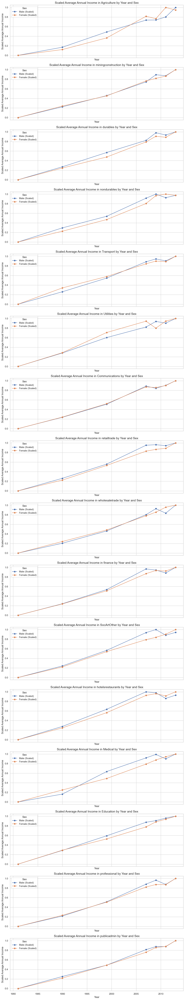

In [75]:
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
import pandas as pd

# Group by 'year', 'industry', and 'sex' to calculate the average income
average_income_by_year_industry_sex = new_data.groupby(['year', 'industry', 'sex'])['incwage'].mean().unstack('sex')

# Get unique industries
industries = average_income_by_year_industry_sex.index.get_level_values('industry').unique()

# Set up the subplots: one for each industry
num_industries = len(industries)
fig, axes = plt.subplots(nrows=num_industries, figsize=(12, num_industries * 4), sharex=True)

# Initialize MinMaxScaler
scaler = MinMaxScaler()

# Loop over each industry to create individual plots with scaled data
for i, industry in enumerate(industries):
    ax = axes[i]
    
    # Get data for the specific industry
    industry_data = average_income_by_year_industry_sex.xs(industry, level='industry')
    
    # Apply Min-Max scaling to both male and female income values
    scaled_data = pd.DataFrame(
        scaler.fit_transform(industry_data), 
        index=industry_data.index, 
        columns=industry_data.columns
    )
    
    # Plot the scaled data
    ax.plot(scaled_data.index, scaled_data['Male'], marker='o', linestyle='-', label="Male (Scaled)")
    ax.plot(scaled_data.index, scaled_data['Female'], marker='o', linestyle='-', label="Female (Scaled)")
    
    # Add titles and labels
    ax.set_title(f"Scaled Average Annual Income in {industry_columns[i]} by Year and Sex", fontsize=14)
    ax.set_xlabel("Year", fontsize=12)
    ax.set_ylabel("Scaled Average Annual Income", fontsize=12)
    ax.legend(title="Sex")

# Adjust layout and show plot
plt.tight_layout()
plt.show()


['Female' 'Male']
Index(['Female', 'Male'], dtype='object', name='sex')


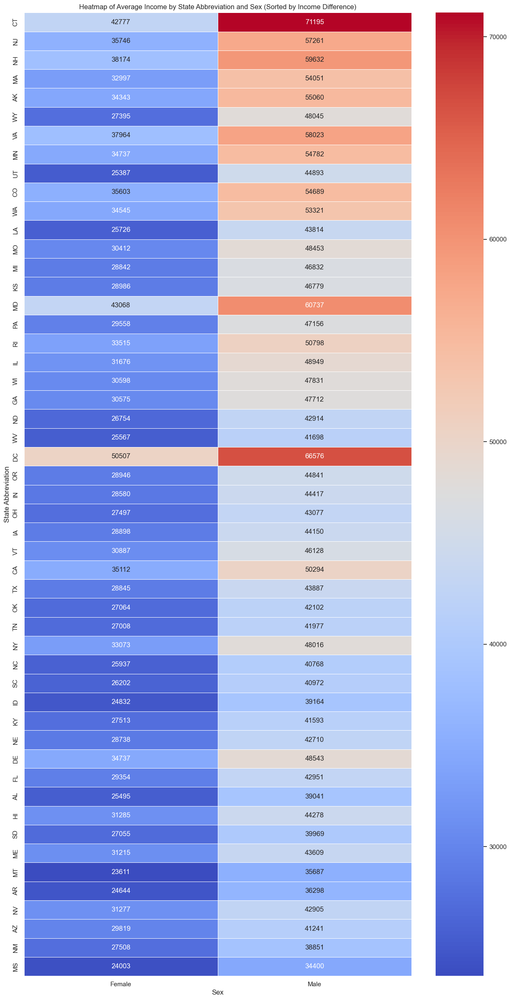

In [76]:
import matplotlib.pyplot as plt
import seaborn as sns

# A dictionary mapping state FIP codes to state abbreviations
fip_to_abbreviation = {
    1: 'AL', 2: 'AK', 4: 'AZ', 5: 'AR', 6: 'CA', 8: 'CO', 9: 'CT', 10: 'DE', 11: 'DC',
    12: 'FL', 13: 'GA', 15: 'HI', 16: 'ID', 17: 'IL', 18: 'IN', 19: 'IA', 20: 'KS',
    21: 'KY', 22: 'LA', 23: 'ME', 24: 'MD', 25: 'MA', 26: 'MI', 27: 'MN', 28: 'MS',
    29: 'MO', 30: 'MT', 31: 'NE', 32: 'NV', 33: 'NH', 34: 'NJ', 35: 'NM', 36: 'NY',
    37: 'NC', 38: 'ND', 39: 'OH', 40: 'OK', 41: 'OR', 42: 'PA', 44: 'RI', 45: 'SC',
    46: 'SD', 47: 'TN', 48: 'TX', 49: 'UT', 50: 'VT', 51: 'VA', 53: 'WA', 54: 'WV',
    55: 'WI', 56: 'WY'
}

# Calculate average income by state FIP and sex
state_sex_income = new_data.groupby(['statefip', 'sex'])['incwage'].mean().reset_index()

# Replace the state FIP codes with state abbreviations
state_sex_income['state_abbr'] = state_sex_income['statefip'].map(fip_to_abbreviation)

# Check unique values in the 'sex' column
print(state_sex_income['sex'].unique())  # Add this line to debug

# Pivot the data to get it into the right format for a heatmap
heatmap_data = state_sex_income.pivot(index='state_abbr', columns='sex', values='incwage')

# Check the columns of the heatmap data
print(heatmap_data.columns)  # Add this line to debug

# Calculate the income difference between sexes for each state
# Assuming 'Female' and 'Male' are the values in the 'sex' column
heatmap_data['income_diff'] = heatmap_data['Male'] - heatmap_data['Female']  # Change to actual labels

# Sort the DataFrame based on the income difference
heatmap_data.sort_values('income_diff', ascending=False, inplace=True)

# Remove the 'income_diff' column from the heatmap
heatmap_data = heatmap_data.drop(columns='income_diff')

# Generate the heatmap
plt.figure(figsize=(15, 30))
sns.heatmap(heatmap_data, annot=True, fmt=".0f", linewidths=.5, cmap="coolwarm")
plt.title('Heatmap of Average Income by State Abbreviation and Sex (Sorted by Income Difference)')
plt.xlabel('Sex')
plt.ylabel('State Abbreviation')

plt.show()


['Female' 'Male']
MultiIndex([(1981, 'Female'),
            (1981,   'Male'),
            (1990, 'Female'),
            (1990,   'Male'),
            (1999, 'Female'),
            (1999,   'Male'),
            (2007, 'Female'),
            (2007,   'Male'),
            (2009, 'Female'),
            (2009,   'Male'),
            (2011, 'Female'),
            (2011,   'Male'),
            (2013, 'Female'),
            (2013,   'Male')],
           names=['year', 'sex'])


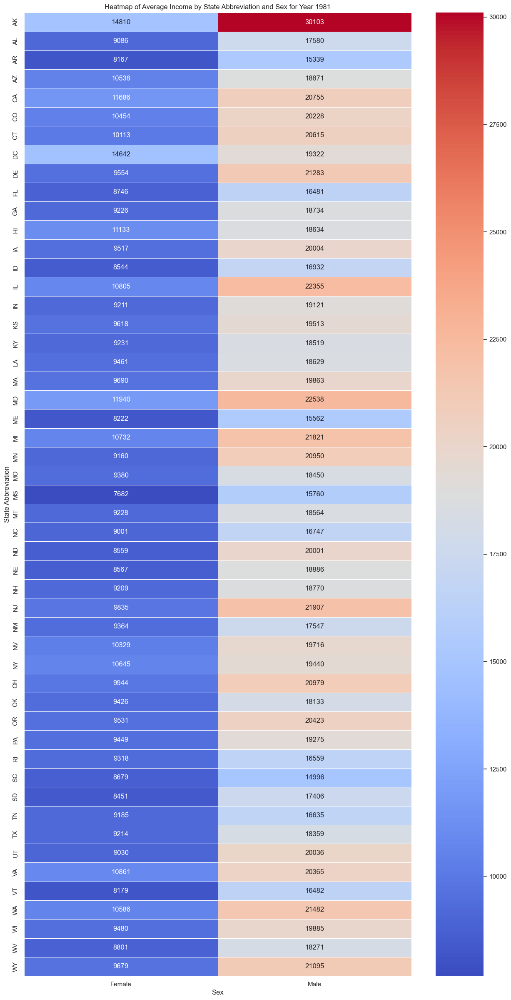

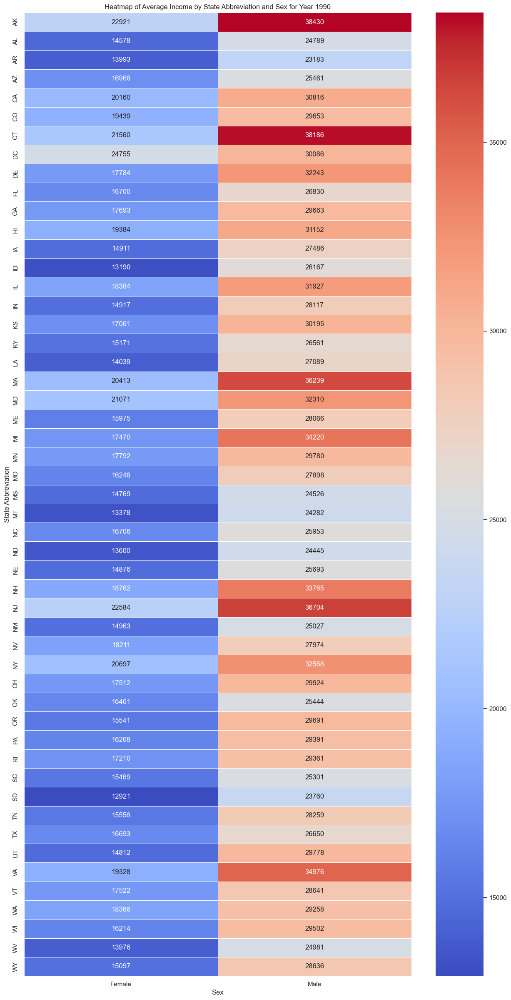

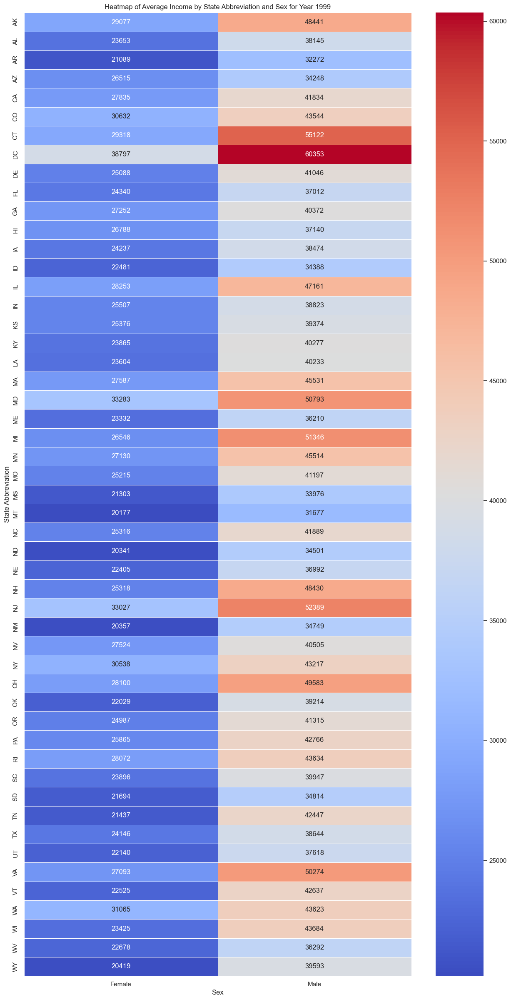

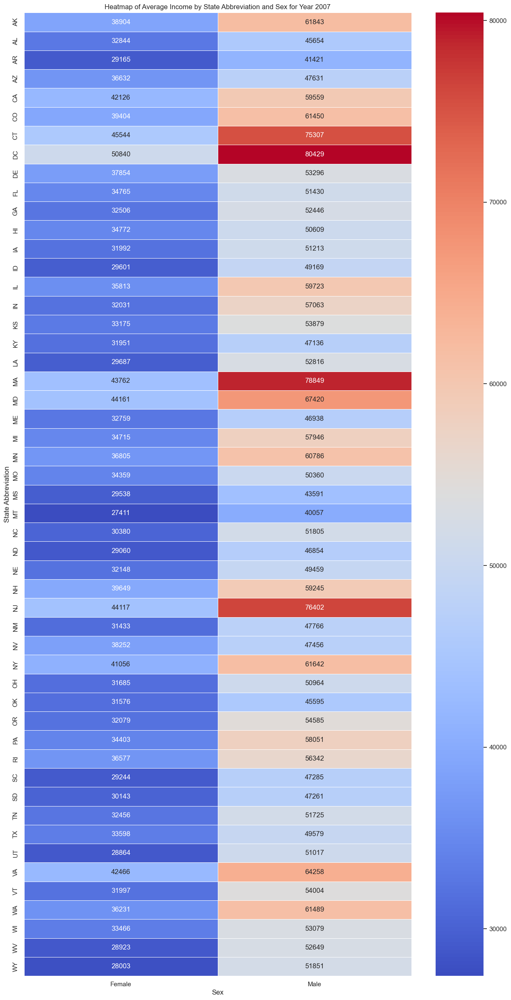

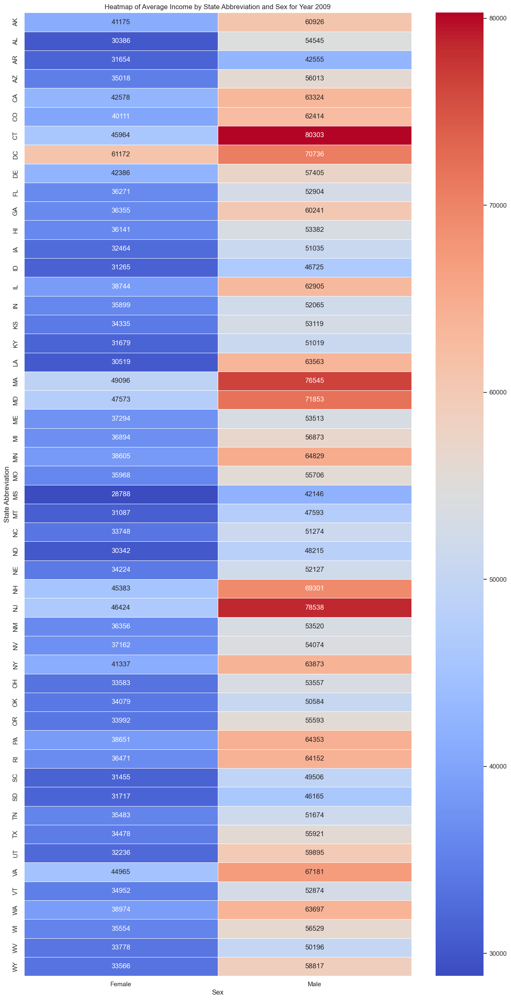

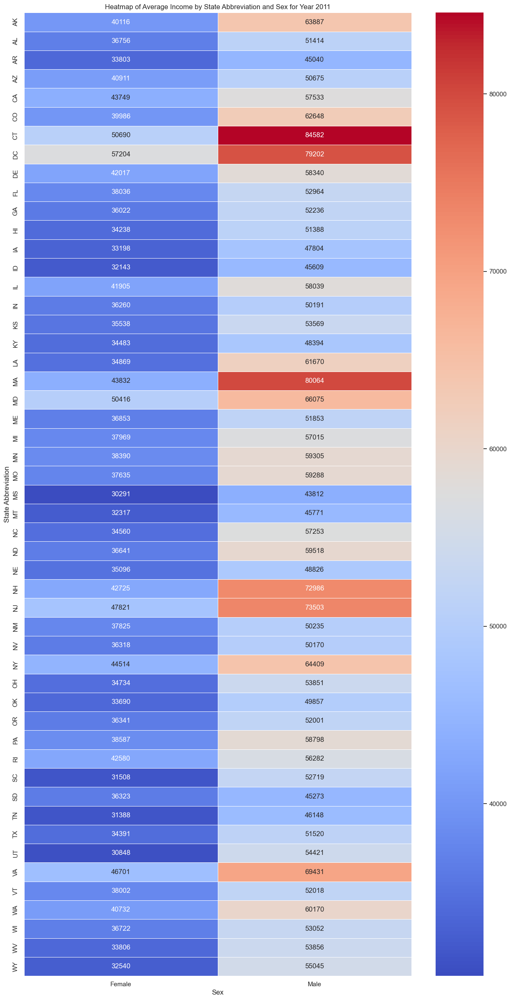

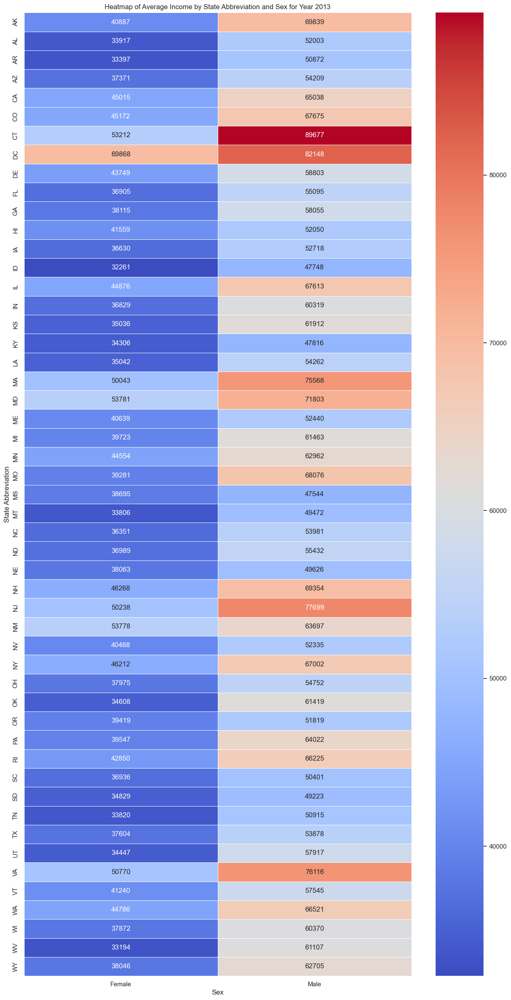

In [77]:
import matplotlib.pyplot as plt
import seaborn as sns

# A dictionary mapping state FIP codes to state abbreviations
fip_to_abbreviation = {
    1: 'AL', 2: 'AK', 4: 'AZ', 5: 'AR', 6: 'CA', 8: 'CO', 9: 'CT', 10: 'DE', 11: 'DC',
    12: 'FL', 13: 'GA', 15: 'HI', 16: 'ID', 17: 'IL', 18: 'IN', 19: 'IA', 20: 'KS',
    21: 'KY', 22: 'LA', 23: 'ME', 24: 'MD', 25: 'MA', 26: 'MI', 27: 'MN', 28: 'MS',
    29: 'MO', 30: 'MT', 31: 'NE', 32: 'NV', 33: 'NH', 34: 'NJ', 35: 'NM', 36: 'NY',
    37: 'NC', 38: 'ND', 39: 'OH', 40: 'OK', 41: 'OR', 42: 'PA', 44: 'RI', 45: 'SC',
    46: 'SD', 47: 'TN', 48: 'TX', 49: 'UT', 50: 'VT', 51: 'VA', 53: 'WA', 54: 'WV',
    55: 'WI', 56: 'WY'
}

# Calculate average income by state FIP, sex, and year
state_sex_income = new_data.groupby(['statefip', 'sex', 'year'])['incwage'].mean().reset_index()

# Replace the state FIP codes with state abbreviations
state_sex_income['state_abbr'] = state_sex_income['statefip'].map(fip_to_abbreviation)

# Check unique values in the 'sex' column
print(state_sex_income['sex'].unique())  # Debugging line

# Pivot the data to get it into the right format for a heatmap
heatmap_data = state_sex_income.pivot_table(index='state_abbr', columns=['year', 'sex'], values='incwage')

# Check the columns of the heatmap data
print(heatmap_data.columns)  # Debugging line

# Calculate the income difference between sexes for each state and year
# Accessing using tuple (year, 'Male') and (year, 'Female')
income_diff = {year: heatmap_data[(year, 'Male')] - heatmap_data[(year, 'Female')] for year in heatmap_data.columns.levels[0]}

# Generate the heatmaps for each year
for year in heatmap_data.columns.levels[0]:  # Iterate through the years
    plt.figure(figsize=(15, 30))
    sns.heatmap(heatmap_data[year], annot=True, fmt=".0f", linewidths=.5, cmap="coolwarm")
    plt.title(f'Heatmap of Average Income by State Abbreviation and Sex for Year {year}')
    plt.xlabel('Sex')
    plt.ylabel('State Abbreviation')
    plt.show()


sch - school level of education
oeduc - Original Educational attainment recode' (wrong col, shouldnt be included in education_columns)
ba: bachelor's Degree
adv: advanced Degree
LEHS: High School or Less

/var/folders/v0/6fl9_2q93mggh30x_qf5fyv40000gn/T/ipykernel_42540/72821164.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  educ_sex_income = new_data.groupby(['education', 'sex'], as_index=False)['incwage'].mean()


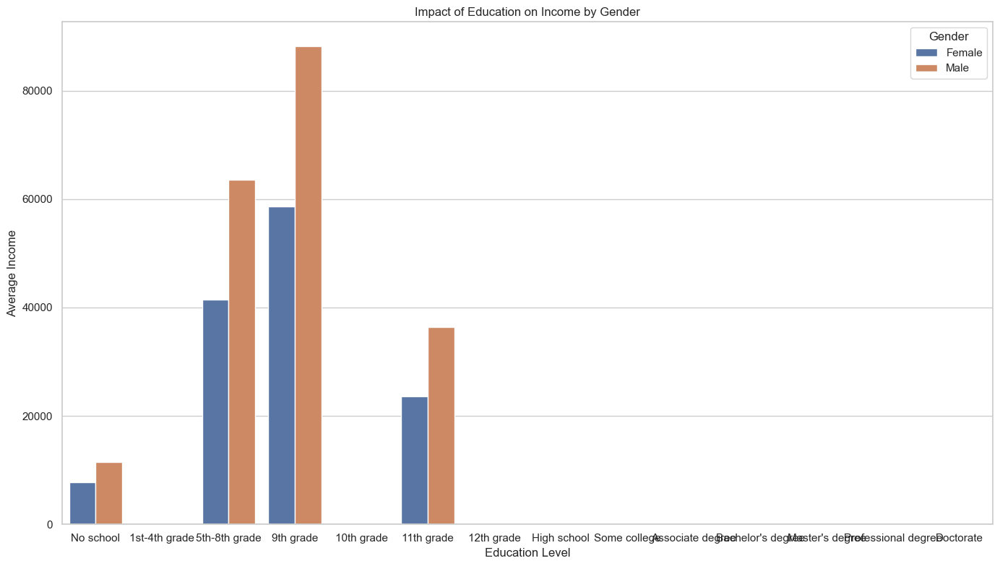

In [78]:
# Ensure that 'education' is a categorical variable with the correct categories
new_data['education'] = pd.Categorical(new_data['education'], categories=range(len(education_columns)))

# Group by 'education' and 'sex', then calculate the average 'incwage'
educ_sex_income = new_data.groupby(['education', 'sex'], as_index=False)['incwage'].mean()

# Use seaborn to create a bar plot
plt.figure(figsize=(14, 8))
sns.barplot(data=educ_sex_income, x='education', y='incwage', hue='sex')

# Adding titles and labels
plt.title('Impact of Education on Income by Gender')
plt.xlabel('Education Level')
plt.ylabel('Average Income')
plt.xticks(ticks=range(len(education_columns)), labels=education_columns)  # Set x-axis ticks to education columns
plt.legend(title='Gender')
plt.tight_layout()

# Show the plot
plt.show()
